Imports

In [1]:
import os
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from ImageUtils import ImageUtils
from Operations import *

# Guide II.1

## 3. Image basics

Contrast: 201.00
Entropy: 6.77
Average Intensity: 125.39


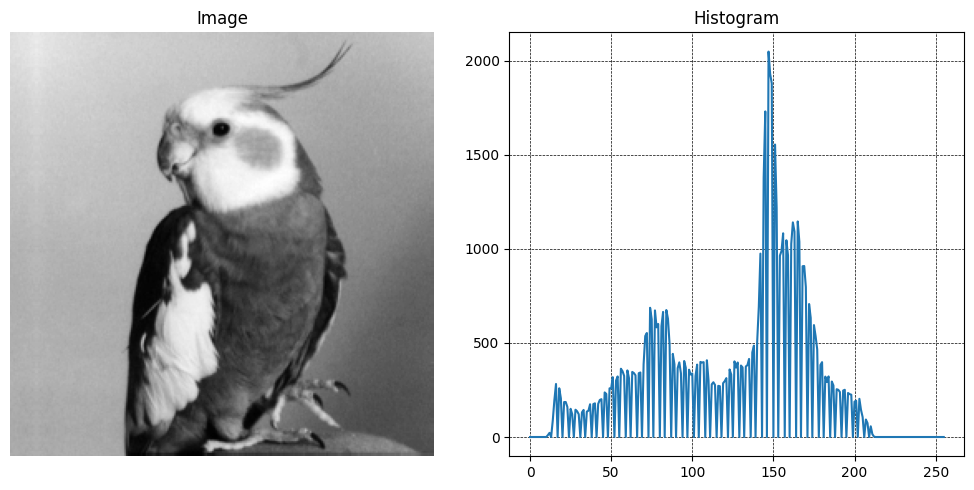

Contrast: 246.00
Entropy: 7.01
Average Intensity: 118.72


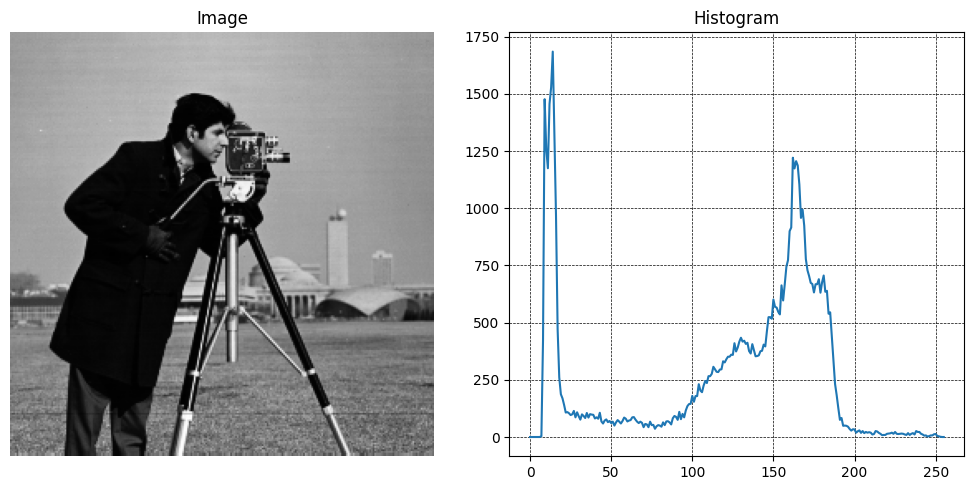

Contrast: 235.00
Entropy: 7.57
Average Intensity: 98.68


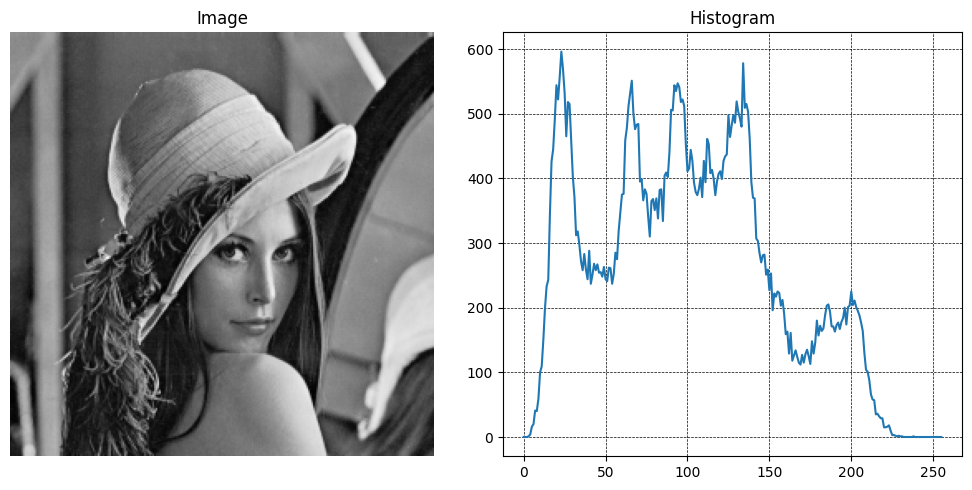

Contrast: 150.00
Entropy: 1.08
Average Intensity: 67.77


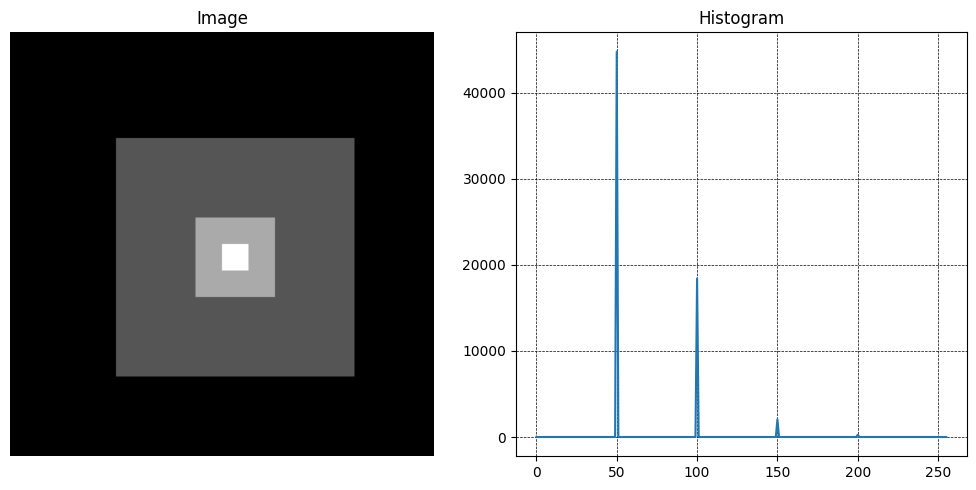

In [2]:
path = "../../src/TP2/dataset/grayscale_imgs/"
for obj_name in os.listdir(path): 
    if obj_name.endswith('.gif'):
        image = np.array(Image.open(f'{path}{obj_name}').convert('L'))
        ImageUtils().image_information(image)

## 4. Logical and Arithmetic Operations
### 4.1 Logical Operations

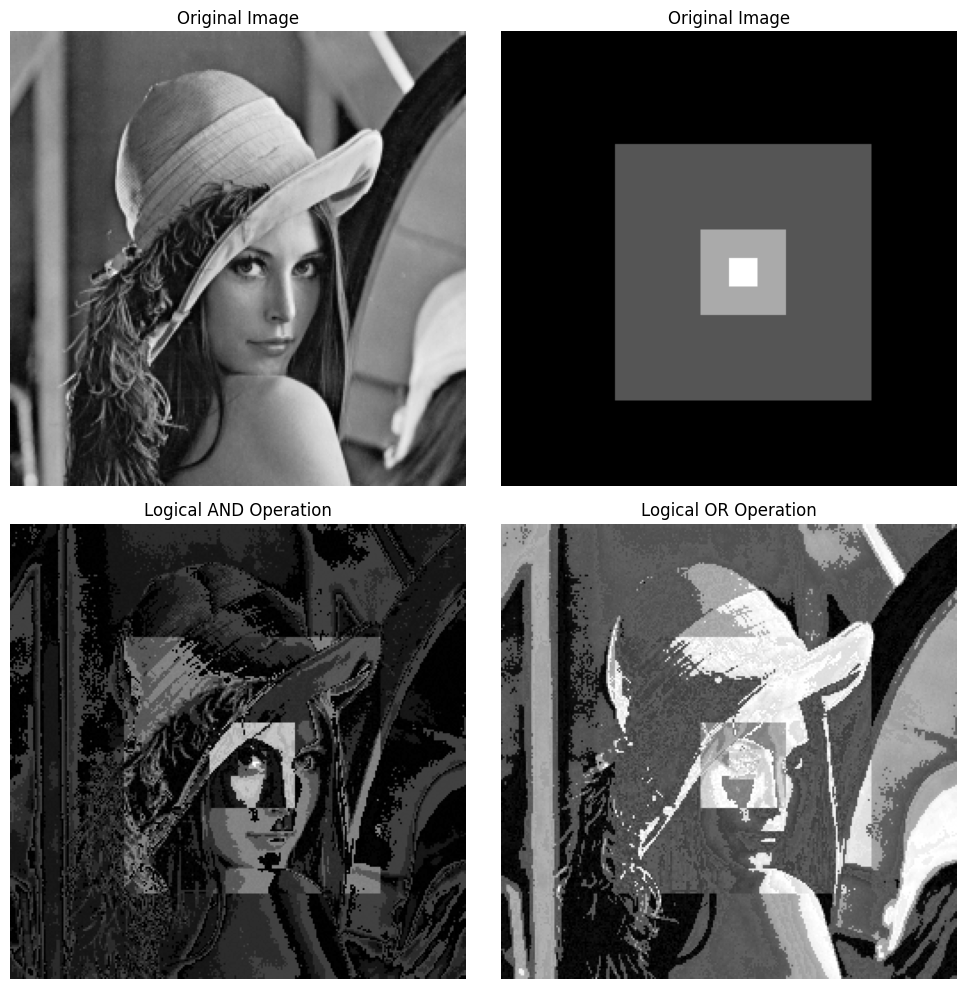

In [3]:
image1 = np.array(Image.open(f'{path}lena.gif').convert('L'))
image2 = np.array(Image.open(f'{path}squares.gif').convert('L'))

# Logical AND
image_and = ImageUtils().apply_logical_operation(image1=image1, image2=image2, operation=LogicalOperations.AND)

# Logical OR
image_or = ImageUtils().apply_logical_operation(image1=image1, image2=image2, operation=LogicalOperations.OR)


plt.subplots(2, 2, figsize=(10, 10))
plt.subplot(2, 2, 1)
plt.imshow(image1, cmap='gray')
plt.title(f'Original Image')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(image2, cmap='gray')
plt.title(f'Original Image')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(image_and, cmap='gray')
plt.title('Logical AND Operation')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(image_or, cmap='gray')
plt.title('Logical OR Operation')
plt.axis('off')

plt.tight_layout()
plt.show()



### 4.2 Arithmetic Operations

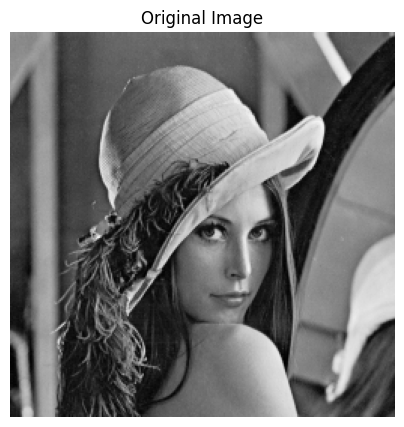

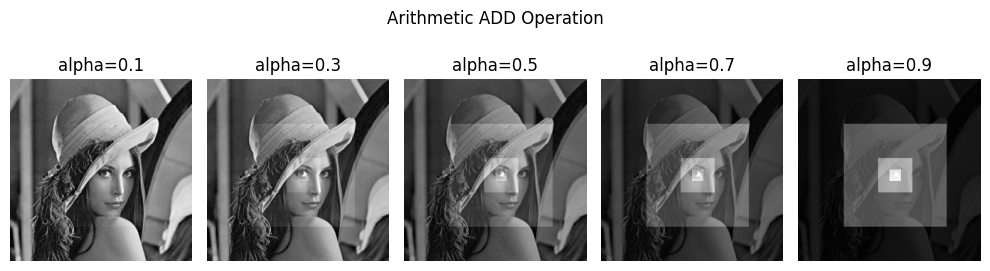

In [4]:
# Arithmetic ADD
image_add = ImageUtils().apply_arithmetic_operation(image1, image2, ArtihmeticOperations.ADD, alpha=0.5)

alphas = [0.1, 0.3, 0.5, 0.7, 0.9]

ImageUtils().image_show(image1, 'Original Image')

plt.subplots(1, len(alphas), figsize=(10, 3))
plt.suptitle('Arithmetic ADD Operation')
for set_index, alpha in enumerate(alphas):
    result = ImageUtils().apply_arithmetic_operation(image1, image2, ArtihmeticOperations.ADD, alpha=alpha)
    plt.subplot(1, len(alphas), set_index+1)
    plt.imshow(result, cmap='gray')
    plt.title(f'alpha={alpha}')
    plt.axis('off')
plt.tight_layout()
plt.show();

## 5. Tresholding

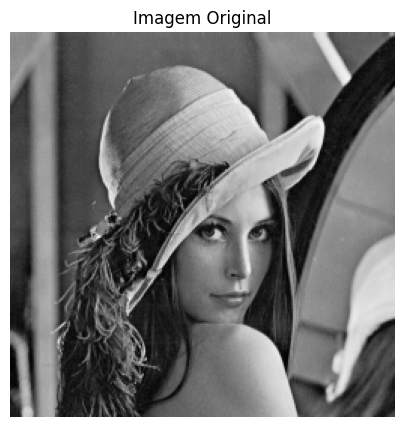

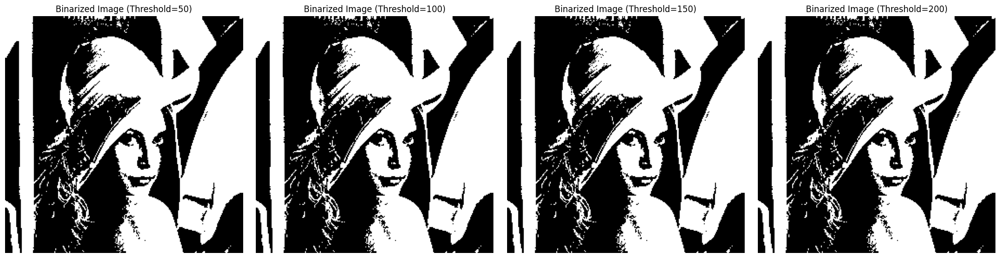

In [5]:
thresholds = [50, 100, 150, 200]

image = np.array(Image.open(f'{path}/lena.gif').convert('L'))
ImageUtils().image_show(image, 'Imagem Original')

plt.subplots(1, len(thresholds), figsize=(len(thresholds)*5, 5))
for set_index, threshold in enumerate(thresholds):
    plt.subplot(1, len(thresholds), set_index+1)

    image_threshold = ImageUtils().thresholding(image=image, threshold=threshold)
    plt.imshow(image_threshold, cmap='gray')
    plt.title(f'Binarized Image (Threshold={threshold})')
    plt.axis('off')
plt.tight_layout()
plt.show() 

# Guide II.2

## 1. Intensity Transformations
### 1.1 Linear Transformations

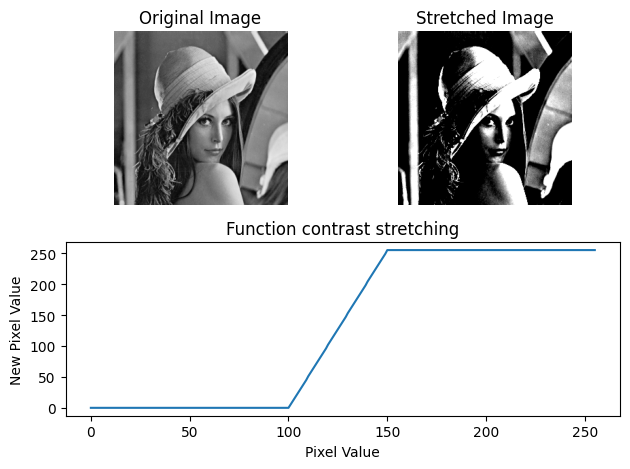

+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        235 |      7.57 |               98.68 |
+----------+------------+-----------+---------------------+
| Contrast |        255 |      3.16 |               80.41 |
+----------+------------+-----------+---------------------+


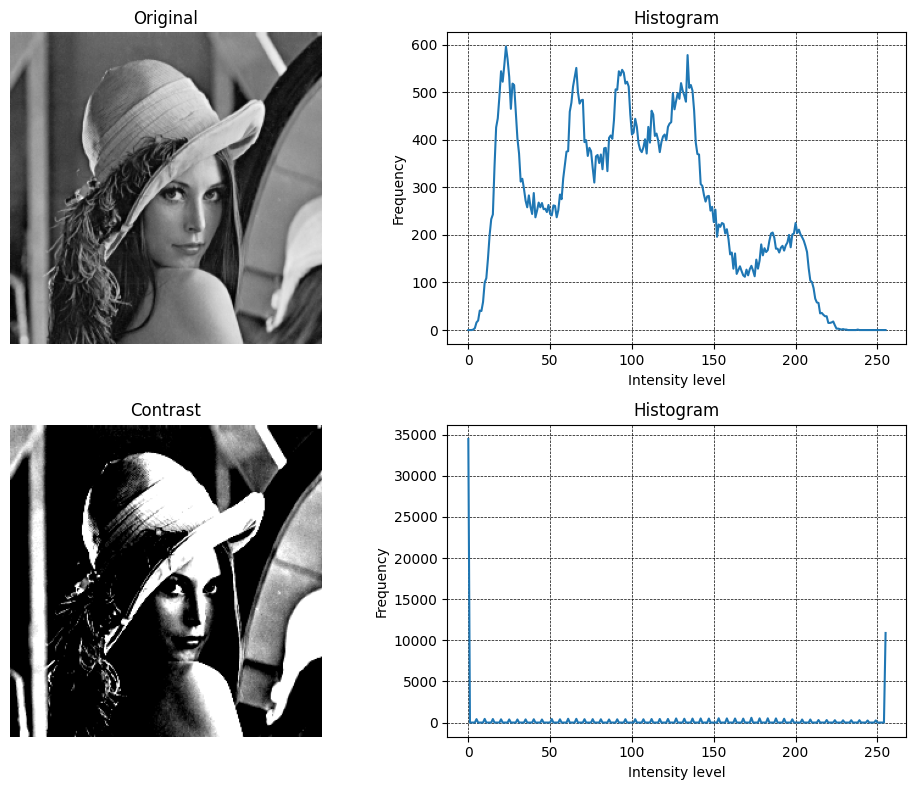

In [6]:
min = 100
max = 150

image = np.array(Image.open(f'{path}/lena.gif').convert('L'))
image_contrast, lookUpTable = ImageUtils().contrast_stretching(image, min=min, max=max)

plt.subplot(2, 1, 2)
plt.plot(lookUpTable.T)
plt.title('Function contrast stretching')
plt.xlabel('Pixel Value')
plt.ylabel('New Pixel Value')

plt.subplot(2, 2, 1)
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(image_contrast, cmap='gray')
plt.title('Stretched Image')
plt.axis('off')
plt.tight_layout()
plt.show()

ImageUtils().images_information([image, image_contrast],['Original', 'Contrast'])

### 1.2 Non-linear Transformations
#### 1.2.1 Histogram Equalization

Fonte: https://docs.opencv.org/4.x/d5/daf/tutorial_py_histogram_equalization.html

https://en.wikipedia.org/wiki/Histogram_equalization

+--------------------------------------+------------+-----------+---------------------+
| Image                                |   Contrast |   Entropy |   Average Intensity |
+======================================+============+===========+=====================+
| Original                             |        235 |      7.57 |               98.68 |
+--------------------------------------+------------+-----------+---------------------+
| Image with Equalized Histogram       |        255 |      7.43 |              128.29 |
+--------------------------------------+------------+-----------+---------------------+
| Image with CLAHE Equalized Histogram |        254 |      7.86 |              119.73 |
+--------------------------------------+------------+-----------+---------------------+


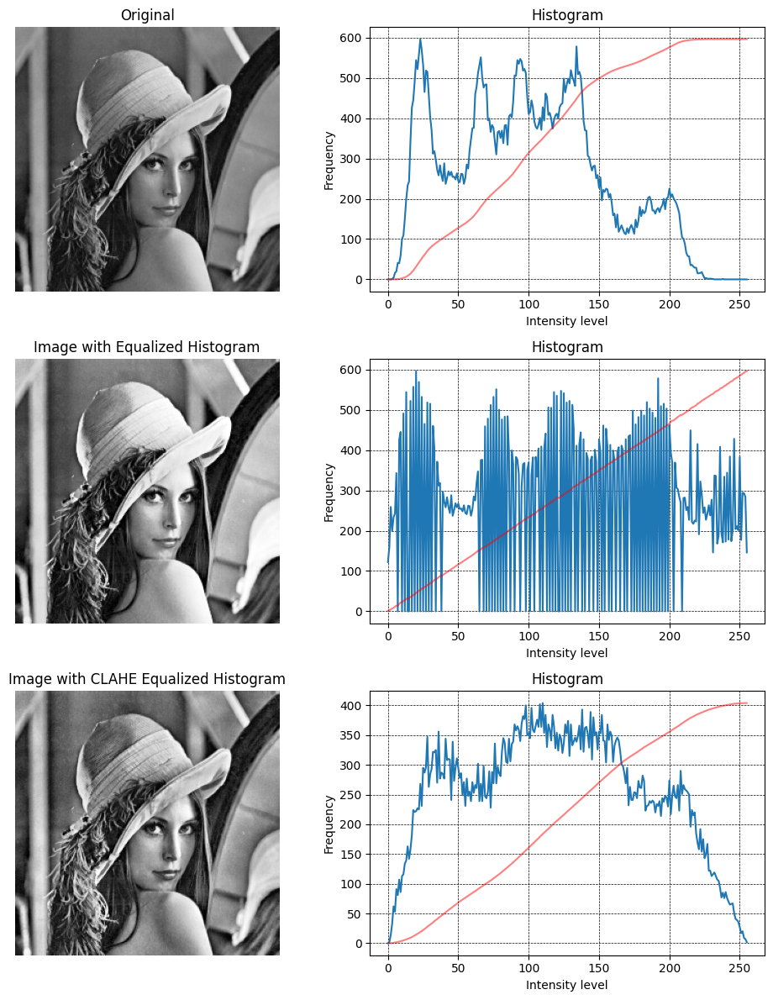

In [7]:
image = np.array(Image.open(f'{path}/lena.gif').convert('L'))
image_he_classic = ImageUtils().histogram_equalization(image, EquializationMethods.CLASSIC)
image_he_clahe = ImageUtils().histogram_equalization(image, EquializationMethods.CLAHE)

ImageUtils().images_information([image, image_he_classic, image_he_clahe],['Original', 'Image with Equalized Histogram', 'Image with CLAHE Equalized Histogram'], show_cdf=True)


#### 1.2.2 Histogram Specification

Fonte: https://scikit-image.org/docs/0.24.x/auto_examples/color_exposure/plot_histogram_matching.html

+-------------------------+------------+-----------+---------------------+
| Image                   |   Contrast |   Entropy |   Average Intensity |
+=========================+============+===========+=====================+
| original                |        235 |      7.57 |               98.68 |
+-------------------------+------------+-----------+---------------------+
| reference               |        201 |      6.77 |              125.39 |
+-------------------------+------------+-----------+---------------------+
| histogram specification |        201 |      6.81 |              124.73 |
+-------------------------+------------+-----------+---------------------+


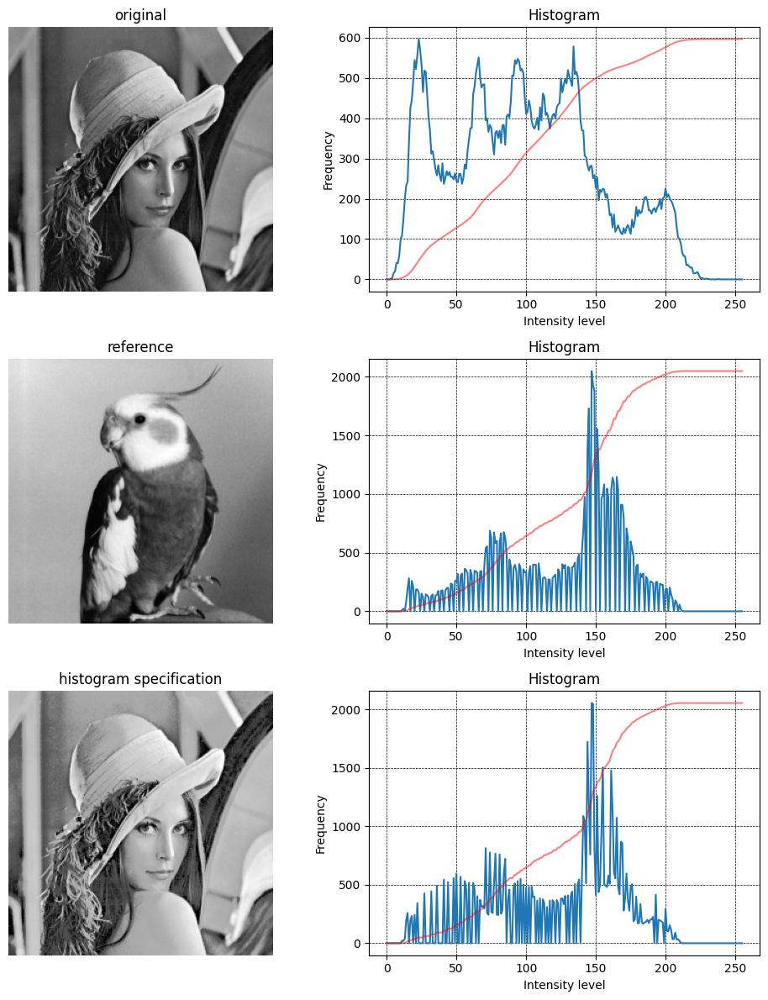

In [8]:
image = np.array(Image.open(f'{path}/lena.gif').convert('L'))
image_ref = np.array(Image.open(f'{path}/bird.gif').convert('L'))
image_hs = ImageUtils().histogram_specification(image,image_ref)

ImageUtils().images_information([image, image_ref, image_hs], ['original', 'reference', 'histogram specification'], show_cdf=True)

# Guide II.3

## 1. Pseudo-Color Techniques

Link: https://docs.opencv.org/4.x/d3/d50/group__imgproc__colormap.html

rainbow
+-----------------------------------+------------+-----------+---------------------+
| Image                             |   Contrast |   Entropy |   Average Intensity |
+===================================+============+===========+=====================+
| Original                          |        201 |      6.77 |              125.39 |
+-----------------------------------+------------+-----------+---------------------+
| Contrast Image                    |        255 |      6.77 |              144.63 |
+-----------------------------------+------------+-----------+---------------------+
| Equalized Image                   |        254 |      7.55 |              152.65 |
+-----------------------------------+------------+-----------+---------------------+
| Pseudo Color Image (cmap=rainbow) |        255 |      4.77 |              107.18 |
+-----------------------------------+------------+-----------+---------------------+


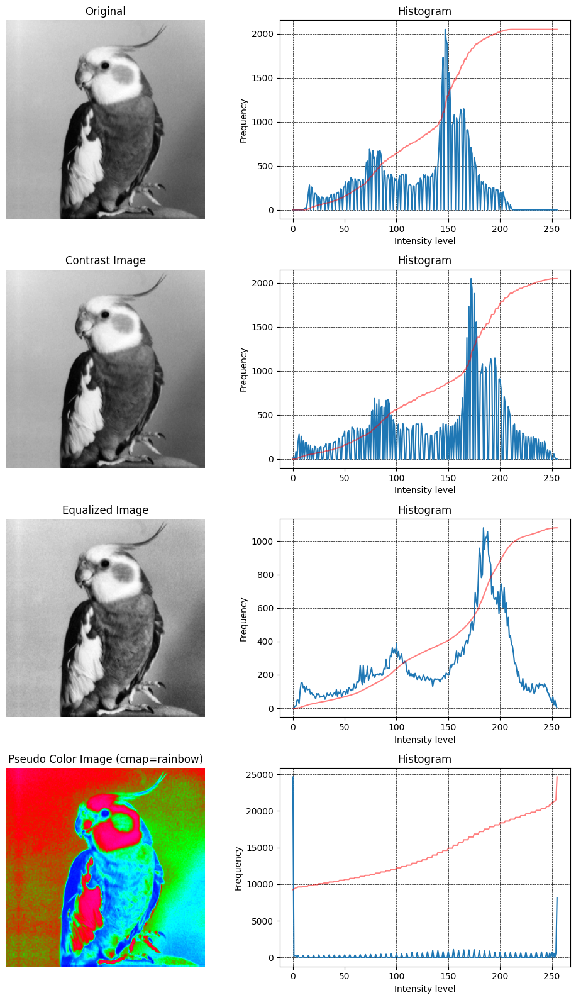

jet
+-------------------------------+------------+-----------+---------------------+
| Image                         |   Contrast |   Entropy |   Average Intensity |
+===============================+============+===========+=====================+
| Original                      |        246 |      7.01 |              118.72 |
+-------------------------------+------------+-----------+---------------------+
| Contrast Image                |        255 |      7.01 |              115.37 |
+-------------------------------+------------+-----------+---------------------+
| Equalized Image               |        254 |      7.41 |              124.25 |
+-------------------------------+------------+-----------+---------------------+
| Pseudo Color Image (cmap=jet) |        255 |      4.48 |              133.74 |
+-------------------------------+------------+-----------+---------------------+


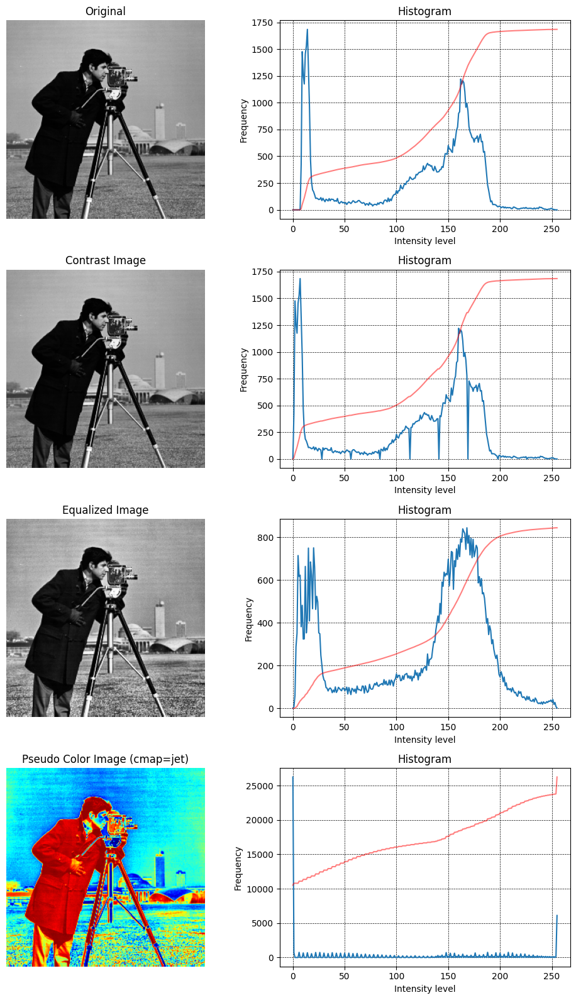

ocean
+---------------------------------+------------+-----------+---------------------+
| Image                           |   Contrast |   Entropy |   Average Intensity |
+=================================+============+===========+=====================+
| Original                        |        235 |      7.57 |               98.68 |
+---------------------------------+------------+-----------+---------------------+
| Contrast Image                  |        255 |      7.57 |              103.34 |
+---------------------------------+------------+-----------+---------------------+
| Equalized Image                 |        255 |      7.88 |              121.73 |
+---------------------------------+------------+-----------+---------------------+
| Pseudo Color Image (cmap=ocean) |        255 |      5.96 |               73.14 |
+---------------------------------+------------+-----------+---------------------+


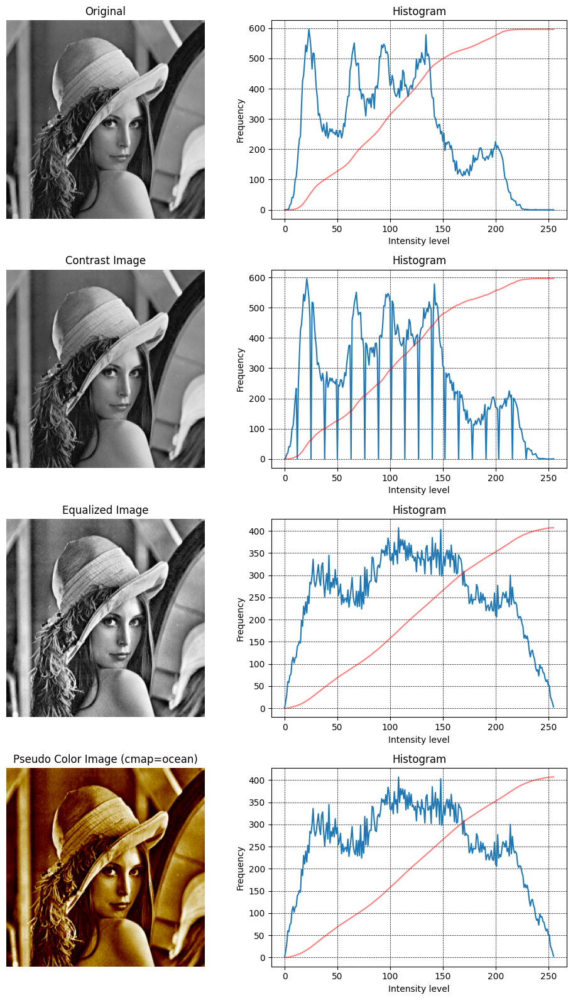

spring
+----------------------------------+------------+-----------+---------------------+
| Image                            |   Contrast |   Entropy |   Average Intensity |
+==================================+============+===========+=====================+
| Original                         |        150 |      1.08 |               67.77 |
+----------------------------------+------------+-----------+---------------------+
| Contrast Image                   |        255 |      1.08 |               30.21 |
+----------------------------------+------------+-----------+---------------------+
| Equalized Image                  |        253 |      1.67 |               33.3  |
+----------------------------------+------------+-----------+---------------------+
| Pseudo Color Image (cmap=spring) |        255 |      2.69 |              170    |
+----------------------------------+------------+-----------+---------------------+


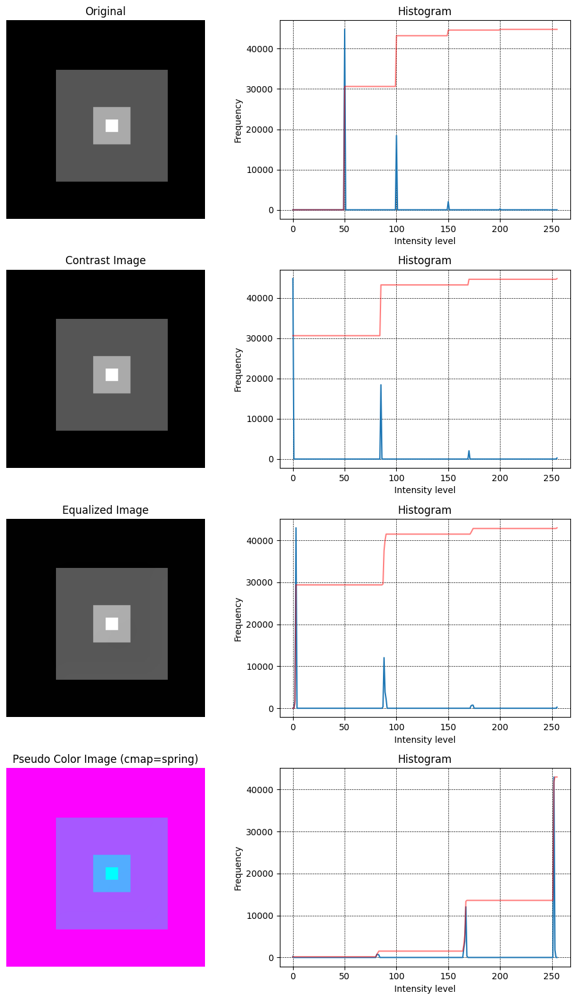

In [9]:
colorMaps = ['rainbow', 'jet', 'ocean', 'spring']

images_names = ImageUtils().get_images_from_folder(path, imgs_format=['gif'])

for set_index, image_full_path in enumerate(images_names):
    
    image = np.array(Image.open(f'{image_full_path}').convert('L'))
    image_contrast, _ = ImageUtils().contrast_stretching(image)

    image_he_classic = ImageUtils().histogram_equalization(image_contrast, EquializationMethods.CLAHE)
    print(colorMaps[set_index])
    image_pseudo_color = ImageUtils().pseudo_coloring(image_he_classic, colorMap=colorMaps[set_index])

    ImageUtils().images_information([image, image_contrast, image_he_classic, image_pseudo_color], ['Original', 'Contrast Image', 'Equalized Image', f'Pseudo Color Image (cmap={colorMaps[set_index]})'], show_cdf=True)

## 2. Grayscale and Color Image Analysis and Restoration


+------------+------------+-----------+---------------------+
| Image      |   Contrast |   Entropy |   Average Intensity |
+============+============+===========+=====================+
| face.bmp   |        217 |      6.83 |              126.4  |
+------------+------------+-----------+---------------------+
| face_1.bmp |        233 |      7.46 |              126.44 |
+------------+------------+-----------+---------------------+
| face_2.bmp |        238 |      7.57 |              126.52 |
+------------+------------+-----------+---------------------+
| face_3.bmp |        248 |      7.64 |              126.47 |
+------------+------------+-----------+---------------------+
| face_4.bmp |        254 |      7.67 |              126.59 |
+------------+------------+-----------+---------------------+
| face_5.bmp |        255 |      7.7  |              126.7  |
+------------+------------+-----------+---------------------+


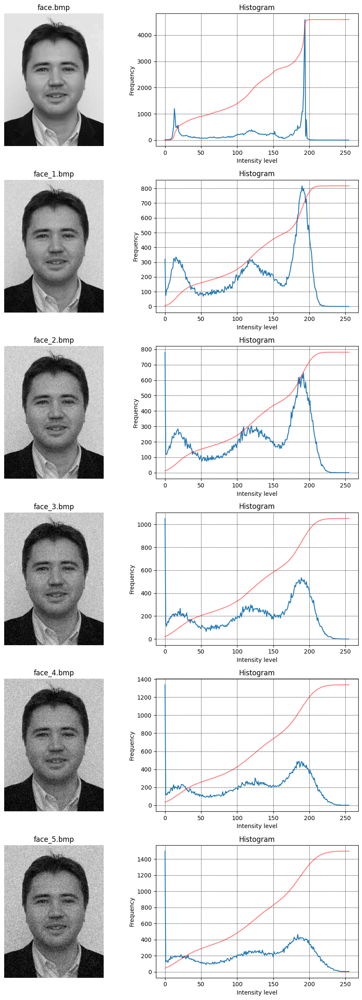

+------------------+------------+-----------+---------------------+
| Image            |   Contrast |   Entropy |   Average Intensity |
+==================+============+===========+=====================+
| thermogram.bmp   |        229 |      5.91 |              100.79 |
+------------------+------------+-----------+---------------------+
| thermogram_1.bmp |        255 |      5.91 |              101.03 |
+------------------+------------+-----------+---------------------+
| thermogram_2.bmp |        255 |      5.9  |              101.13 |
+------------------+------------+-----------+---------------------+
| thermogram_3.bmp |        255 |      5.87 |              101.39 |
+------------------+------------+-----------+---------------------+
| thermogram_4.bmp |        255 |      5.86 |              102.08 |
+------------------+------------+-----------+---------------------+
| thermogram_5.bmp |        255 |      5.83 |              102.33 |
+------------------+------------+-----------+---

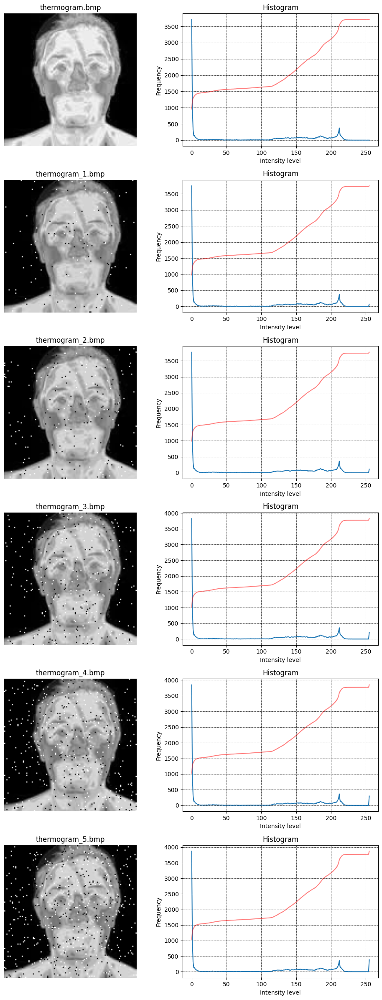

+------------+------------+-----------+---------------------+
| Image      |   Contrast |   Entropy |   Average Intensity |
+============+============+===========+=====================+
| iris.bmp   |        255 |      7.71 |               95.78 |
+------------+------------+-----------+---------------------+
| iris_1.bmp |        253 |      7.67 |               95.23 |
+------------+------------+-----------+---------------------+
| iris_2.bmp |        250 |      7.66 |               95    |
+------------+------------+-----------+---------------------+
| iris_3.bmp |        238 |      7.65 |               94.77 |
+------------+------------+-----------+---------------------+
| iris_4.bmp |        229 |      7.64 |               94.54 |
+------------+------------+-----------+---------------------+
| iris_5.bmp |        228 |      7.63 |               94.32 |
+------------+------------+-----------+---------------------+


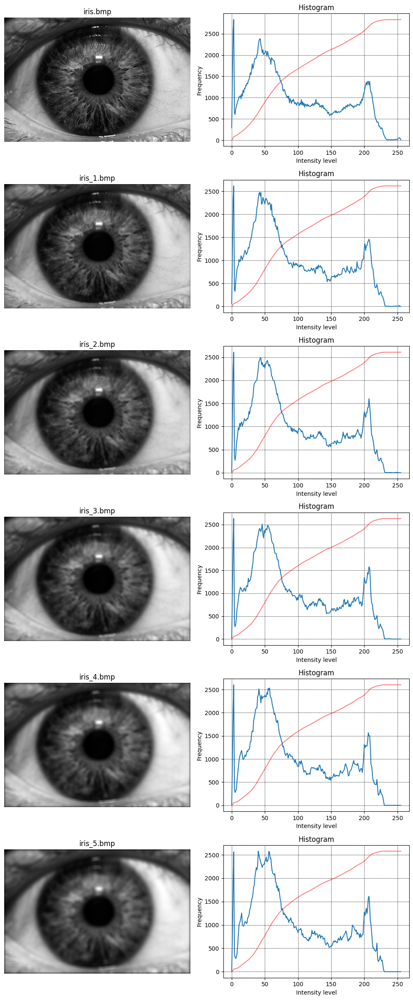

In [10]:
images_names = ['face', 'thermogram', 'iris']
format = 'bmp'

path = "../../src/TP2/dataset/grayscaleNoisyImages/"

similar_images = []
for set_index, image_full_path in enumerate(images_names):
    images = ImageUtils().get_images_from_folder(path, imgs_format=[format], contains=images_names[set_index])

    all_similar_images = []
    for image in images: 
        all_similar_images.append(np.array(Image.open(f'{image}').convert('L')))

    ImageUtils().images_information(images=all_similar_images, titles=[image.split('/')[-1] for image in images], show_cdf=True)

    similar_images.append(all_similar_images)

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     19.99 |                      113.06 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        217 |      6.83 |              126.4  |
+----------+------------+-----------+---------------------+
| Noisy    |        233 |      7.46 |              126.44 |
+----------+------------+-----------+---------------------+
| Cleaned  |        200 |      7.1  |              126.44 |
+----------+------------+-----------+---------------------+


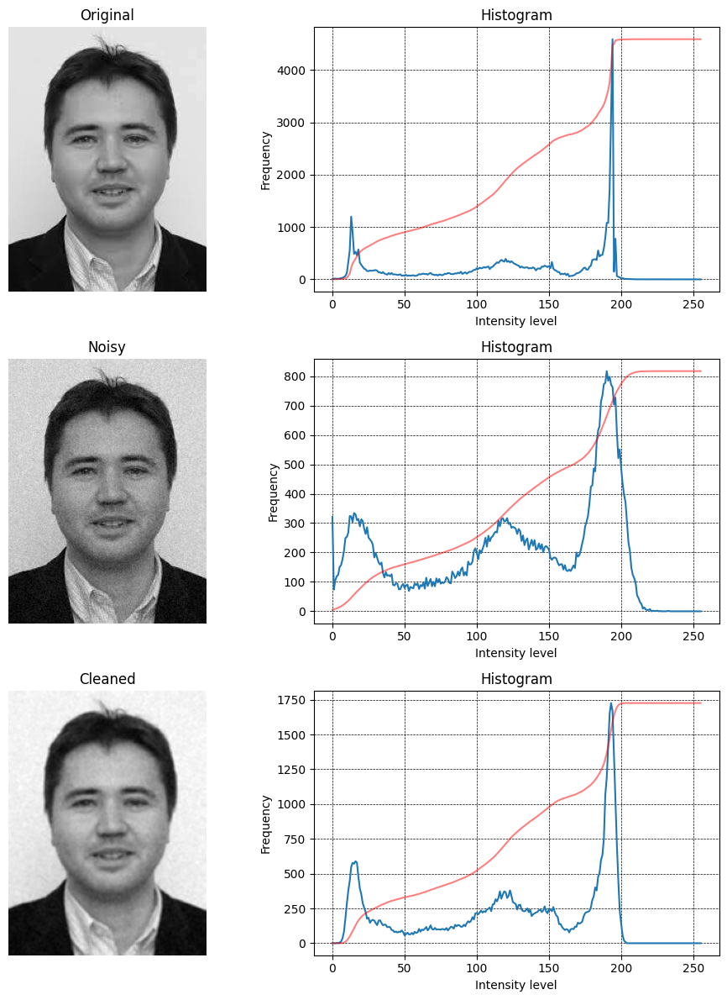

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                        26 |                      118.51 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        217 |      6.83 |              126.4  |
+----------+------------+-----------+---------------------+
| Noisy    |        238 |      7.57 |              126.52 |
+----------+------------+-----------+---------------------+
| Cleaned  |        207 |      7.19 |              126.5  |
+----------+------------+-----------+---------------------+


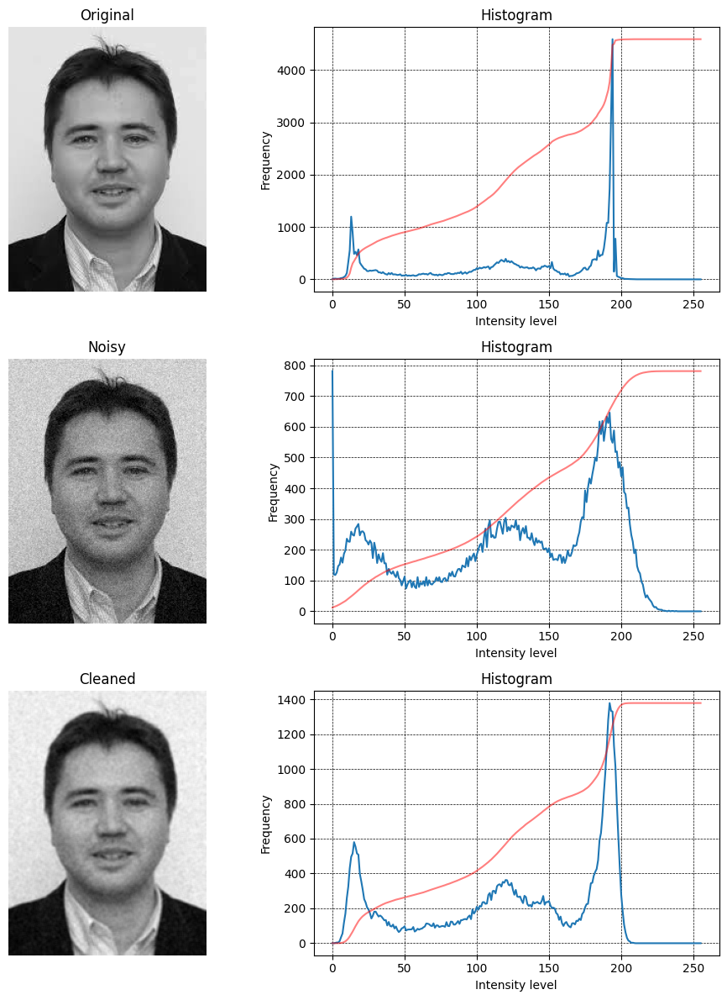

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                      31.9 |                      119.62 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        217 |      6.83 |              126.4  |
+----------+------------+-----------+---------------------+
| Noisy    |        248 |      7.64 |              126.47 |
+----------+------------+-----------+---------------------+
| Cleaned  |        213 |      7.25 |              126.48 |
+----------+------------+-----------+---------------------+


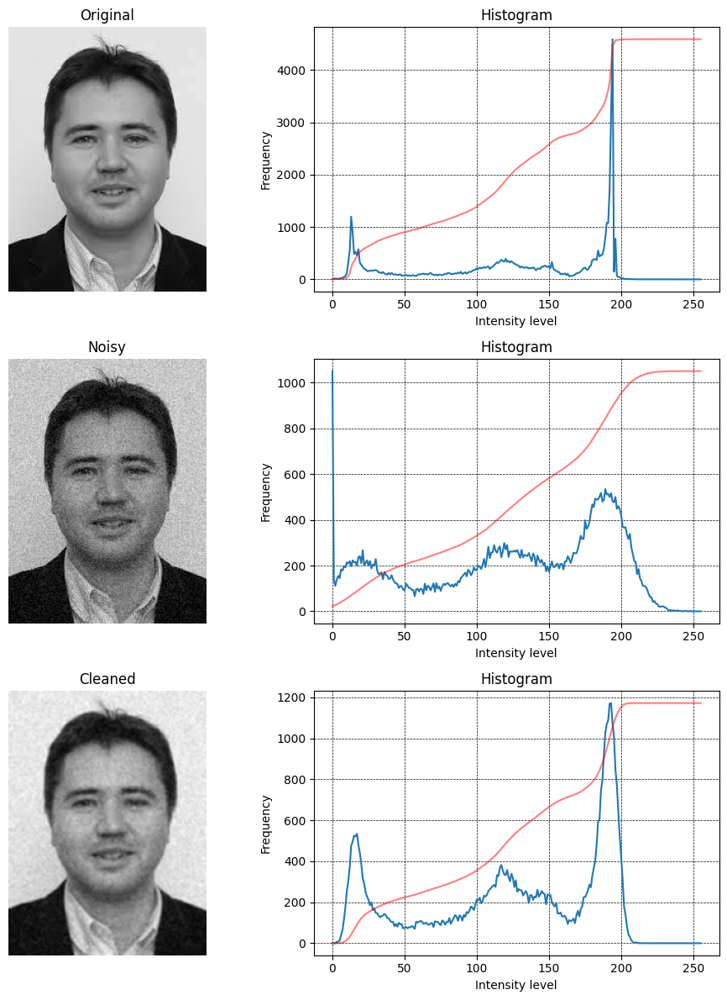

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     36.87 |                       122.3 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        217 |      6.83 |              126.4  |
+----------+------------+-----------+---------------------+
| Noisy    |        254 |      7.67 |              126.59 |
+----------+------------+-----------+---------------------+
| Cleaned  |        211 |      7.3  |              126.59 |
+----------+------------+-----------+---------------------+


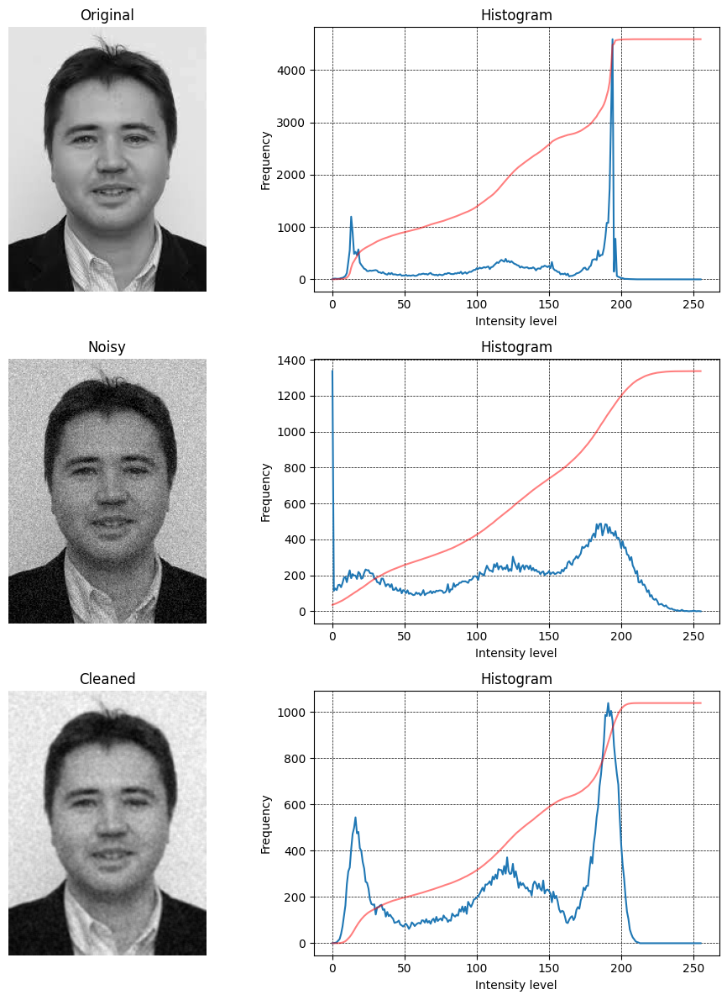

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     41.29 |                      125.32 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        217 |      6.83 |              126.4  |
+----------+------------+-----------+---------------------+
| Noisy    |        255 |      7.7  |              126.7  |
+----------+------------+-----------+---------------------+
| Cleaned  |        212 |      7.32 |              126.71 |
+----------+------------+-----------+---------------------+


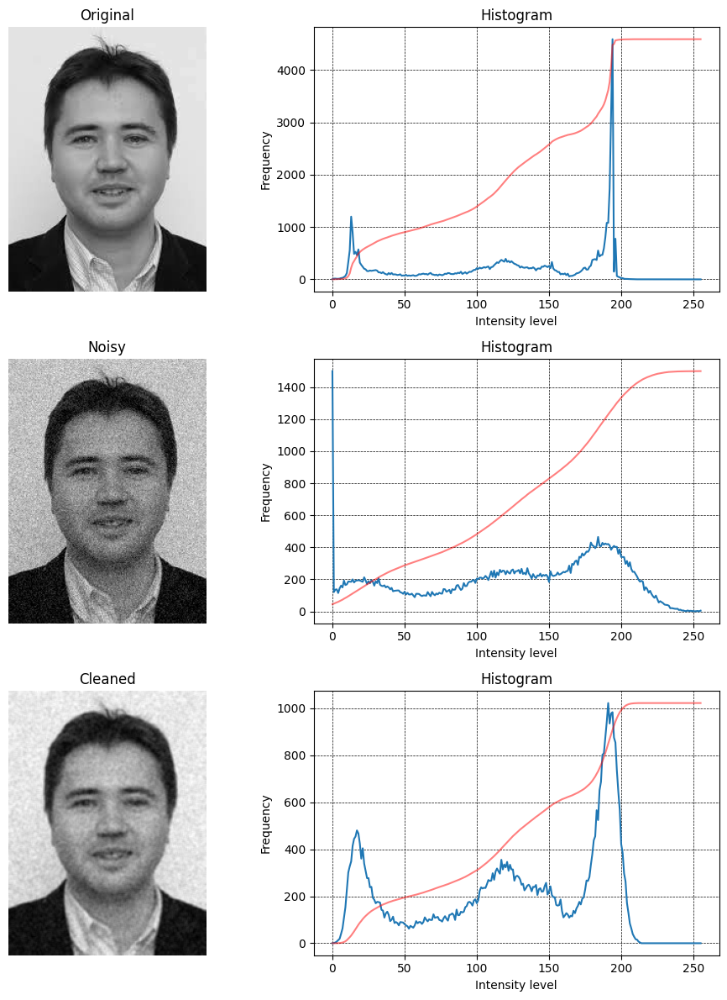

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     14.89 |                       54.12 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        229 |      5.91 |              100.79 |
+----------+------------+-----------+---------------------+
| Noisy    |        255 |      5.91 |              101.03 |
+----------+------------+-----------+---------------------+
| Cleaned  |        218 |      5.82 |              100.76 |
+----------+------------+-----------+---------------------+


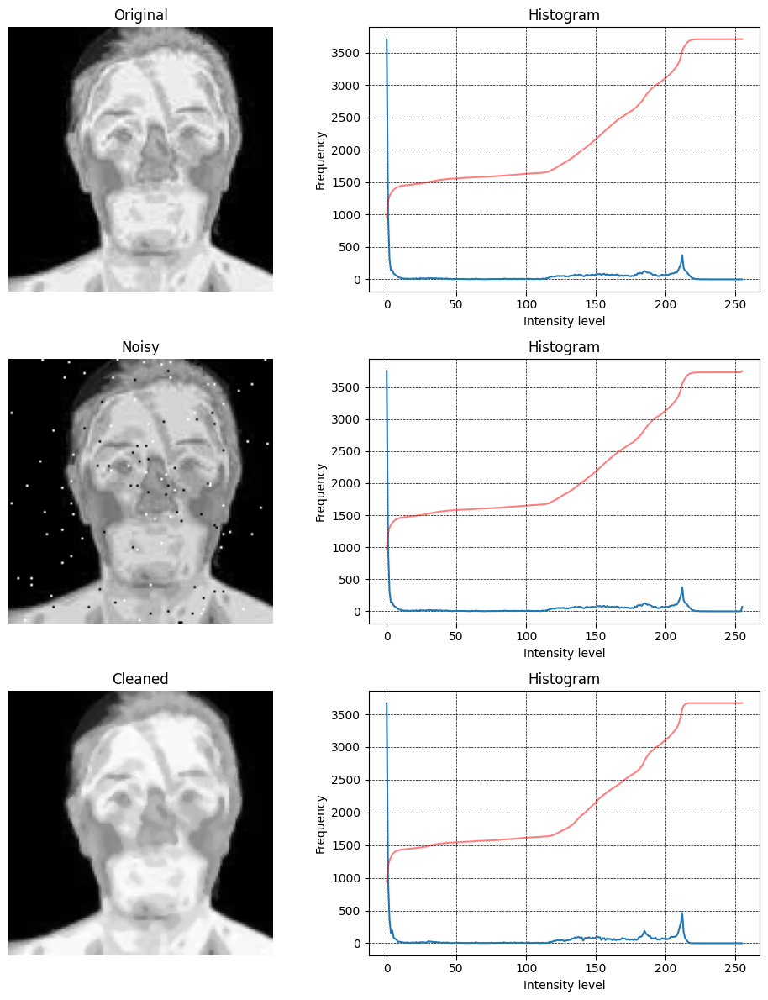

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     15.26 |                       53.94 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        229 |      5.91 |              100.79 |
+----------+------------+-----------+---------------------+
| Noisy    |        255 |      5.9  |              101.13 |
+----------+------------+-----------+---------------------+
| Cleaned  |        217 |      5.81 |              100.72 |
+----------+------------+-----------+---------------------+


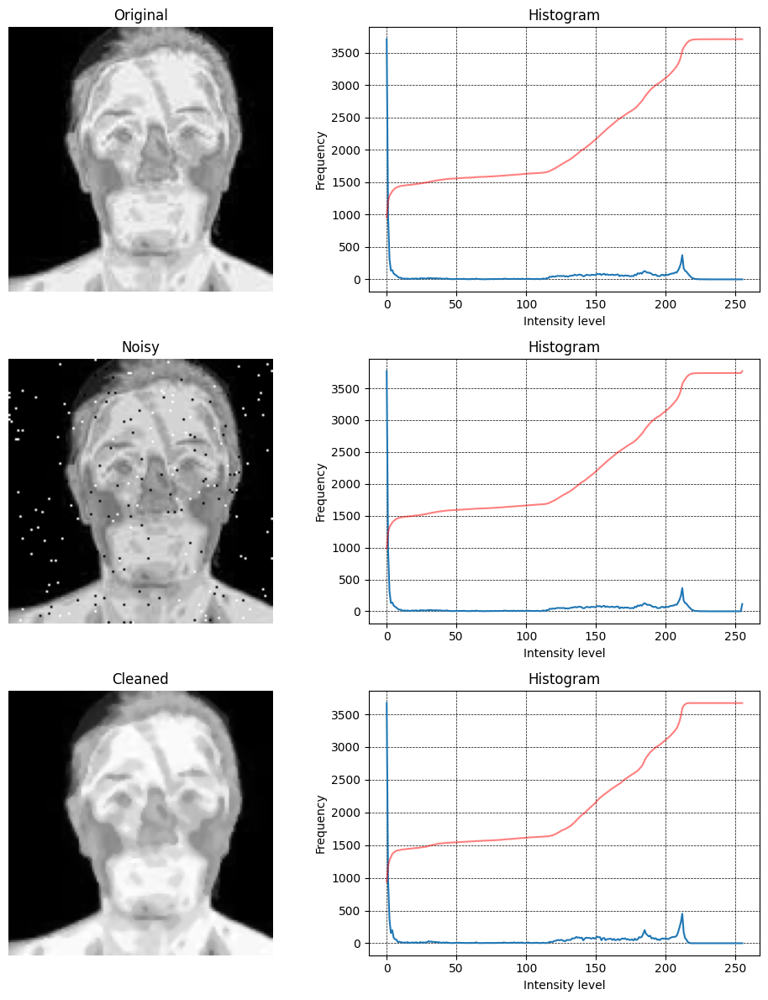

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     15.82 |                       55.21 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        229 |      5.91 |              100.79 |
+----------+------------+-----------+---------------------+
| Noisy    |        255 |      5.87 |              101.39 |
+----------+------------+-----------+---------------------+
| Cleaned  |        217 |      5.82 |              100.74 |
+----------+------------+-----------+---------------------+


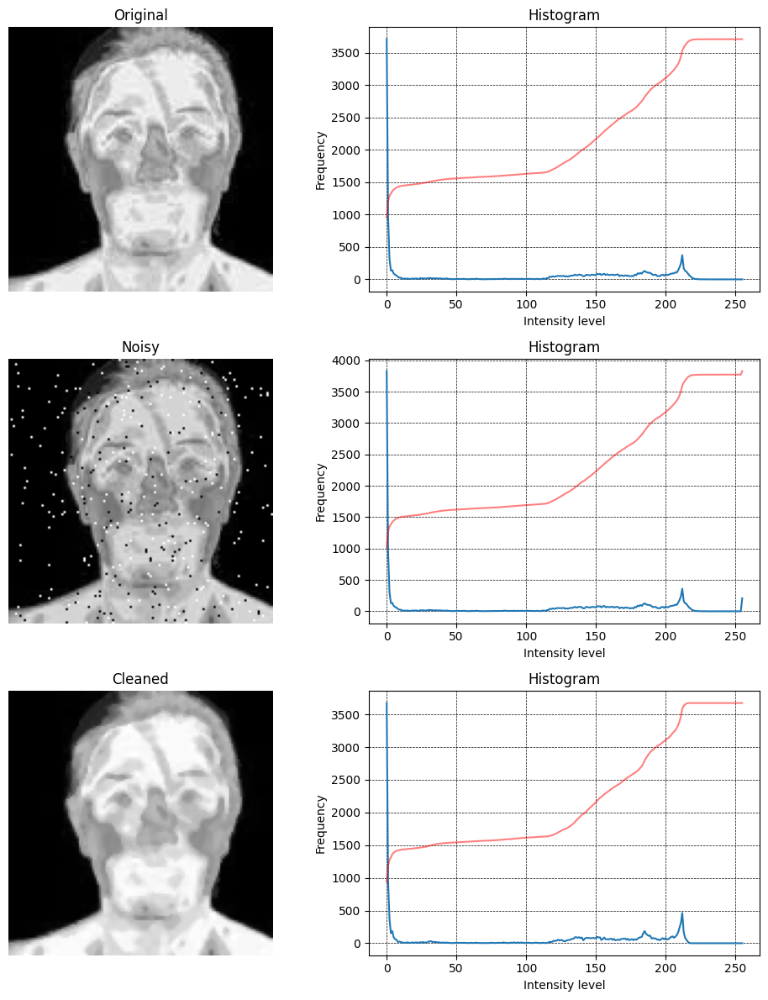

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     16.32 |                       56.21 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        229 |      5.91 |              100.79 |
+----------+------------+-----------+---------------------+
| Noisy    |        255 |      5.86 |              102.08 |
+----------+------------+-----------+---------------------+
| Cleaned  |        217 |      5.81 |              100.79 |
+----------+------------+-----------+---------------------+


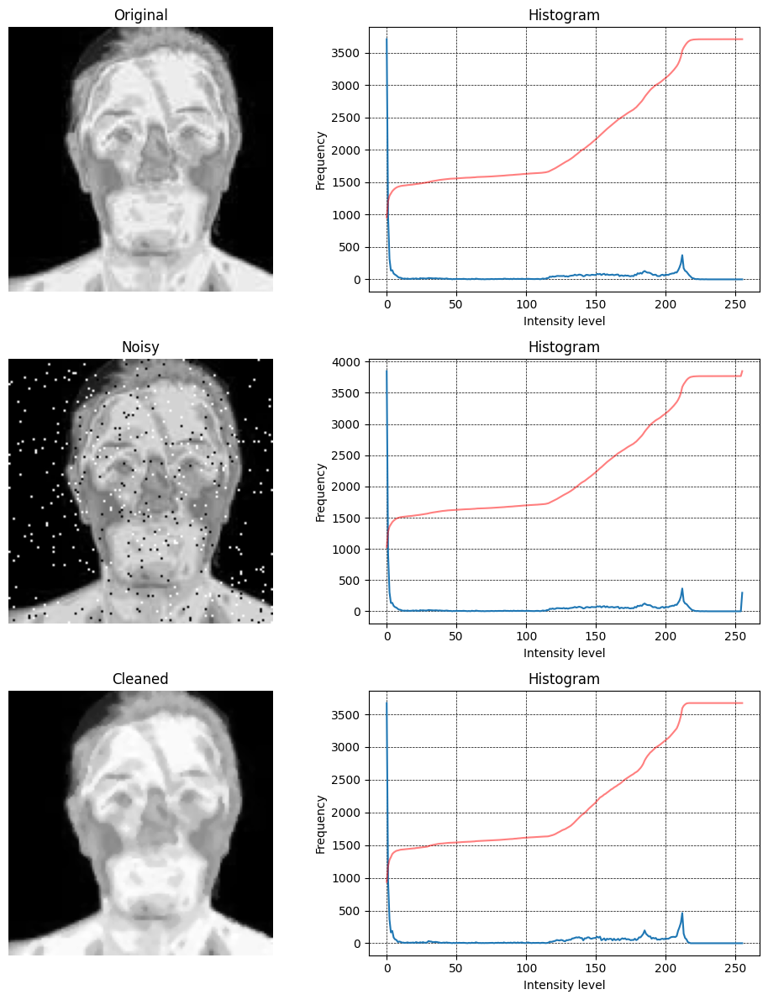

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     16.78 |                       56.54 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        229 |      5.91 |              100.79 |
+----------+------------+-----------+---------------------+
| Noisy    |        255 |      5.83 |              102.33 |
+----------+------------+-----------+---------------------+
| Cleaned  |        217 |      5.82 |              100.77 |
+----------+------------+-----------+---------------------+


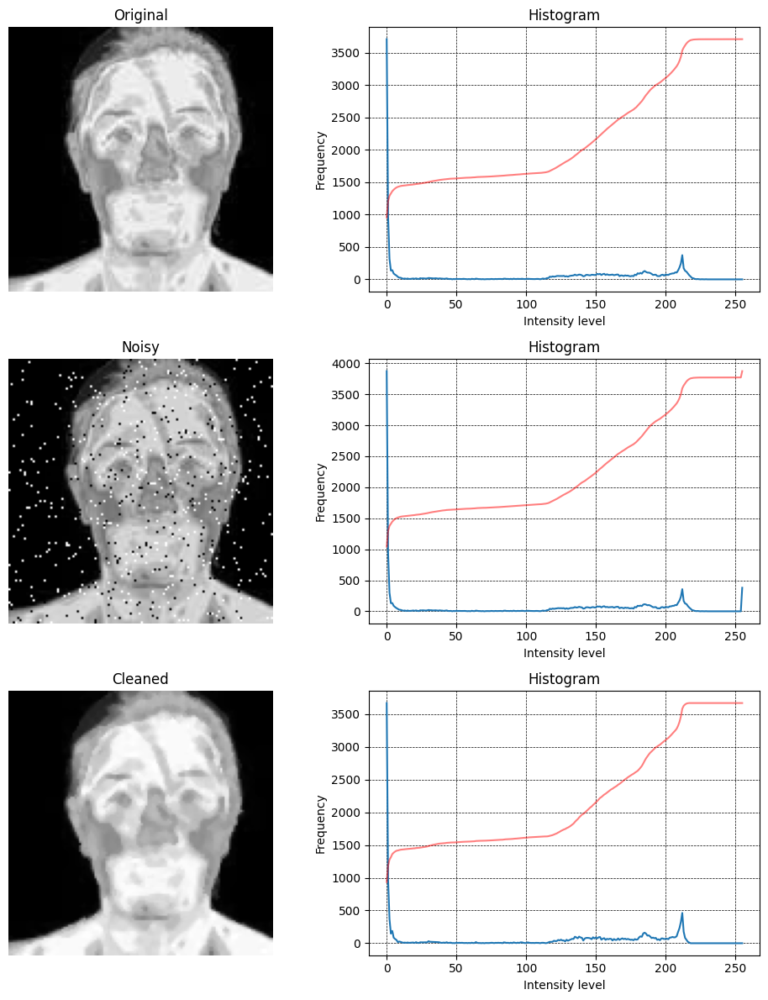

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     37.44 |                      157.96 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        255 |      7.71 |               95.78 |
+----------+------------+-----------+---------------------+
| Noisy    |        253 |      7.67 |               95.23 |
+----------+------------+-----------+---------------------+
| Mask     |          1 |      0.99 |                0.46 |
+----------+------------+-----------+---------------------+
| Enhanced |        255 |      7.71 |               97.49 |
+----------+------------+-----------+---------------------+


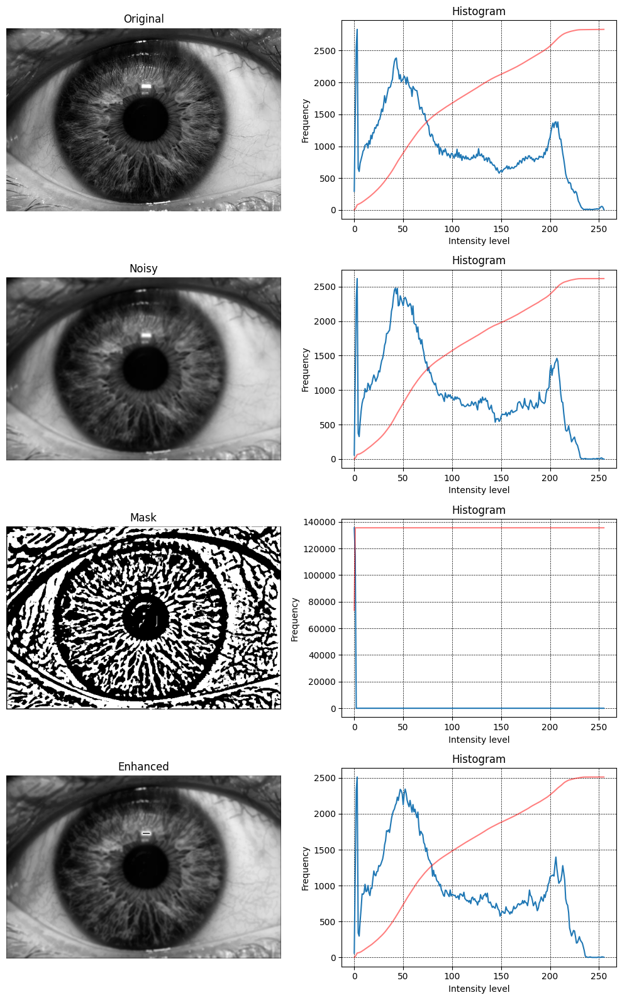

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     60.82 |                      170.15 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        255 |      7.71 |               95.78 |
+----------+------------+-----------+---------------------+
| Noisy    |        250 |      7.66 |               95    |
+----------+------------+-----------+---------------------+
| Mask     |          1 |      1    |                0.48 |
+----------+------------+-----------+---------------------+
| Enhanced |        255 |      7.74 |               99.81 |
+----------+------------+-----------+---------------------+


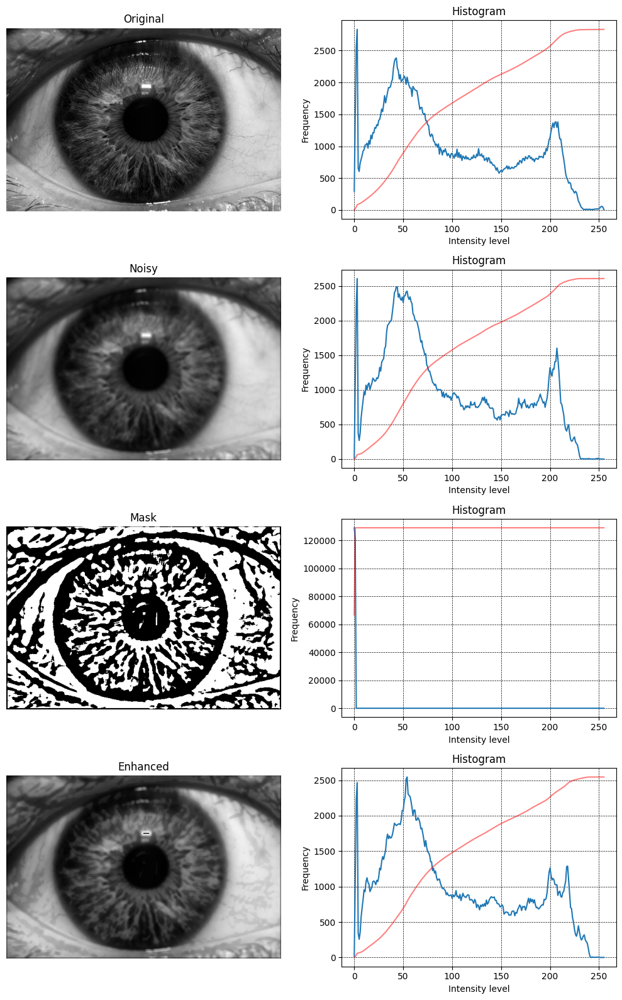

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     73.97 |                      174.63 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        255 |      7.71 |               95.78 |
+----------+------------+-----------+---------------------+
| Noisy    |        238 |      7.65 |               94.77 |
+----------+------------+-----------+---------------------+
| Mask     |          1 |      1    |                0.48 |
+----------+------------+-----------+---------------------+
| Enhanced |        253 |      7.77 |              101.92 |
+----------+------------+-----------+---------------------+


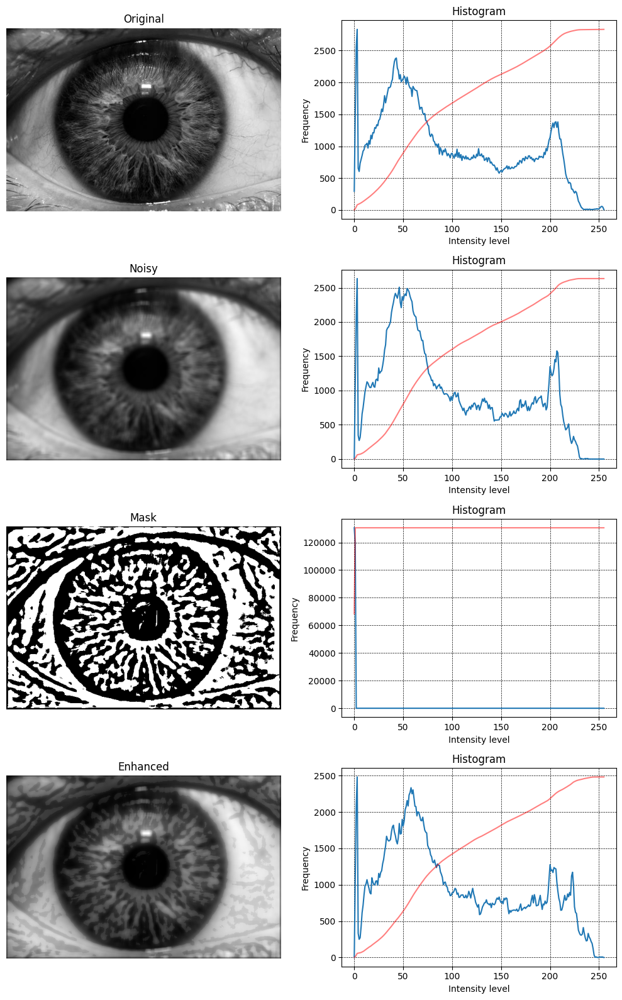

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     71.65 |                      170.81 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        255 |      7.71 |               95.78 |
+----------+------------+-----------+---------------------+
| Noisy    |        229 |      7.64 |               94.54 |
+----------+------------+-----------+---------------------+
| Mask     |          1 |      0.98 |                0.42 |
+----------+------------+-----------+---------------------+
| Enhanced |        249 |      7.79 |              103.02 |
+----------+------------+-----------+---------------------+


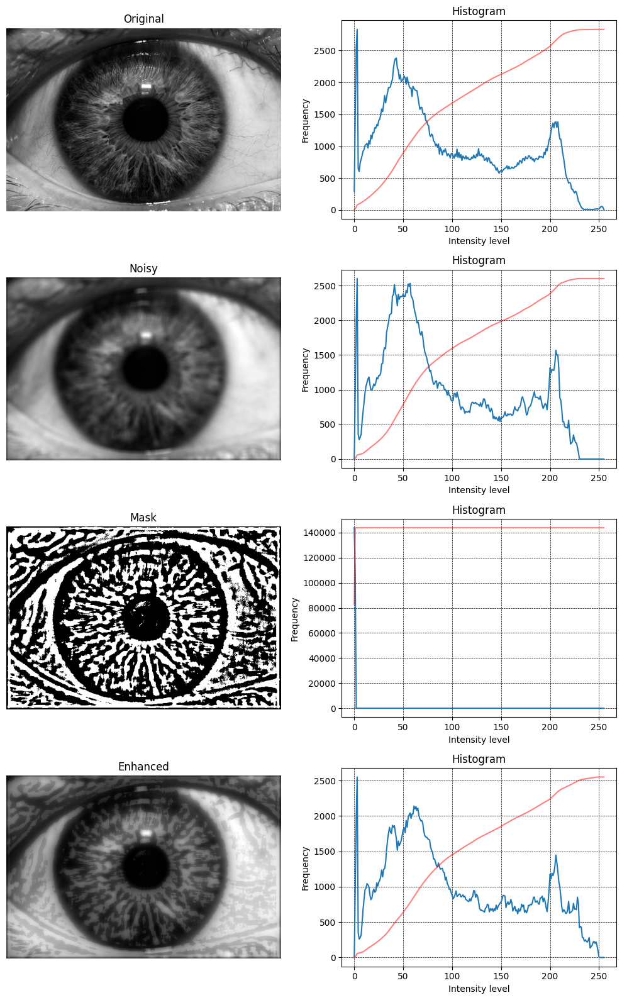

+---------------------------+-----------------------------+
|   Mean Square Error (MSE) |   Mean Absolute Error (MAE) |
+===========================+=============================+
|                     60.95 |                      139.48 |
+---------------------------+-----------------------------+
+----------+------------+-----------+---------------------+
| Image    |   Contrast |   Entropy |   Average Intensity |
+==========+============+===========+=====================+
| Original |        255 |      7.71 |               95.78 |
+----------+------------+-----------+---------------------+
| Noisy    |        228 |      7.63 |               94.32 |
+----------+------------+-----------+---------------------+
| Mask     |          1 |      0.72 |                0.2  |
+----------+------------+-----------+---------------------+
| Enhanced |        253 |      7.73 |               99.32 |
+----------+------------+-----------+---------------------+


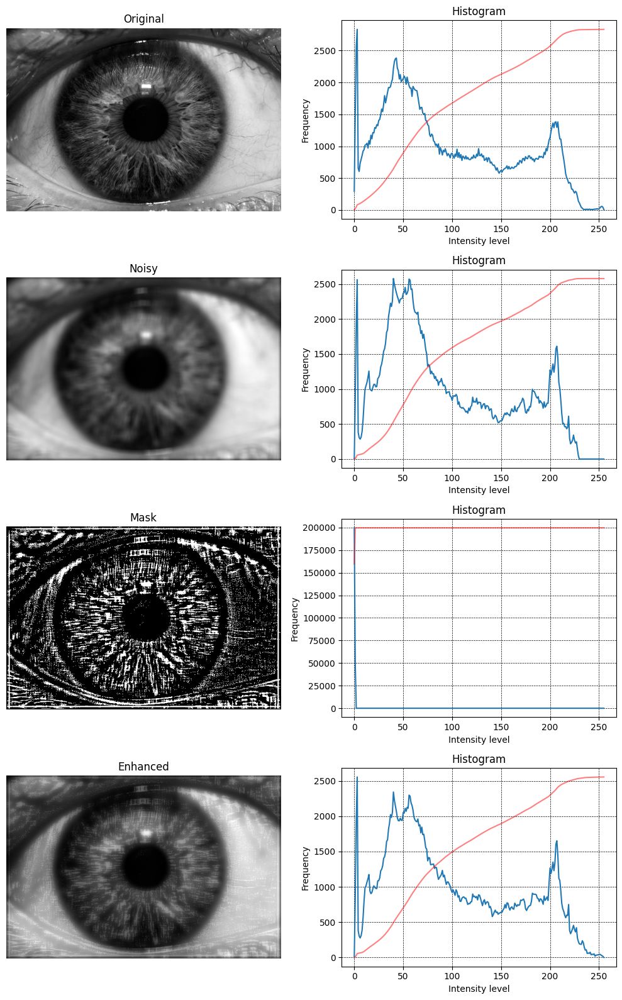

In [11]:
kernel_enhacement = [49, 37, 25, 13, 5, 3]
mask_weight = [5, 10, 15, 20, 25, 30]

for set_index, set in enumerate(similar_images):
    original_image = set[0]
    noisy_images = set[1:]

    for image_idx, image in enumerate(noisy_images):
        cleaned_image, mask = None, None

        if set_index == 0:
            # Remove gaussian noise
            cleaned_image = ImageUtils().remove_gaussian_noise(image, kernel=3, sigma=5.0)
        
        elif set_index == 1:
            # Remove salt and pepper noise
            cleaned_image = ImageUtils().remove_salt_and_pepper_noise(image)

        elif set_index == 2: 
            # Image Enhancement
            cleaned_image, mask = ImageUtils().enhance_image(image, kernel=kernel_enhacement[image_idx], k=mask_weight[image_idx])

        ImageUtils().print_standard_metrics(original_image, cleaned_image)

        if mask is not None:
            ImageUtils().images_information(images=[original_image, image, mask, cleaned_image], titles=["Original", "Noisy", "Mask", "Enhanced"], show_cdf=True)
        else:
            ImageUtils().images_information(images=[original_image, image, cleaned_image], titles=["Original", "Noisy", "Cleaned"], show_cdf=True)

## 3. Minutiae Detection for Fingerprint Recognition

c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\fingerprint_feature_extractor\__init__.py:78: FutureWarning: `square` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  self._mask = erosion(self._mask, square(5))  # Structuing element for mask erosion = square(5)


[<fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BCA60>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BDF60>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BC400>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BD5D0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BC880>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BE9E0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BF6A0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BE200>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BEE30>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BF460>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BF7C0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BFA00>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x0000

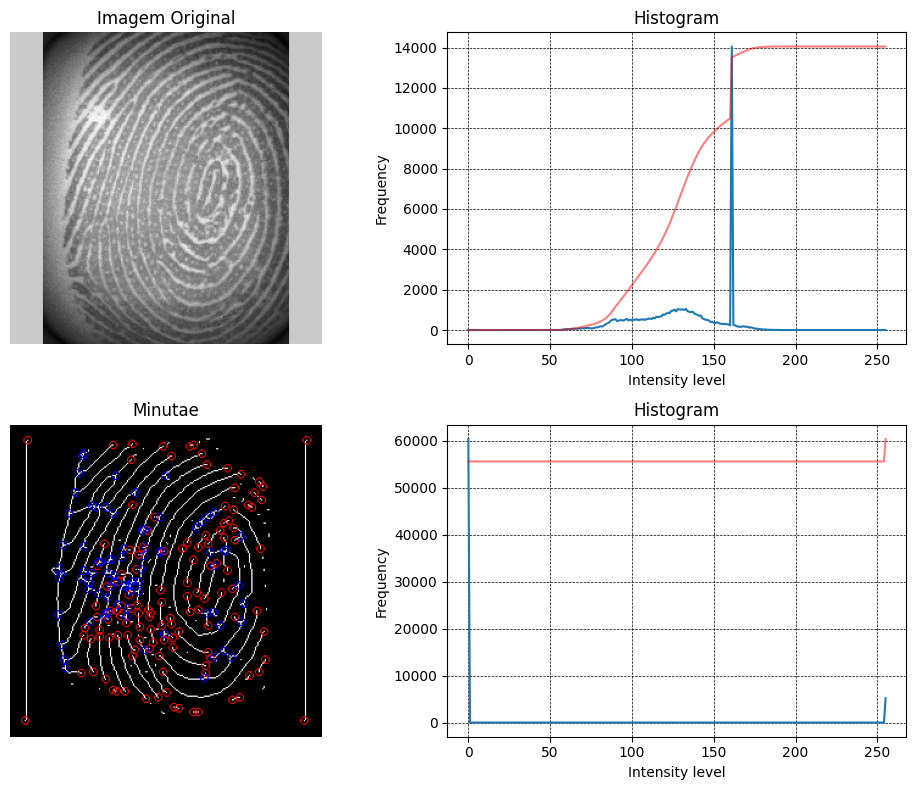

[<fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871489C60>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871488DC0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871489360>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87148A680>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871488F10>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871488E50>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8714896F0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871488790>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8714894E0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87148B460>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87148BA30>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87148B520>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x0000

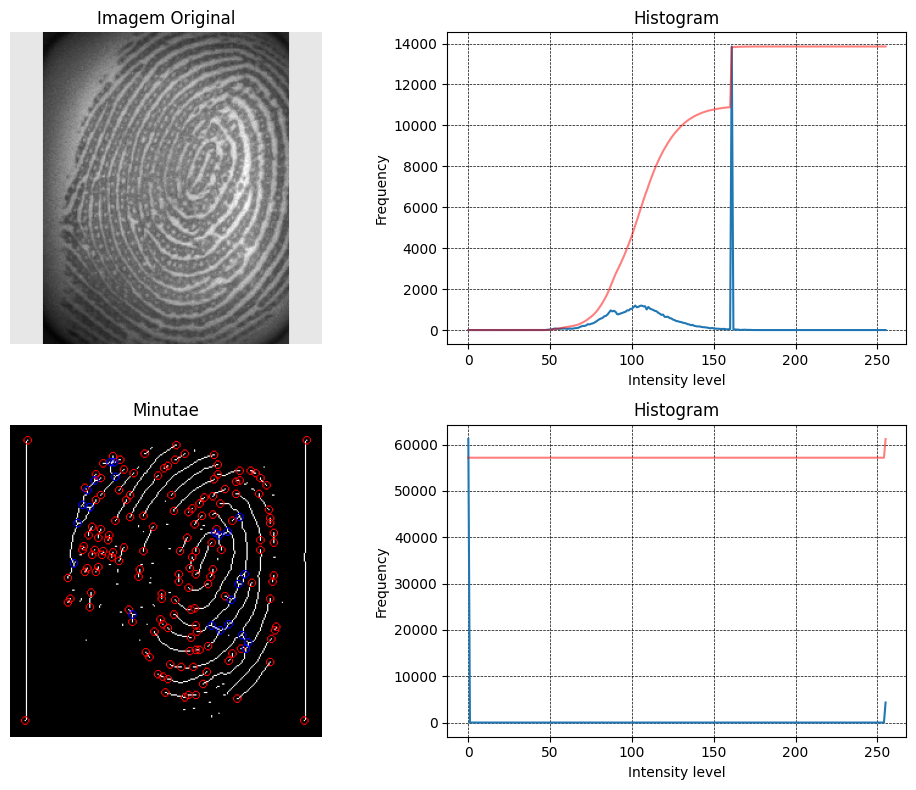

[<fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871587190>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871585F60>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8715854E0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871586FE0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871585360>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871586590>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8715872E0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8715866B0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871586290>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871519F90>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8715196C0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871519720>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x0000

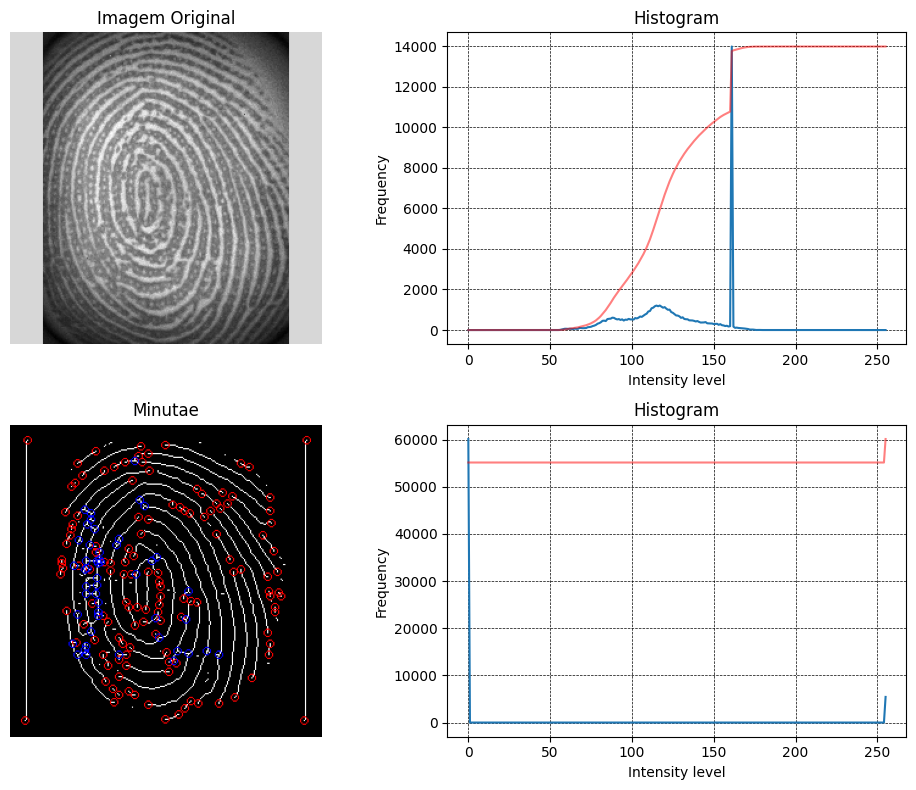

[<fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871365300>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8713674F0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871367640>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8713647C0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871365ED0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871364130>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871365CF0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8713674C0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871365DE0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871364520>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8713676D0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871364280>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x0000

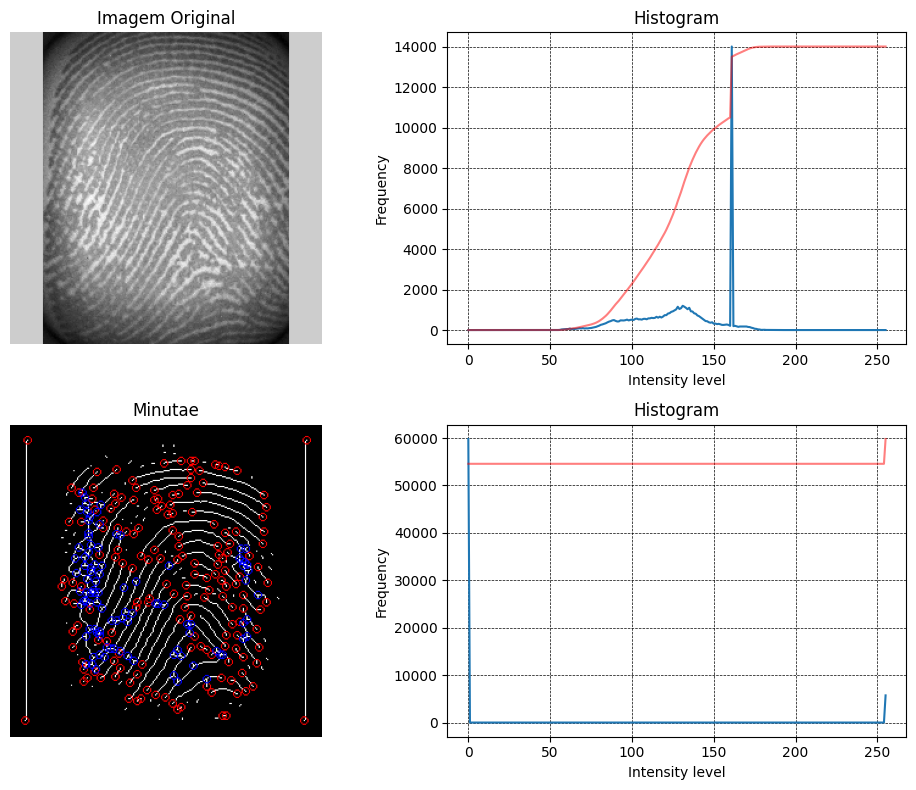

[<fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87175B460>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87175AC50>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8717597B0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87175B490>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87175B7C0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871758F70>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87175A2F0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87175A650>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87175A770>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87175BEB0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871758160>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871758220>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x0000

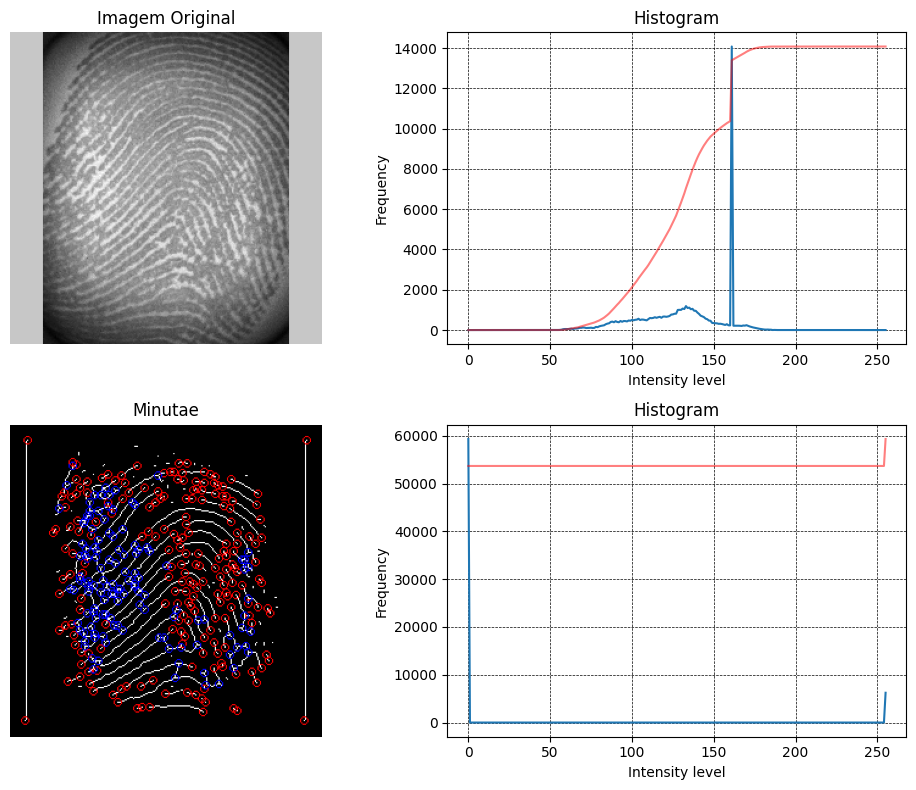

[<fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8718A2320>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8718A0D30>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8718A0D60>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8718A15A0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8718A0DC0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8718A0E80>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8718A25C0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8718A2950>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8718A2650>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8718A2A40>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8718A21D0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8718A2500>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x0000

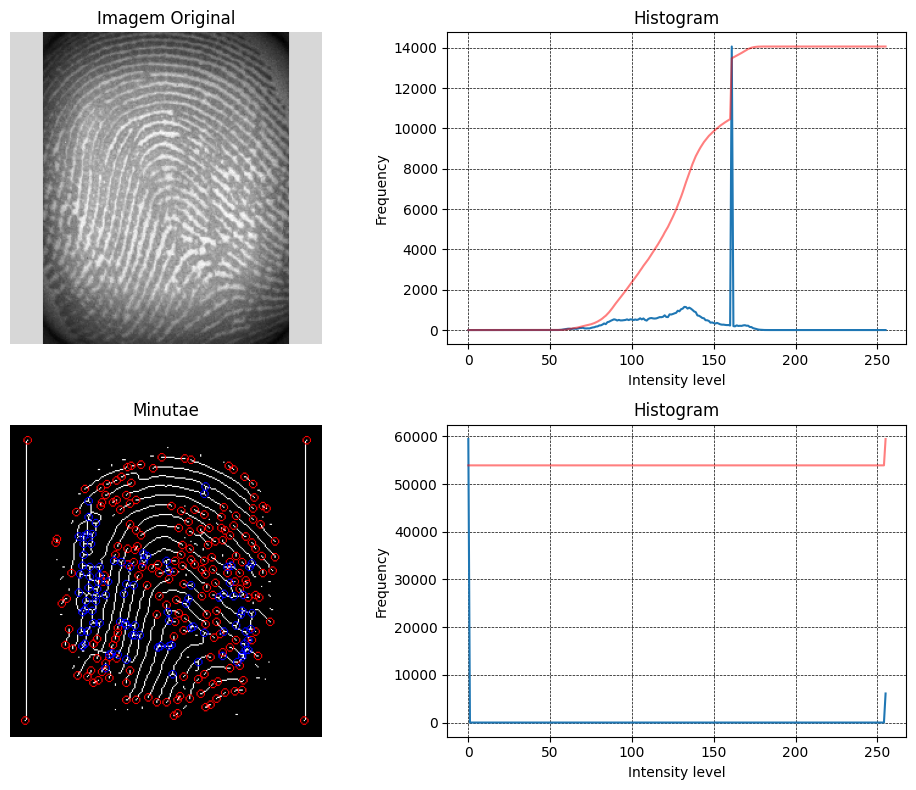

[<fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871617310>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871615BA0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8716141F0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8716176D0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871616050>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871617100>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871616620>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8716150F0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871617730>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8716149D0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871617940>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871614A30>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x0000

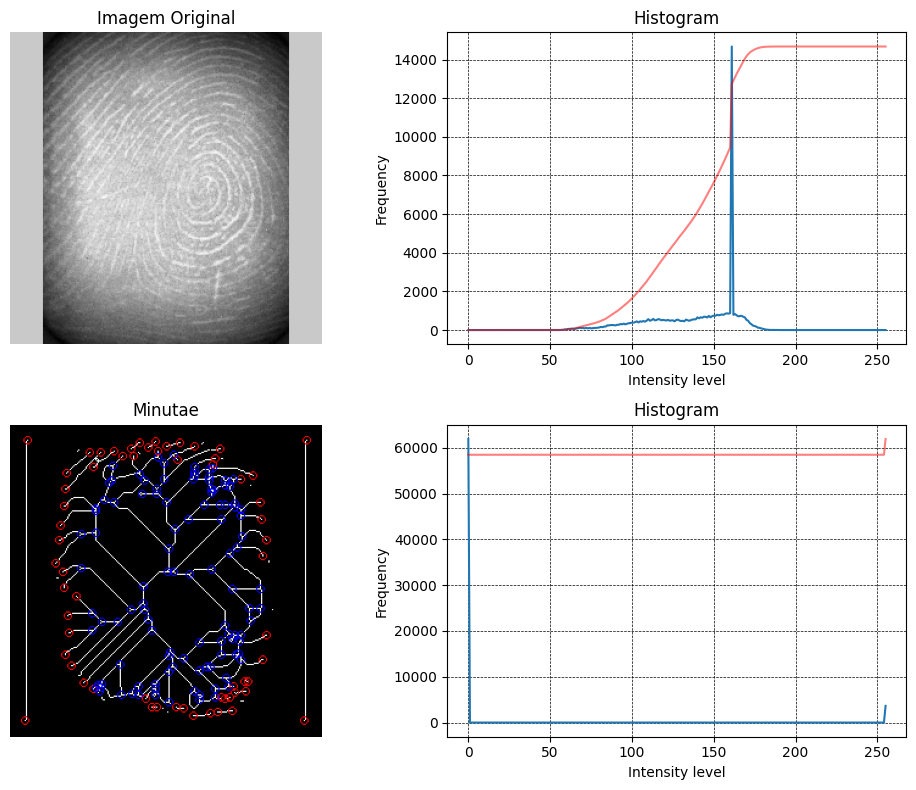

[<fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871973C10>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719717B0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871971CF0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871970340>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871973B80>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719726B0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871972B60>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719738B0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871973850>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719727A0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719732B0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871972FB0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x0000

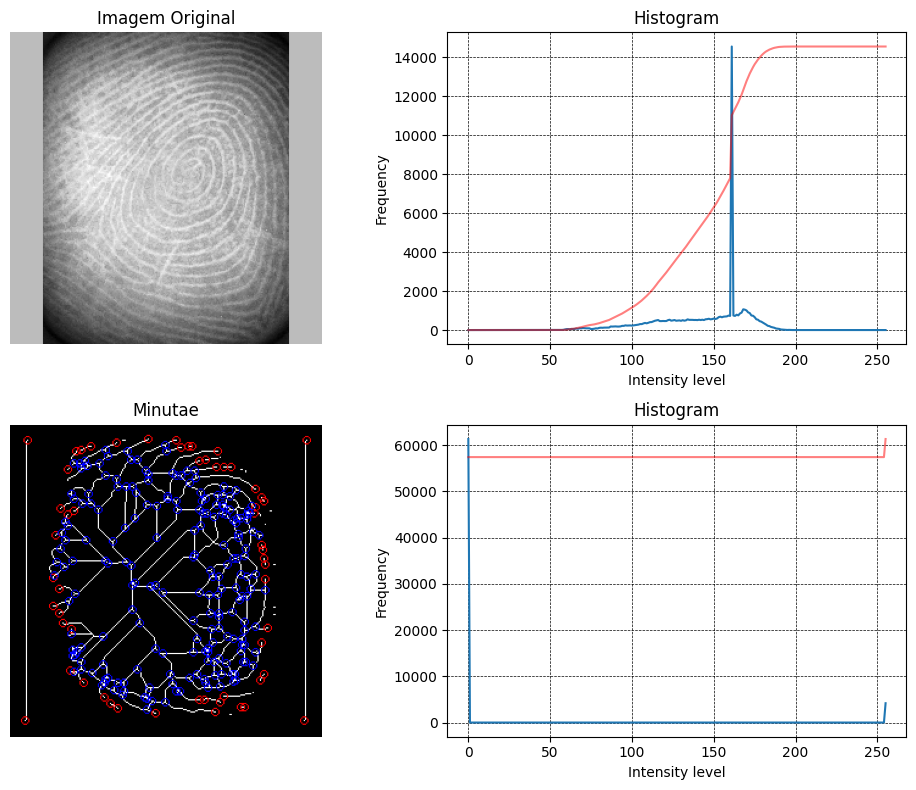

[<fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87154AD70>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87154AA10>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87154B880>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87154ACE0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871549C00>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87154A170>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87154B310>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87154B1F0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87154B340>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871548250>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F871548E50>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87154A470>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x0000

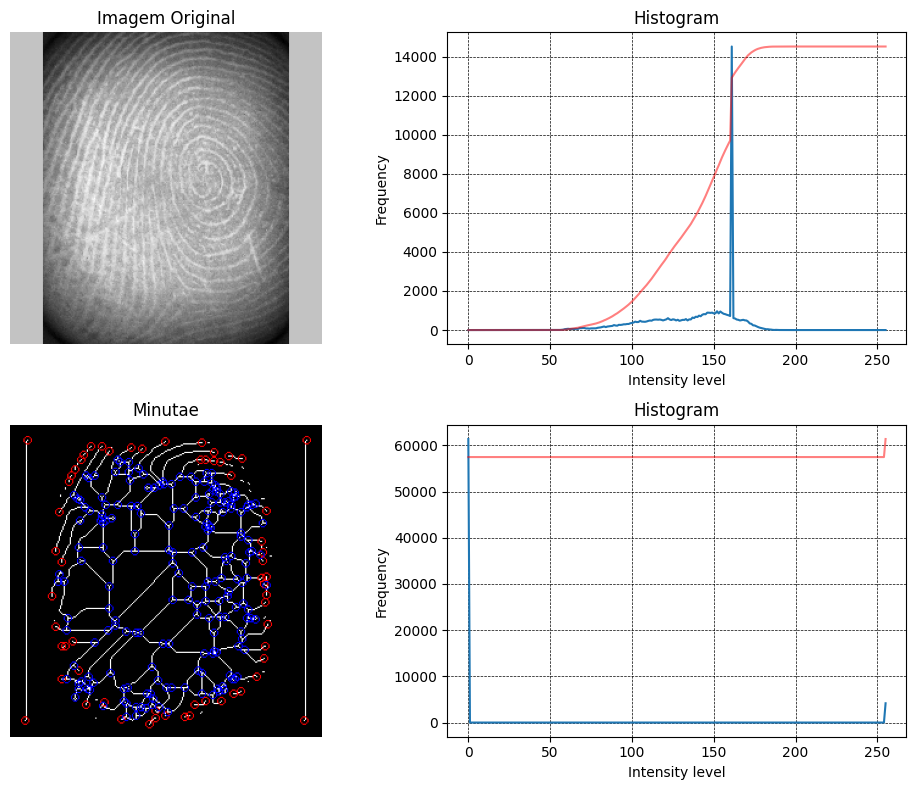

[<fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87164EF50>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87164F100>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87164F220>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87164F160>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87164D3F0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87164E860>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87164E8F0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87164D420>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87164D1E0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87164E8C0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87164C190>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F87164F040>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x0000

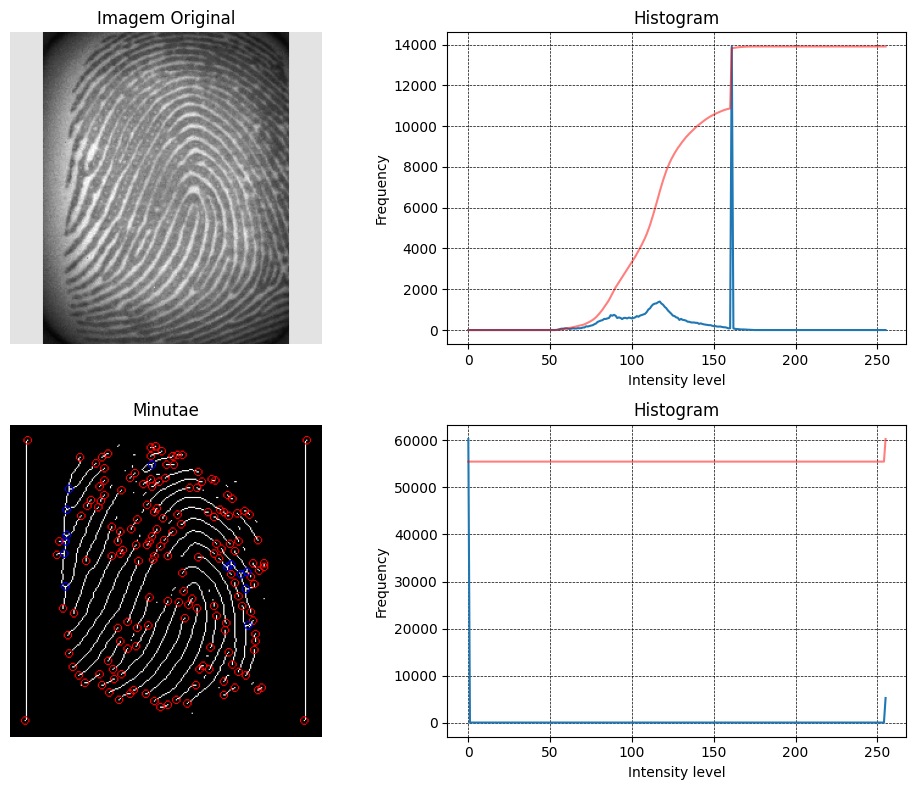

[<fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8712D4730>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8712D6B60>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8712D7400>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8712D4AC0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8712D56F0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8712D4B50>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8712D4280>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8712D58D0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8712D4250>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8712D7AC0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8712D6F20>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8712D6FE0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x0000

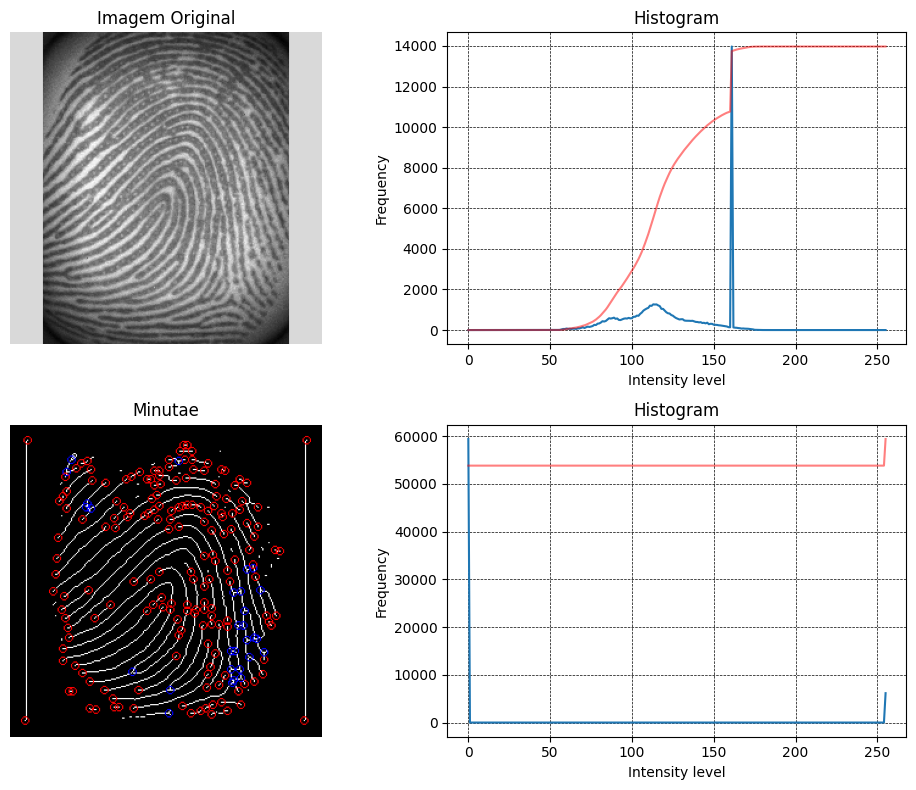

[<fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BCB50>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BE470>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BC880>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BE830>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BD8A0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BE920>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BD1E0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BEA10>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BCDC0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BFE20>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BE7A0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x000001F8719BFAC0>, <fingerprint_feature_extractor.MinutiaeFeature object at 0x0000

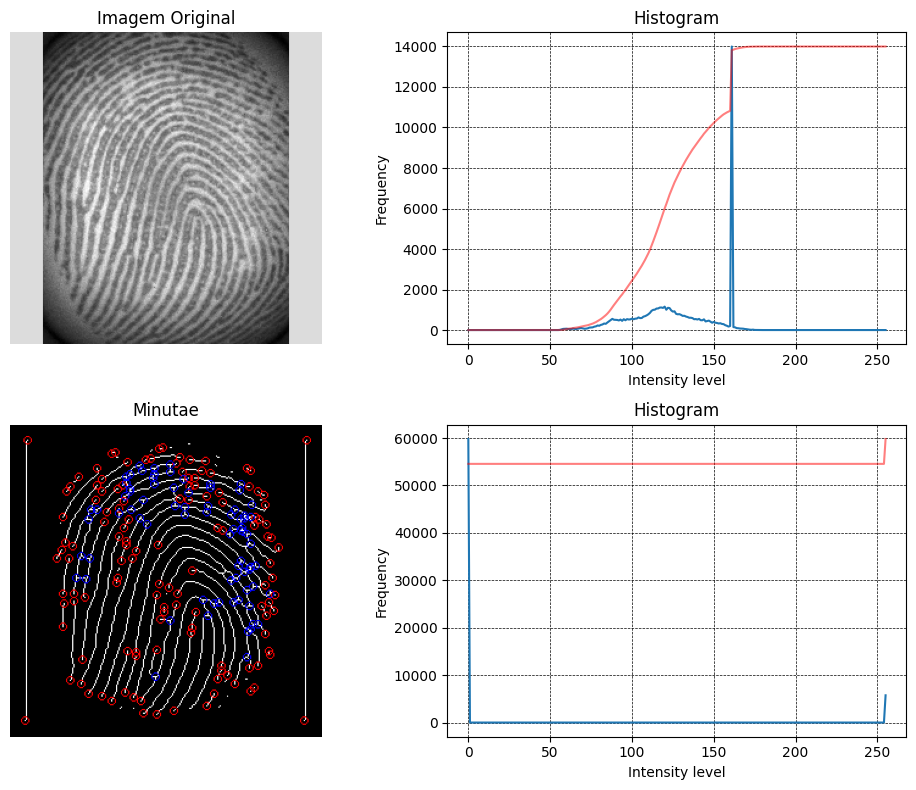

In [12]:
path = "../../src/TP2/dataset/FingerprintImages/"
k = 3
s = 1.0

for image_full_path in ImageUtils().get_images_from_folder(path): 
    image = np.array(Image.open(f'{image_full_path}').convert('L'))

    image_name = image_full_path.split('/')[-1]

    gaussian_image = ImageUtils().remove_gaussian_noise(image, kernel=k, sigma=s)
    sp_image = ImageUtils().remove_salt_and_pepper_noise(gaussian_image, kern=k)
    contrast_image, _ = ImageUtils().contrast_stretching(sp_image, min=np.min(image), max=np.max(image))
    he_clahe_image = ImageUtils().histogram_equalization(contrast_image, EquializationMethods.CLAHE)
    binary_otsu_image = ImageUtils().thresholding(he_clahe_image, method=ThresholdingMethods.BINARY_OTSU)

    FeaturesTerminations, FeaturesBiforcations = ImageUtils().extract_minutiae(binary_otsu_image, showResult=False, saveResult=True, folder=f'{path}minutae/', image_name='minutae_'+image_name.split('.')[0])

    name = image_name.split('.')[0]
    image_minutae = np.array(Image.open(f'{path}minutae/minutae_{name}.png'))

    print(FeaturesTerminations, FeaturesBiforcations)
    ImageUtils().images_information(images=[image, image_minutae], titles=[f'Imagem Original', 'Minutae'], show_cdf=True)


# Trabalho Prático

### Funções Auxiliares

In [13]:
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

def plotModelHistory(history, type='multi'):
    # Extract metrics from the history object
    history_dict = history.history
    loss = history_dict['loss']
    val_loss = history_dict['val_loss']
    accuracy = history_dict['accuracy']
    val_accuracy = history_dict['val_accuracy']

    # Number of epochs
    epochs = range(1, len(loss) + 1)

    # Plot training and validation loss
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.plot(epochs, loss, 'r', label='Training loss');
    plt.plot(epochs, val_loss, 'b', label='Validation loss');
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    # Plot training and validation accuracy
    plt.subplot(1, 2, 2)
    plt.plot(epochs, accuracy, 'r', label='Training accuracy');
    plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy');
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend(loc='upper left')
    plt.tight_layout()
    plt.show()

    os.makedirs(f"imgs", exist_ok=True)
    plt.savefig(f"imgs/{type}_model.png")


def plotConfusionMatrix(true_classes, pred_classes, type='multi'): 
    # Compute the confusion matrix
    conf_matrix = confusion_matrix(true_classes, pred_classes)
    matrix = ConfusionMatrixDisplay(conf_matrix, display_labels=np.unique(true_classes))
    fig, ax = plt.subplots(figsize=(10,10))
    fig.suptitle('Matriz de confusão do teste', fontsize=20)
    matrix.plot(ax=ax, cmap='viridis');
    plt.grid(False)
    plt.tight_layout()
    plt.show()

    os.makedirs(f"imgs", exist_ok=True)
    plt.savefig(f"imgs/{type}_confusionMatrix.png")


def plotROCCurves(true_classes, pred_classes): 
    # Compute ROC curve and ROC area for each class
    fpr, tpr, _ = roc_curve(true_classes, pred_classes)
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})');
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--');
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.grid()
    plt.show()

    os.makedirs(f"imgs", exist_ok=True)
    plt.savefig(f"imgs/rocCurve.png")

## Load Database

In [14]:
def load_database(path, n_subjects = 10):

    if n_subjects > 600:
        raise ValueError('n_subjects must be less than 600')
    
    data = []
    for image_name in os.listdir(path):
            if image_name.endswith('.BMP'):
                subject_index = int(image_name.split('_')[0])
                if subject_index > n_subjects:
                    continue
                image = np.array(Image.open(f'{path}{image_name}').convert('L'))
            
                data.append({'subject': subject_index, 'image': image, 'image_name': image_name})

    return data

In [15]:
path = "../../src/TP2/dataset/archive/SOCOFing/Real/"

database = load_database(path)

print(len(database)) 


100


## Pré-processamento & Feature Extraction

In [76]:
from fingerprint_enhancer.fingerprint_image_enhancer import FingerprintImageEnhancer

def extract_minutae(image, showResult=False, saveResult=False, folder=None, image_name=None):

    ImageUtils().enhance(image, saveResult=saveResult, folder=folder, image_name=image_name)
    enhanced_image = cv2.imread(f"{folder}enhanced/{image_name}.png", cv2.IMREAD_GRAYSCALE)
    FeaturesTerminations, FeaturesBiforcations = ImageUtils().extract_minutiae(enhanced_image, showResult=showResult, saveResult=saveResult, folder=f"{folder}minutae/", image_name=image_name)

    minutiae_image = np.zeros_like(enhanced_image)
    for termination in FeaturesTerminations:
        minutiae_image[termination.locX, termination.locY] = 255

    for bifurcation in FeaturesBiforcations:
        minutiae_image[bifurcation.locX, bifurcation.locY] = 255

    cv2.imwrite(f"{folder}minutae/{image_name}.bmp", minutiae_image)

    minutae_image = cv2.imread(f"{folder}minutae/{image_name}.bmp")

    return FeaturesTerminations, FeaturesBiforcations, enhanced_image, minutae_image

c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\fingerprint_feature_extractor\__init__.py:78: FutureWarning: `square` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  self._mask = erosion(self._mask, square(5))  # Structuing element for mask erosion = square(5)


+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.59 |              151.85 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.85 |              185.33 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.48 |
+-----------------+------------+-----------+---------------------+


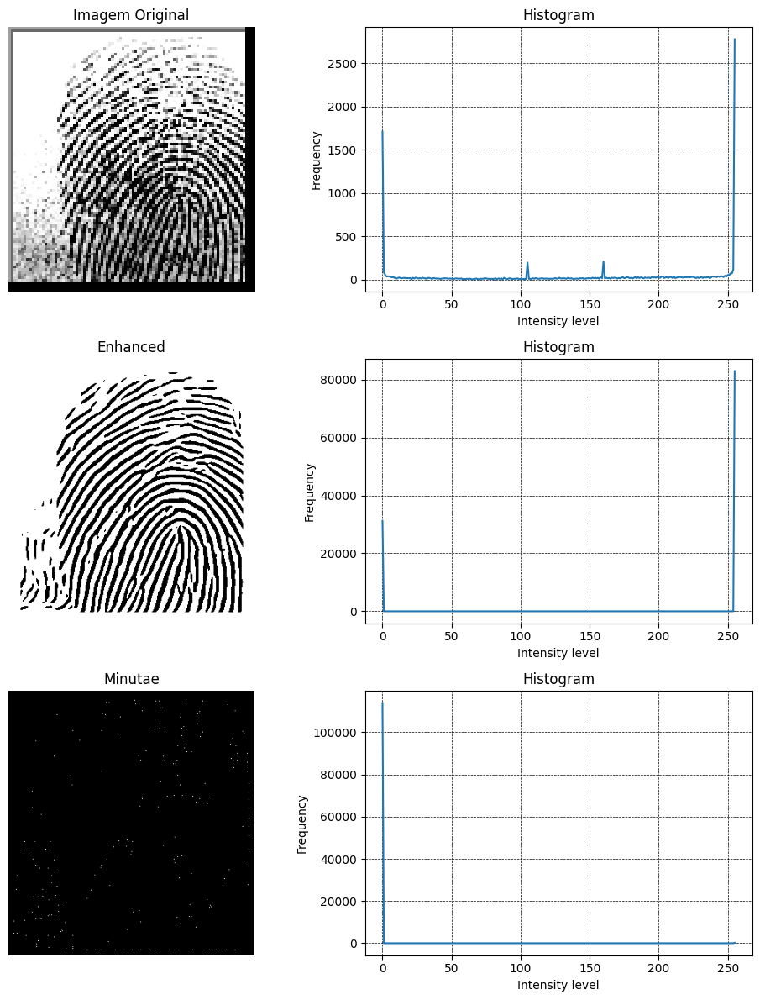

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.82 |              163.99 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.73 |              202.42 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.42 |
+-----------------+------------+-----------+---------------------+


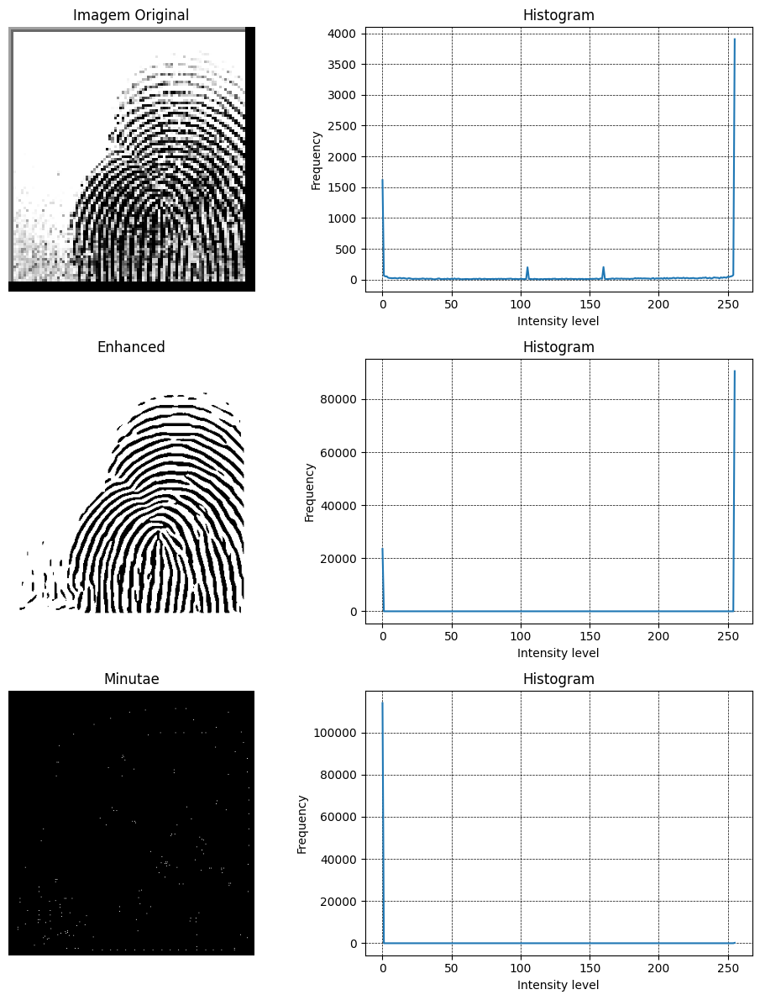

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.68 |              127.07 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.91 |              171.51 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.28 |
+-----------------+------------+-----------+---------------------+


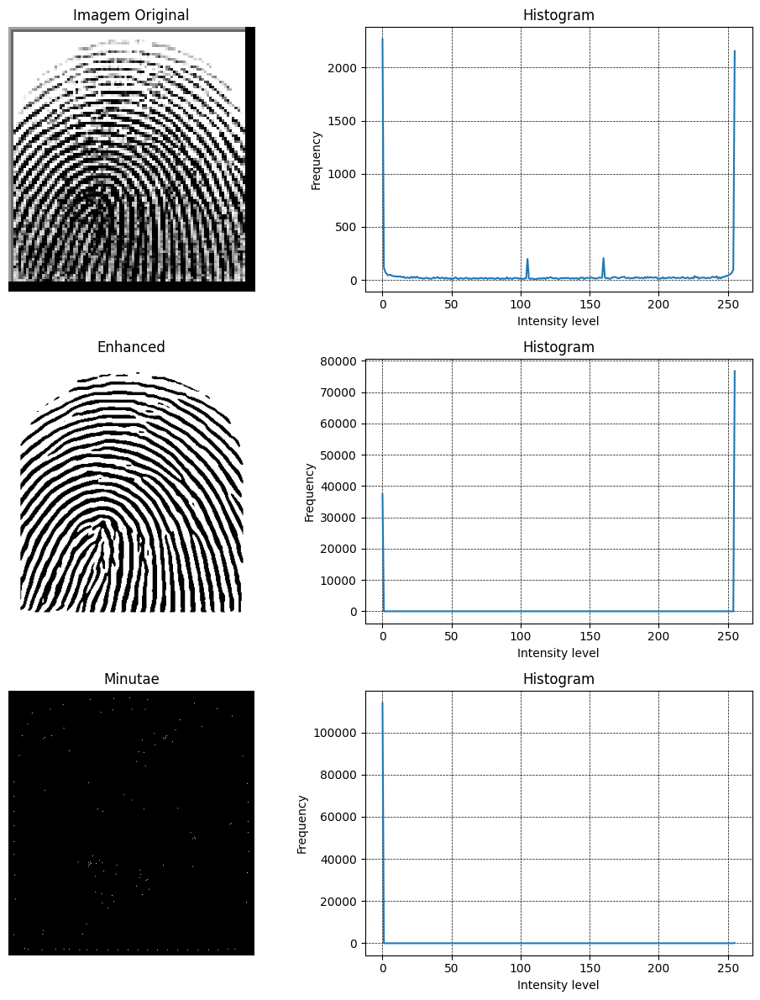

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.94 |              133.07 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.9  |              175.43 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.33 |
+-----------------+------------+-----------+---------------------+


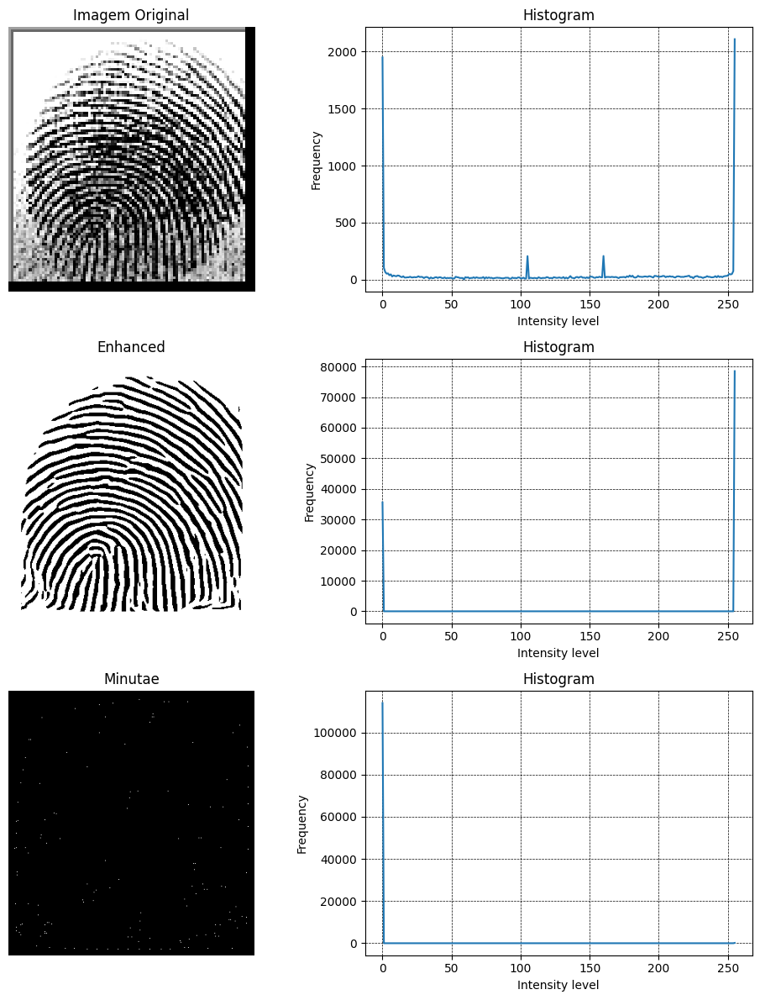

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.67 |              153.6  |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.84 |              186.39 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.3  |
+-----------------+------------+-----------+---------------------+


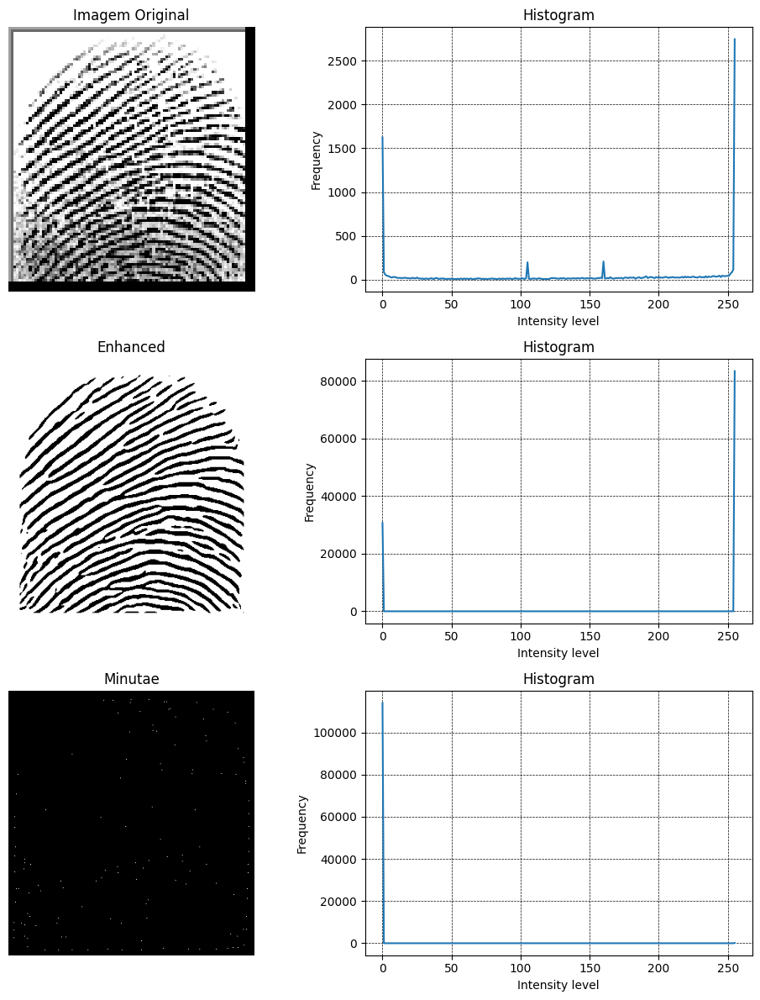

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.46 |              141.38 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.84 |              186.95 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.35 |
+-----------------+------------+-----------+---------------------+


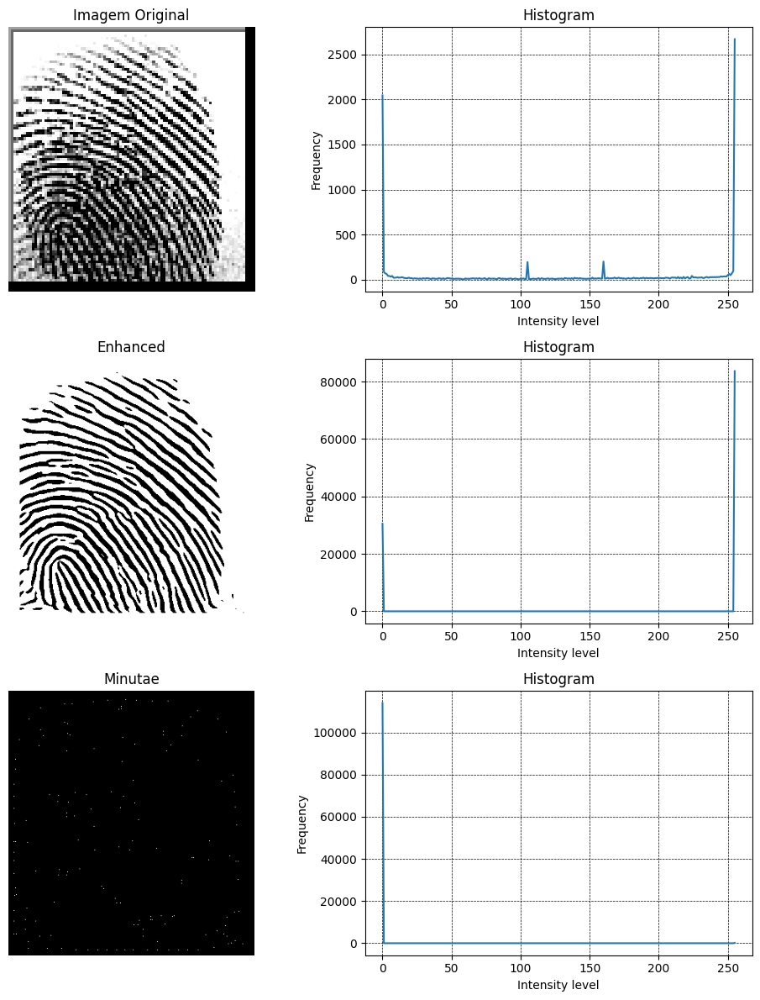

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.52 |              133.28 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.75 |              199.74 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.47 |
+-----------------+------------+-----------+---------------------+


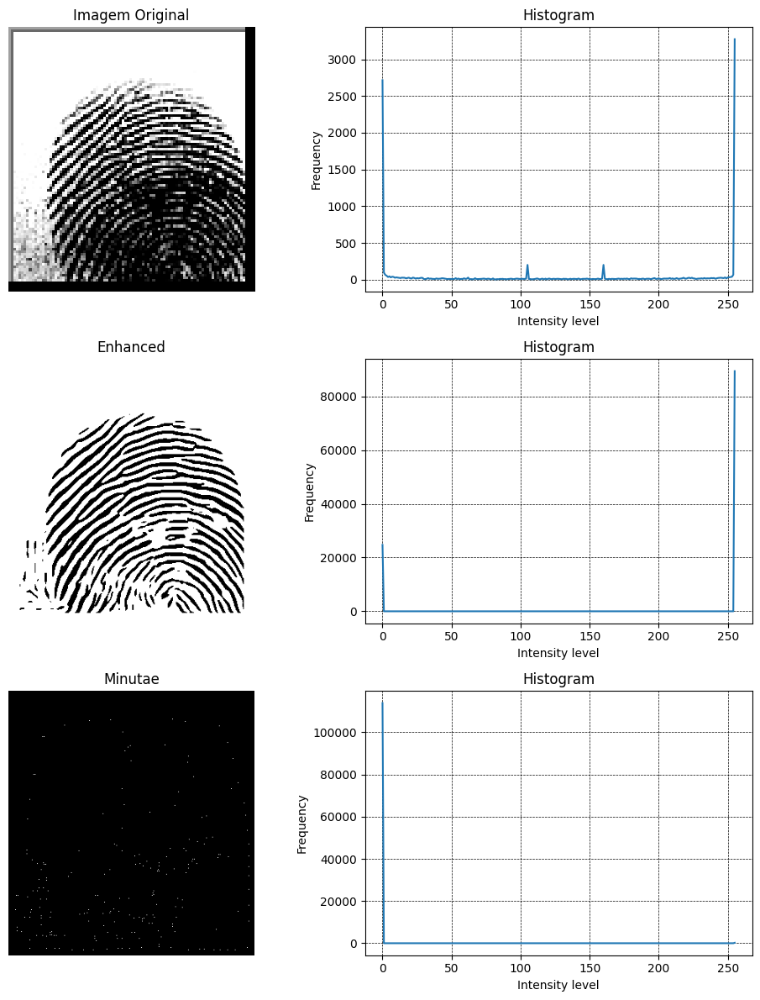

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.45 |              115.89 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.93 |              167.42 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.2  |
+-----------------+------------+-----------+---------------------+


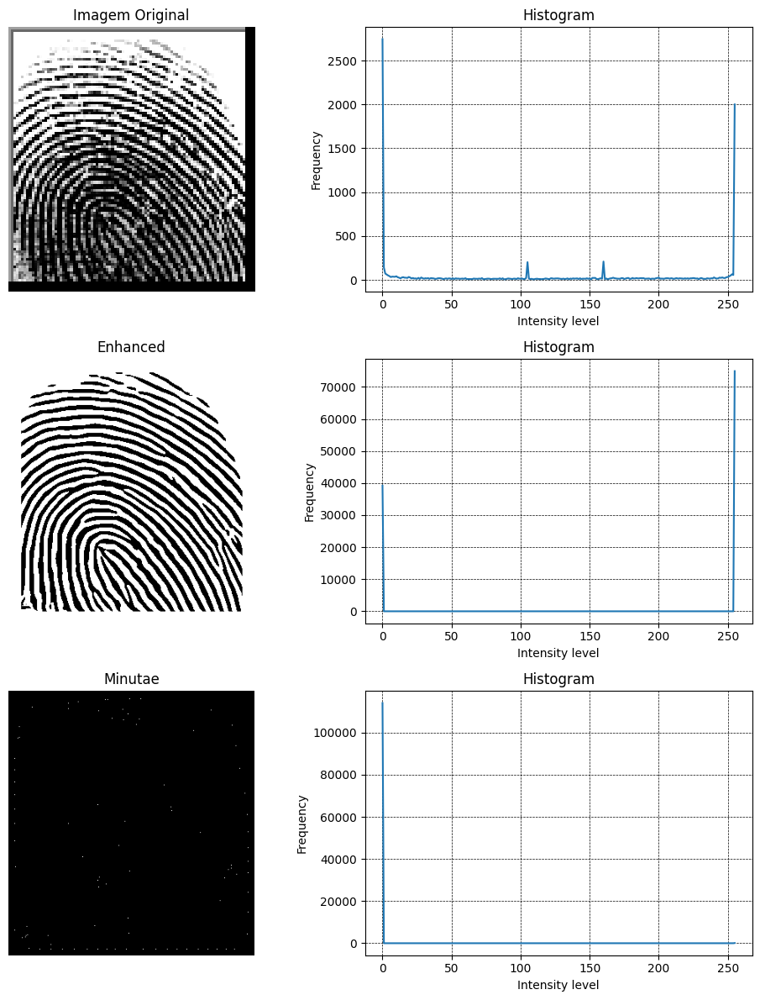

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.45 |              104.85 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.82 |              189.63 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.48 |
+-----------------+------------+-----------+---------------------+


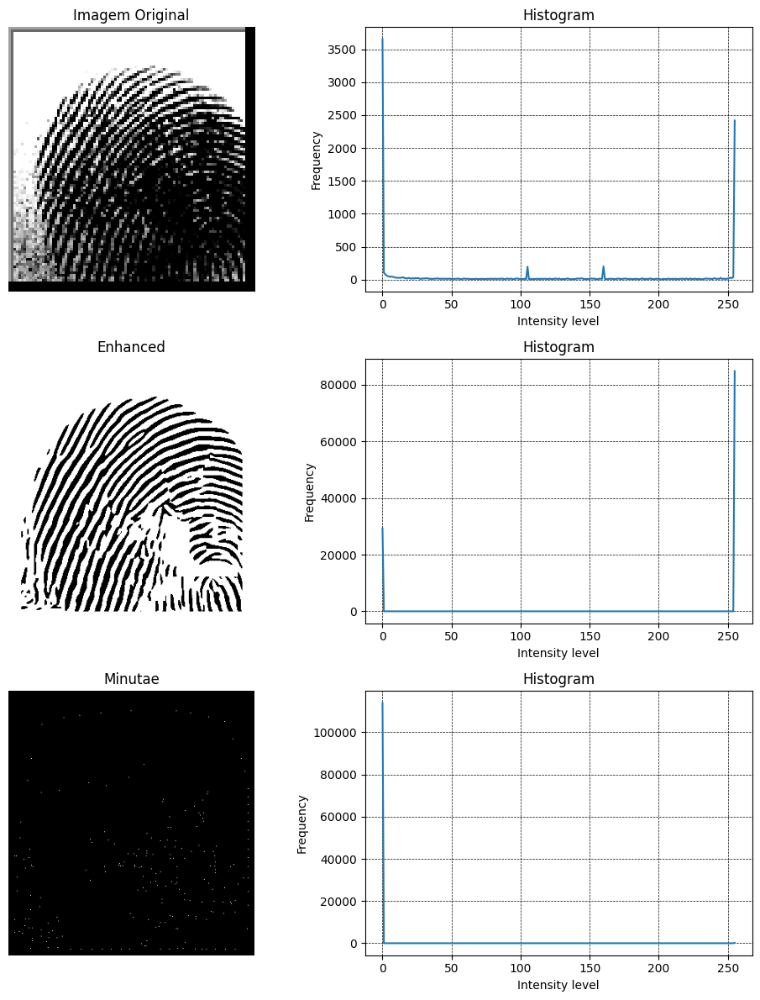

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.03 |              138.01 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.87 |              180.27 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.28 |
+-----------------+------------+-----------+---------------------+


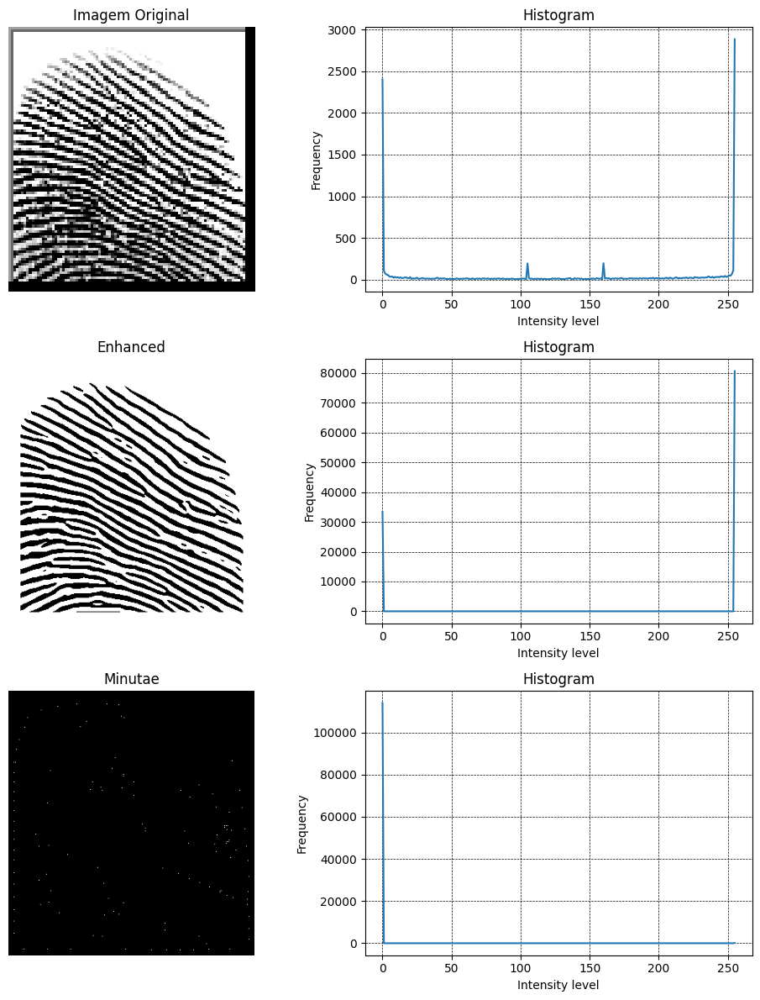

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.08 |              125.11 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.9  |              174.37 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.29 |
+-----------------+------------+-----------+---------------------+


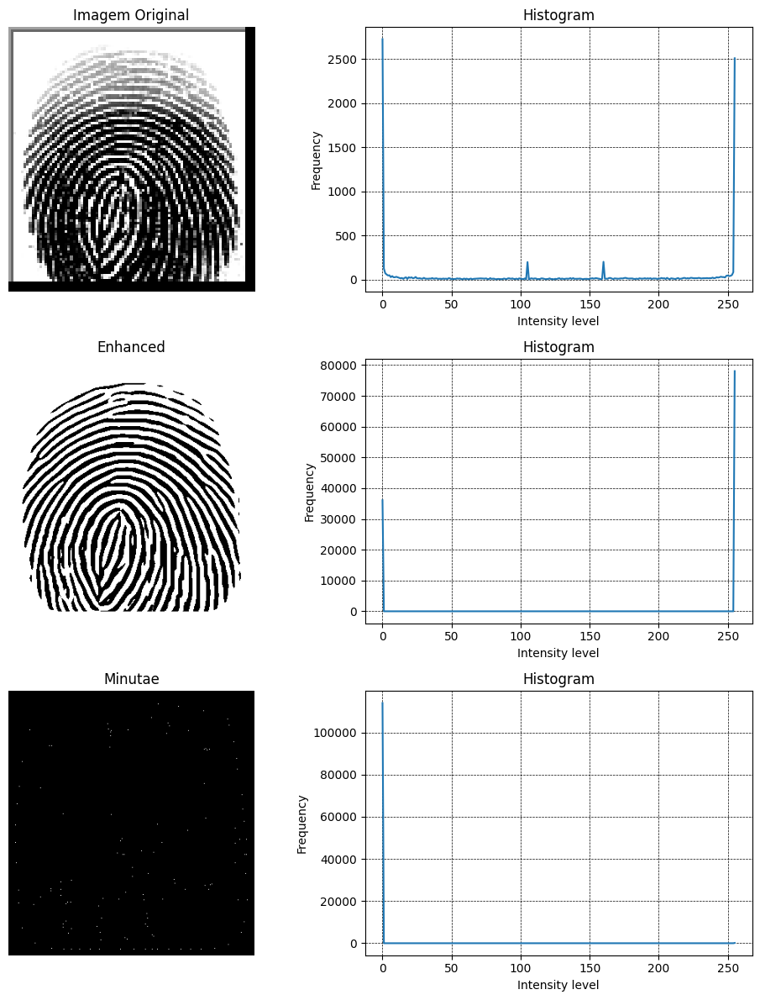

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.32 |              148.02 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.78 |              196.38 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.28 |
+-----------------+------------+-----------+---------------------+


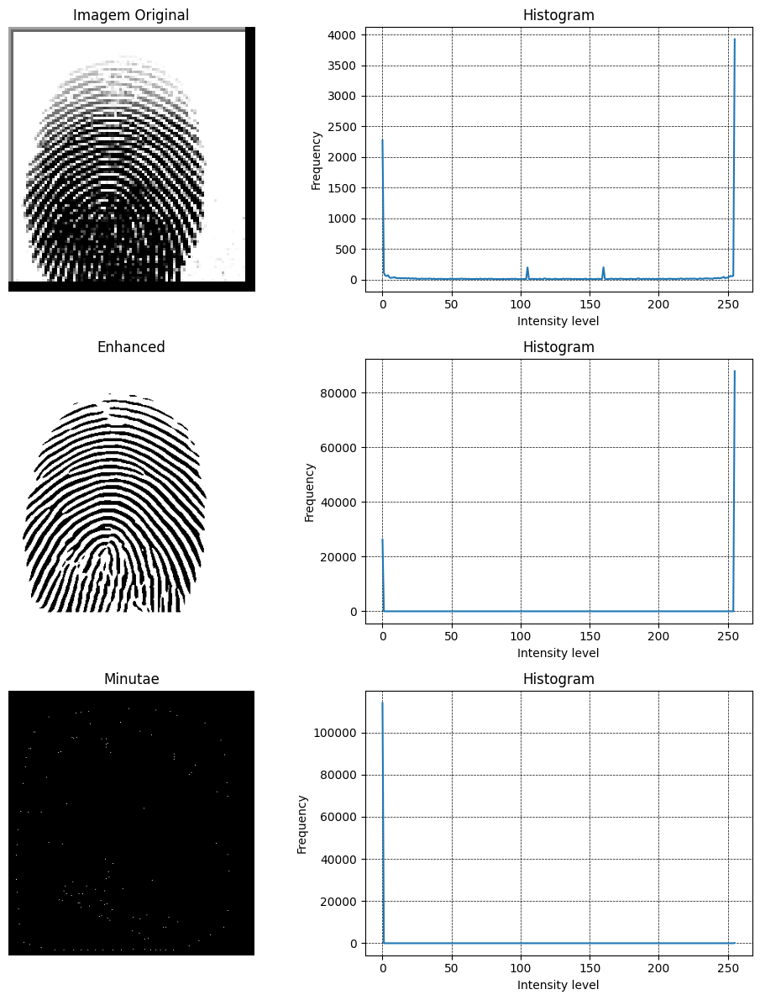

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.68 |              121.25 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.92 |              168.53 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.28 |
+-----------------+------------+-----------+---------------------+


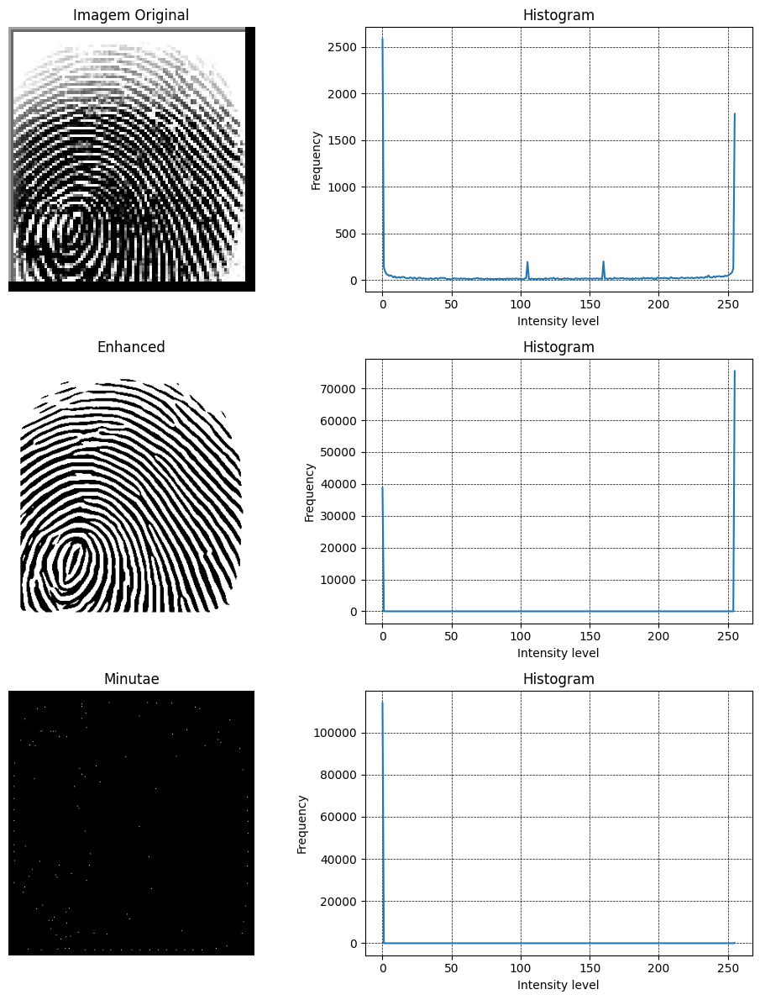

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.41 |              143.3  |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.87 |              181.76 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.37 |
+-----------------+------------+-----------+---------------------+


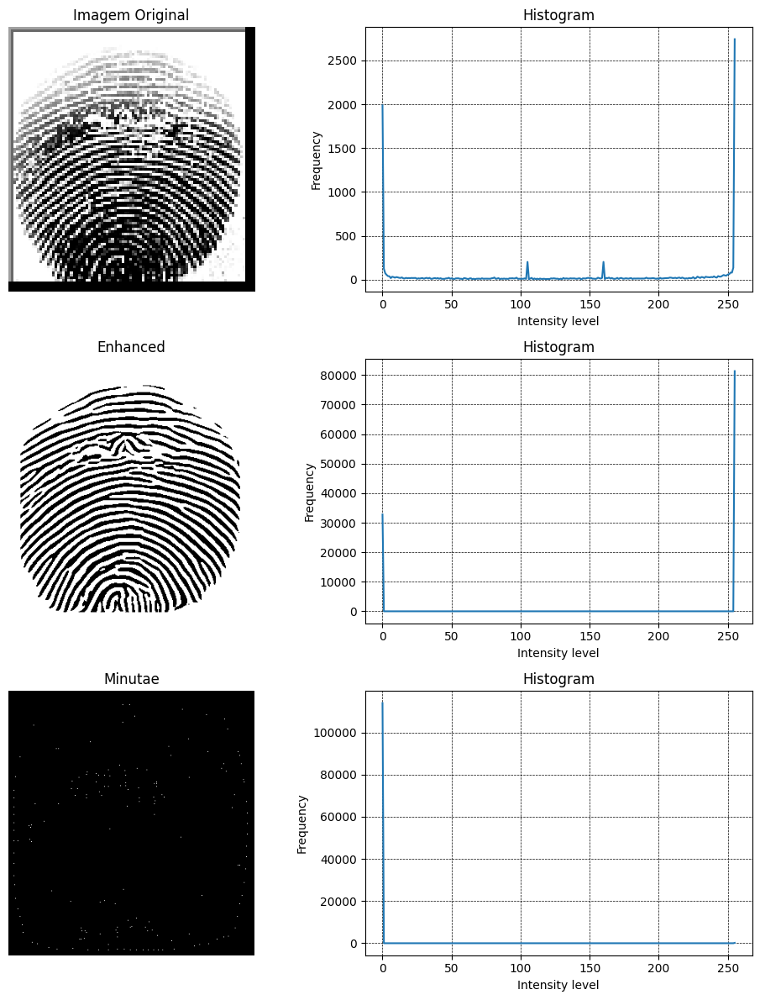

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.54 |              139.5  |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.92 |              170.09 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.26 |
+-----------------+------------+-----------+---------------------+


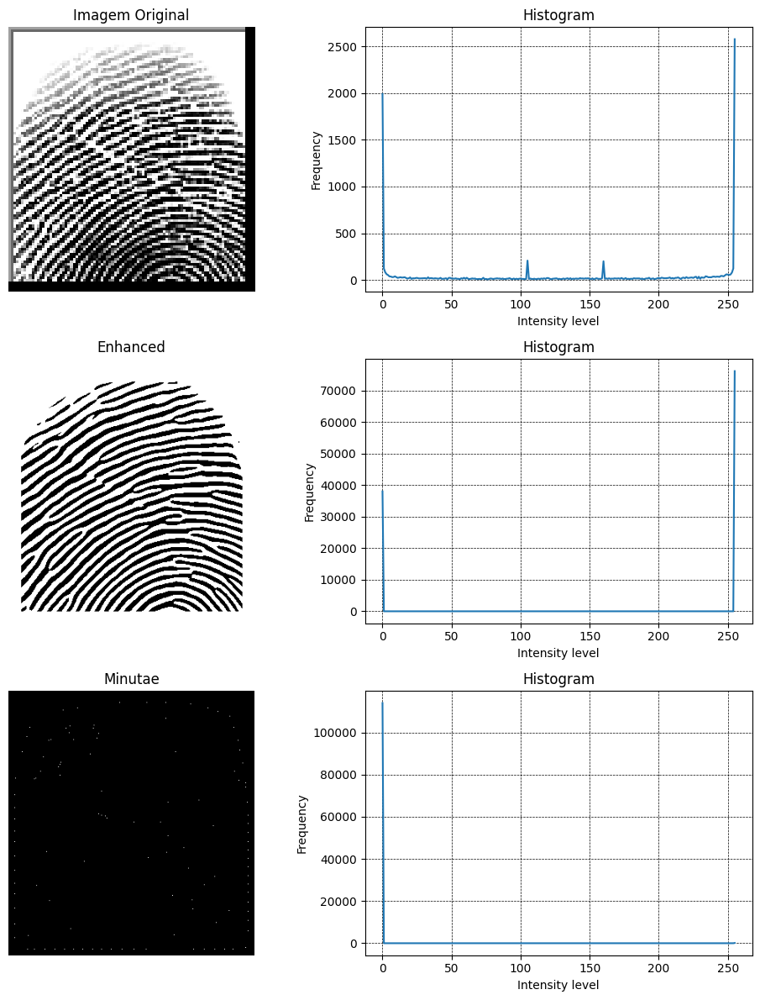

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.95 |              114.79 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.89 |              176.52 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.52 |
+-----------------+------------+-----------+---------------------+


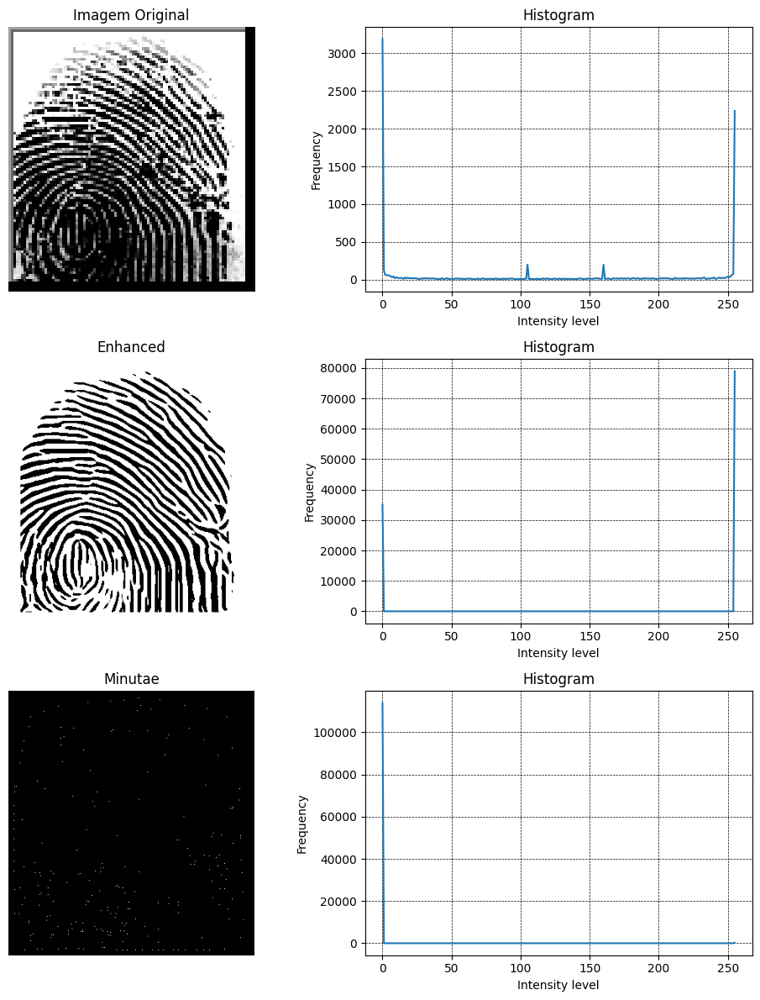

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.34 |              142.3  |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.78 |              196.59 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.46 |
+-----------------+------------+-----------+---------------------+


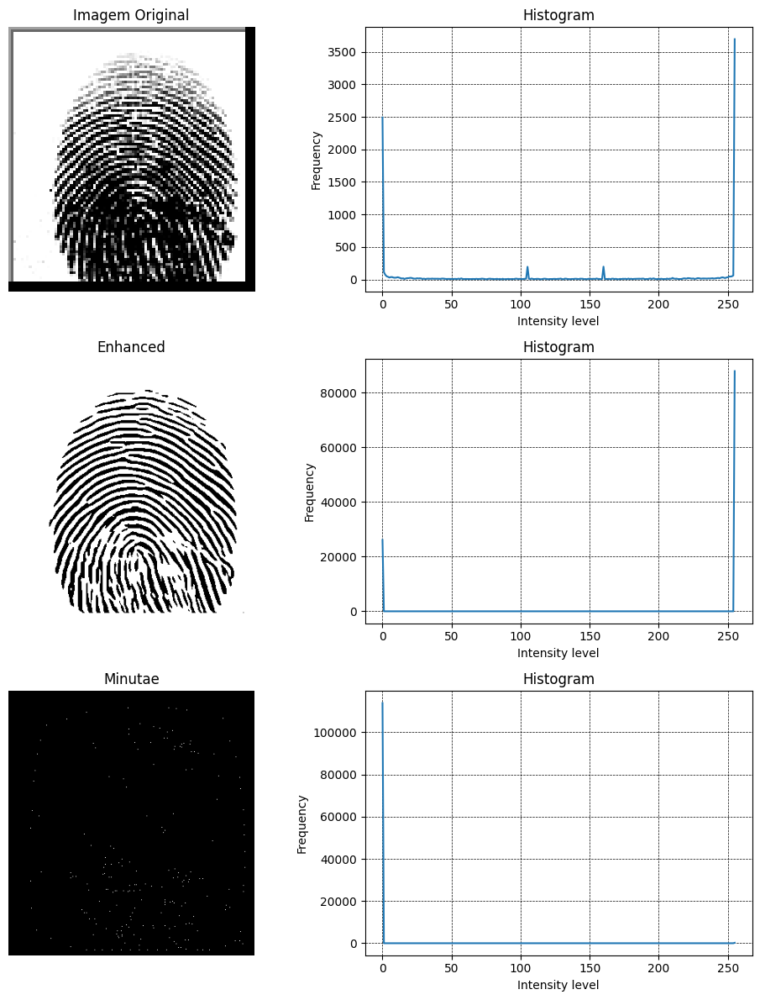

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.75 |               85.21 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.9  |              175.03 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.38 |
+-----------------+------------+-----------+---------------------+


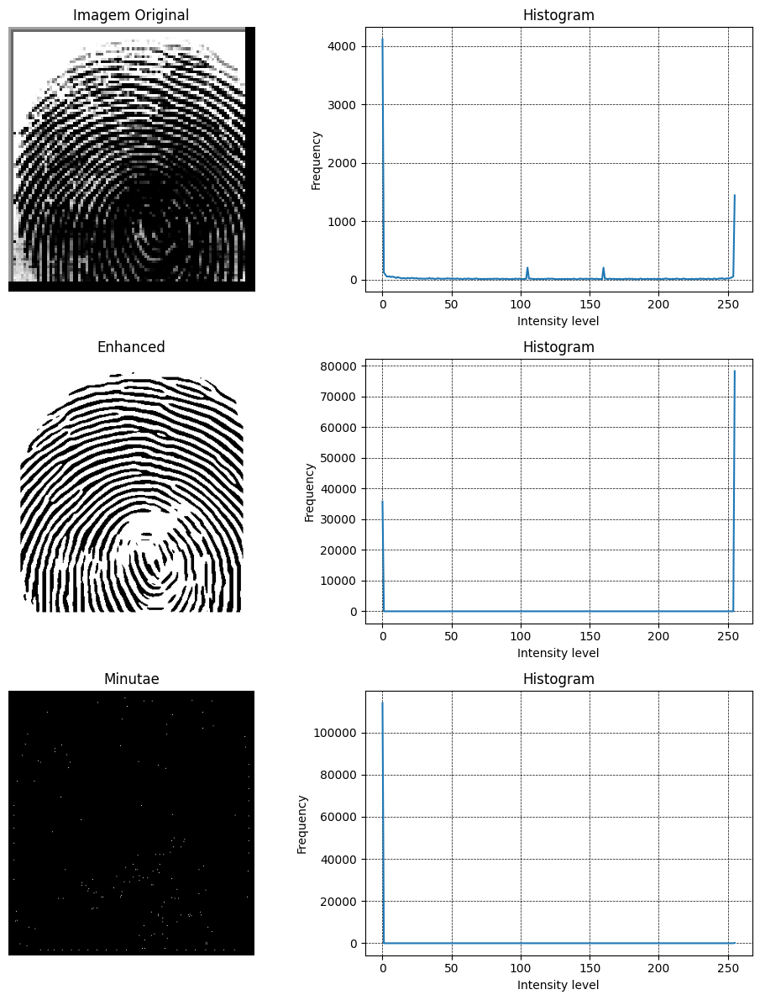

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.88 |              110.17 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.89 |              176.81 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.28 |
+-----------------+------------+-----------+---------------------+


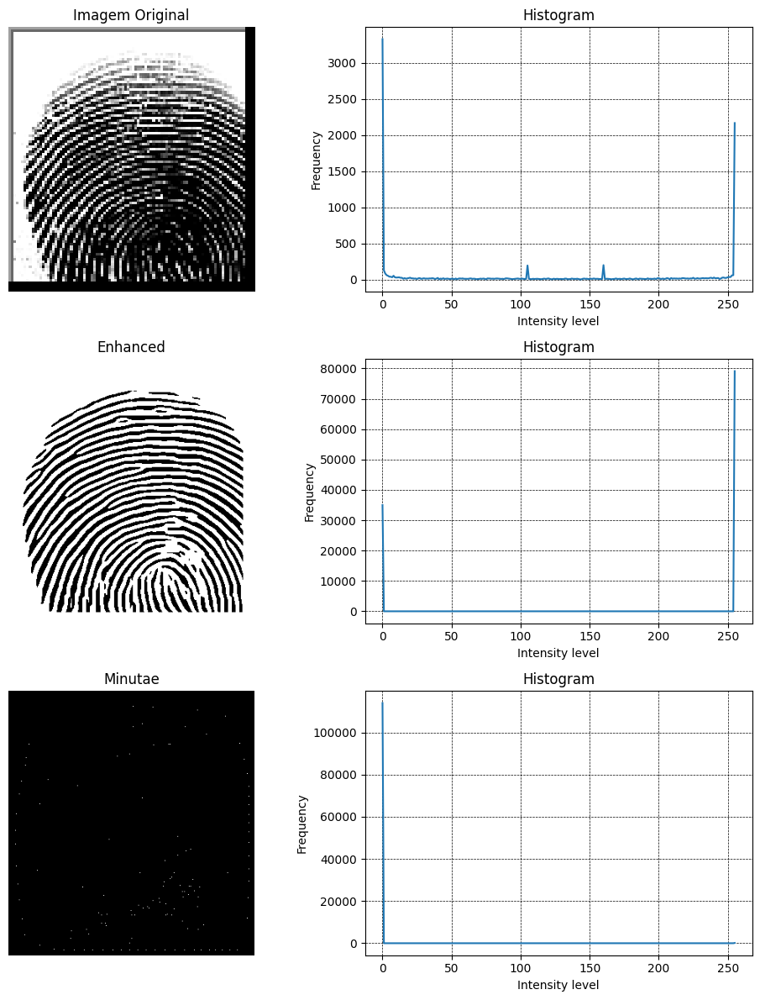

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.73 |              135.22 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.92 |              170.79 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.27 |
+-----------------+------------+-----------+---------------------+


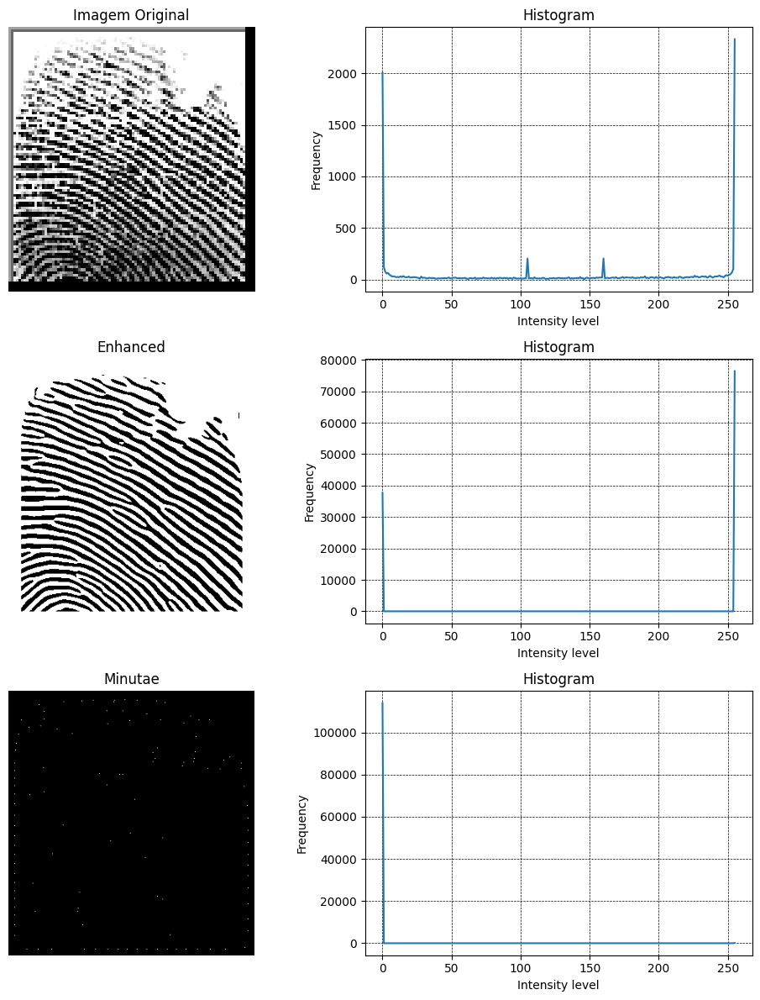

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.11 |              143.61 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.87 |              180.09 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.32 |
+-----------------+------------+-----------+---------------------+


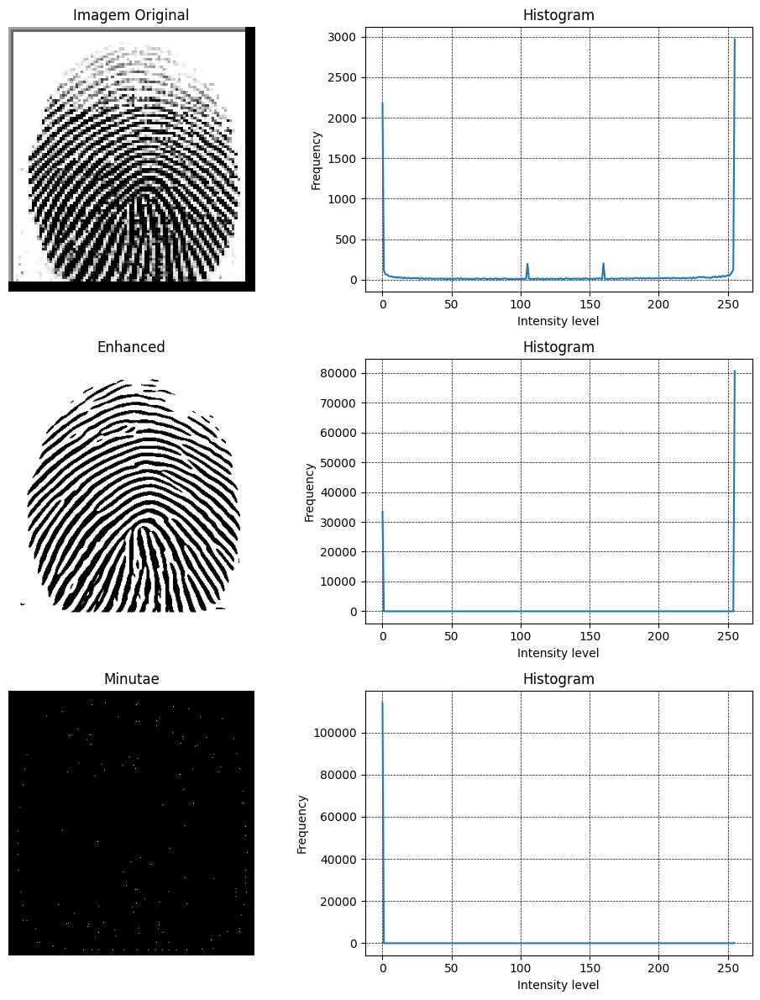

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.41 |              150.19 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.77 |              197.41 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.34 |
+-----------------+------------+-----------+---------------------+


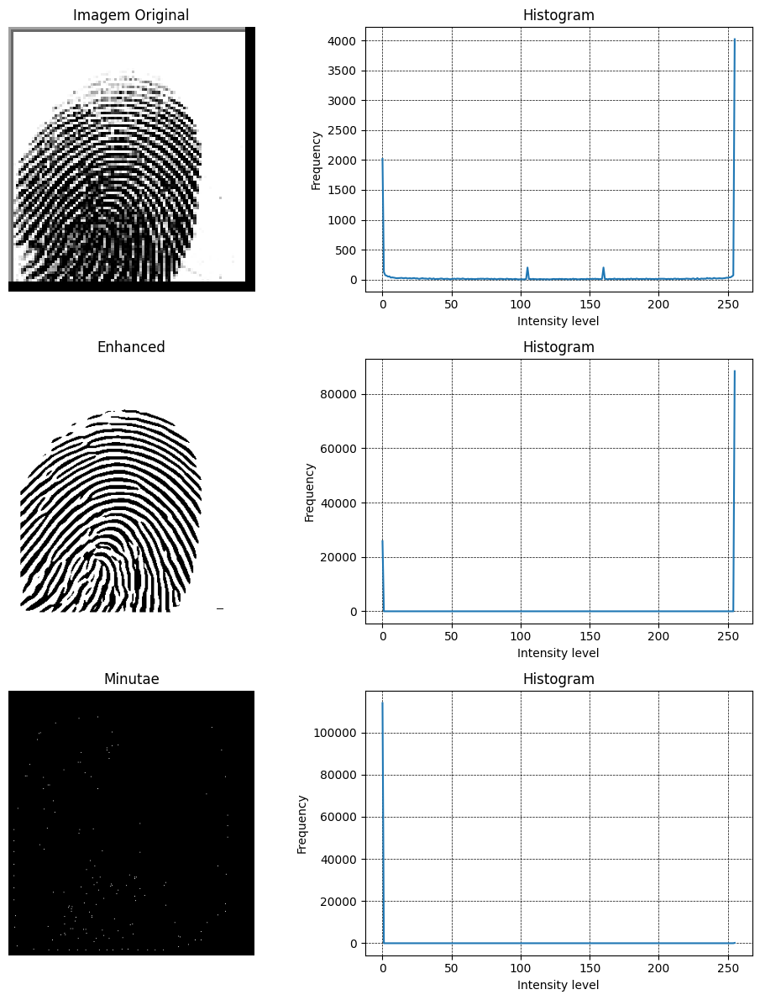

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.64 |              137.25 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.85 |              185.11 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.23 |
+-----------------+------------+-----------+---------------------+


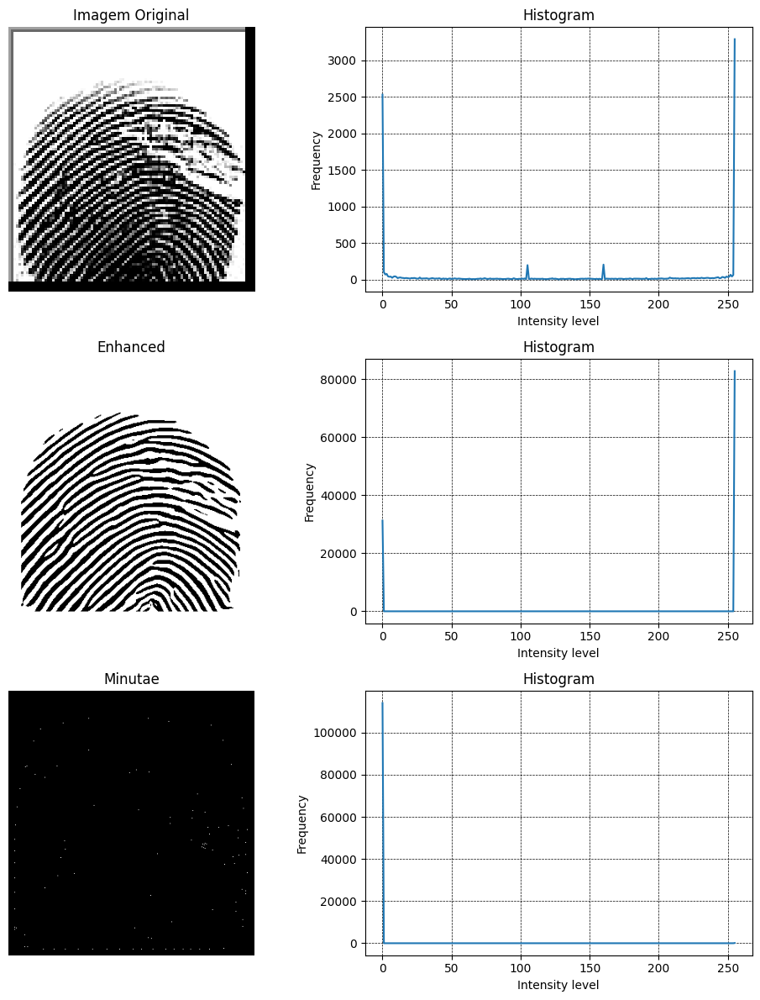

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.23 |              158.76 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.74 |              201.43 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.16 |
+-----------------+------------+-----------+---------------------+


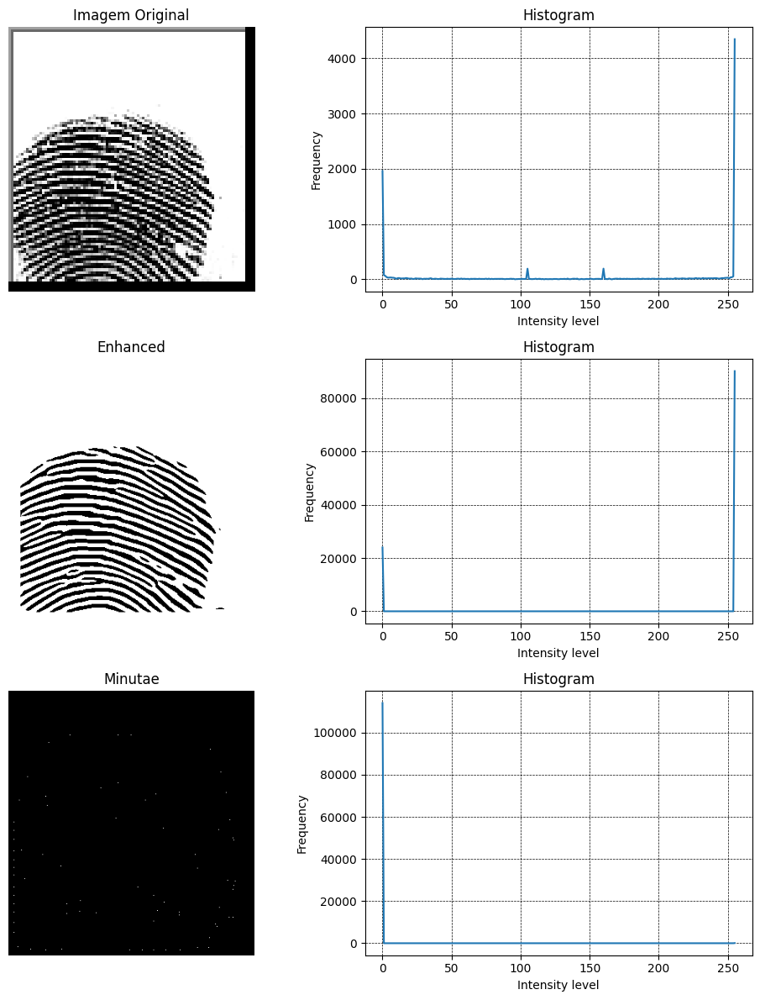

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.28 |              157.84 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.86 |              183.65 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.29 |
+-----------------+------------+-----------+---------------------+


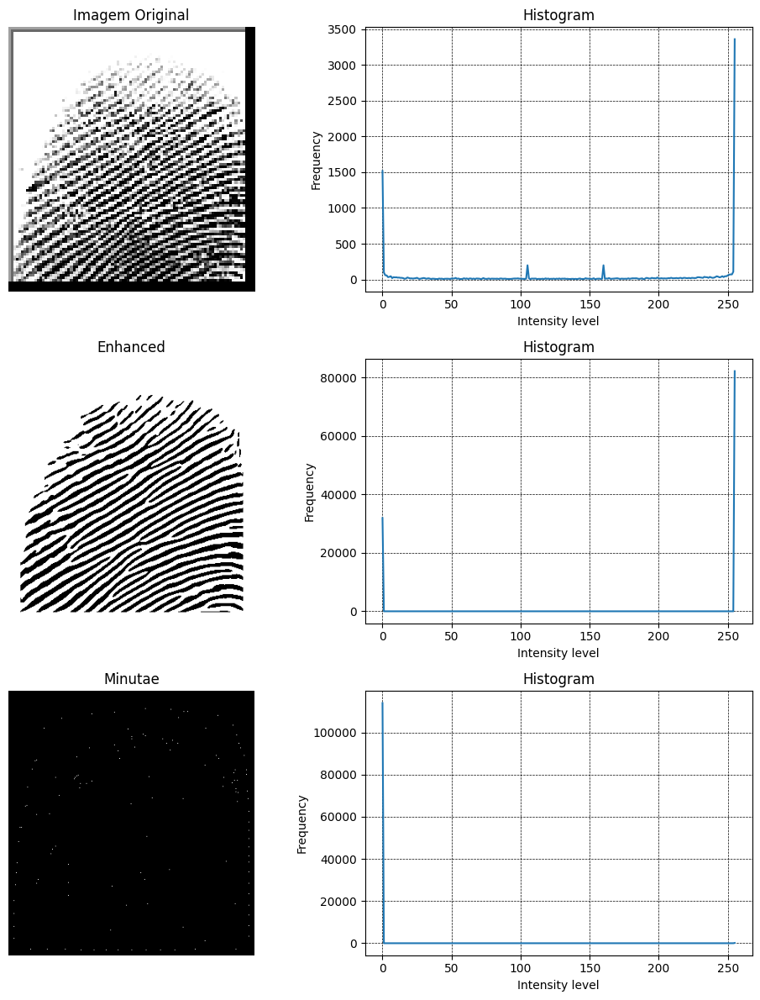

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.75 |              155.53 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.79 |              194.95 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.3  |
+-----------------+------------+-----------+---------------------+


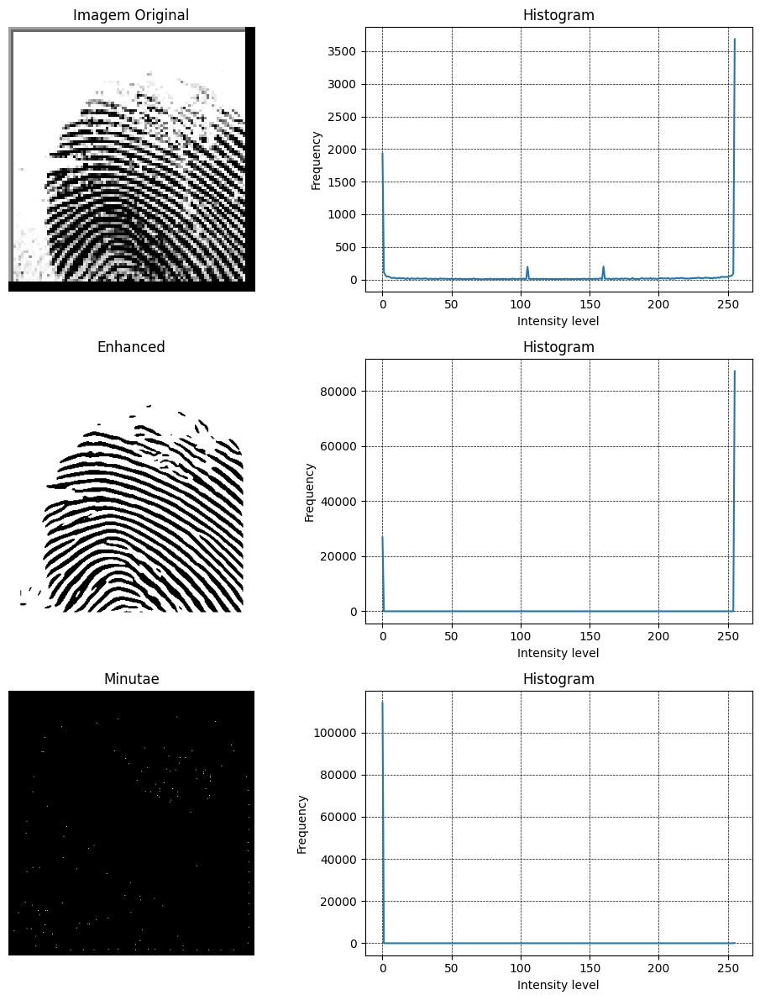

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.12 |              172.45 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.7  |              206.26 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.14 |
+-----------------+------------+-----------+---------------------+


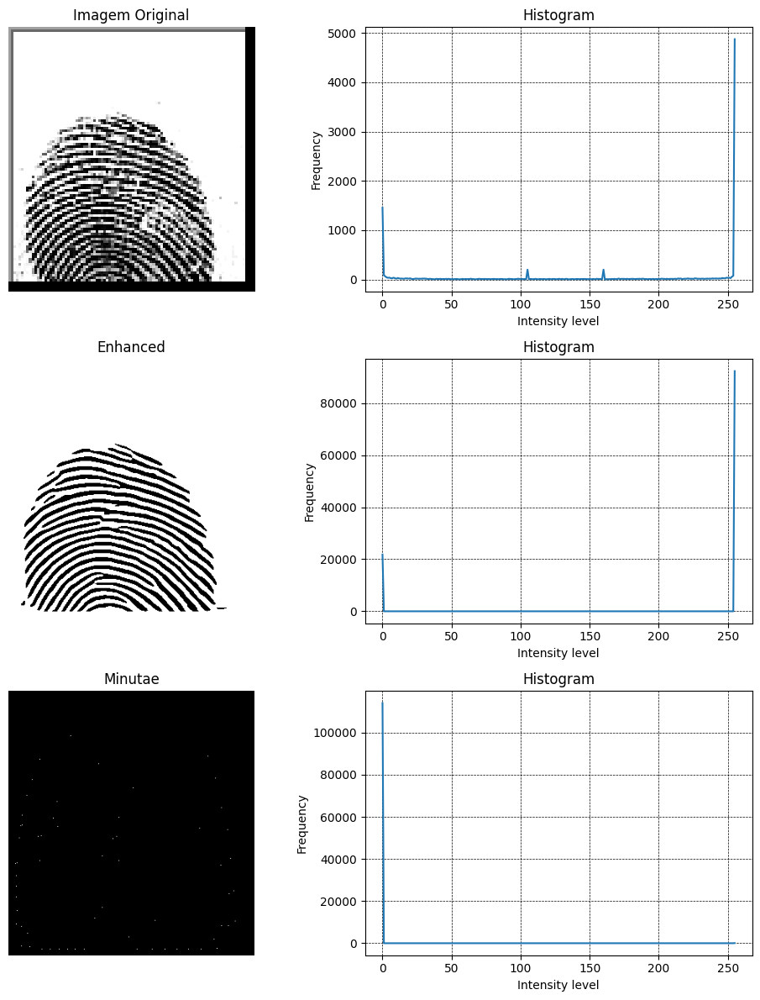

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.19 |              164.19 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.71 |              205.16 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.17 |
+-----------------+------------+-----------+---------------------+


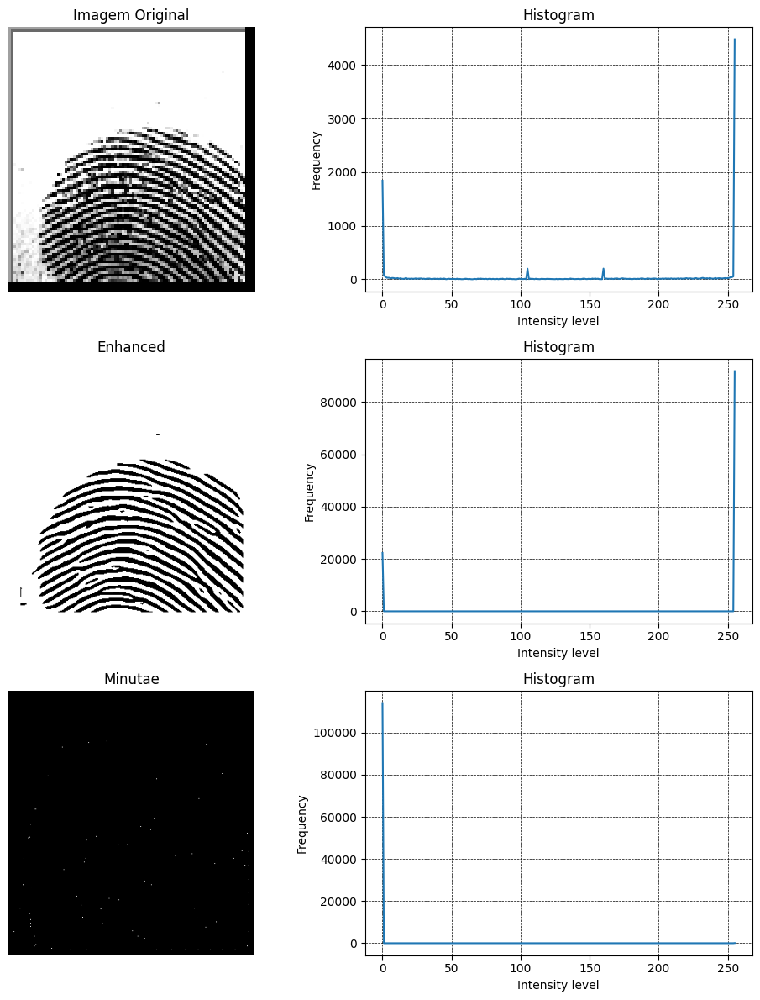

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.88 |              133.6  |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.84 |              186.24 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.25 |
+-----------------+------------+-----------+---------------------+


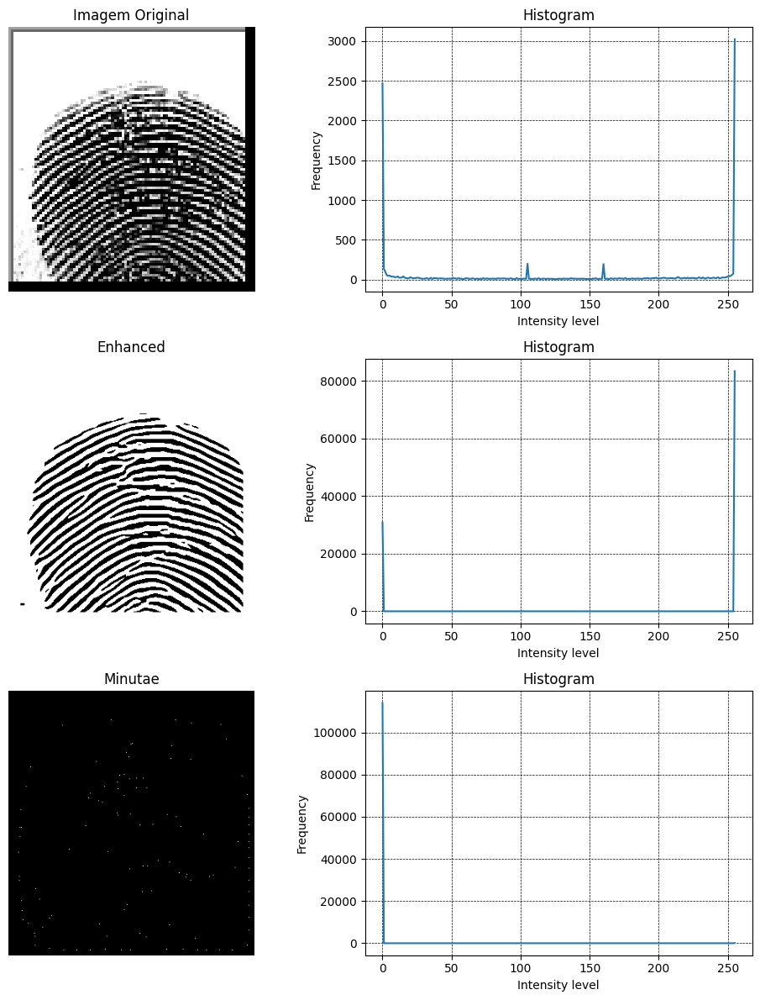

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.77 |              162.97 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.82 |              190.39 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.2  |
+-----------------+------------+-----------+---------------------+


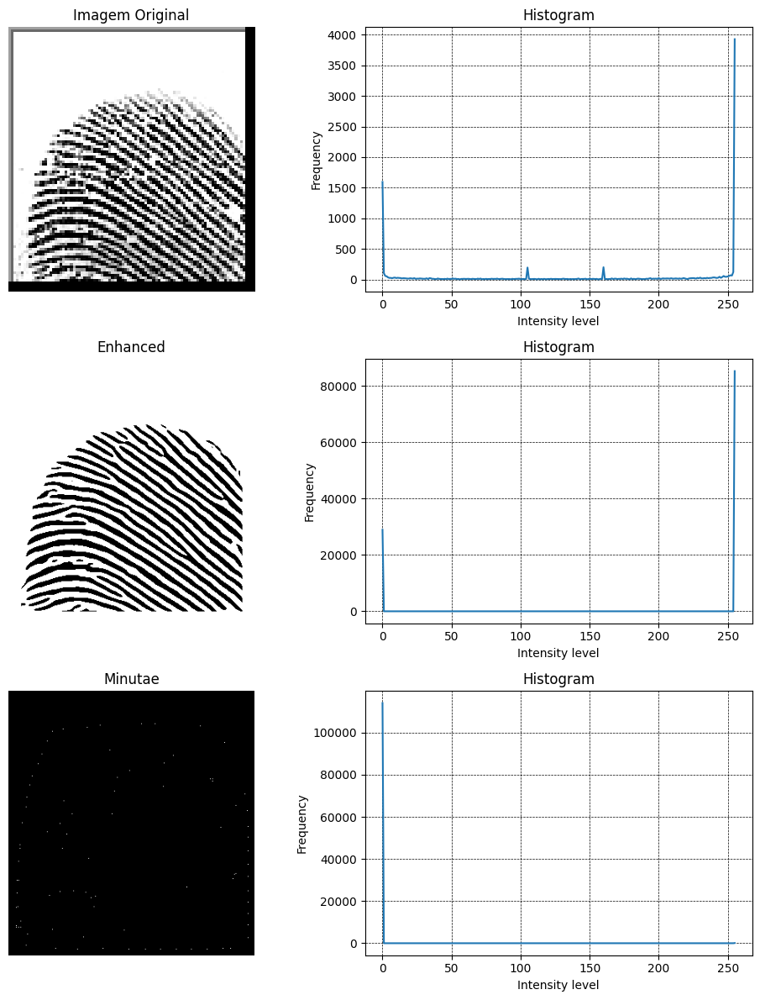

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.6  |              160.18 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.74 |              201.41 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.44 |
+-----------------+------------+-----------+---------------------+


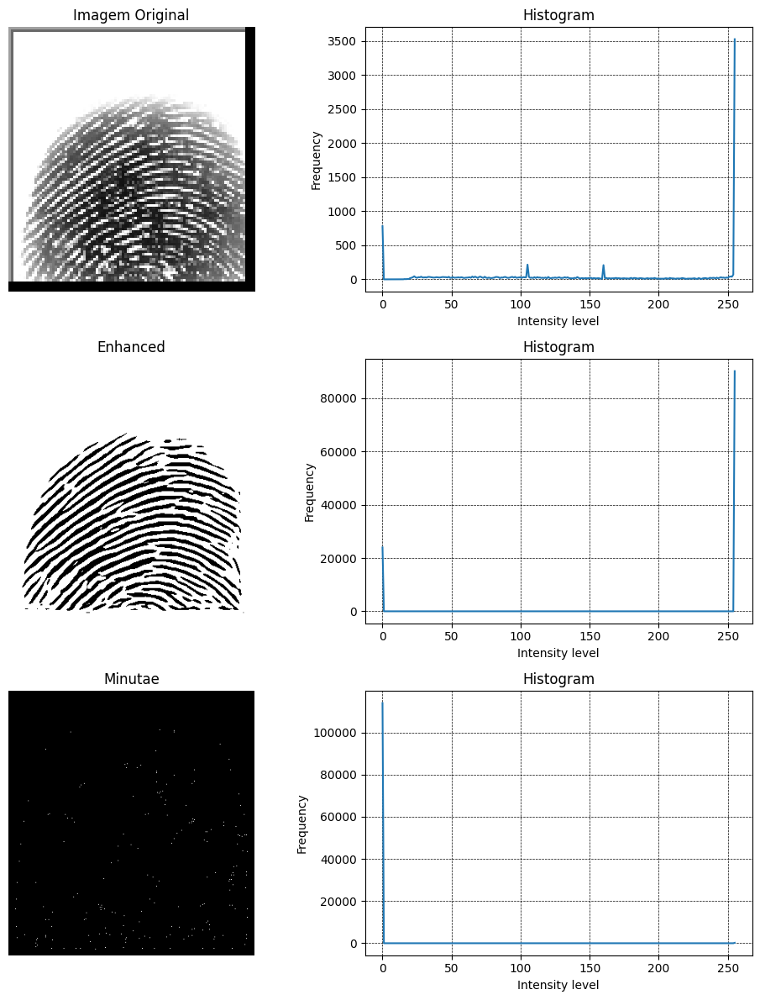

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      6.6  |              135.43 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.88 |              178.12 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.41 |
+-----------------+------------+-----------+---------------------+


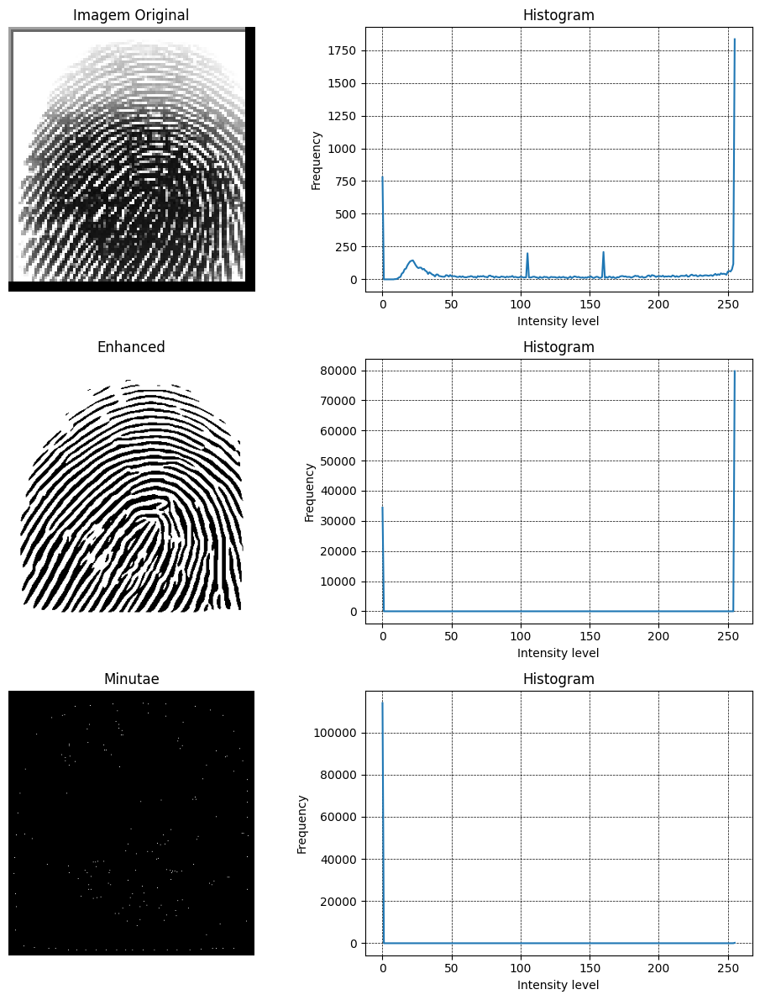

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      6.01 |              143.02 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.86 |              182.34 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.36 |
+-----------------+------------+-----------+---------------------+


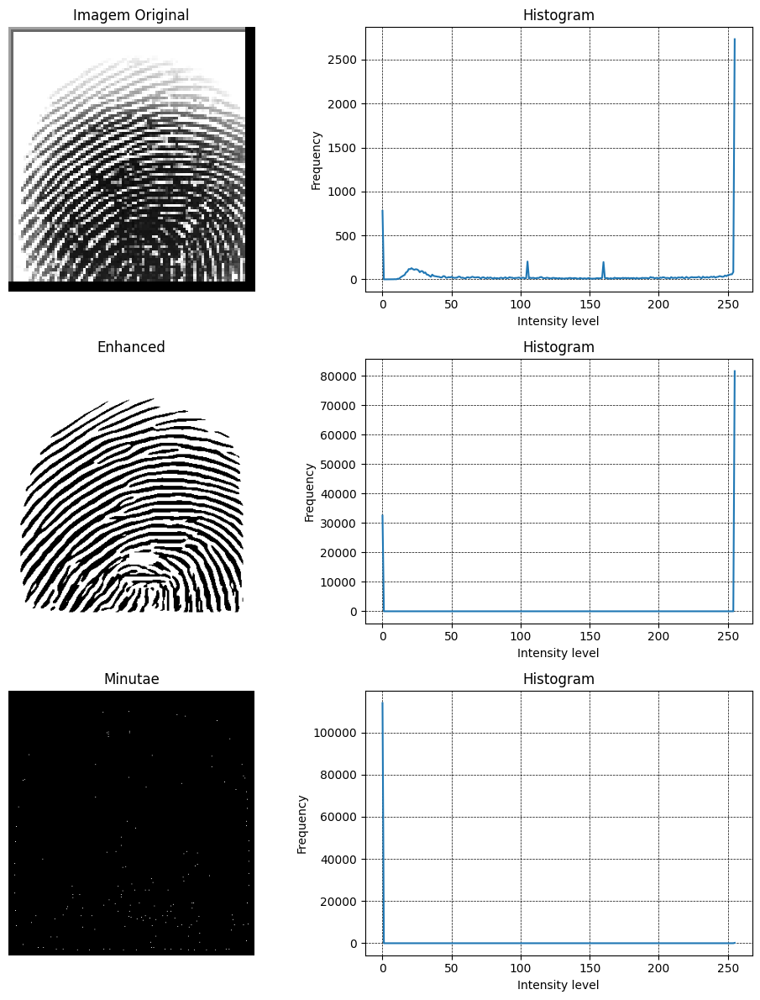

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      6.55 |              125.76 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.87 |              180.14 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.46 |
+-----------------+------------+-----------+---------------------+


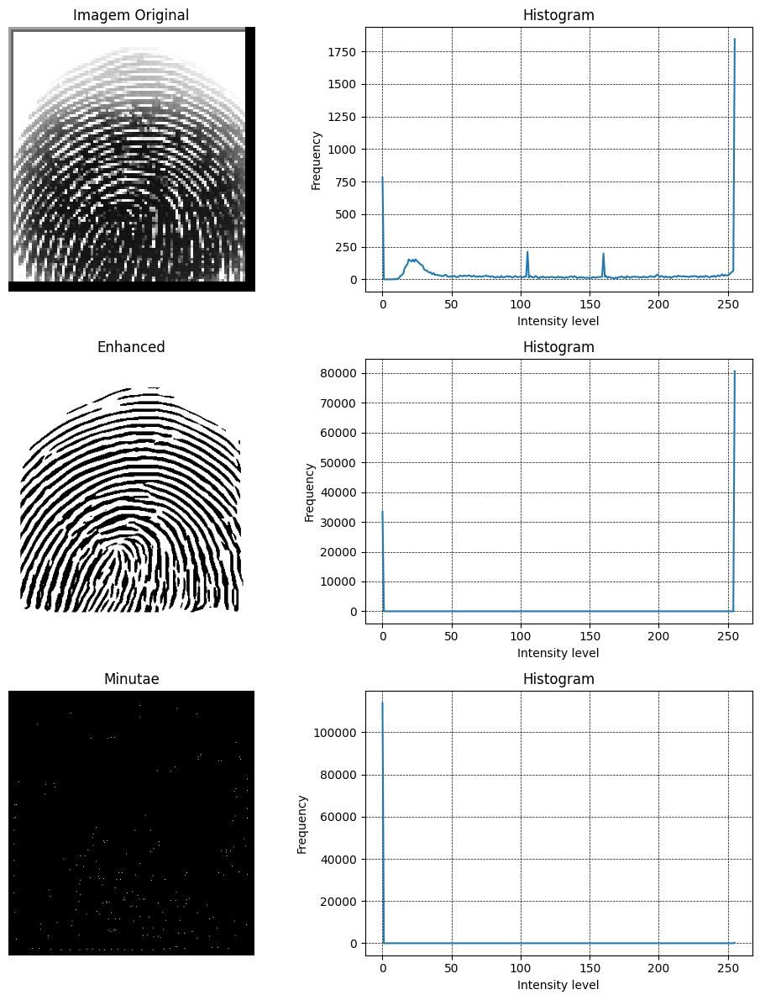

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      6.44 |              145.58 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.88 |              178.98 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.28 |
+-----------------+------------+-----------+---------------------+


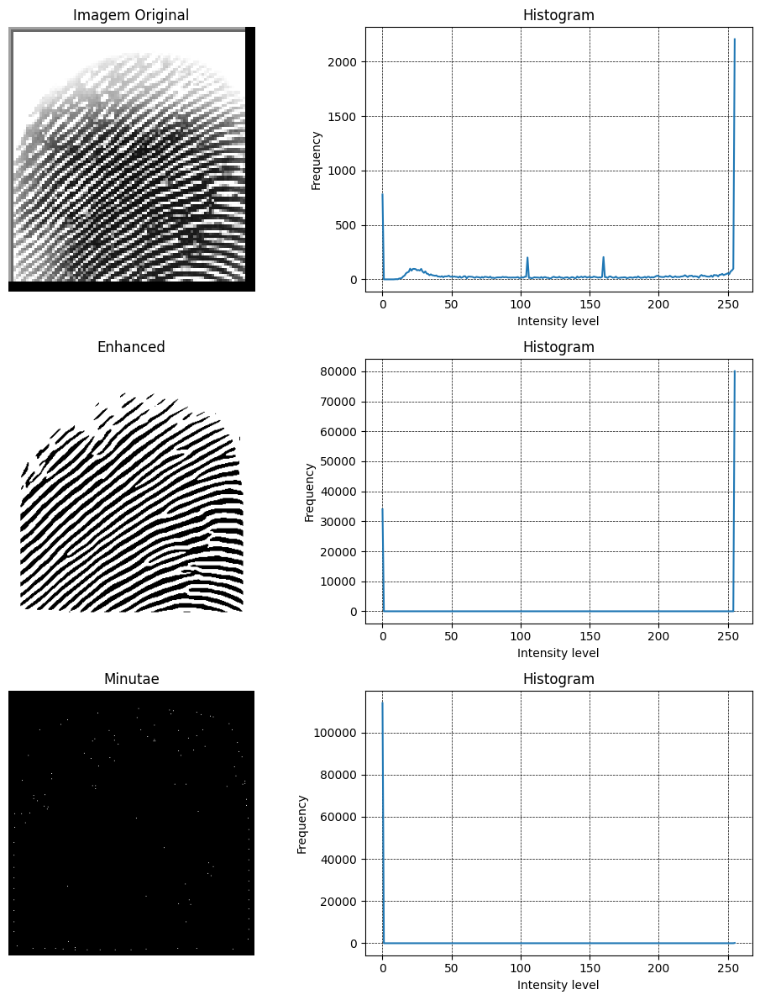

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.6  |               79.05 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.9  |              173.89 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.52 |
+-----------------+------------+-----------+---------------------+


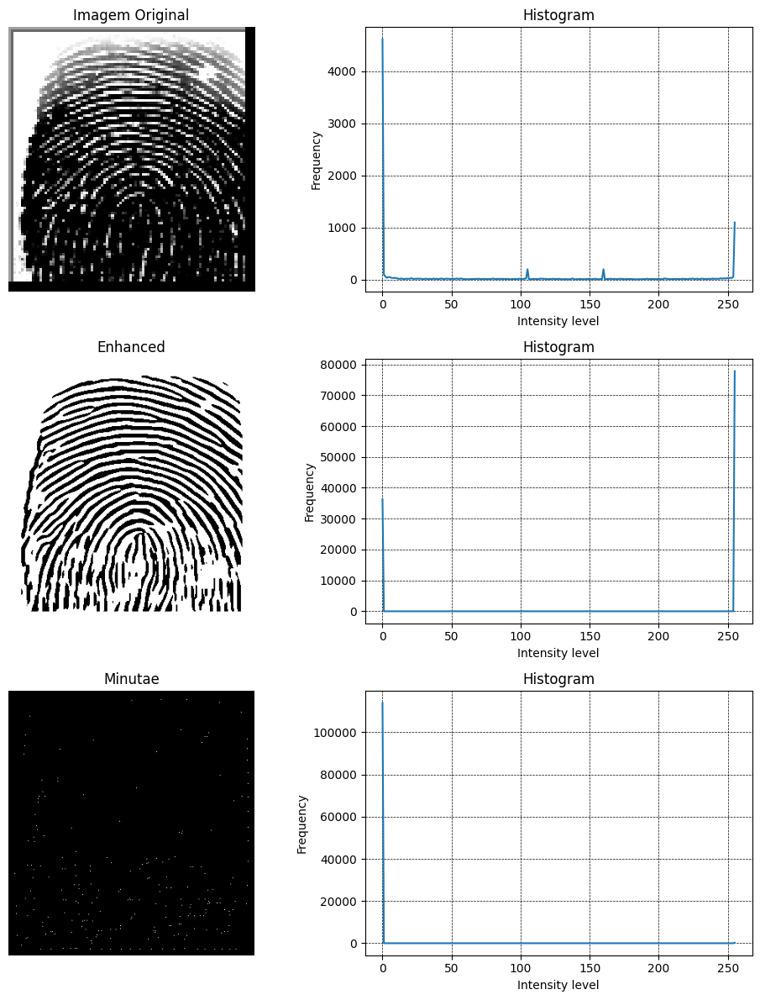

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.92 |              152.48 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.8  |              193.1  |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.34 |
+-----------------+------------+-----------+---------------------+


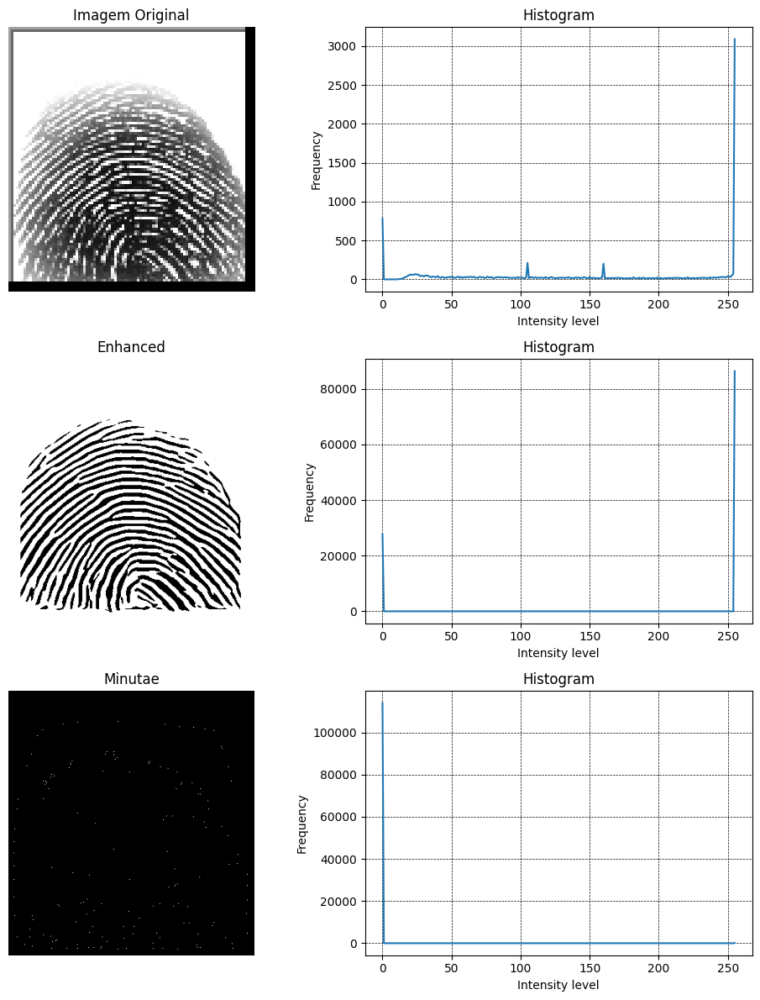

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.59 |              115.03 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.91 |              171.45 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.43 |
+-----------------+------------+-----------+---------------------+


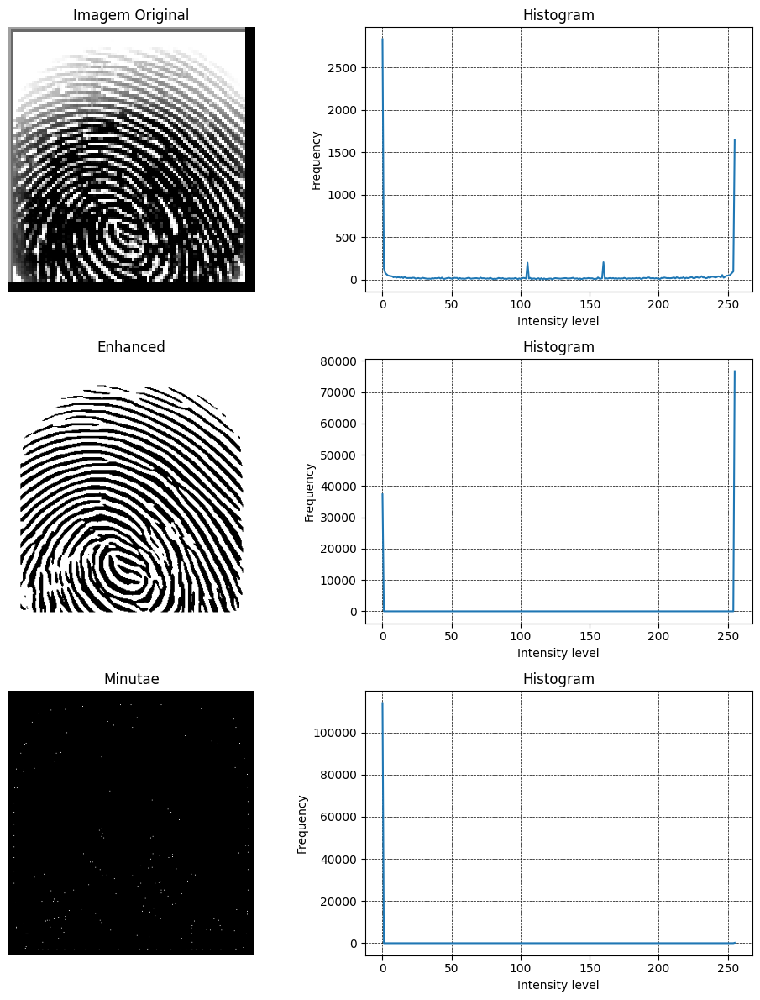

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      6.59 |              145.52 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.82 |              189.16 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.03 |                0.66 |
+-----------------+------------+-----------+---------------------+


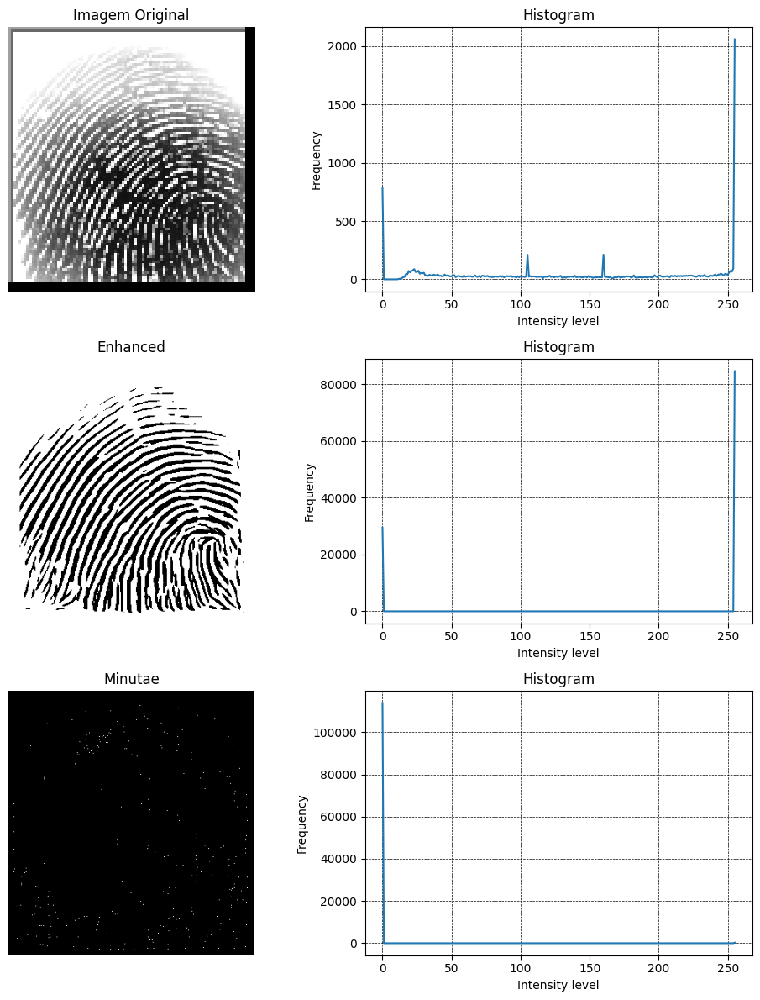

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.72 |               73.73 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.93 |              166.55 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.38 |
+-----------------+------------+-----------+---------------------+


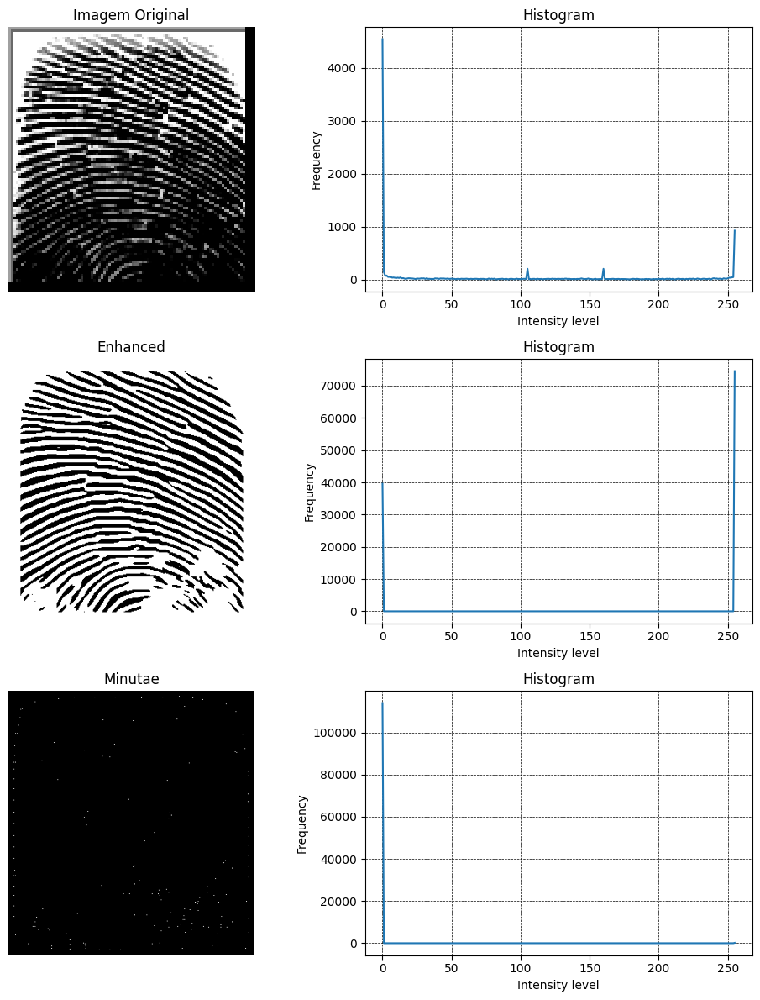

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.32 |              156.01 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.86 |              182.09 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.22 |
+-----------------+------------+-----------+---------------------+


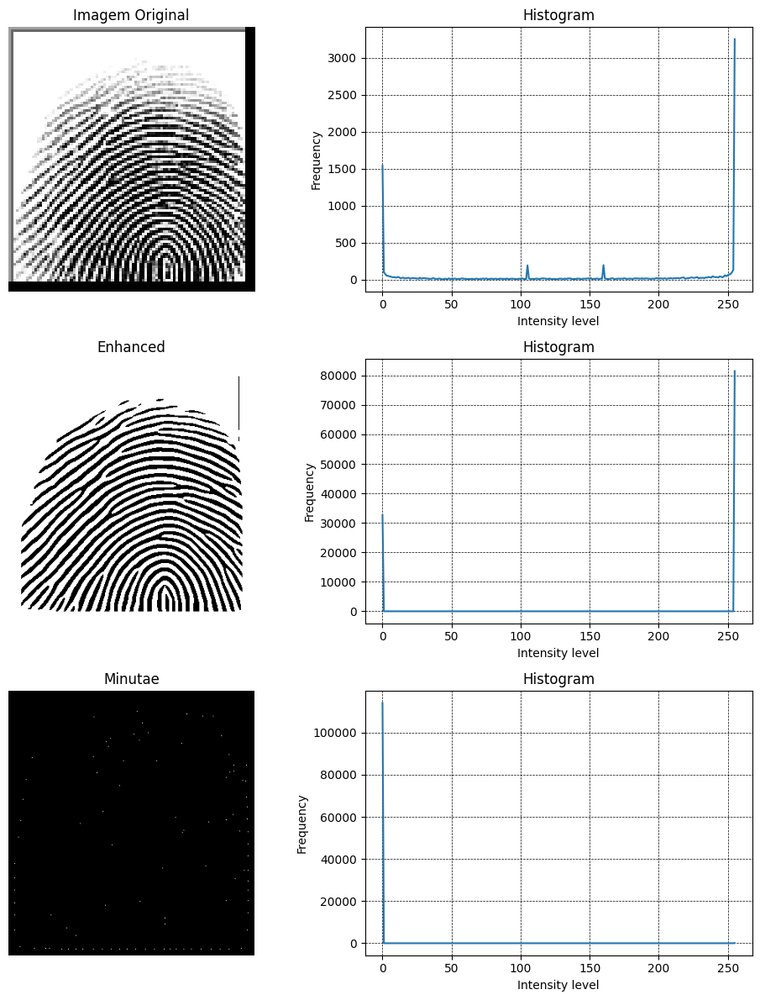

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.93 |              152.06 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.8  |              193.65 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.31 |
+-----------------+------------+-----------+---------------------+


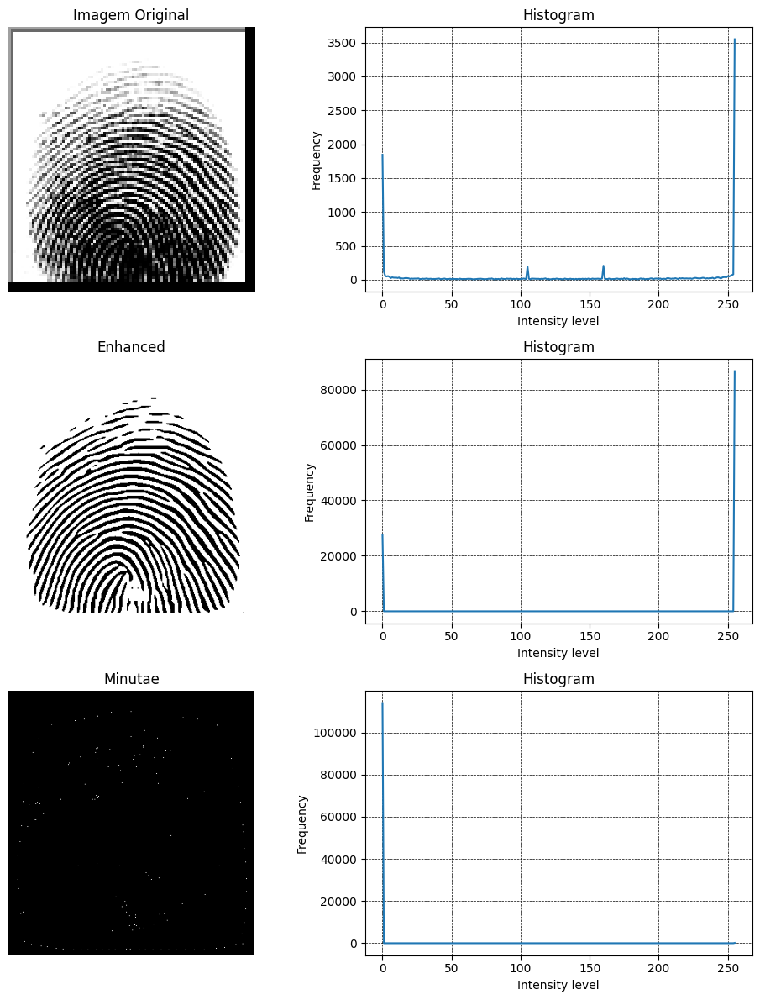

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.07 |              174.36 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.81 |              190.65 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.25 |
+-----------------+------------+-----------+---------------------+


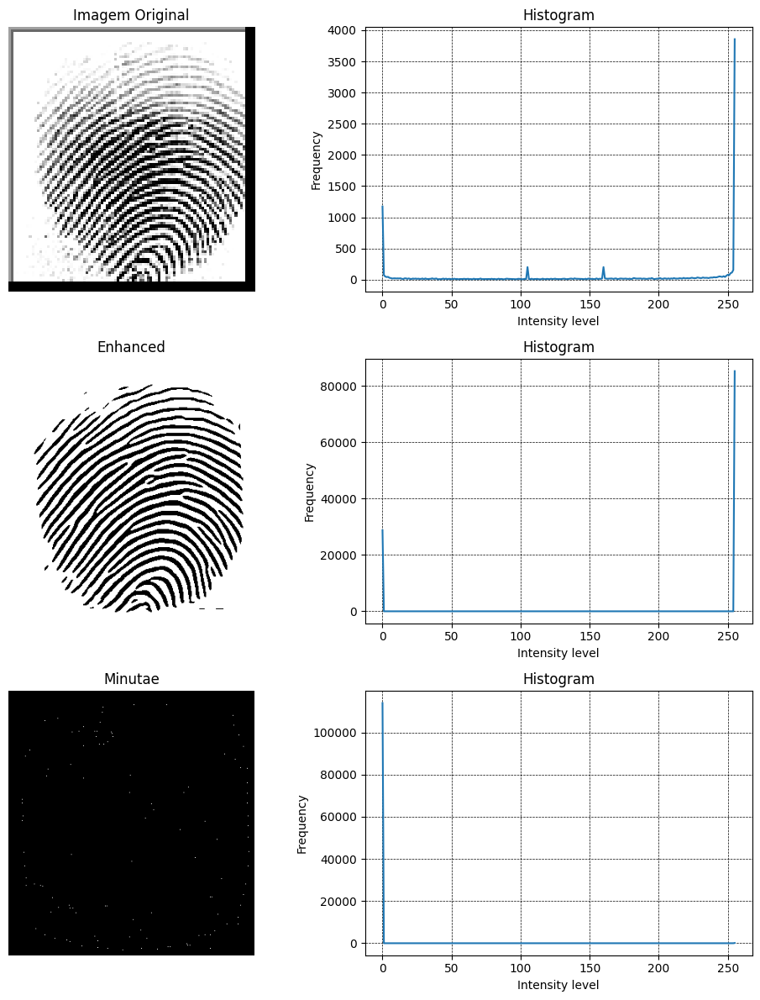

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.8  |              148.86 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.9  |              175.54 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.23 |
+-----------------+------------+-----------+---------------------+


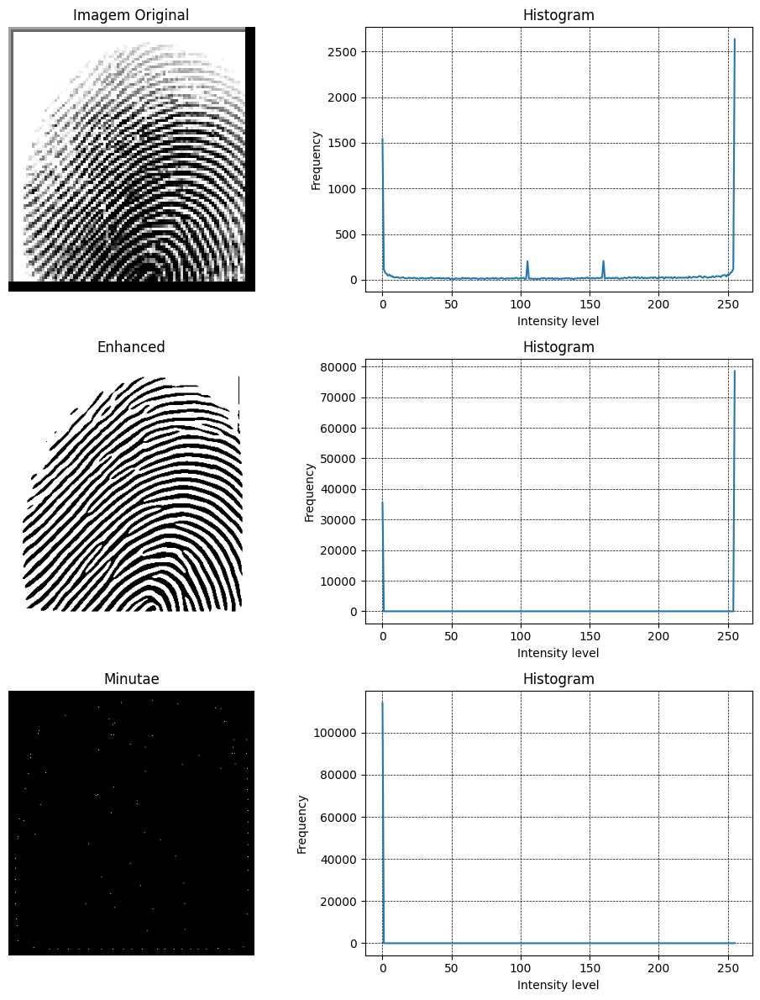

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.96 |              173.43 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.83 |              188.79 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.2  |
+-----------------+------------+-----------+---------------------+


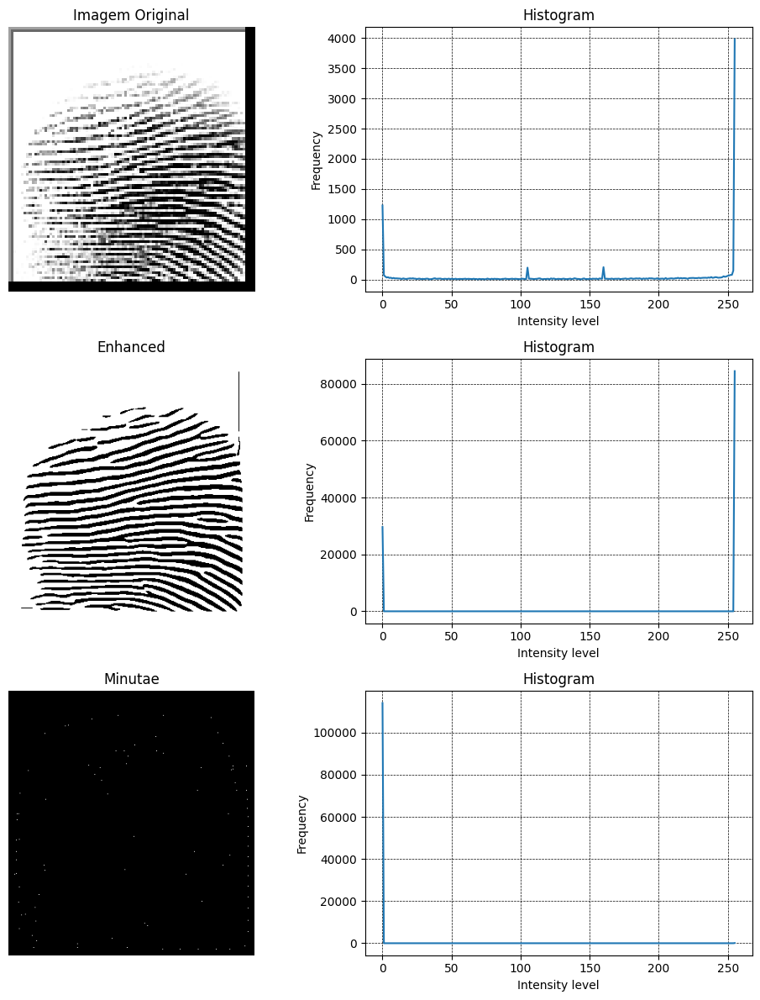

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.36 |               94.83 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.91 |              170.95 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.29 |
+-----------------+------------+-----------+---------------------+


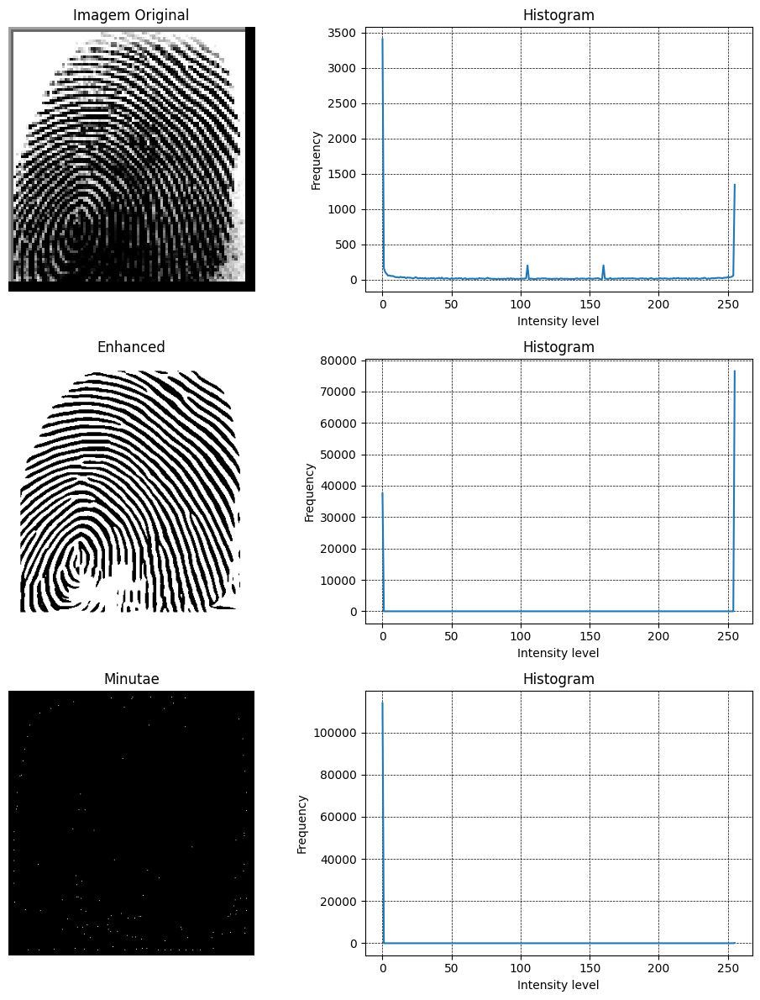

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.8  |              154.49 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.83 |              187.83 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.23 |
+-----------------+------------+-----------+---------------------+


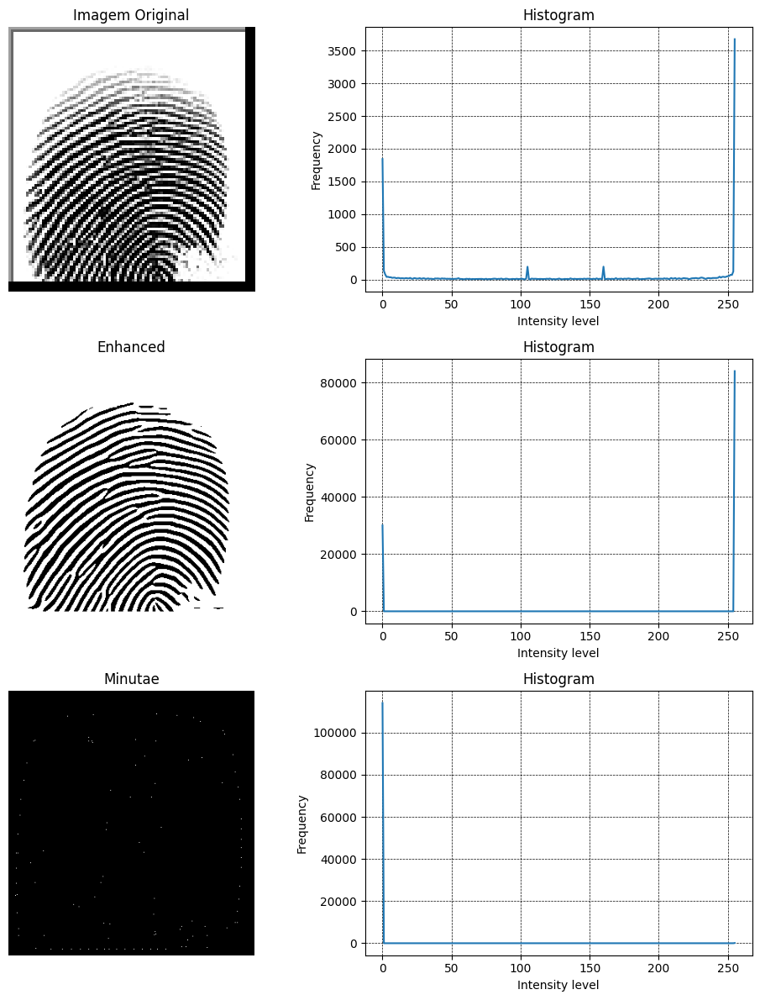

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.6  |              119.63 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.91 |              171.64 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.23 |
+-----------------+------------+-----------+---------------------+


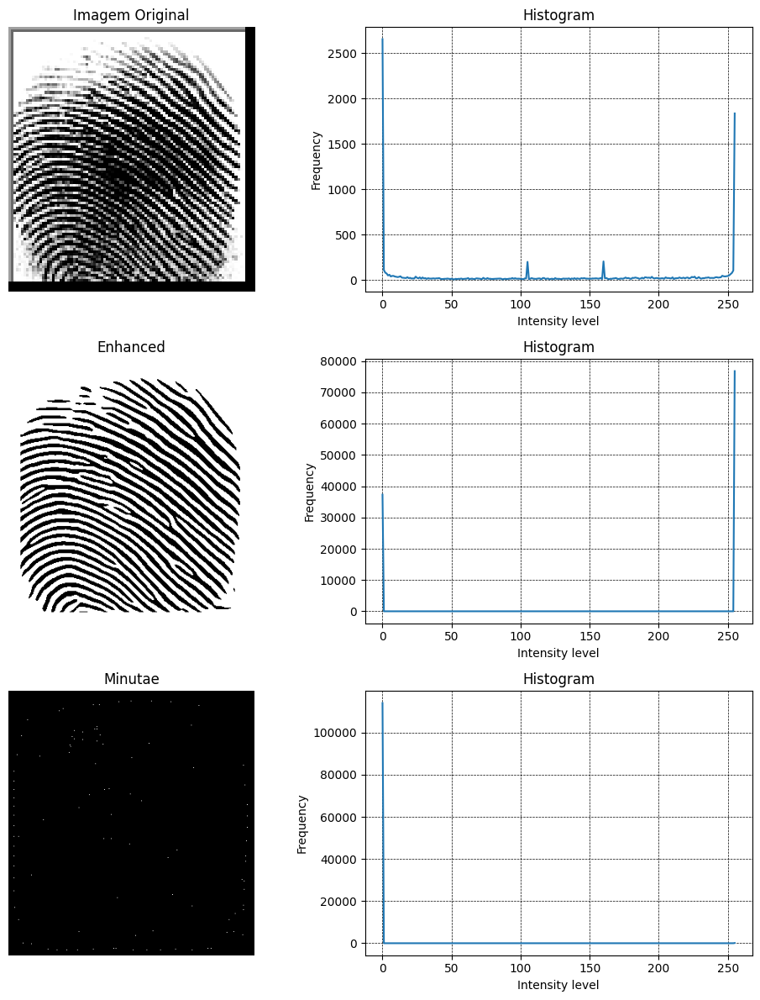

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.44 |              136.01 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.87 |              180.01 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.21 |
+-----------------+------------+-----------+---------------------+


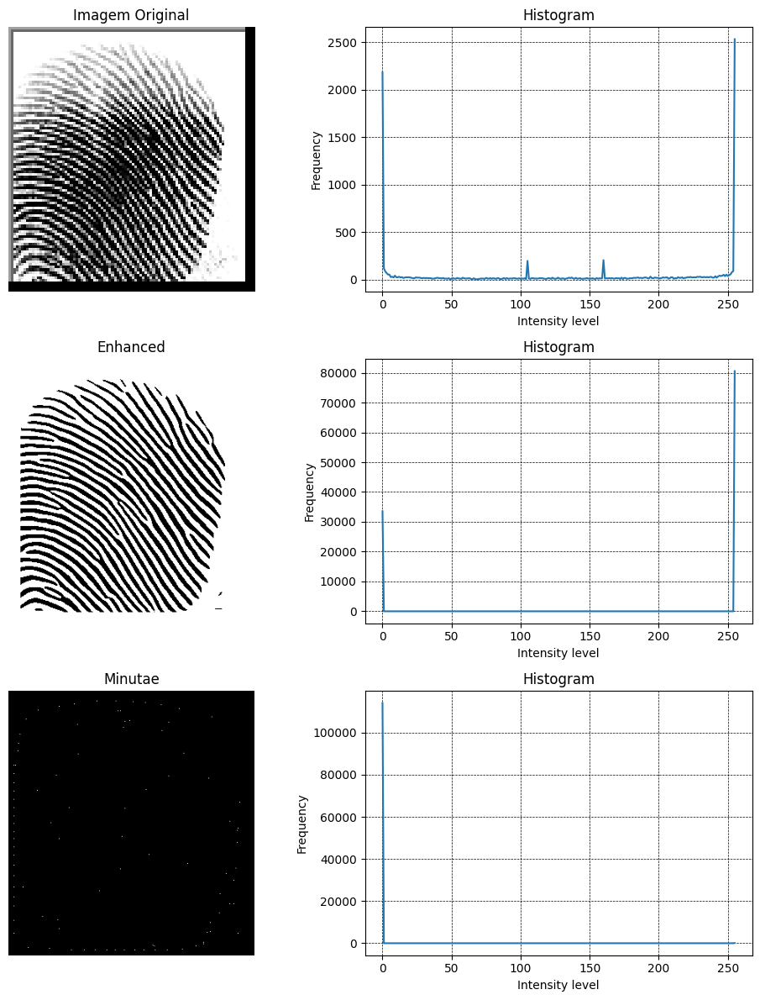

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.92 |              131.57 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.93 |              167.98 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.26 |
+-----------------+------------+-----------+---------------------+


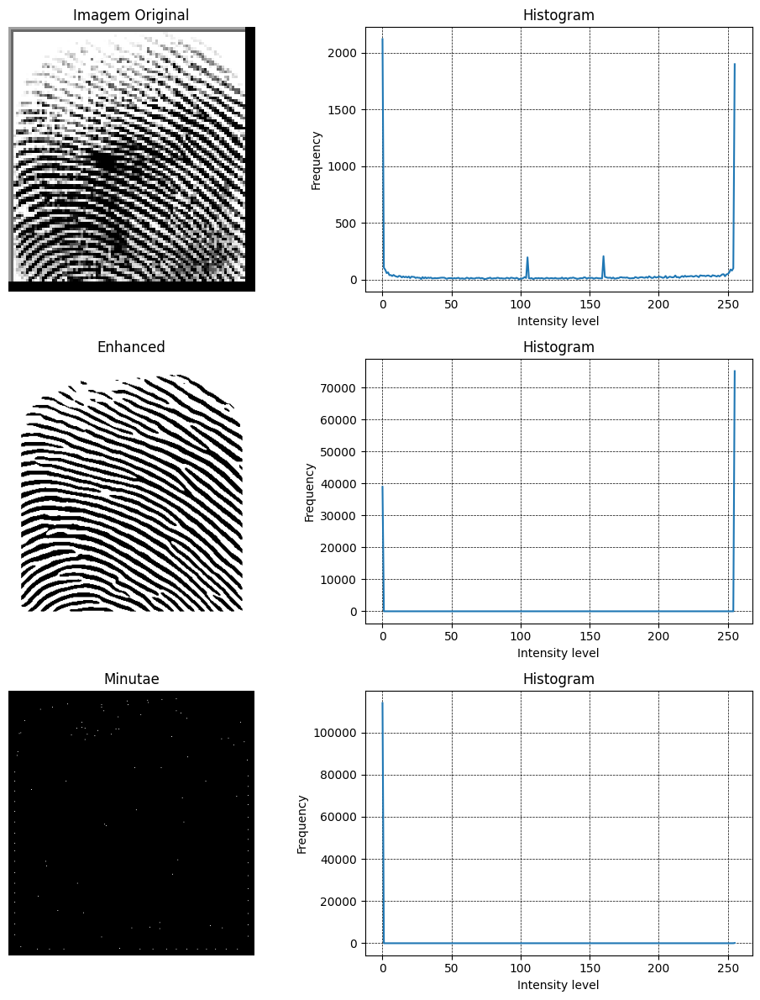

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.3  |              126.85 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.88 |              179.17 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.34 |
+-----------------+------------+-----------+---------------------+


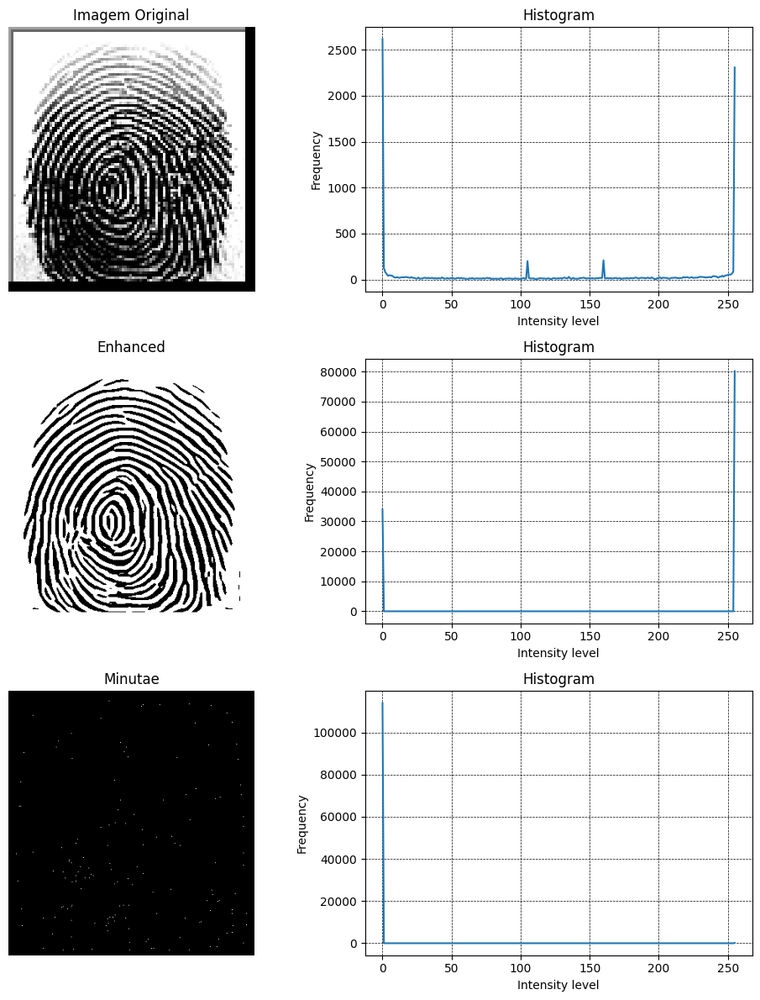

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.12 |              160.96 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.83 |              187.96 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.32 |
+-----------------+------------+-----------+---------------------+


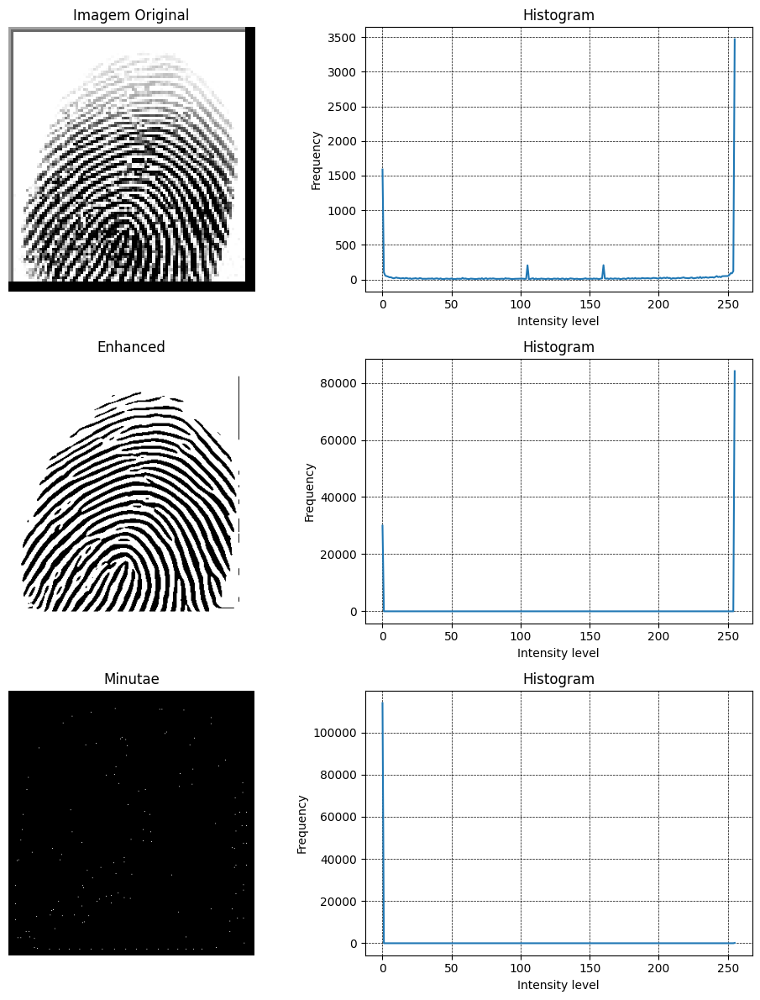

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.22 |              141.08 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.86 |              182.95 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.21 |
+-----------------+------------+-----------+---------------------+


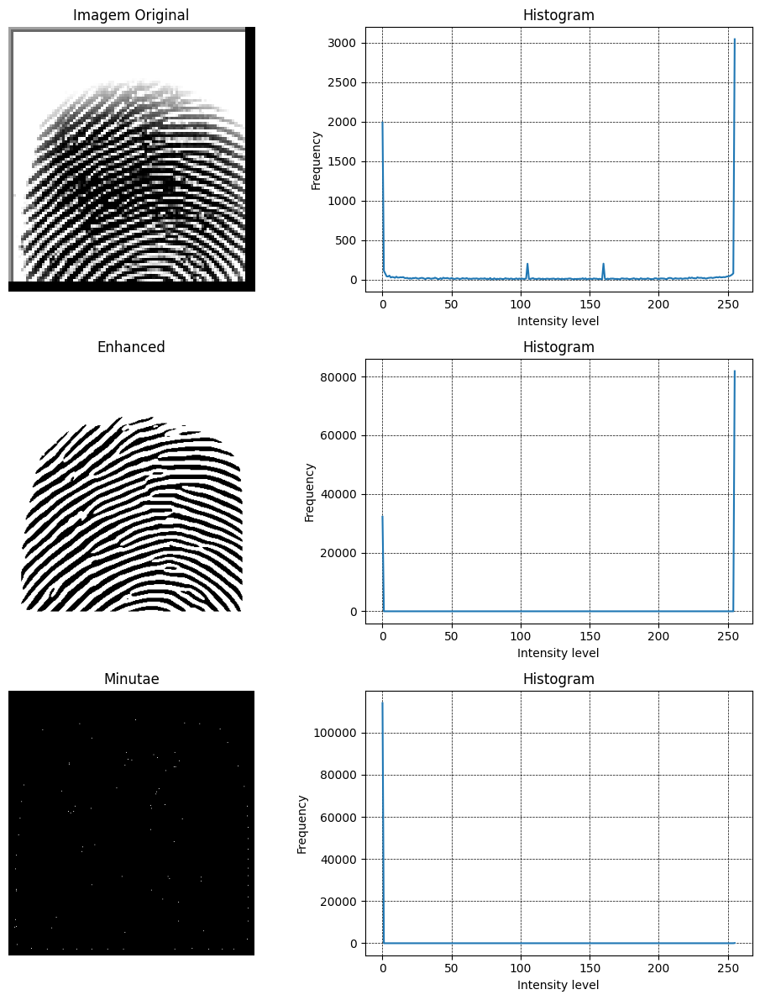

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.4  |              144.15 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.86 |              182.07 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.28 |
+-----------------+------------+-----------+---------------------+


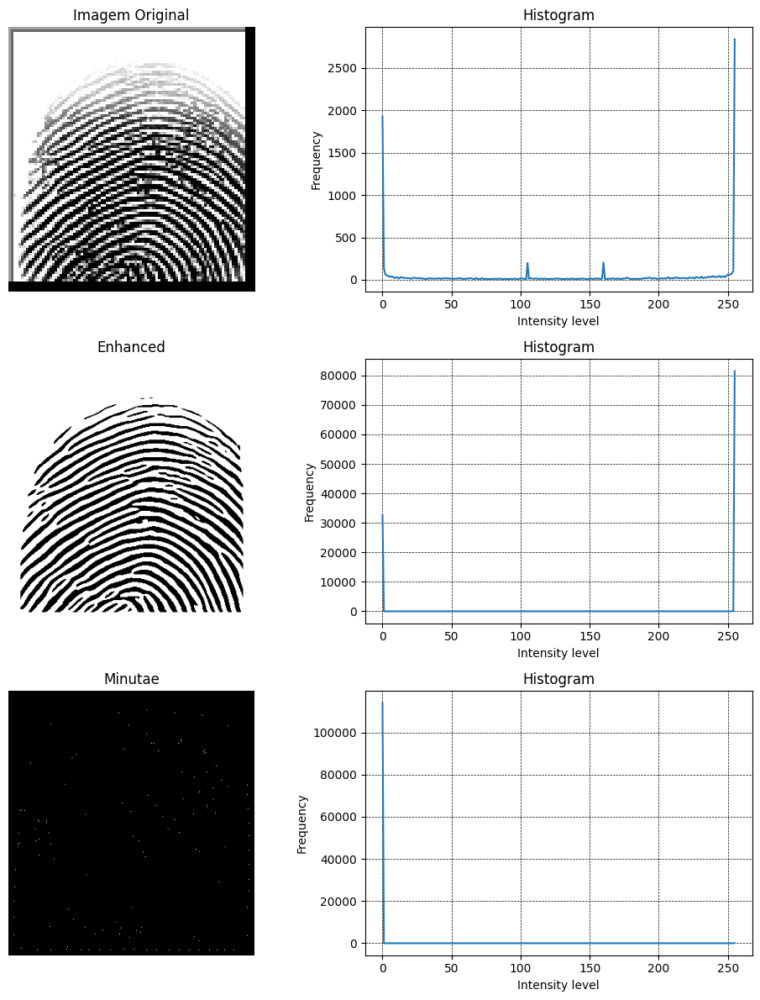

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.69 |              135.04 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.9  |              174.06 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.34 |
+-----------------+------------+-----------+---------------------+


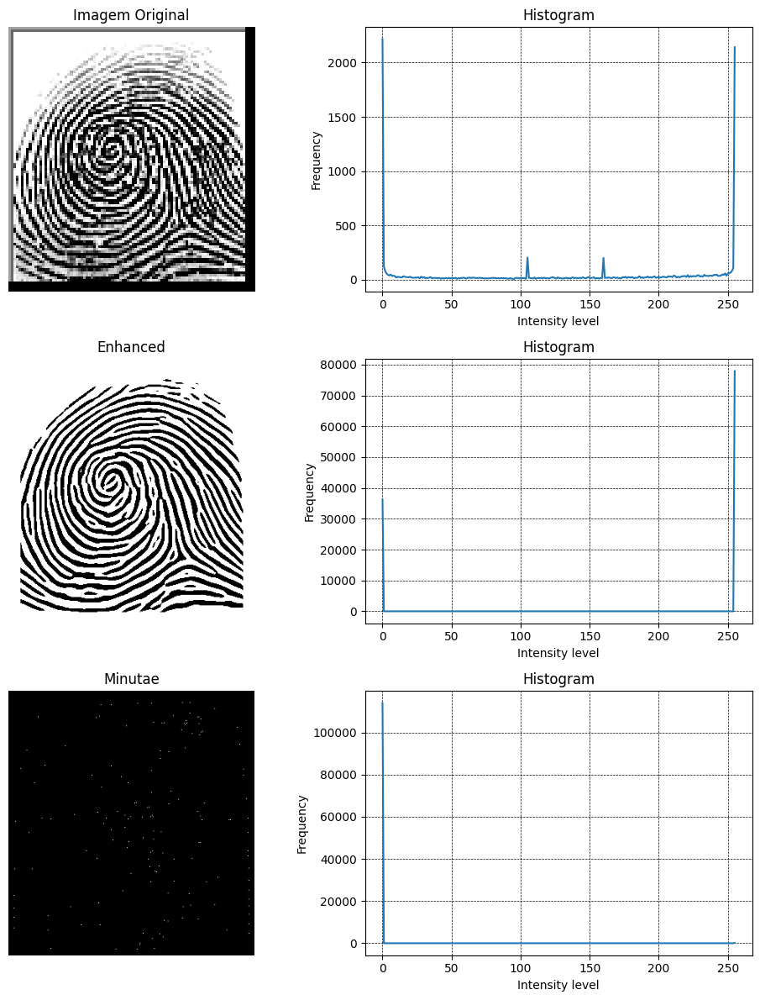

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.37 |              129.9  |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.88 |              177.82 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.34 |
+-----------------+------------+-----------+---------------------+


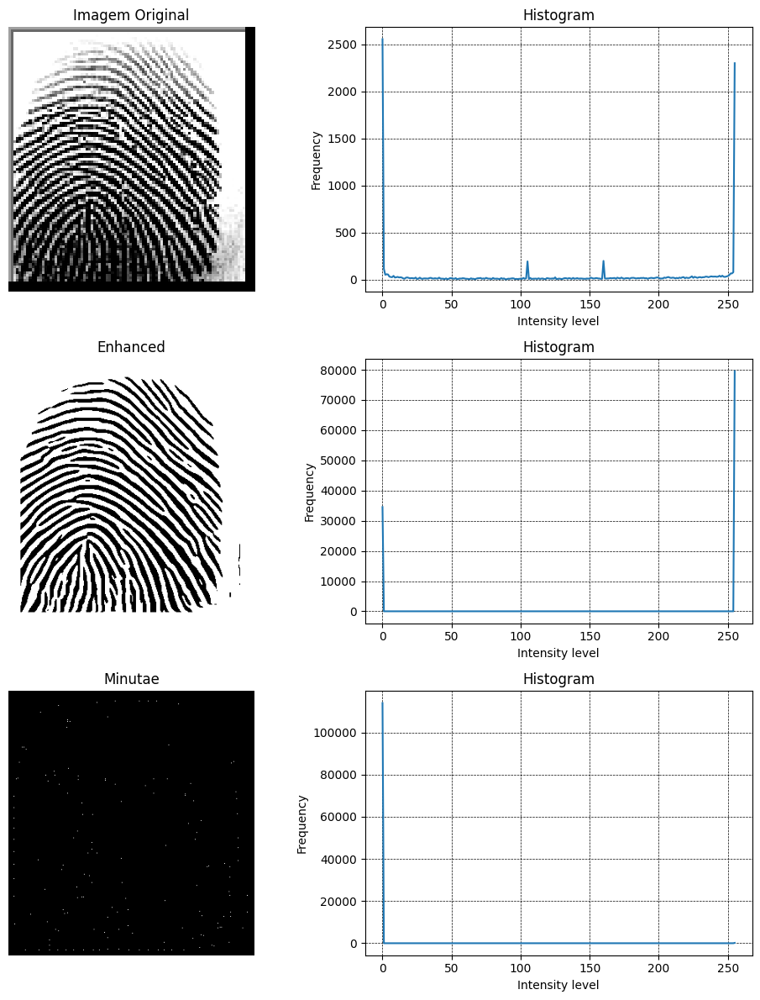

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.45 |              156.93 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.82 |              189.49 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.4  |
+-----------------+------------+-----------+---------------------+


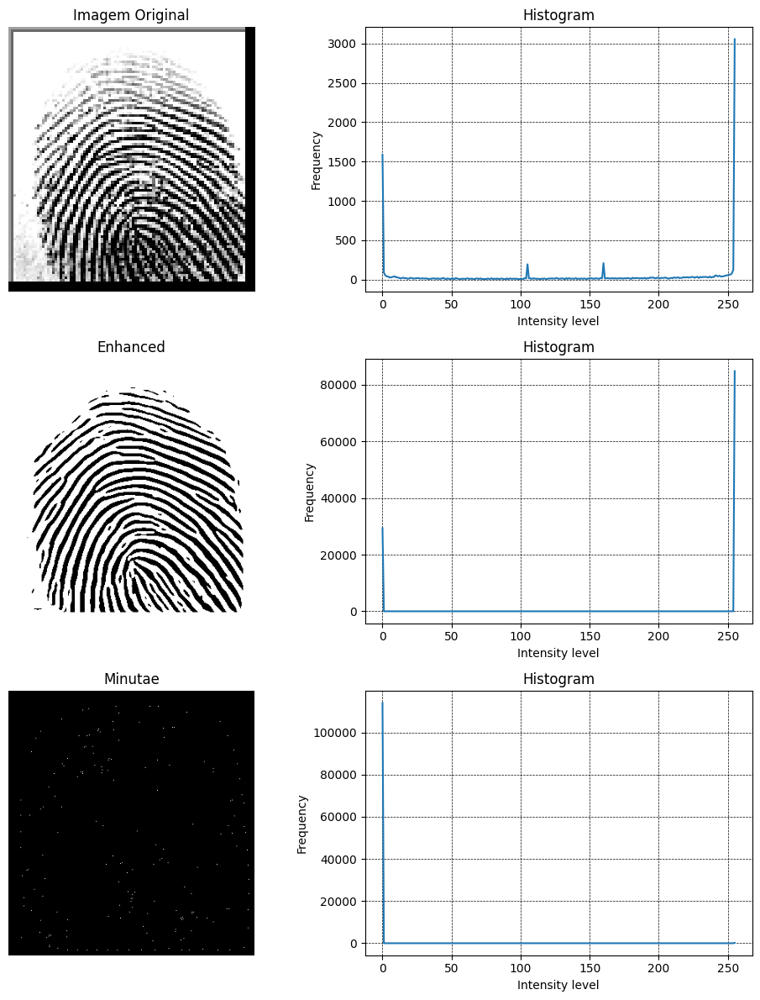

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.56 |              137.8  |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.86 |              182.78 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.26 |
+-----------------+------------+-----------+---------------------+


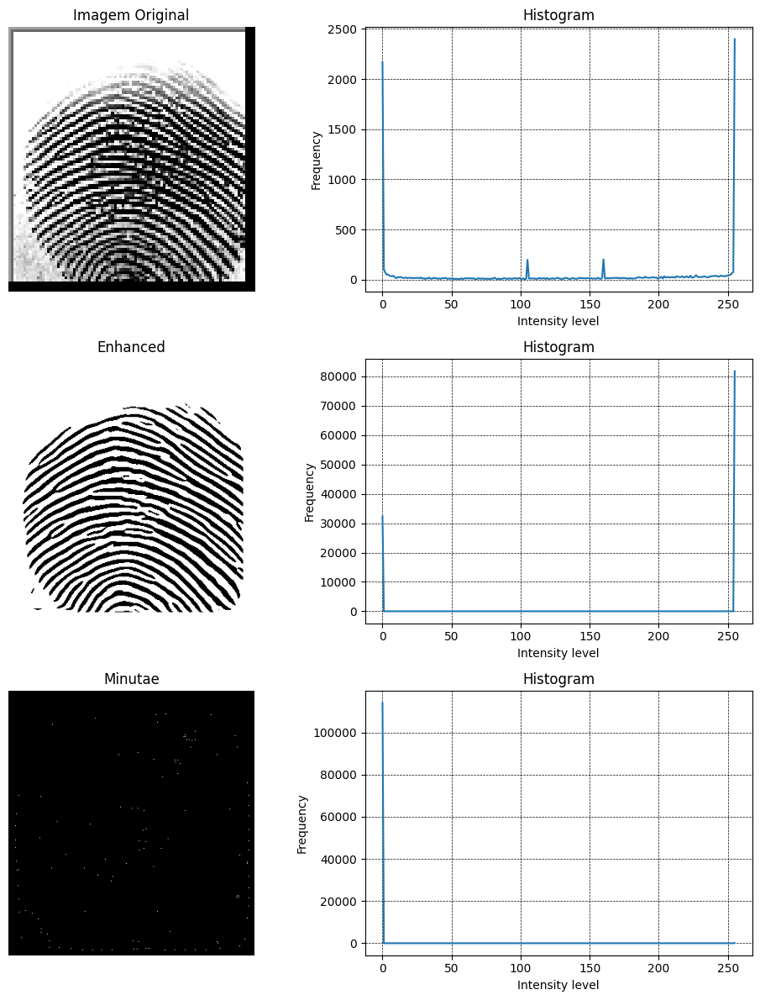

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.13 |              155.82 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.82 |              189.17 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.23 |
+-----------------+------------+-----------+---------------------+


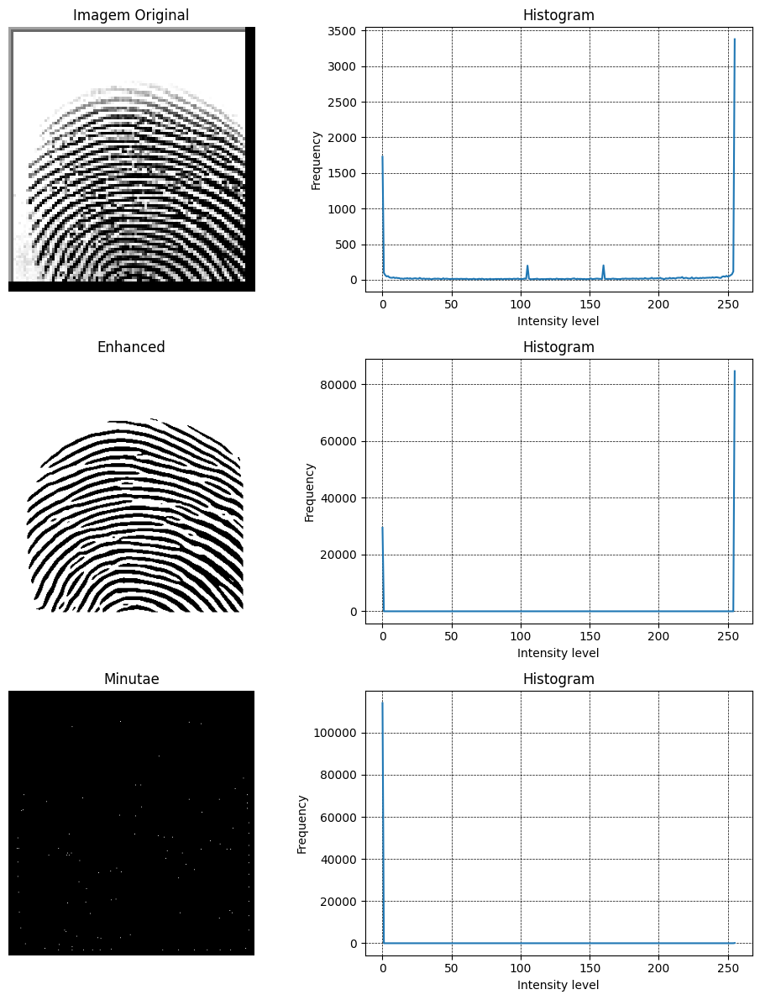

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.3  |              164.65 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.77 |              197.79 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.6  |
+-----------------+------------+-----------+---------------------+


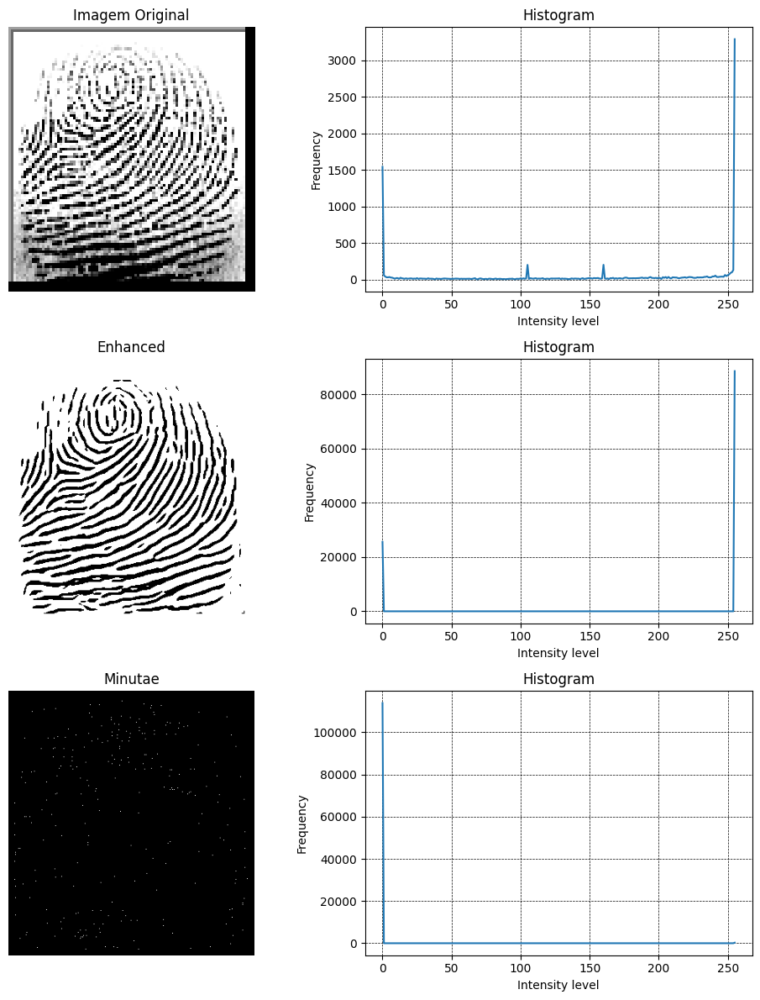

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      3.74 |              106.88 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.58 |              219.71 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.57 |
+-----------------+------------+-----------+---------------------+


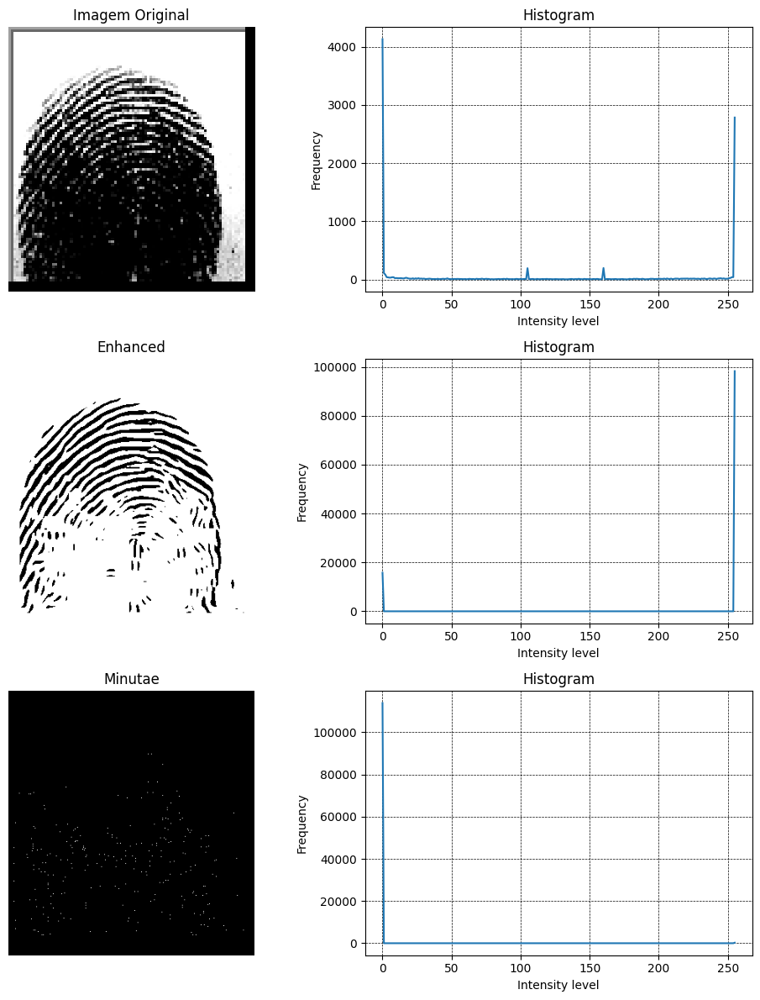

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.52 |              178.23 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.59 |              218.54 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.53 |
+-----------------+------------+-----------+---------------------+


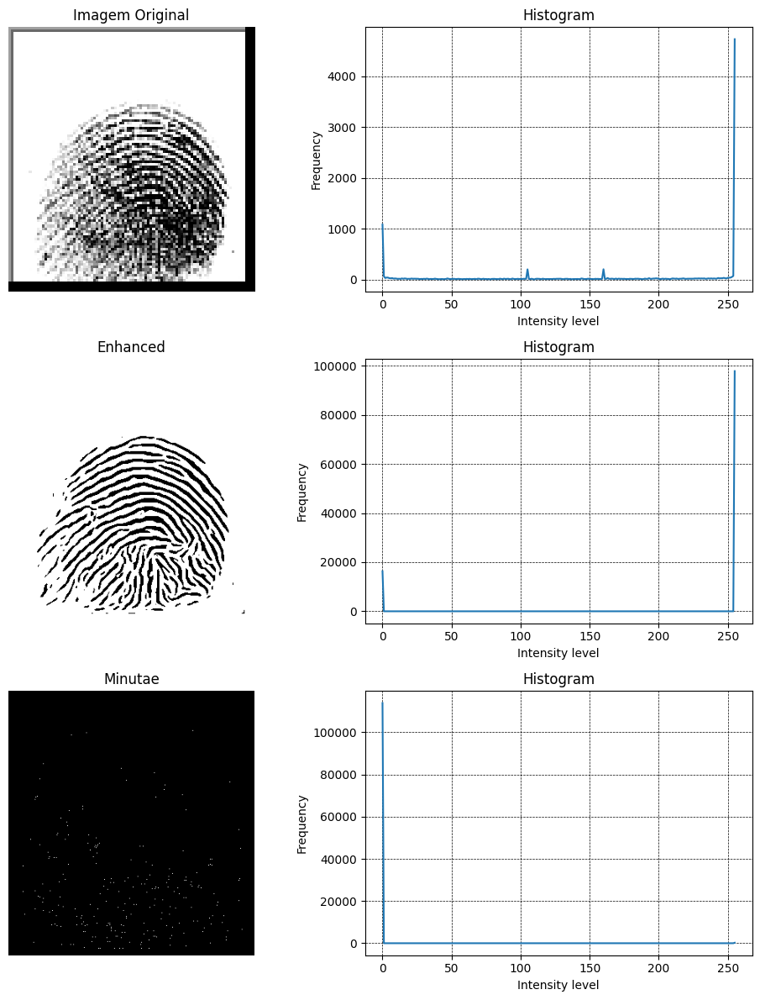

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.82 |              127.99 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.7  |              207.26 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.45 |
+-----------------+------------+-----------+---------------------+


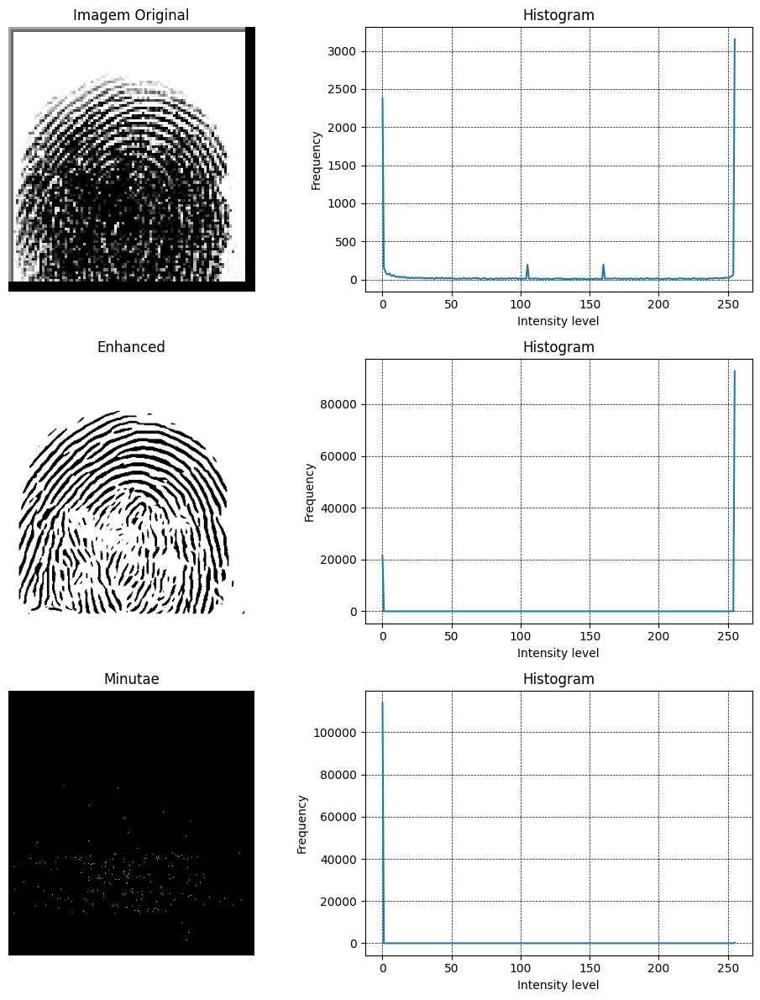

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.41 |              171.42 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.72 |              204.38 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.58 |
+-----------------+------------+-----------+---------------------+


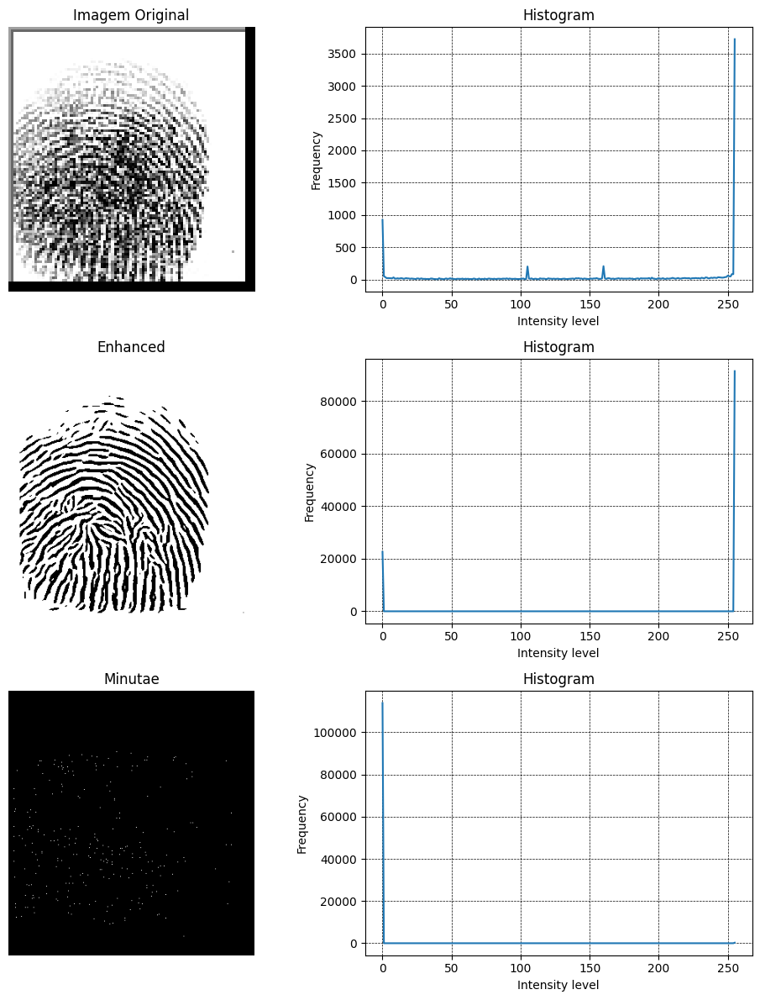

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.26 |              147.53 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.86 |              182.23 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.32 |
+-----------------+------------+-----------+---------------------+


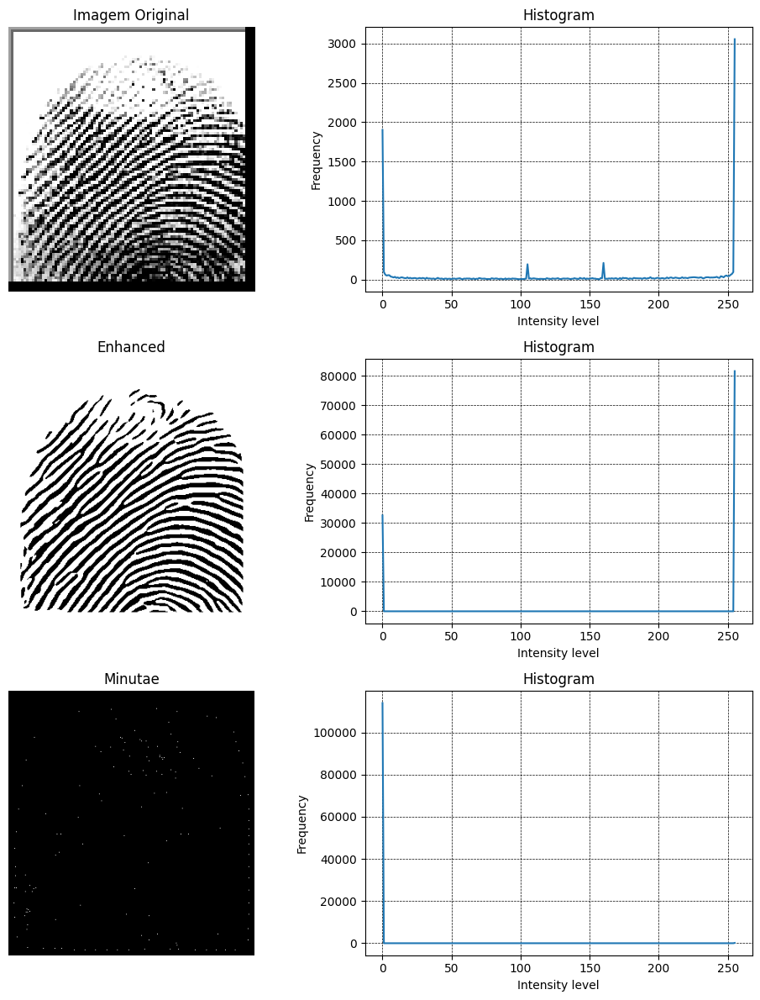

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.59 |              125.68 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.8  |              192.85 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.47 |
+-----------------+------------+-----------+---------------------+


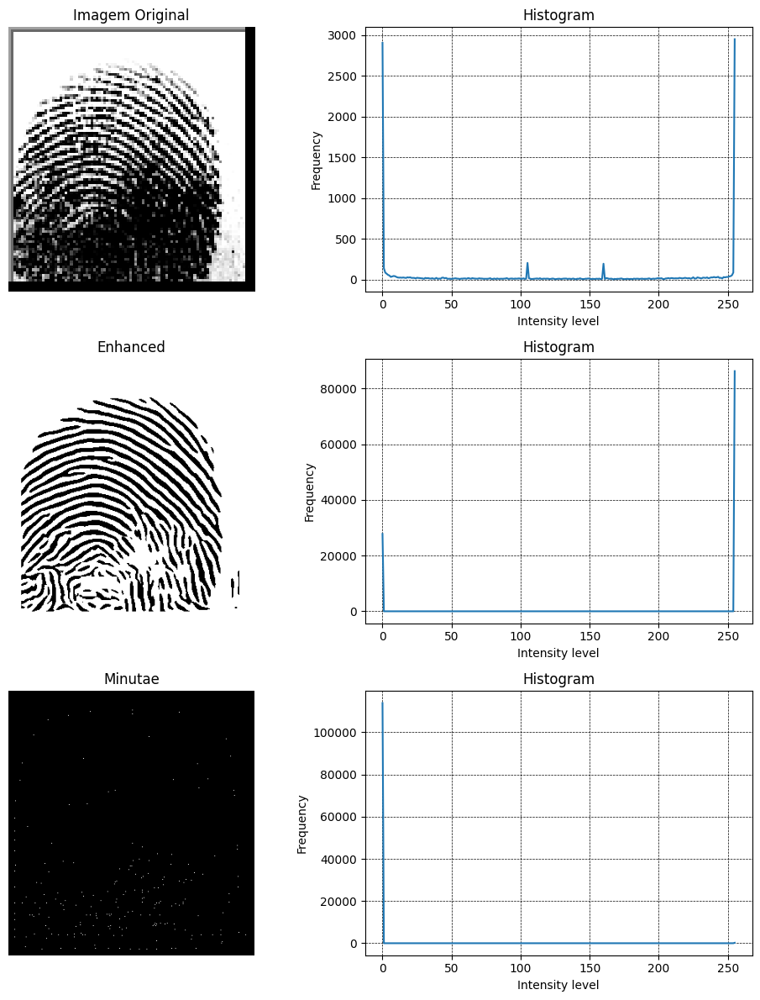

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.44 |              143.33 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.61 |              217.19 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.45 |
+-----------------+------------+-----------+---------------------+


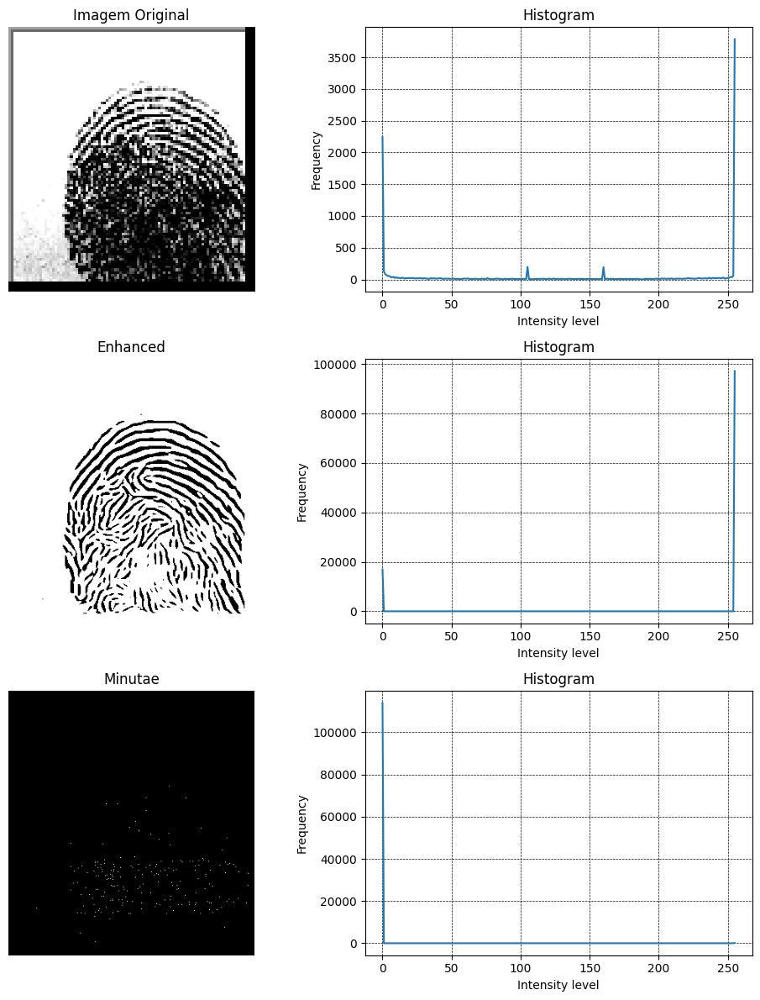

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.66 |              128.12 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.75 |              200.06 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.59 |
+-----------------+------------+-----------+---------------------+


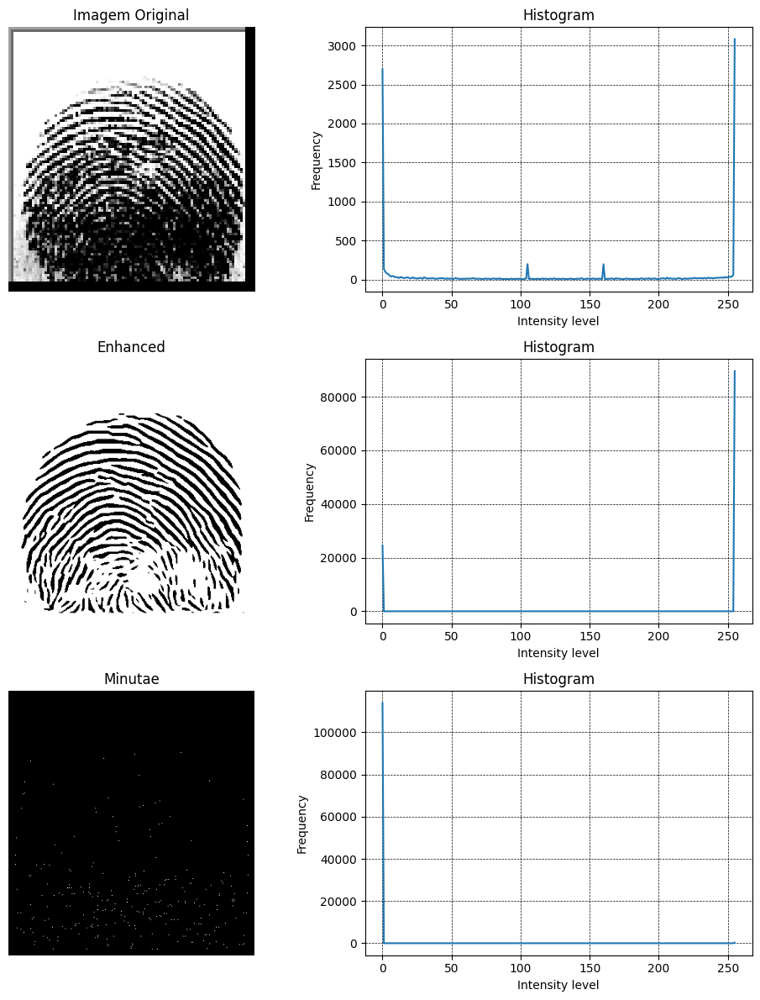

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.72 |              128.39 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.75 |              200.41 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.6  |
+-----------------+------------+-----------+---------------------+


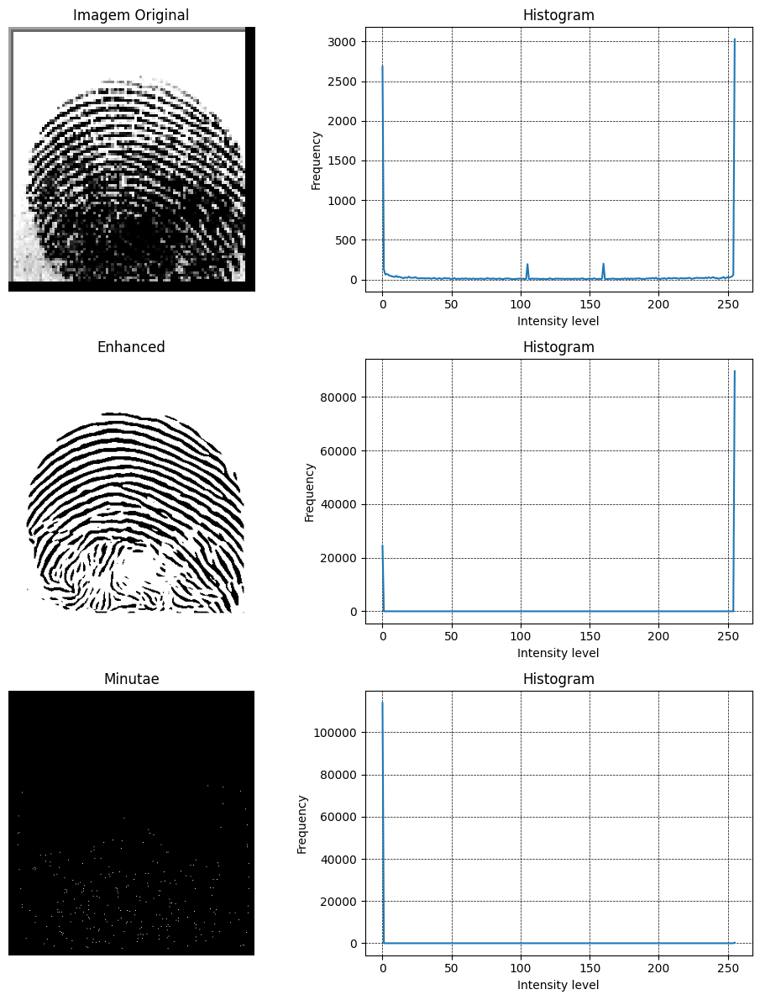

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.17 |              140.59 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.85 |              184.36 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.37 |
+-----------------+------------+-----------+---------------------+


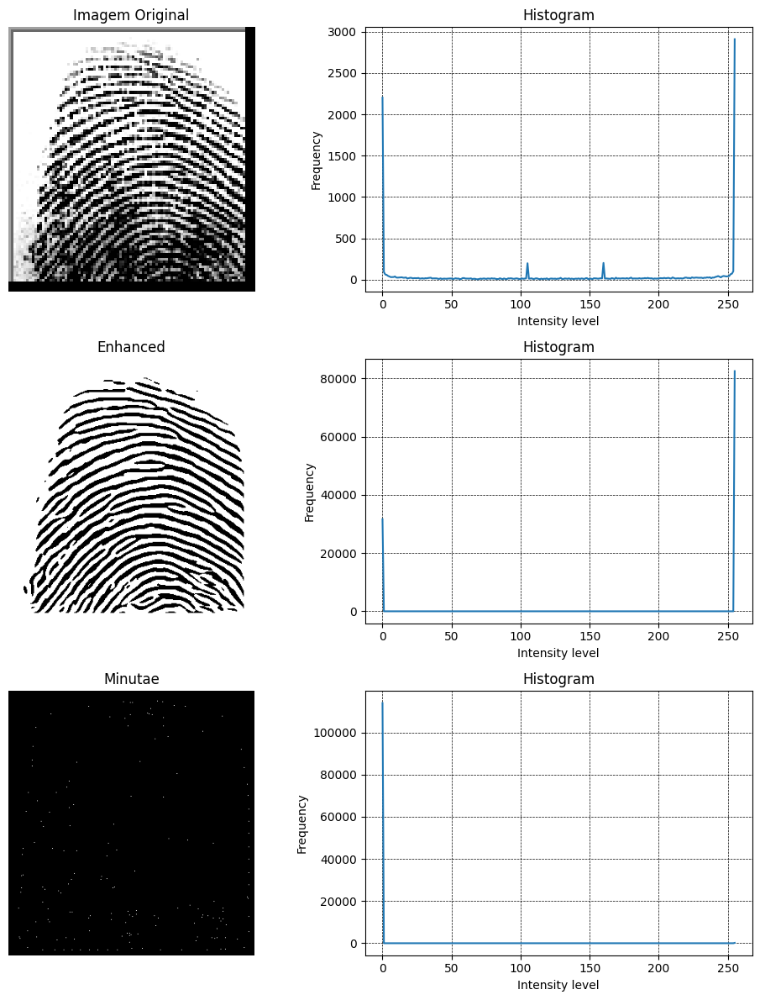

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      3.51 |              164.1  |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.68 |              208.92 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.28 |
+-----------------+------------+-----------+---------------------+


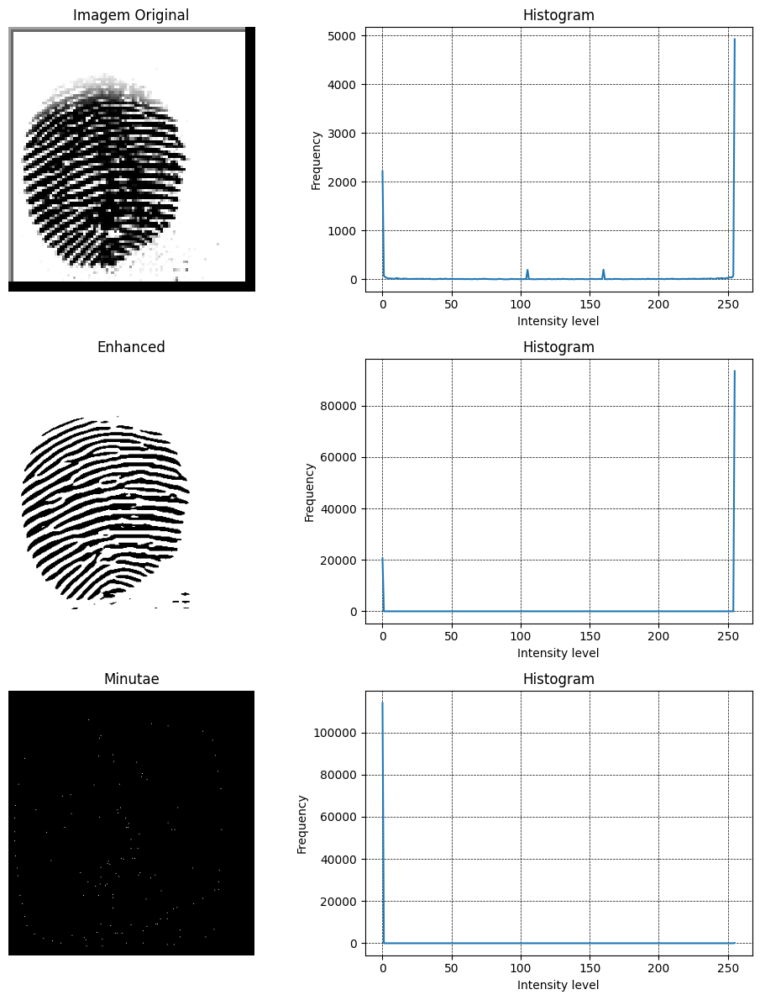

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      3.05 |              184.21 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.57 |              220.52 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.17 |
+-----------------+------------+-----------+---------------------+


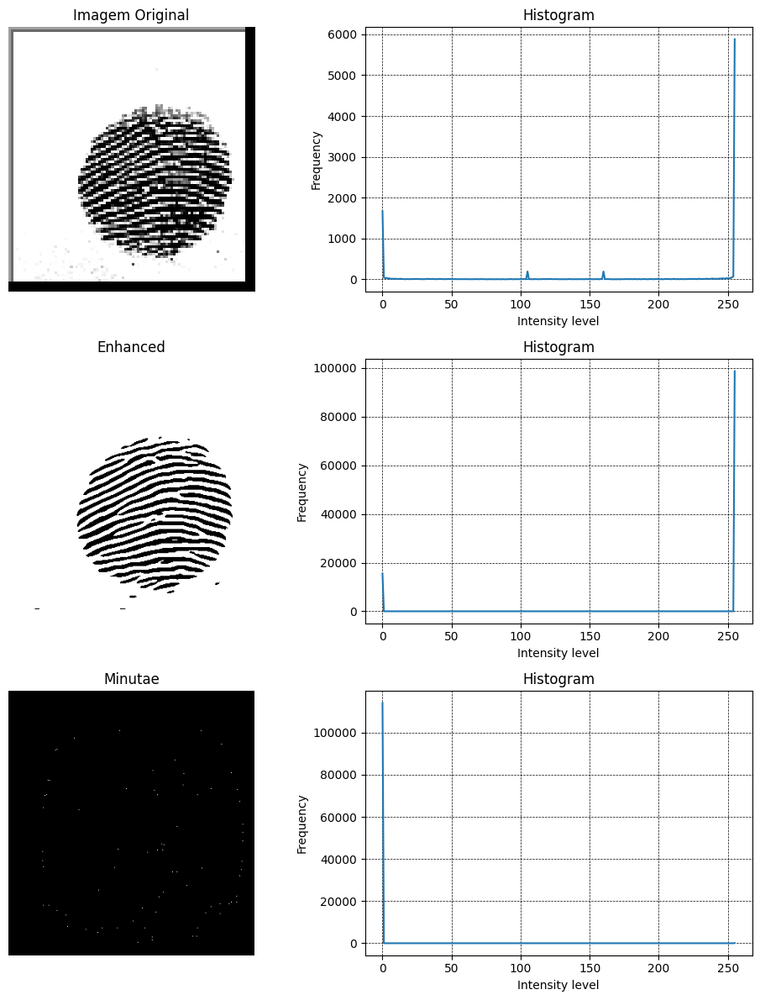

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.04 |              160.75 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.75 |              200.33 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.22 |
+-----------------+------------+-----------+---------------------+


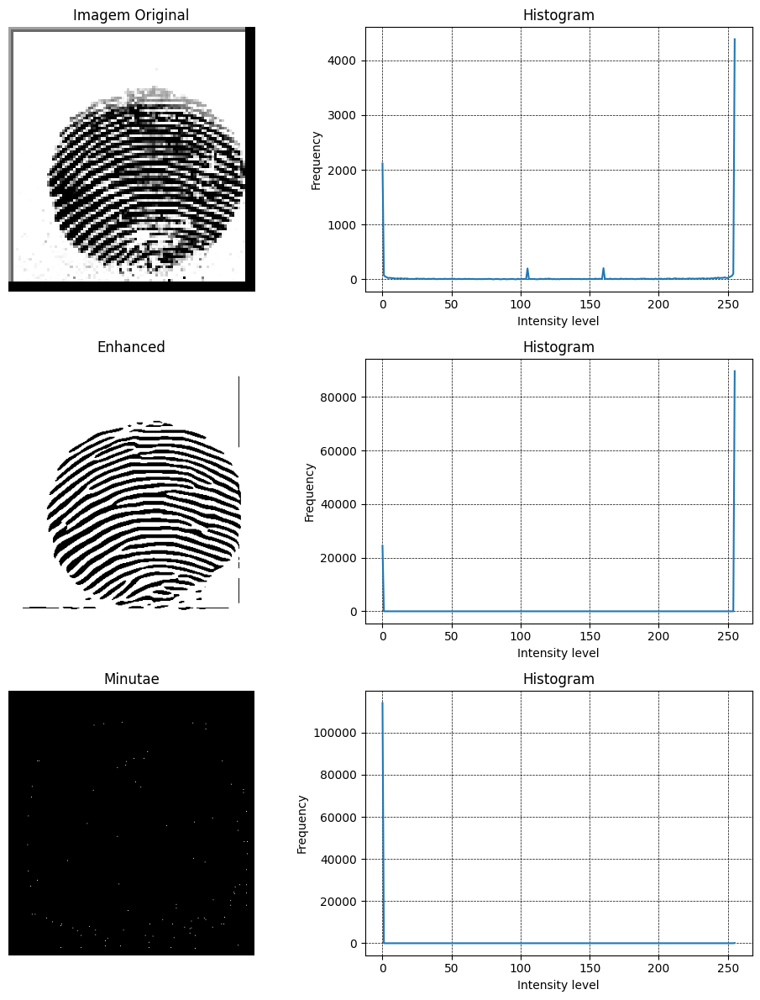

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.08 |              146.23 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.76 |              199.16 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.19 |
+-----------------+------------+-----------+---------------------+


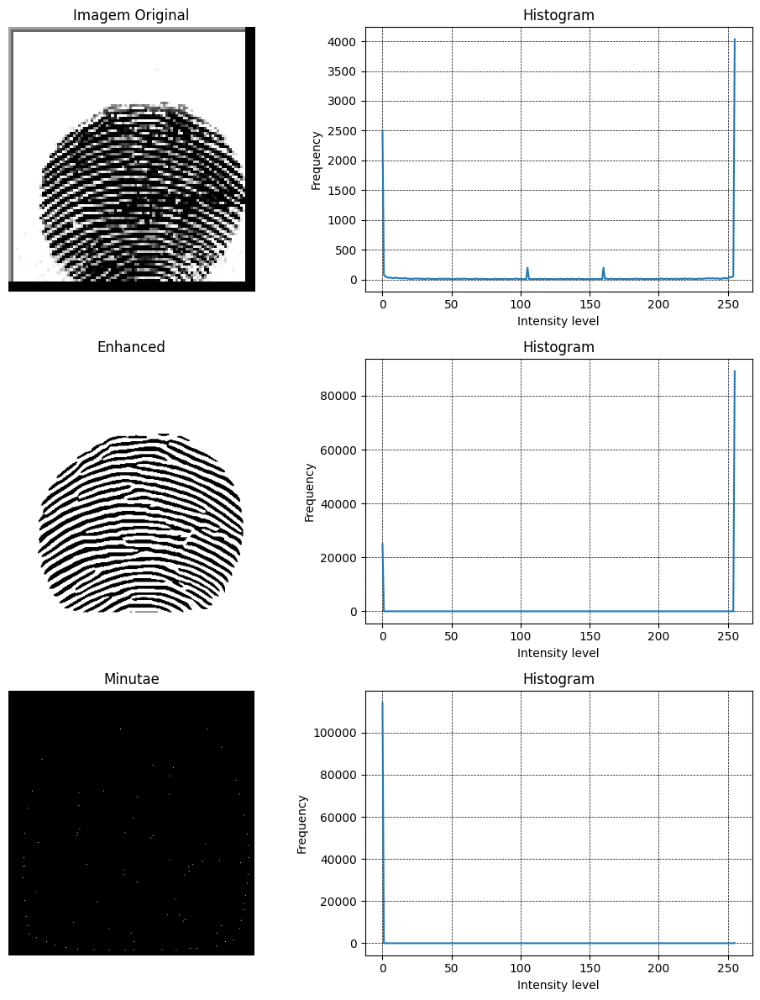

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.54 |              161.49 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.72 |              204.21 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.38 |
+-----------------+------------+-----------+---------------------+


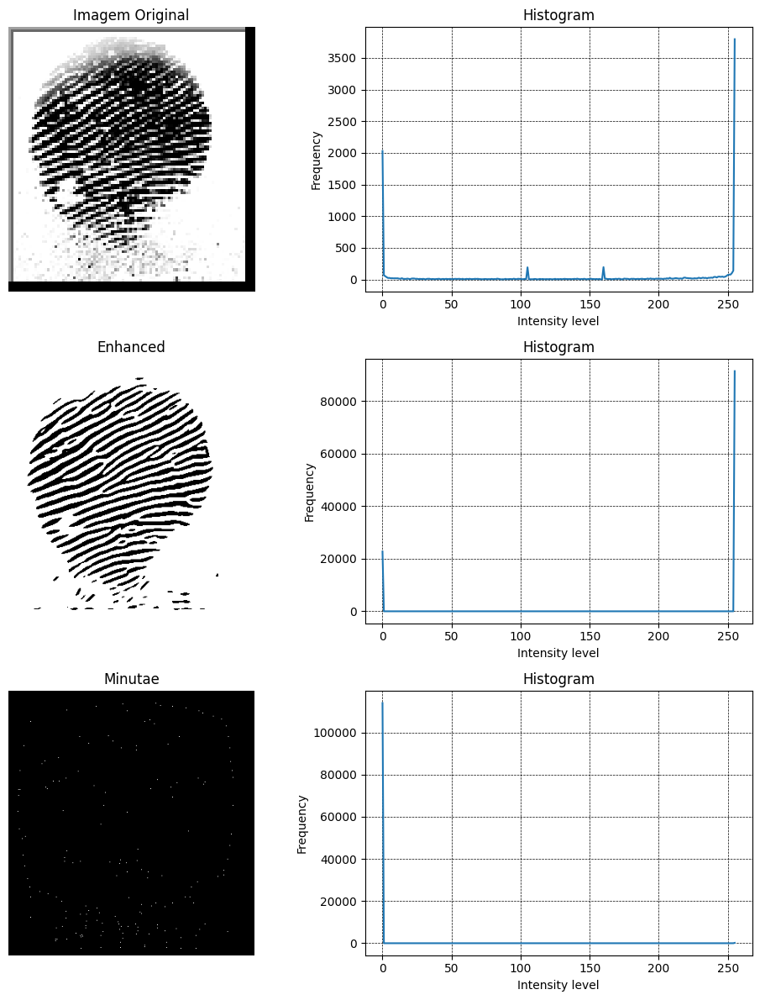

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.33 |              157.72 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.74 |              201.12 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.58 |
+-----------------+------------+-----------+---------------------+


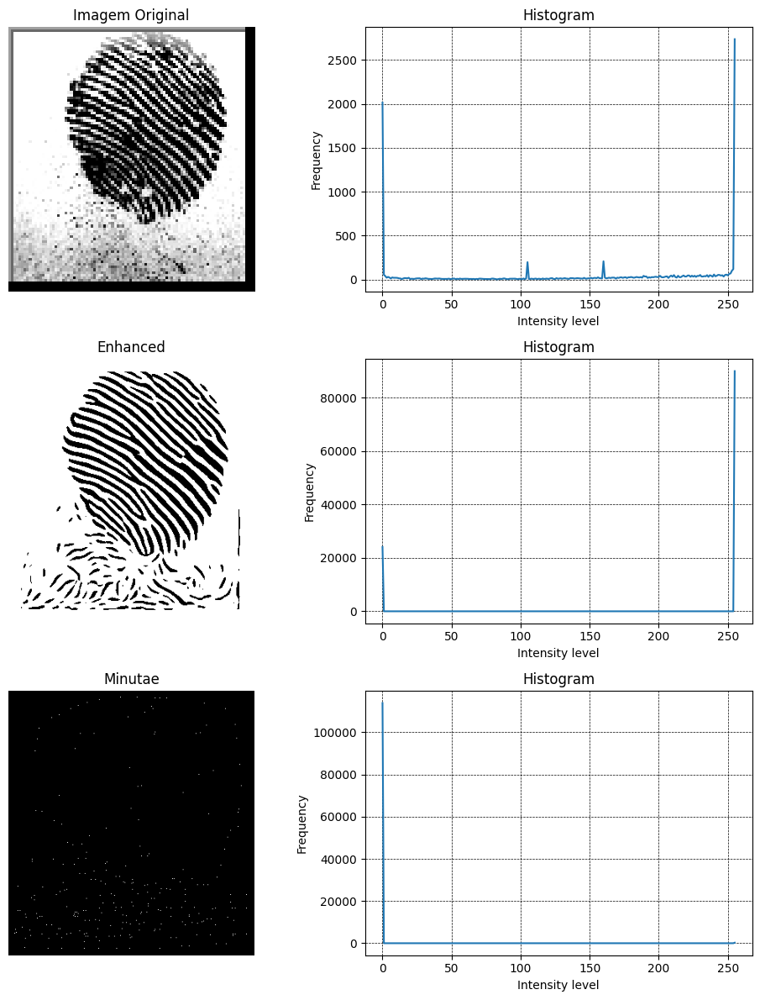

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.1  |              163.64 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.67 |              210.27 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.26 |
+-----------------+------------+-----------+---------------------+


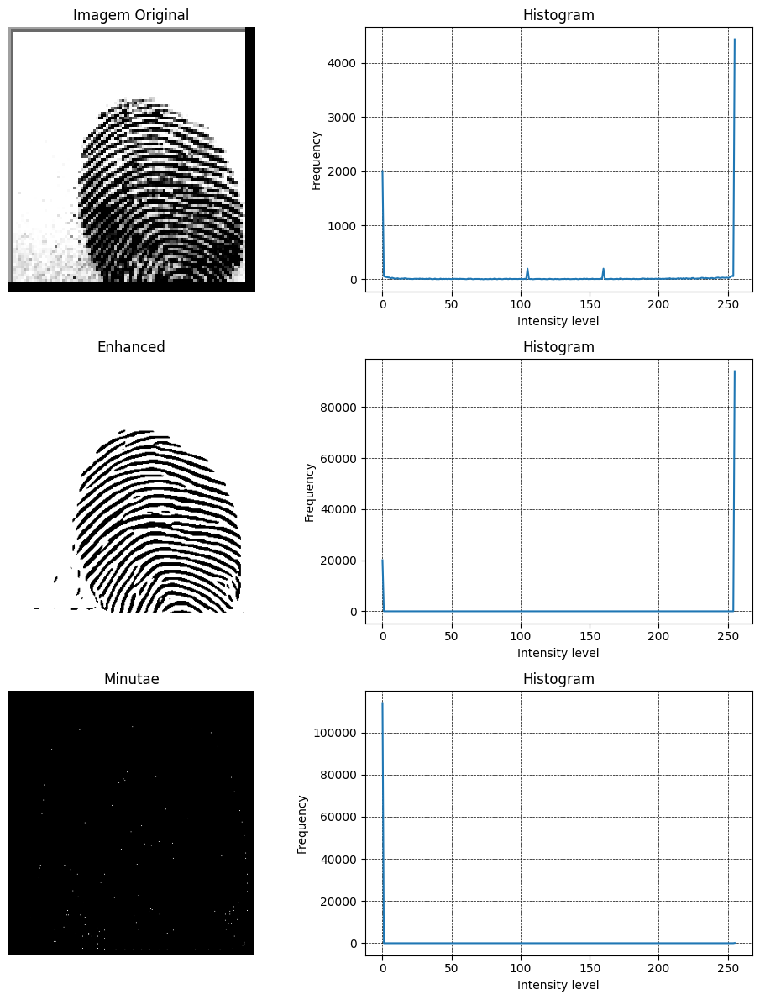

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.28 |              155.41 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.73 |              203.11 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.23 |
+-----------------+------------+-----------+---------------------+


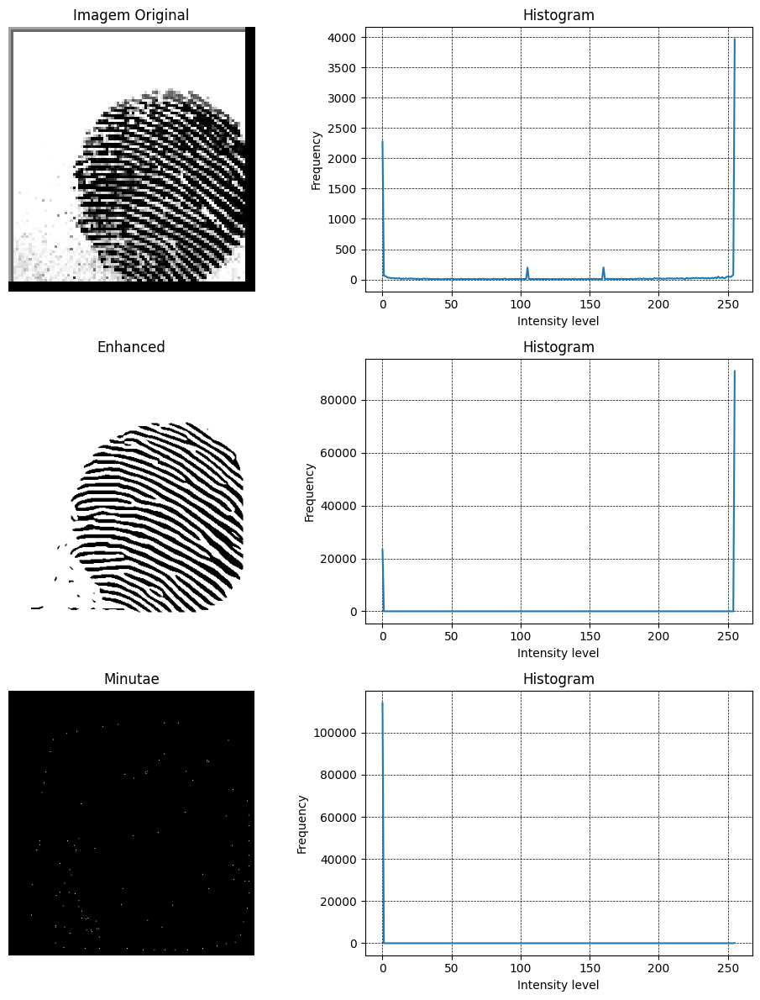

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      3.85 |              146.75 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.68 |              209.21 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.23 |
+-----------------+------------+-----------+---------------------+


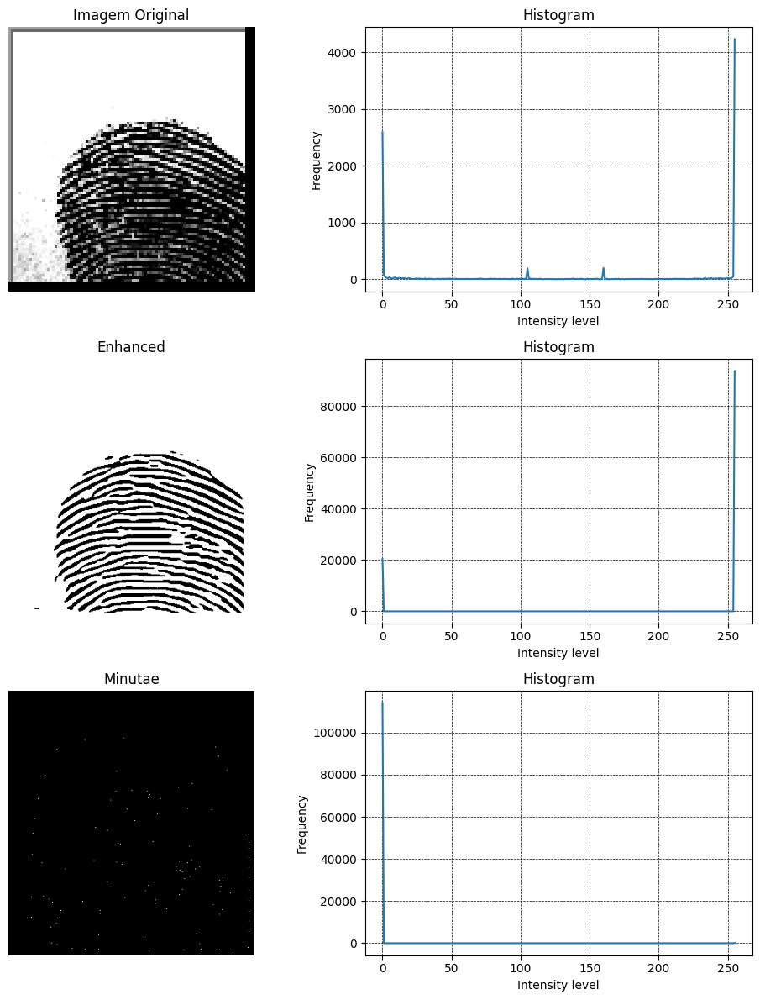

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.19 |              128.41 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.88 |              178.68 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.3  |
+-----------------+------------+-----------+---------------------+


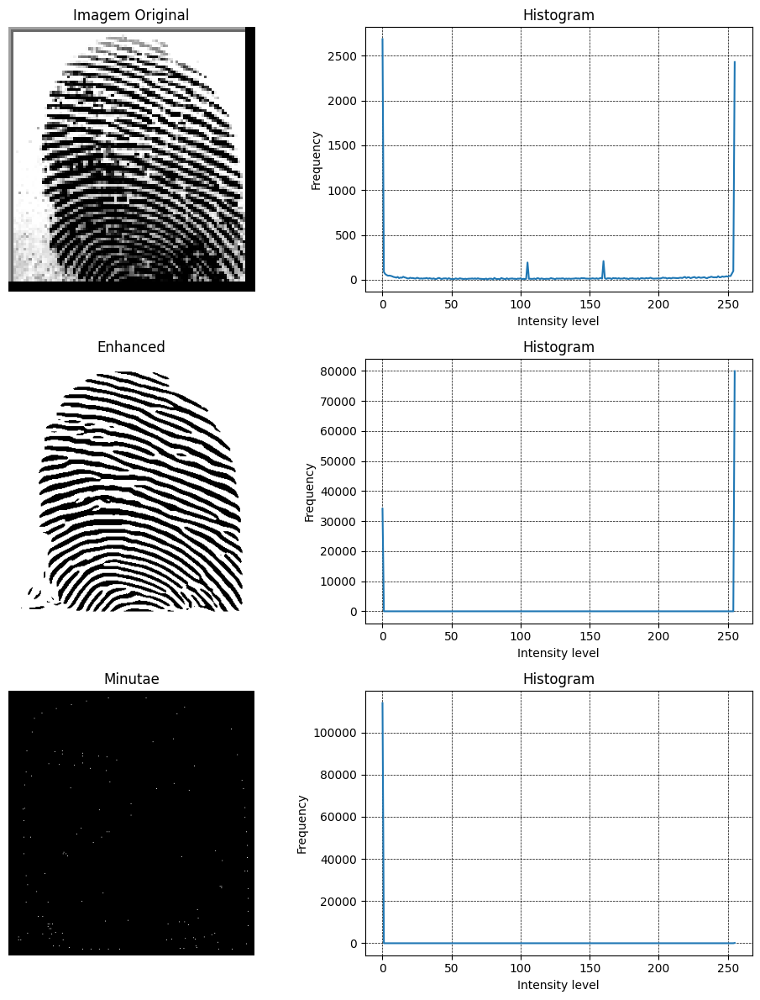

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.42 |              139.45 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.87 |              180.86 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.32 |
+-----------------+------------+-----------+---------------------+


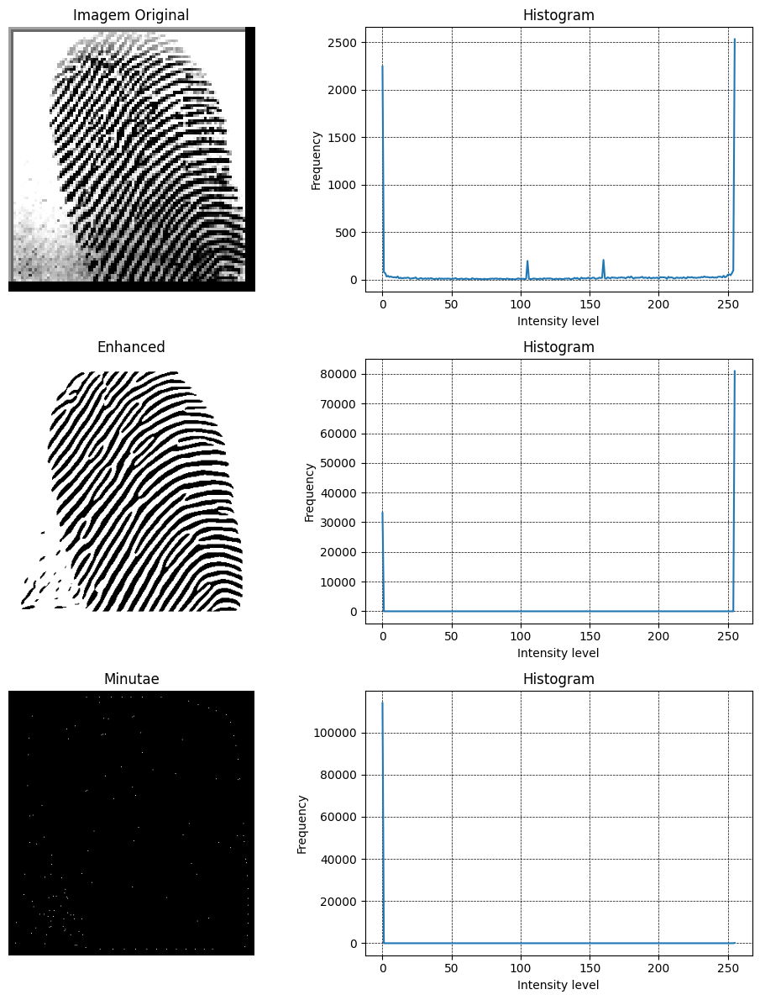

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.44 |              165.33 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.73 |              203.51 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.16 |
+-----------------+------------+-----------+---------------------+


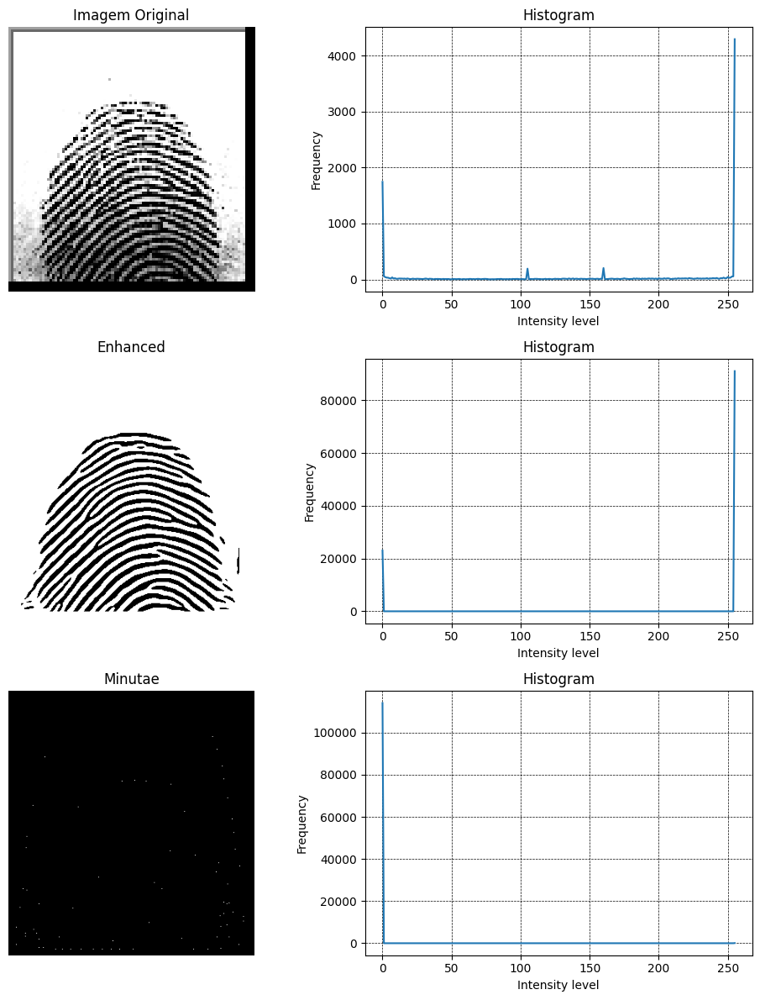

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.71 |              127.6  |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.9  |              174.92 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.3  |
+-----------------+------------+-----------+---------------------+


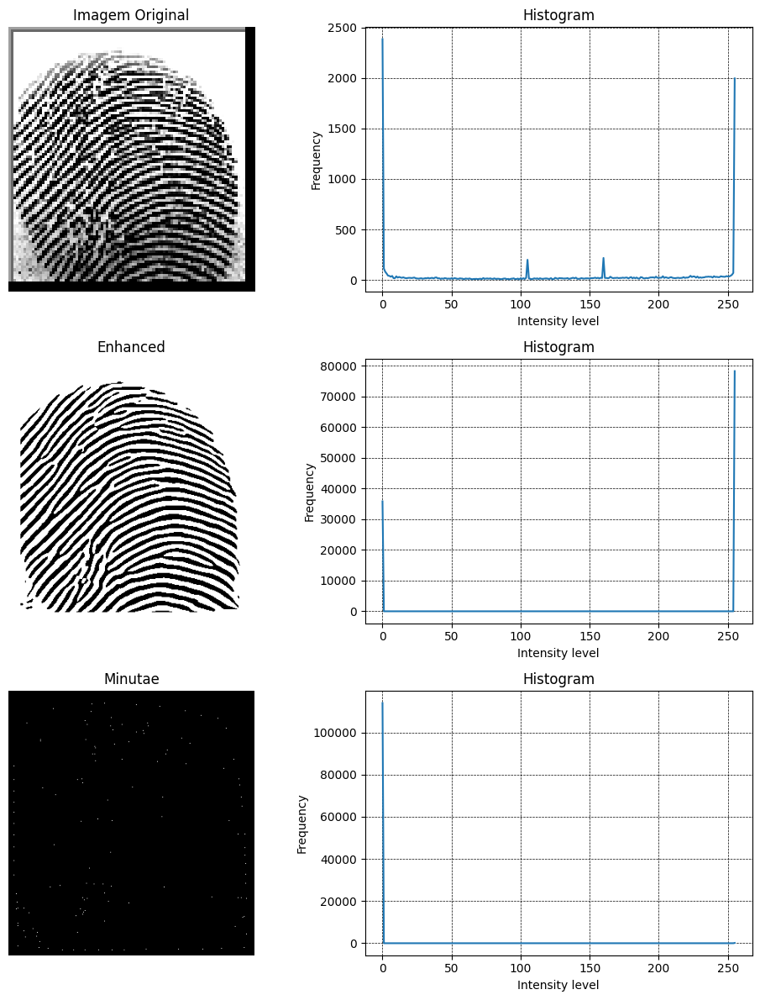

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.99 |              125.54 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.84 |              187.15 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.26 |
+-----------------+------------+-----------+---------------------+


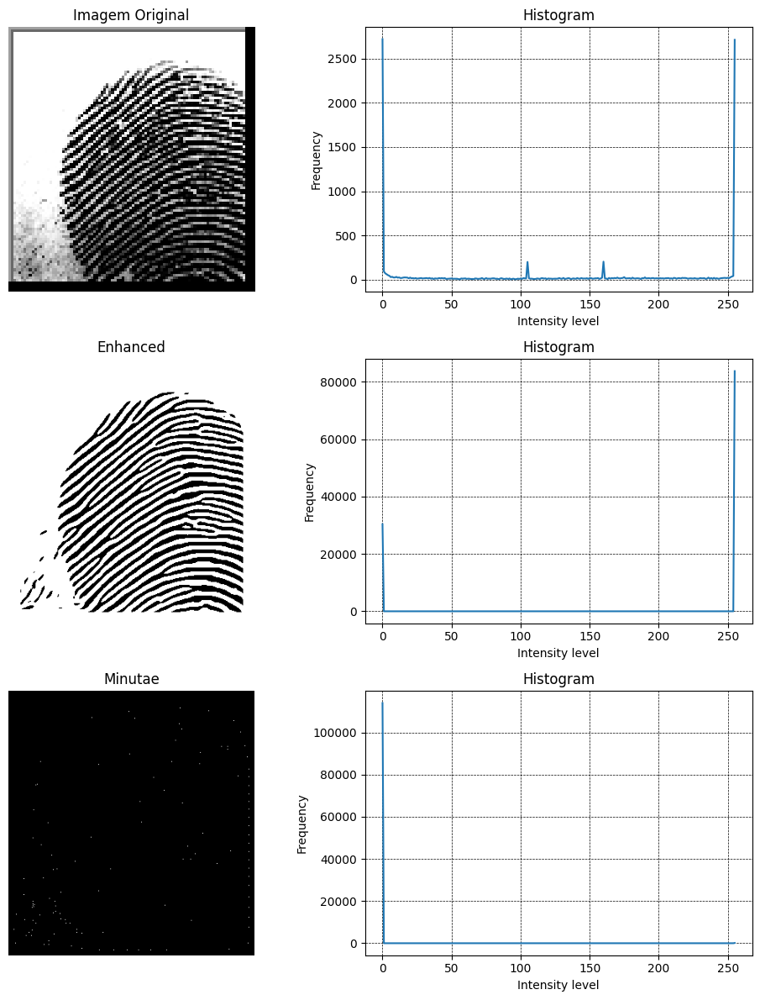

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.78 |              119.56 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.94 |              164.88 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.27 |
+-----------------+------------+-----------+---------------------+


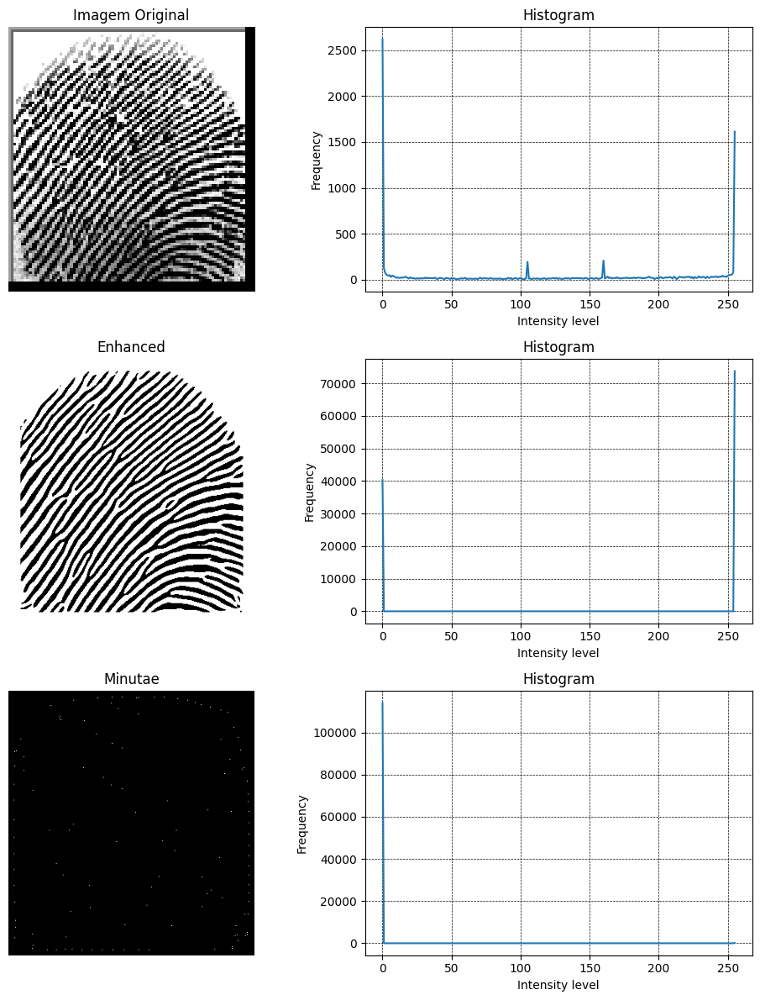

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.08 |              141.58 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.84 |              185.74 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.22 |
+-----------------+------------+-----------+---------------------+


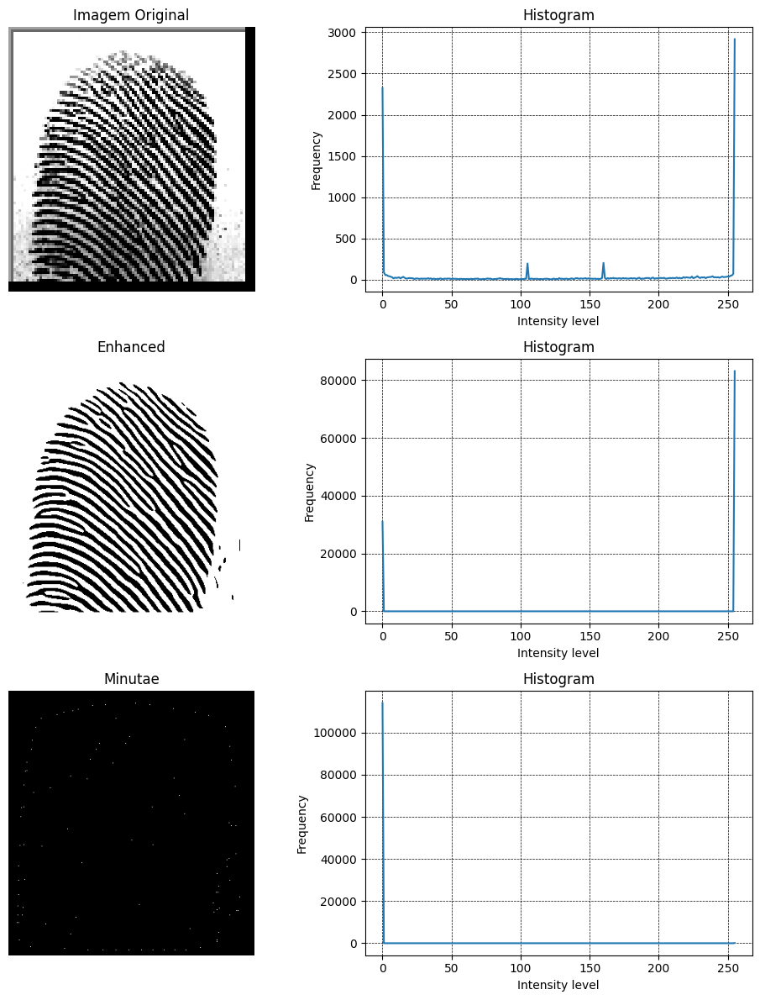

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.03 |              157.5  |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.79 |              195.17 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.27 |
+-----------------+------------+-----------+---------------------+


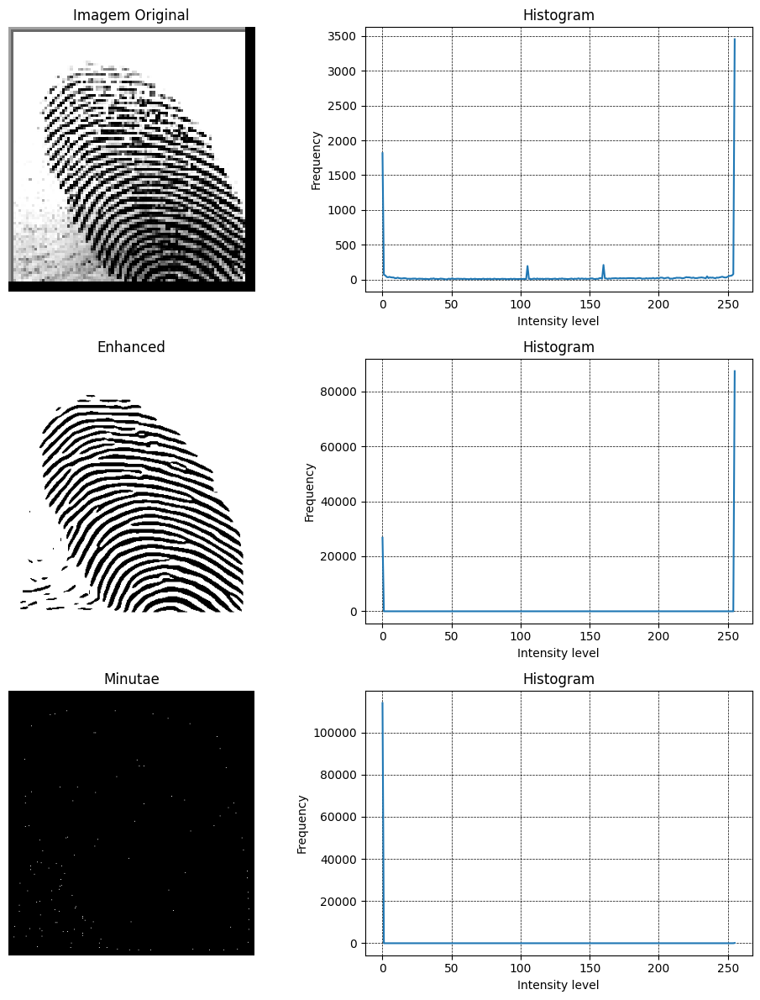

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.46 |              142.15 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.87 |              180.3  |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.25 |
+-----------------+------------+-----------+---------------------+


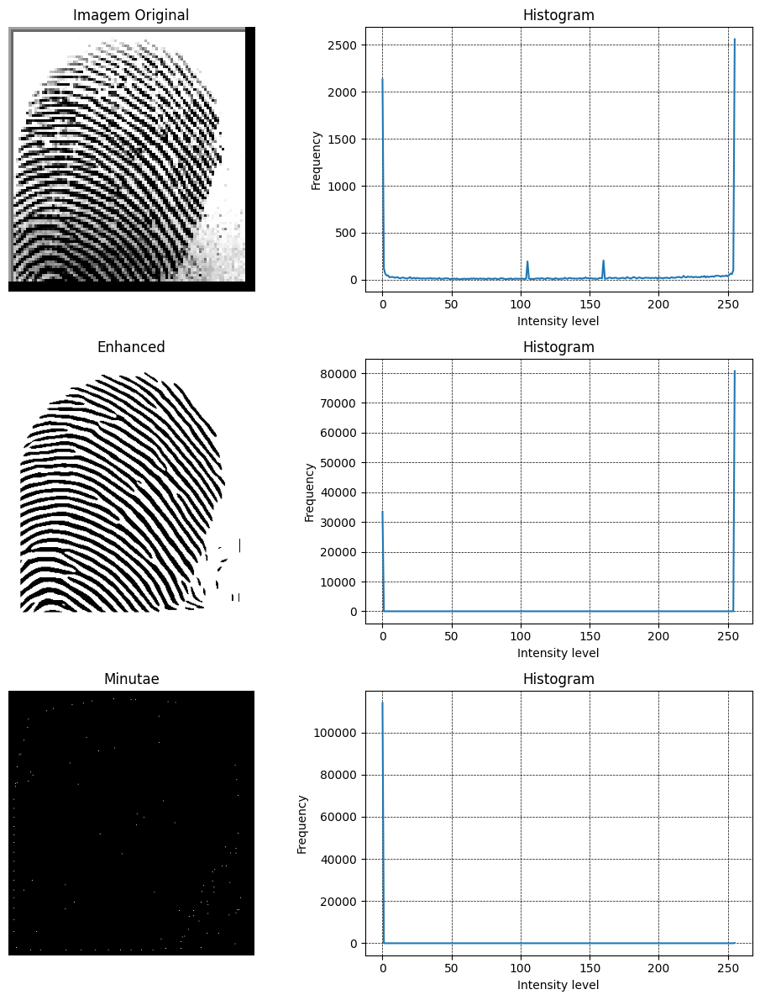

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.44 |              122.67 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.91 |              172.52 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.23 |
+-----------------+------------+-----------+---------------------+


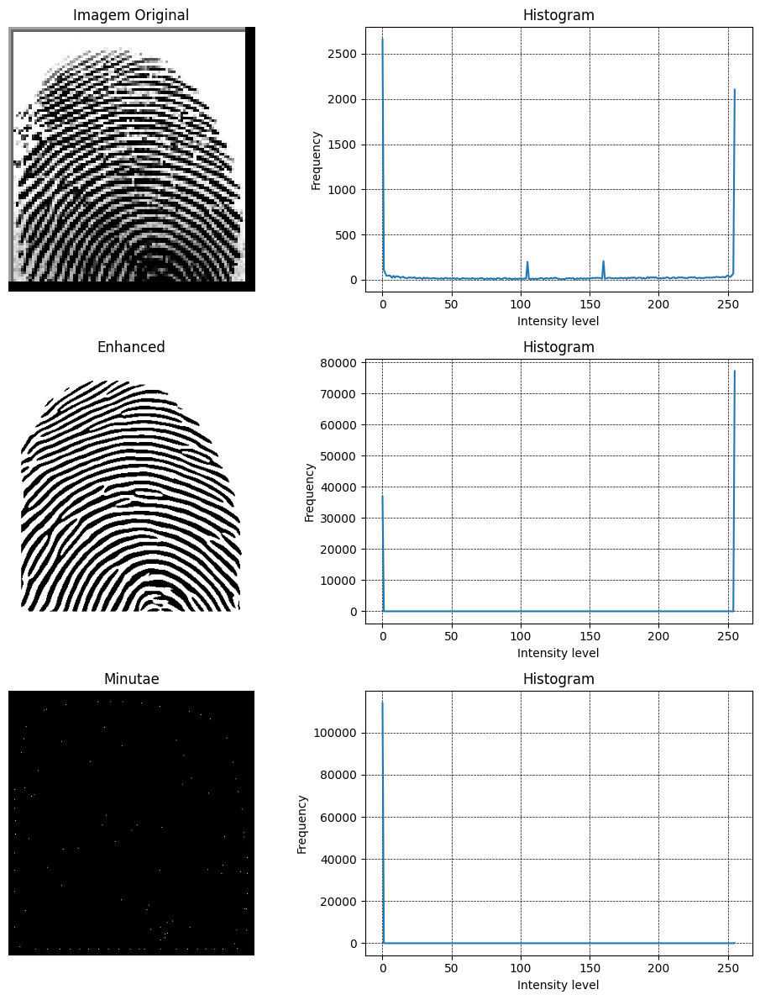

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.72 |              138.76 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.91 |              173.08 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.23 |
+-----------------+------------+-----------+---------------------+


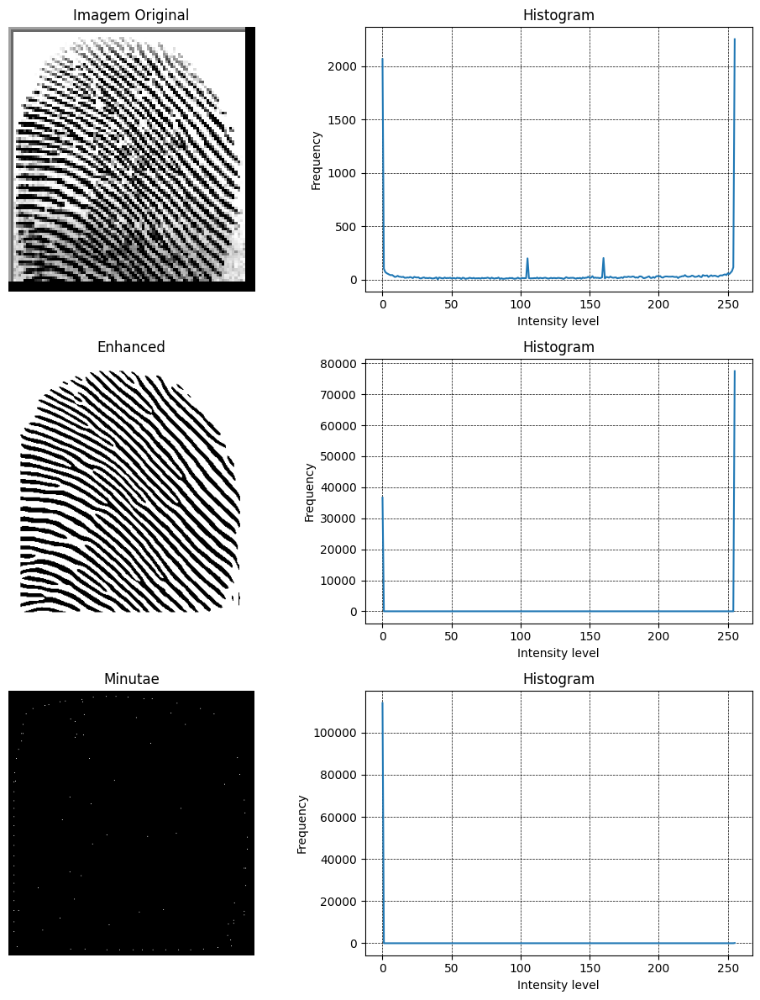

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.21 |              179.83 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.67 |              210.55 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.21 |
+-----------------+------------+-----------+---------------------+


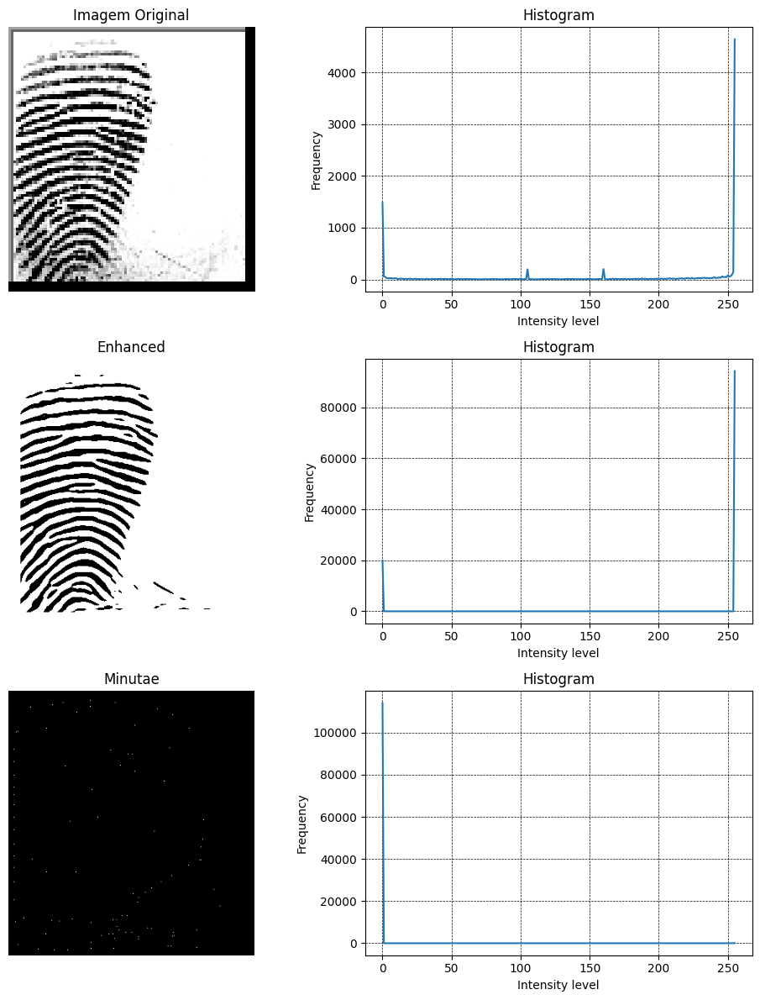

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.4  |              175.55 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.7  |              206.28 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.25 |
+-----------------+------------+-----------+---------------------+


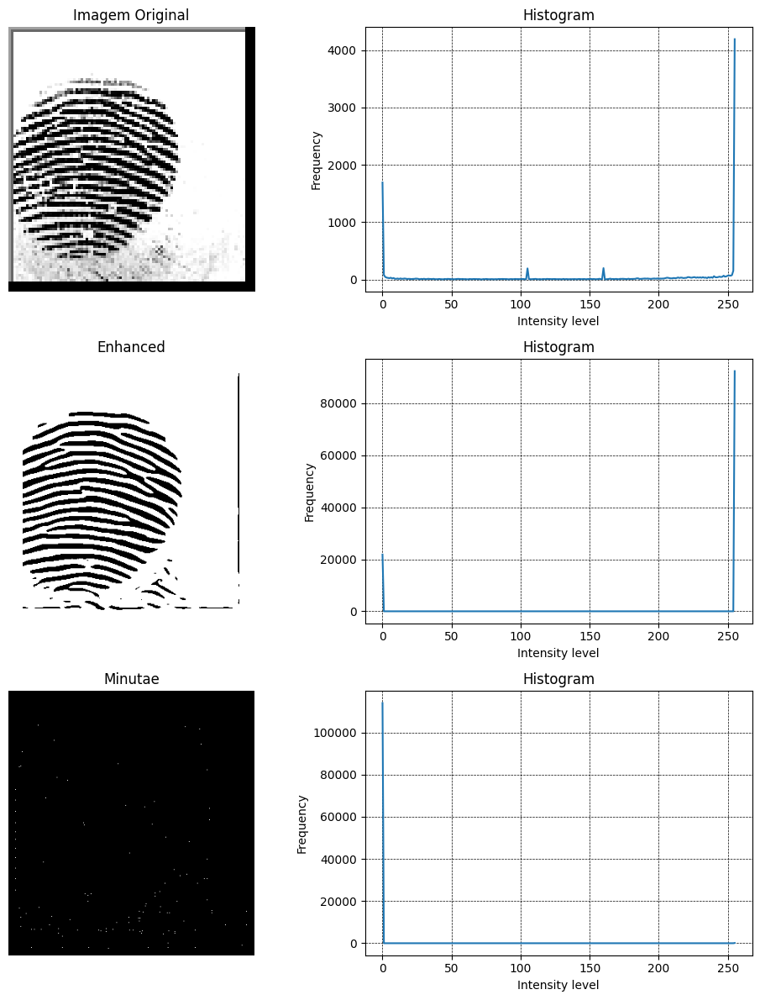

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.17 |              153.57 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.85 |              184.96 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.19 |
+-----------------+------------+-----------+---------------------+


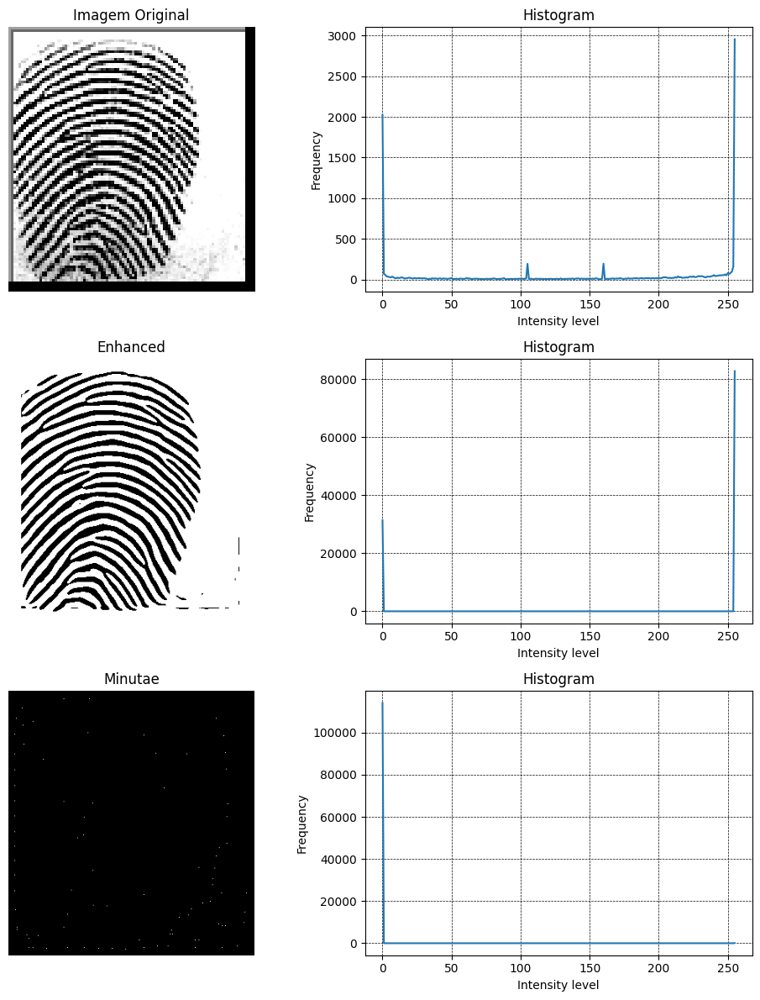

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      3.79 |              175.26 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.67 |              210.79 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.13 |
+-----------------+------------+-----------+---------------------+


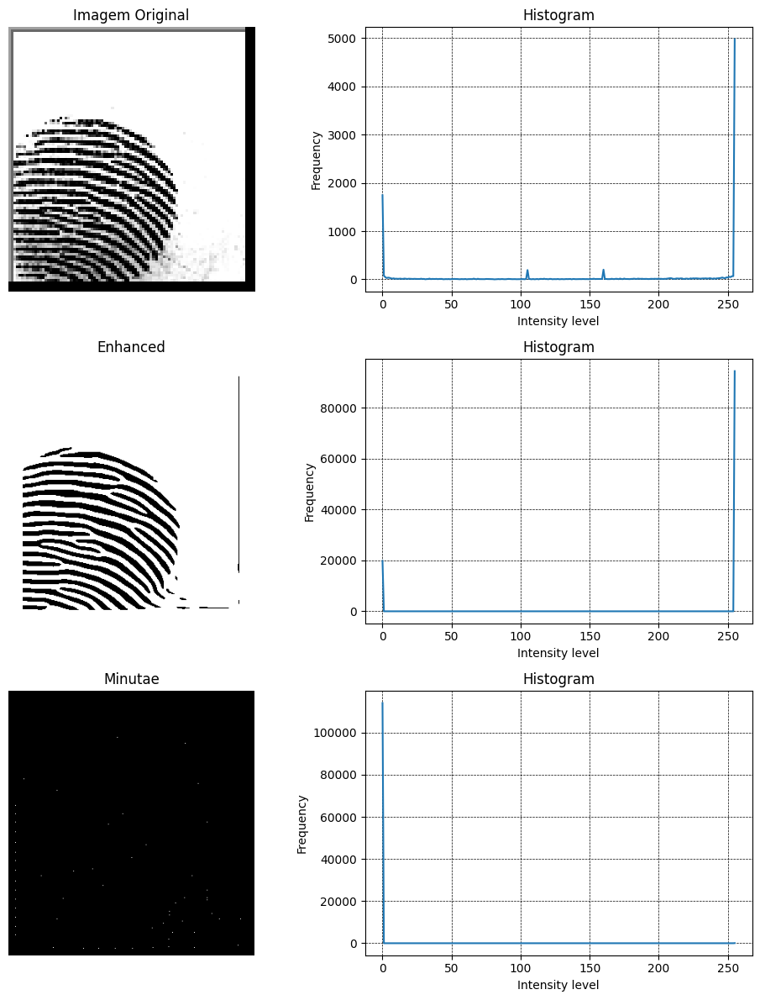

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.07 |              169.16 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.75 |              200.91 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.52 |
+-----------------+------------+-----------+---------------------+


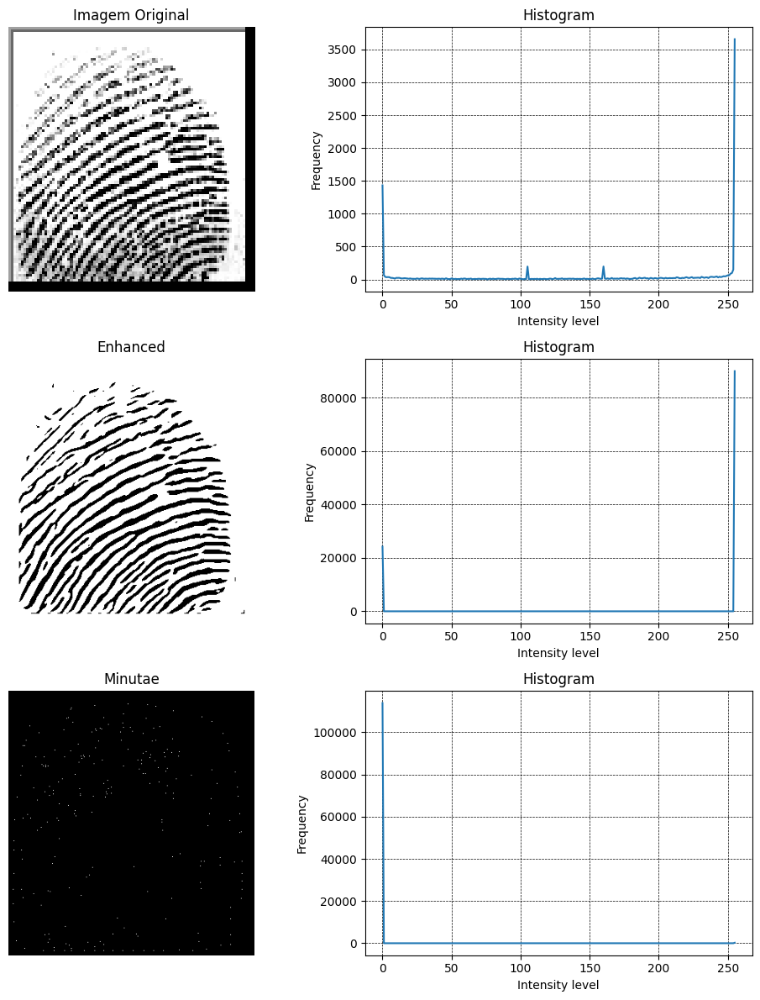

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.95 |              155.08 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.8  |              193.36 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.27 |
+-----------------+------------+-----------+---------------------+


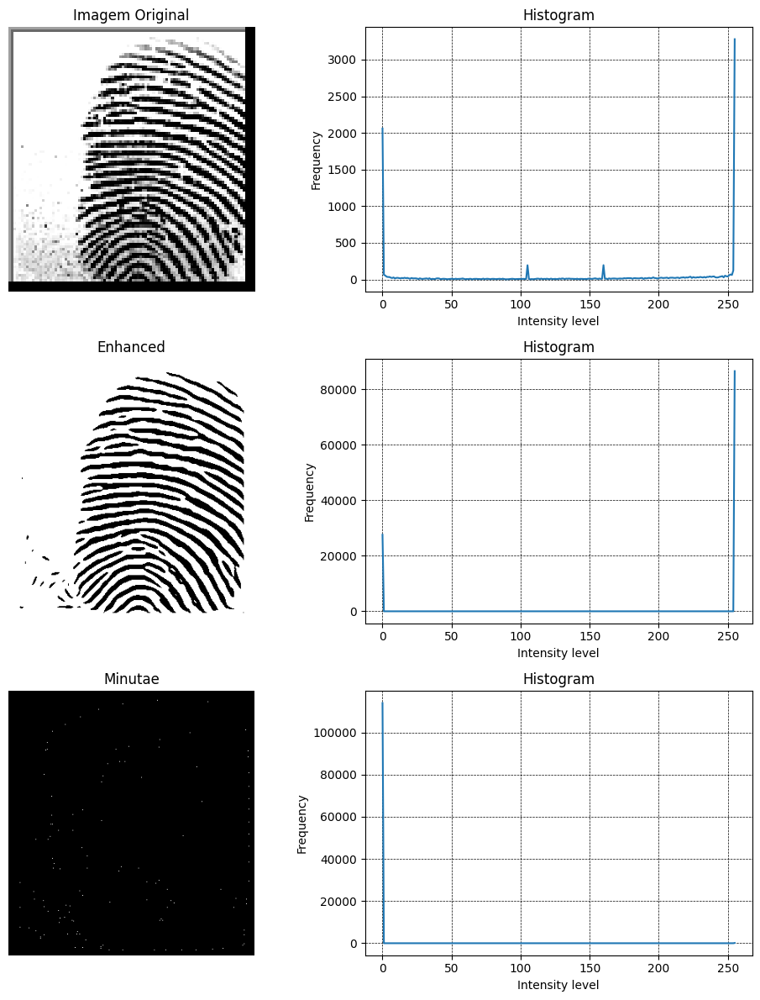

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.27 |              180.64 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.67 |              210.04 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.21 |
+-----------------+------------+-----------+---------------------+


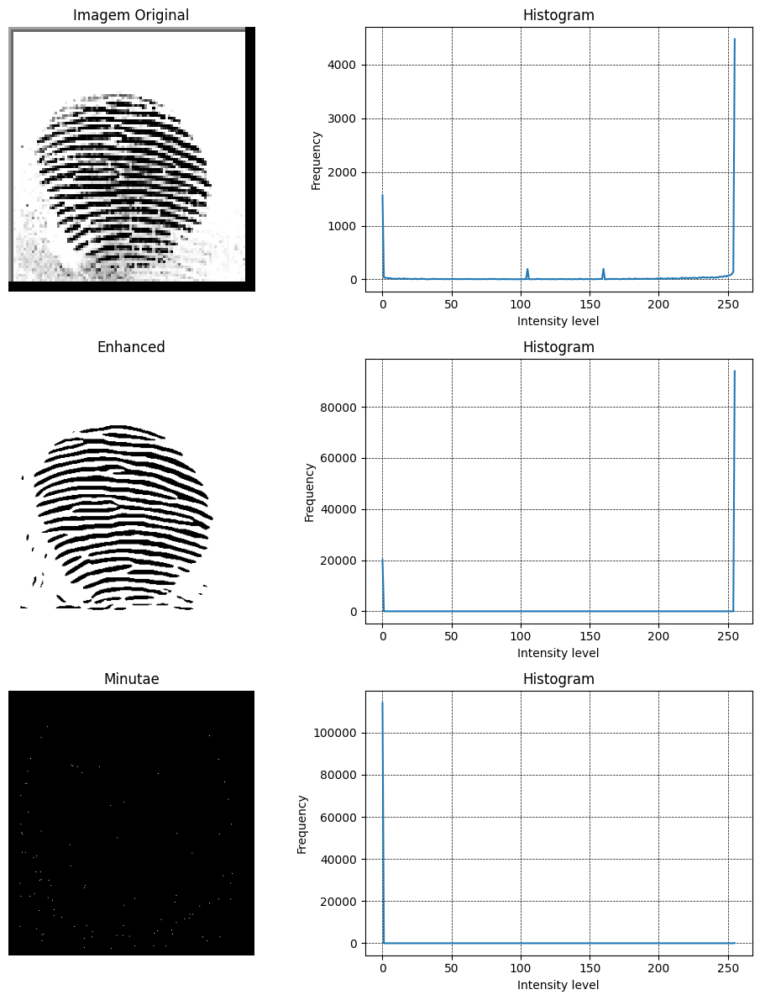

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.9  |              178.81 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.73 |              203.58 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.02 |                0.36 |
+-----------------+------------+-----------+---------------------+


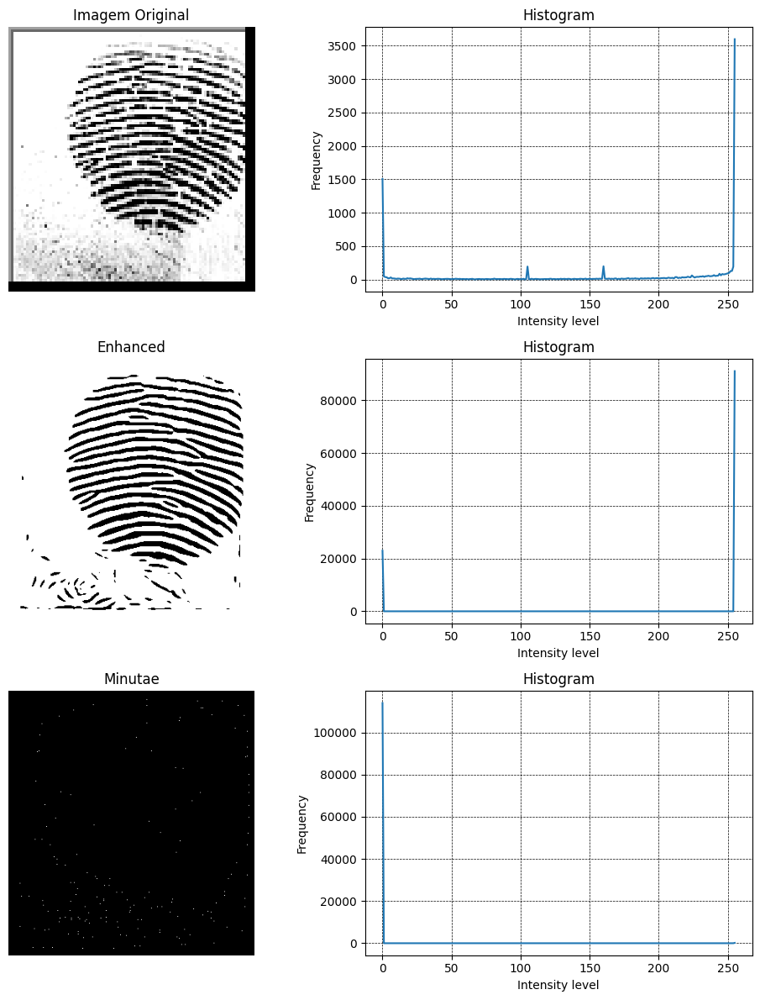

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      4.91 |              157.72 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.81 |              190.68 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.24 |
+-----------------+------------+-----------+---------------------+


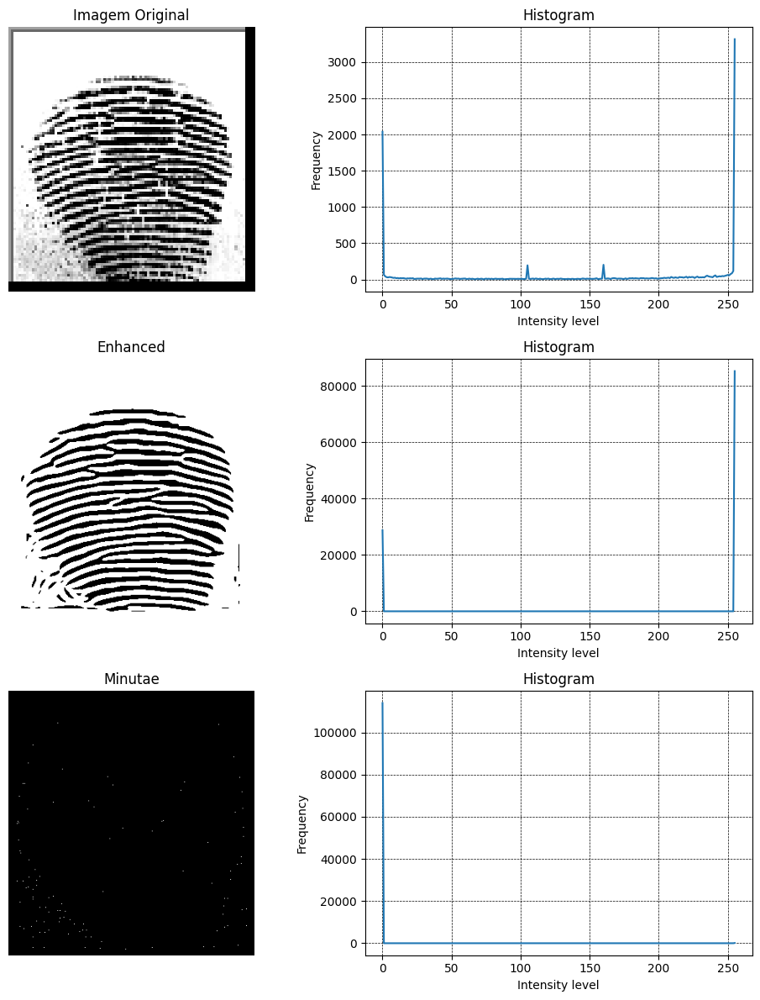

+-----------------+------------+-----------+---------------------+
| Image           |   Contrast |   Entropy |   Average Intensity |
+=================+============+===========+=====================+
| Imagem Original |        255 |      5.08 |              153.19 |
+-----------------+------------+-----------+---------------------+
| Enhanced        |        255 |      0.86 |              181.96 |
+-----------------+------------+-----------+---------------------+
| Minutae         |        255 |      0.01 |                0.24 |
+-----------------+------------+-----------+---------------------+


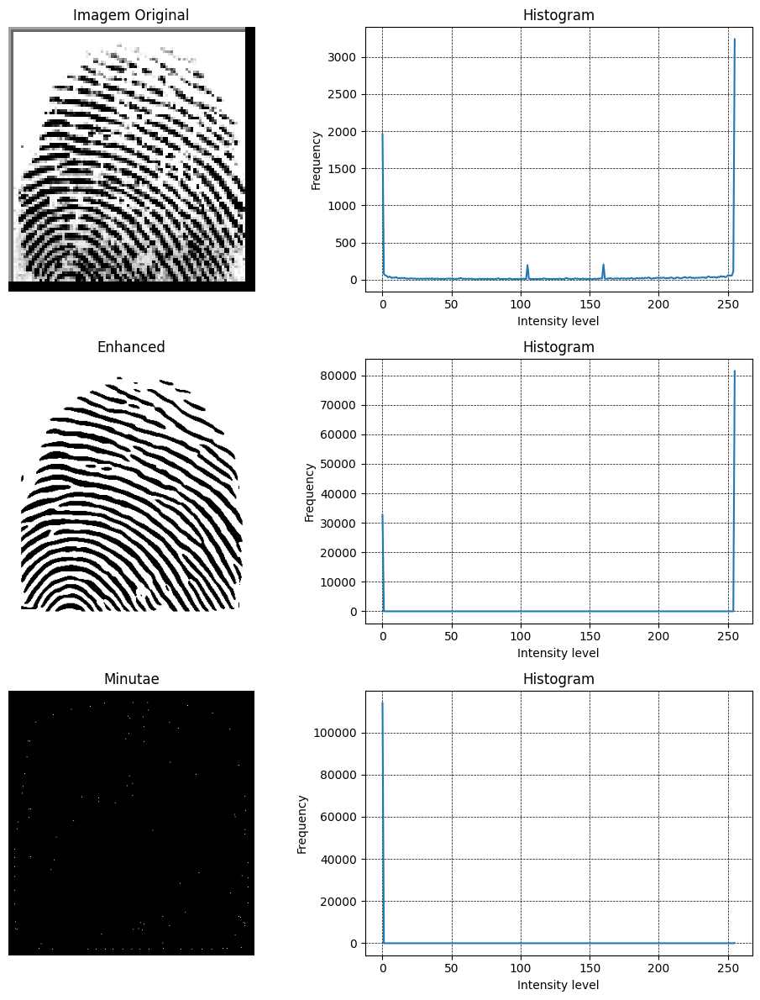

In [77]:
path = "../../src/TP2/dataset/archive/SOCOFing/Real/"

for sample in database: 
    subject = sample['subject']
    image = sample['image']
    image_name = sample['image_name'].split('.')[0]

    terminations, bifurcations, enhanced_img, minutae_img = extract_minutae(image=image, showResult=False, saveResult=True, folder=f'{path}', image_name='minutae_'+image_name)

    sample['preprocessed'] = enhanced_img
    sample['minutae'] = (terminations, bifurcations)

    ImageUtils().images_information(images=[image, enhanced_img, minutae_img], titles=[f'Imagem Original', 'Enhanced', 'Minutae'], show_cdf=False)



In [18]:
X = []
Y = []
for sample in database: 
    X.append(sample['image'])
    Y.append(int(sample['subject'])-1)

X = np.array(X)
Y = np.array(Y)

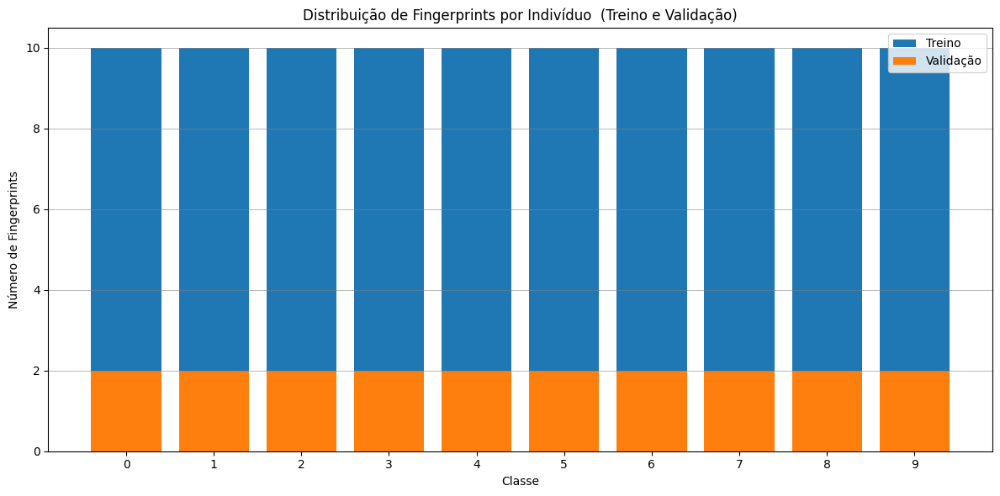

In [19]:
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X, Y, test_size=0.2, random_state=42, stratify=Y, shuffle=True)

plt.figure(figsize=(12, 6))
plt.bar([str(i) for i in np.unique(Y)], [np.sum(Y==i) for i in np.unique(Y)], label='Treino')
plt.bar([str(i) for i in np.unique(y_val)], [np.sum(y_val==i) for i in np.unique(y_val)], label='Validação')
plt.title('Distribuição de Fingerprints por Indivíduo  (Treino e Validação)')
plt.xlabel('Classe')
plt.ylabel('Número de Fingerprints')
plt.legend()
plt.grid(axis='y', color='grey', alpha=0.8, linestyle='-', linewidth=0.5)
plt.grid(axis='x', visible=False)
plt.tight_layout()
plt.show()


## Construção dos modelos de classificação

### CNN para imagens raw

In [20]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import Adam

# Definir o tamanho da imagem e o número de classes
input_shape = (103, 96, 1)  # Imagem em escala de cinza
num_classes = 10

# Normalizar os dados de entrada
X_train = X_train.astype('float32') / 255.0
X_val = X_val.astype('float32') / 255.0

# Converter as labels para one-hot encoding
y_train_enc = to_categorical(y_train, num_classes)
y_val_enc = to_categorical(y_val, num_classes)

# Construir o modelo CNN
model_raw = Sequential()

# Camada Convolucional 1
model_raw.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=input_shape))
model_raw.add(MaxPooling2D(pool_size=(2, 2)))

# Camada Convolucional 2
model_raw.add(Conv2D(64, kernel_size=(3, 3), activation='relu'))
model_raw.add(MaxPooling2D(pool_size=(2, 2)))

# # Camada Convolucional 3
# model.add(Conv2D(128, kernel_size=(3, 3), activation='relu'))
# model.add(MaxPooling2D(pool_size=(2, 2)))

# Camada de Flatten
model_raw.add(Flatten())

# # Camada Densa 1
# model.add(Dense(128, activation='relu'))
# model.add(Dropout(0.5))

# Camada Densa 2
model_raw.add(Dense(64, activation='relu'))
model_raw.add(Dropout(0.5))

# Camada de Saída
model_raw.add(Dense(num_classes, activation='softmax'))

# Compilar o modelo
model_raw.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

# Resumo do modelo
model_raw.summary()

c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 101, 94, 32)    │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 50, 47, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 48, 45, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 24, 22, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 33792)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │     2,162,752 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │           650 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,182,218 (8.32 MB)

 Trainable params: 2,182,218 (8.32 MB)

 Non-trainable params: 0 (0.00 B)

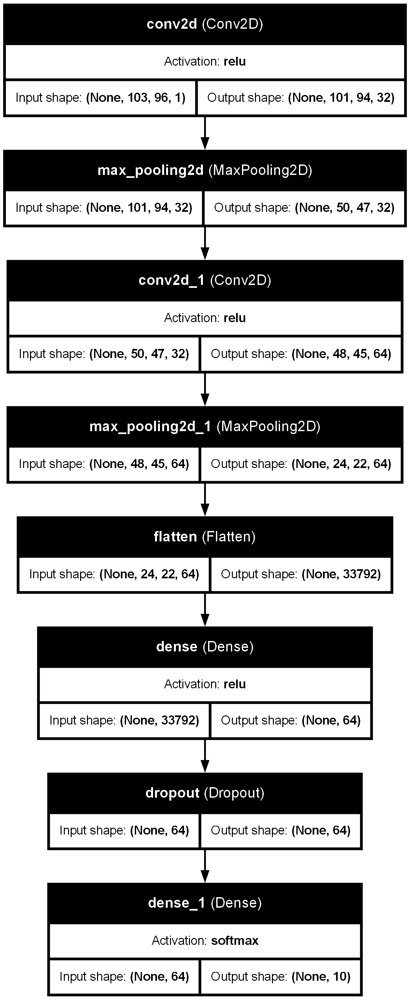

In [21]:
from tensorflow.keras.utils import plot_model

plot_model(
    model_raw, 
    to_file='imgs/models/raw_model.png', 
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    rankdir="TL",
    expand_nested=False,
    dpi=200,
    show_layer_activations=True,
    show_trainable=False
)

In [22]:
# Treinar o modelo
history = model_raw.fit(X_train, y_train_enc, batch_size=50, epochs=200, validation_data=(X_val, y_val_enc))

# Avaliar o modelo
loss, accuracy = model_raw.evaluate(X_val, y_val_enc)
print(f'Validation Loss: {loss}')
print(f'Validation Accuracy: {accuracy}')

Epoch 1/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 213ms/step - accuracy: 0.0917 - loss: 2.6950 - val_accuracy: 0.1000 - val_loss: 2.7199
Epoch 2/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - accuracy: 0.1233 - loss: 3.2709 - val_accuracy: 0.1000 - val_loss: 2.3687
Epoch 3/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step - accuracy: 0.1583 - loss: 2.4250 - val_accuracy: 0.1000 - val_loss: 2.3080
Epoch 4/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - accuracy: 0.1367 - loss: 2.3023 - val_accuracy: 0.1500 - val_loss: 2.2988
Epoch 5/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step - accuracy: 0.1883 - loss: 2.2861 - val_accuracy: 0.1500 - val_loss: 2.2988
Epoch 6/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step - accuracy: 0.1617 - loss: 2.2796 - val_accuracy: 0.1000 - val_loss: 2.2966
Epoch 7/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - accuracy: 0.2217 - loss: 2.2523 - val_accuracy: 0.1000 - val_loss: 2.2920
Epoch 8/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - accuracy: 0.2150 - loss: 2.2151 - val_accuracy: 0.1000 - v

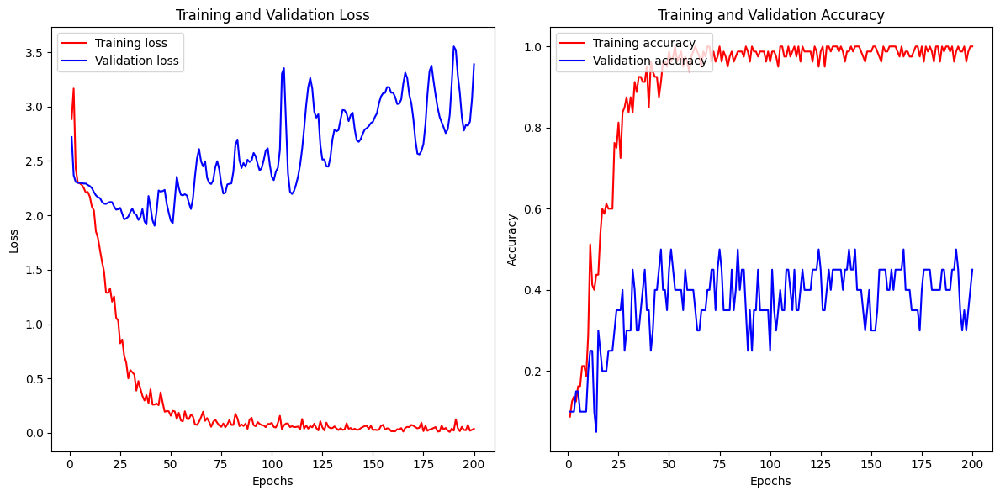

<Figure size 640x480 with 0 Axes>

In [23]:
plotModelHistory(history, type='multi')

In [24]:
Y_enc = to_categorical(Y, num_classes)
history = model_raw.fit(X, Y_enc, batch_size=50, epochs=200)


Epoch 1/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 107ms/step - accuracy: 0.7933 - loss: 184.6335
Epoch 2/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - accuracy: 0.6267 - loss: 74.4967
Epoch 3/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - accuracy: 0.3667 - loss: 22.4299
Epoch 4/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - accuracy: 0.1867 - loss: 44.4981
Epoch 5/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - accuracy: 0.1400 - loss: 4.0883
Epoch 6/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - accuracy: 0.1467 - loss: 2.2571
Epoch 7/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step - accuracy: 0.1000 - loss: 18.2552
Epoch 8/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - accuracy: 0.1267 - loss: 3.3258
Epoch 9/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - accuracy: 0.1067 - loss: 2.3024
Epoch 10/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step - accuracy: 0.1000 - loss: 2.3027
Epoch 11/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step - accuracy: 0.1133 - loss: 2.3060
Epoch 12/200
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step - accuracy: 

#### Load Test Data (Easy Mode)

In [25]:
path = "../../src/TP2/dataset/archive/SOCOFing/Altered/Altered-Easy/"
test = load_database(path)

print(len(database)) 

100


In [26]:
X_test = []
Y_test = []

for sample in test:
    X_test.append(sample['image'])
    Y_test.append(int(sample['subject'])-1)

    
X_test = np.array(X_test)
Y_test = np.array(Y_test)

##### Predict test data

In [27]:
Y_test_enc = to_categorical(Y_test, num_classes)

y_pred = model_raw.predict(X_test)

y_pred_fin = np.argmax(y_pred, axis=1)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


##### Avaliação

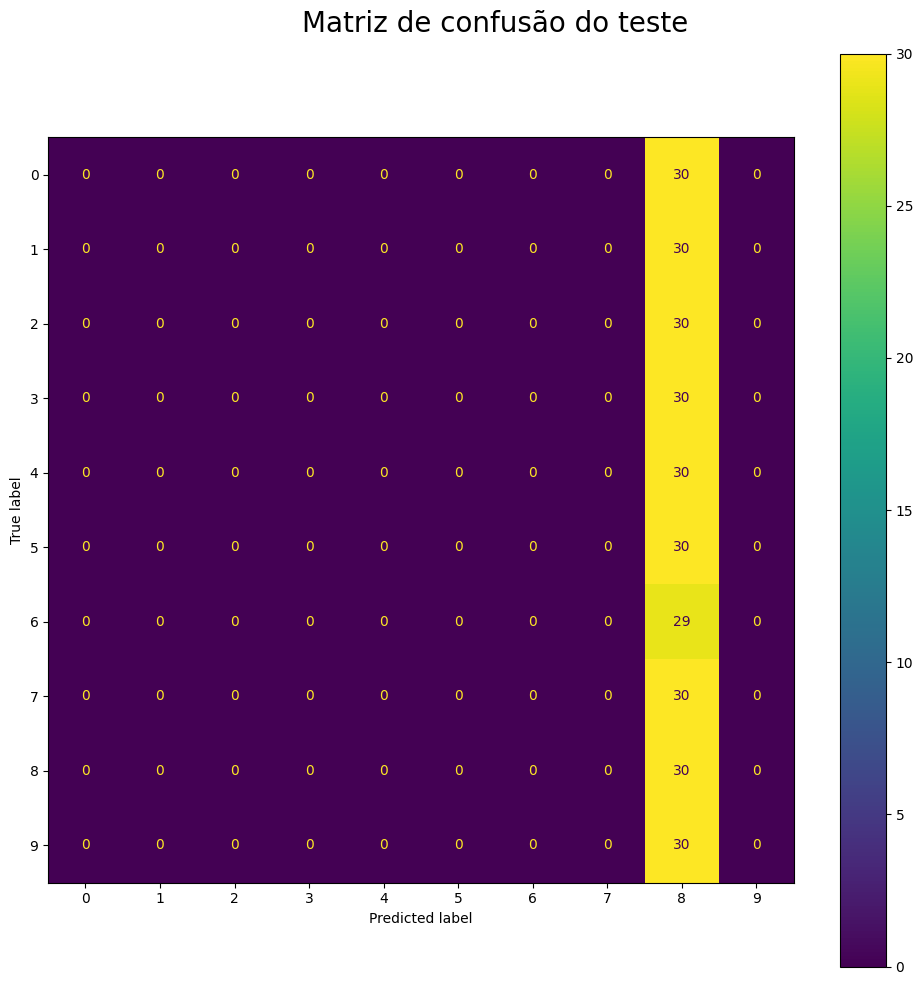

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        30
           1       0.00      0.00      0.00        30
           2       0.00      0.00      0.00        30
           3       0.00      0.00      0.00        30
           4       0.00      0.00      0.00        30
           5       0.00      0.00      0.00        30
           6       0.00      0.00      0.00        29
           7       0.00      0.00      0.00        30
           8       0.10      1.00      0.18        30
           9       0.00      0.00      0.00        30

    accuracy                           0.10       299
   macro avg       0.01      0.10      0.02       299
weighted avg       0.01      0.10      0.02       299



c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(avera

<Figure size 640x480 with 0 Axes>

In [28]:
plotConfusionMatrix(Y_test, y_pred_fin, type='multi')

print(classification_report(Y_test, y_pred_fin))

##### Visualização das Fingerprints mal classificadas

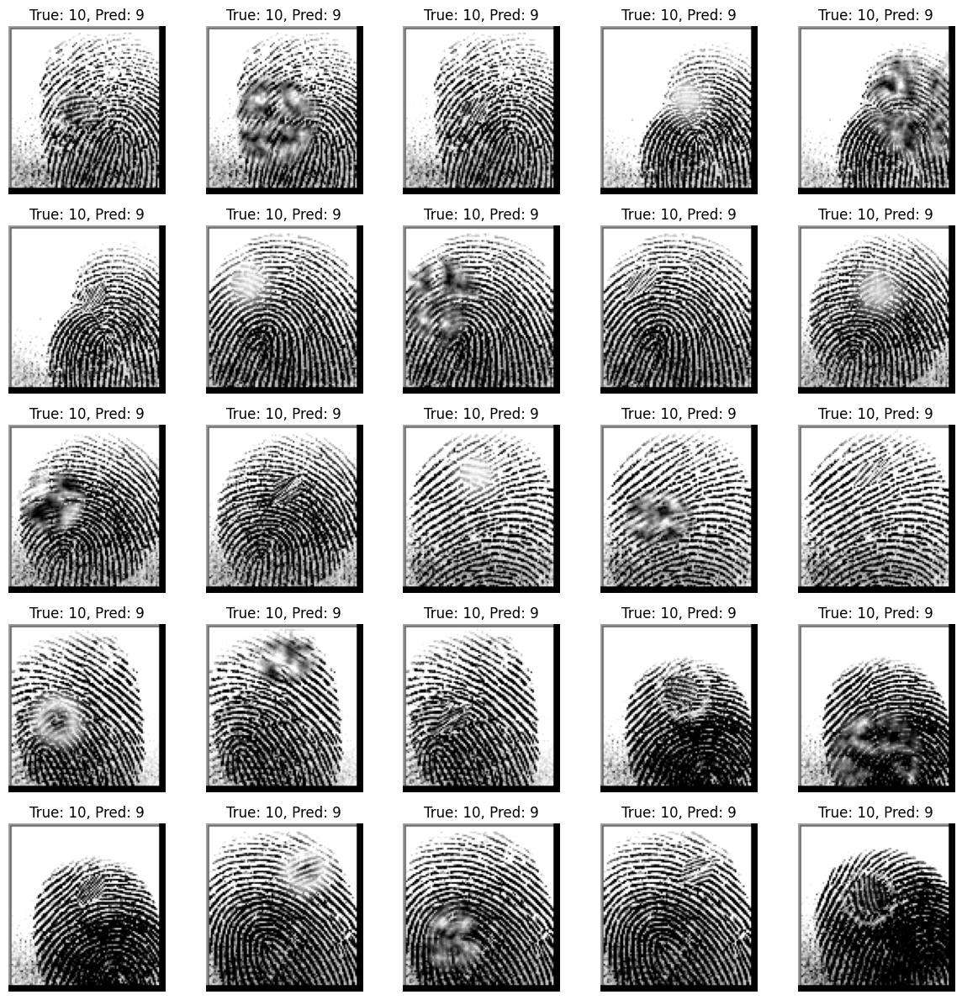

In [29]:
# Identificar índices das previsões incorretas
incorrect_indices = np.where(y_pred_fin != Y_test)[0]

# Plotar as imagens que foram classificadas incorretamente
plt.figure(figsize=(12, 12))
for i, idx in enumerate(incorrect_indices[:25]):  # Limitar a 25 imagens para visualização
    plt.subplot(5, 5, i + 1)
    plt.imshow(X_test[idx].reshape(103, 96), cmap='gray')
    plt.title(f'True: {Y_test[idx]+1}, Pred: {y_pred_fin[idx]+1}')
    plt.axis('off')
plt.tight_layout()
plt.show()

#### Load Test Data (Medium Mode)

In [30]:
path = "../../src/TP2/dataset/archive/SOCOFing/Altered/Altered-Medium/"
test = load_database(path)

print(len(database)) 

100


In [31]:
X_test = []
Y_test = []

for sample in test:
    X_test.append(sample['image'])
    Y_test.append(int(sample['subject'])-1)

    
X_test = np.array(X_test)
Y_test = np.array(Y_test)

##### Predict test data

In [32]:
Y_test_enc = to_categorical(Y_test, num_classes)

y_pred = model_raw.predict(X_test)

y_pred_fin = np.argmax(y_pred, axis=1)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


##### Avaliação

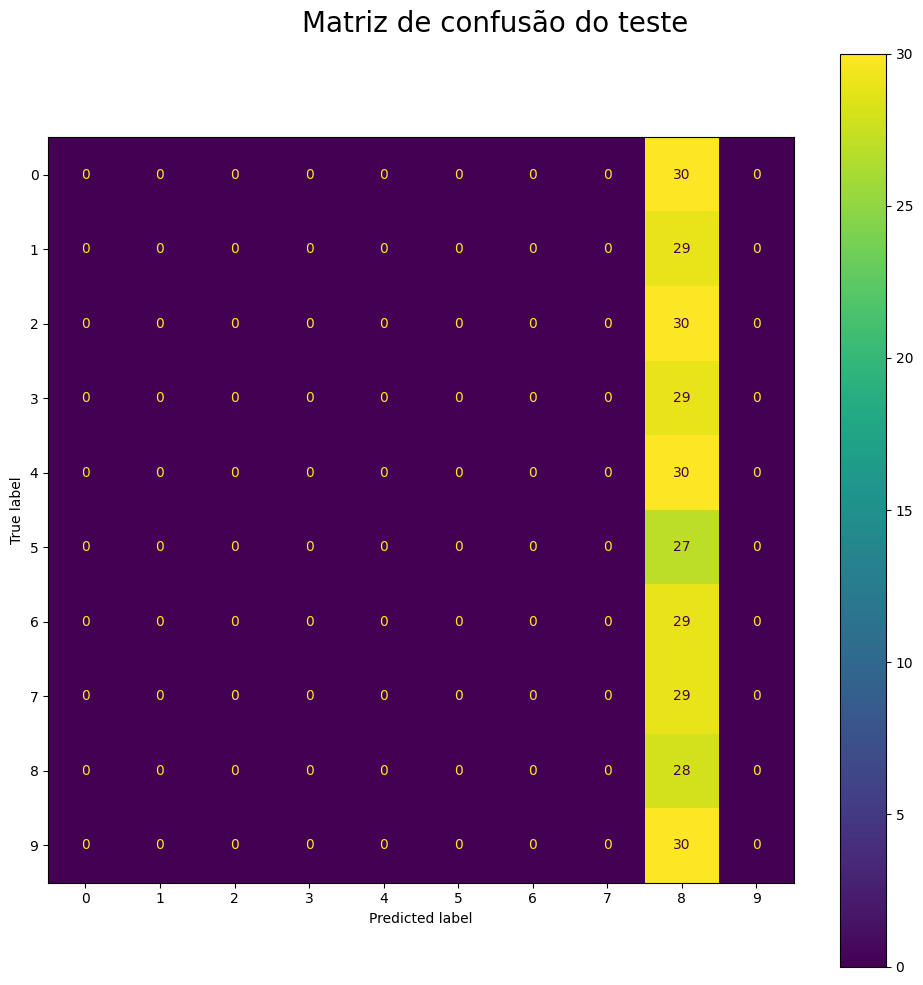

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        30
           1       0.00      0.00      0.00        29
           2       0.00      0.00      0.00        30
           3       0.00      0.00      0.00        29
           4       0.00      0.00      0.00        30
           5       0.00      0.00      0.00        27
           6       0.00      0.00      0.00        29
           7       0.00      0.00      0.00        29
           8       0.10      1.00      0.18        28
           9       0.00      0.00      0.00        30

    accuracy                           0.10       291
   macro avg       0.01      0.10      0.02       291
weighted avg       0.01      0.10      0.02       291



c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(avera

<Figure size 640x480 with 0 Axes>

In [33]:
plotConfusionMatrix(Y_test, y_pred_fin, type='multi')

print(classification_report(Y_test, y_pred_fin))

##### Visualização das Fingerprints mal classificadas

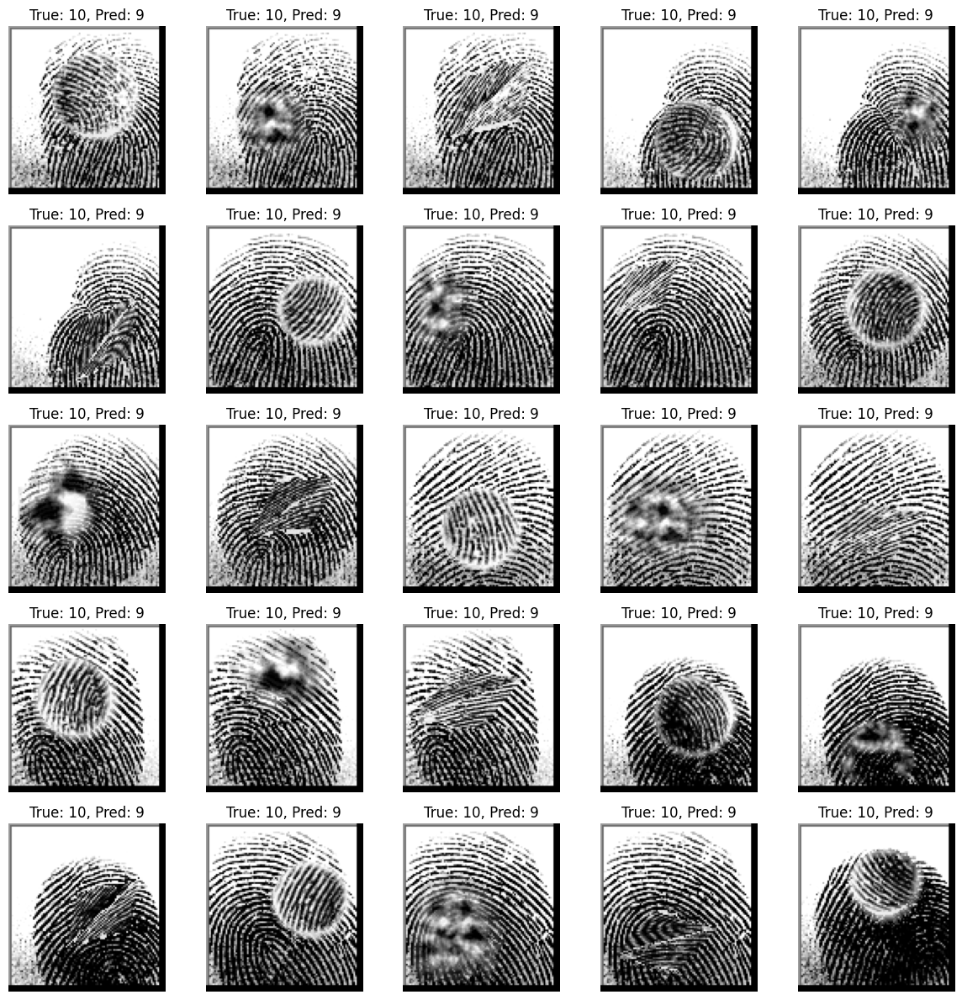

In [34]:
# Identificar índices das previsões incorretas
incorrect_indices = np.where(y_pred_fin != Y_test)[0]

# Plotar as imagens que foram classificadas incorretamente
plt.figure(figsize=(12, 12))
for i, idx in enumerate(incorrect_indices[:25]):  # Limitar a 25 imagens para visualização
    plt.subplot(5, 5, i + 1)
    plt.imshow(X_test[idx].reshape(103, 96), cmap='gray')
    plt.title(f'True: {Y_test[idx]+1}, Pred: {y_pred_fin[idx]+1}')
    plt.axis('off')
plt.tight_layout()
plt.show()

#### Load Test Data (Hard Mode)

In [35]:
path = "../../src/TP2/dataset/archive/SOCOFing/Altered/Altered-Hard/"
test = load_database(path)

print(len(database)) 

100


In [36]:
X_test = []
Y_test = []

for sample in test:
    X_test.append(sample['image'])
    Y_test.append(int(sample['subject'])-1)

    
X_test = np.array(X_test)
Y_test = np.array(Y_test)

##### Predict test data

In [37]:
Y_test_enc = to_categorical(Y_test, num_classes)

y_pred = model_raw.predict(X_test)

y_pred_fin = np.argmax(y_pred, axis=1)

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


##### Avaliação

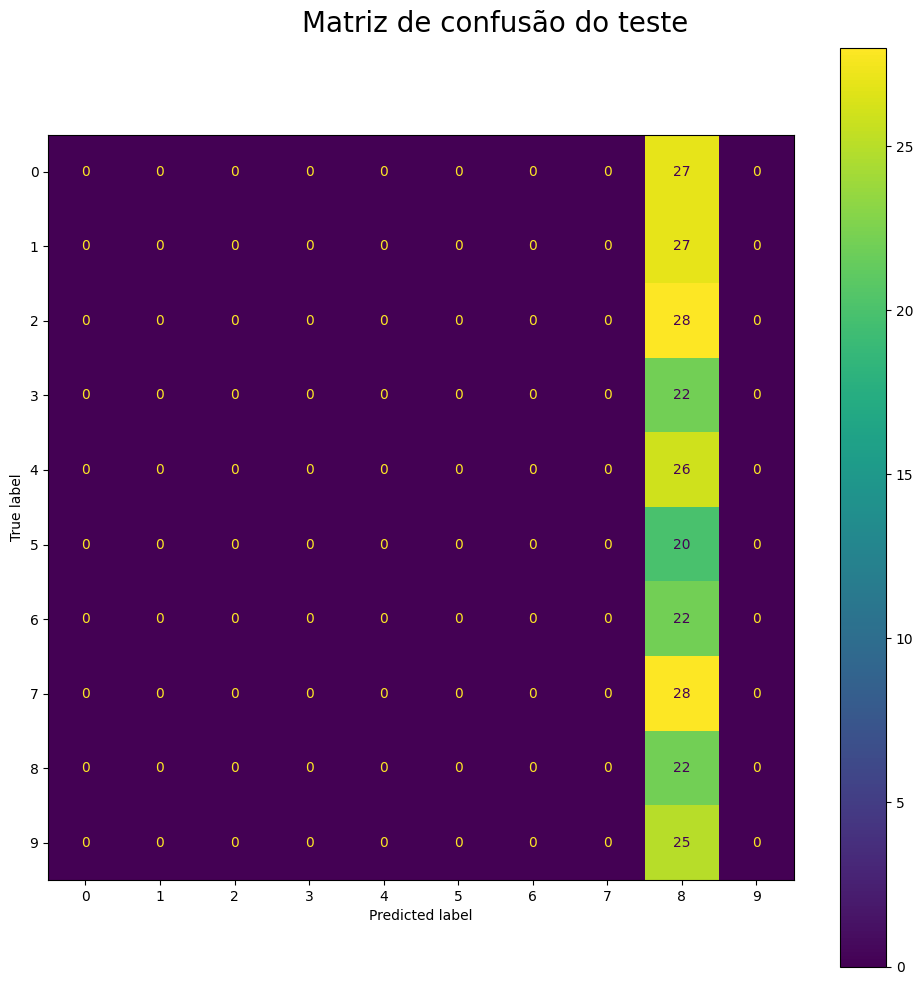

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        27
           1       0.00      0.00      0.00        27
           2       0.00      0.00      0.00        28
           3       0.00      0.00      0.00        22
           4       0.00      0.00      0.00        26
           5       0.00      0.00      0.00        20
           6       0.00      0.00      0.00        22
           7       0.00      0.00      0.00        28
           8       0.09      1.00      0.16        22
           9       0.00      0.00      0.00        25

    accuracy                           0.09       247
   macro avg       0.01      0.10      0.02       247
weighted avg       0.01      0.09      0.01       247



c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(avera

<Figure size 640x480 with 0 Axes>

In [38]:
plotConfusionMatrix(Y_test, y_pred_fin, type='multi')

print(classification_report(Y_test, y_pred_fin))

##### Visualização das Fingerprints mal classificadas

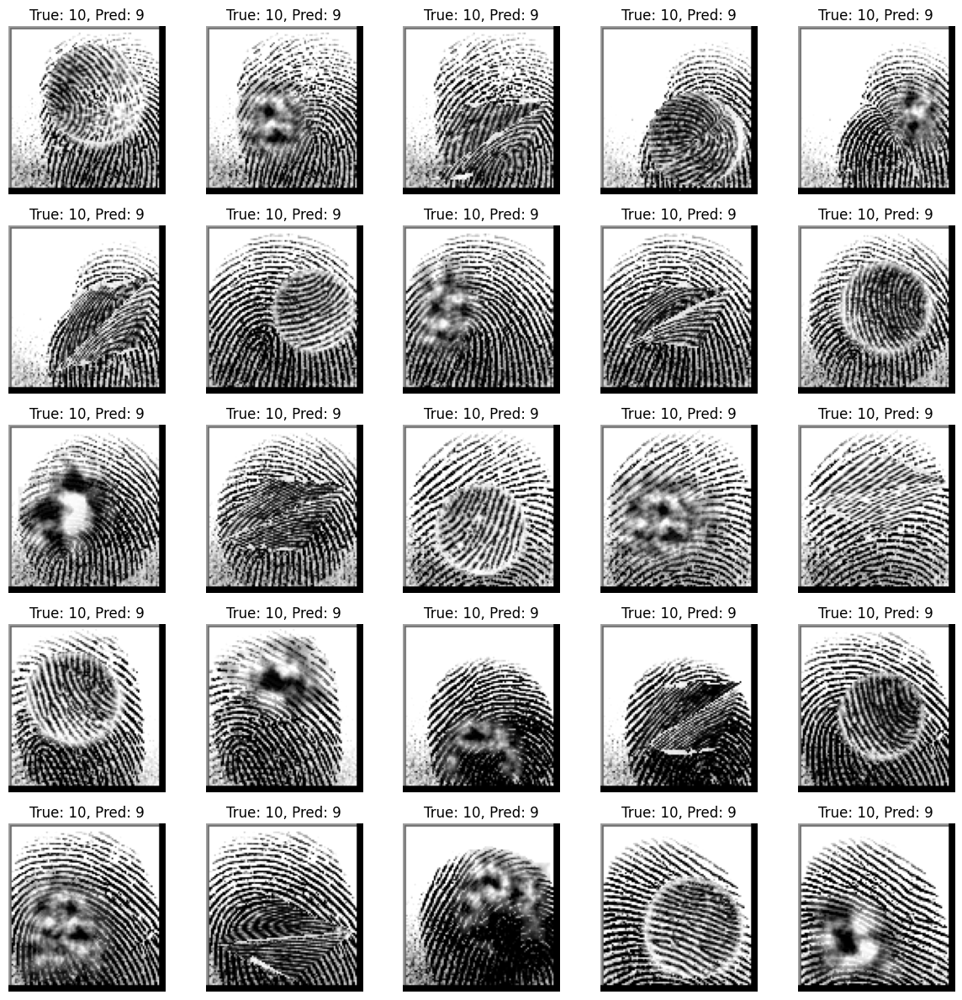

In [39]:
# Identificar índices das previsões incorretas
incorrect_indices = np.where(y_pred_fin != Y_test)[0]

# Plotar as imagens que foram classificadas incorretamente
plt.figure(figsize=(12, 12))
for i, idx in enumerate(incorrect_indices[:25]):  # Limitar a 25 imagens para visualização
    plt.subplot(5, 5, i + 1)
    plt.imshow(X_test[idx].reshape(103, 96), cmap='gray')
    plt.title(f'True: {Y_test[idx]+1}, Pred: {y_pred_fin[idx]+1}')
    plt.axis('off')
plt.tight_layout()
plt.show()

### CNN para imagens pré-processadas

In [40]:
X = []
Y = []
for sample in database: 
    X.append(sample['preprocessed'])
    Y.append(int(sample['subject'])-1)

X = np.array(X)
Y = np.array(Y)

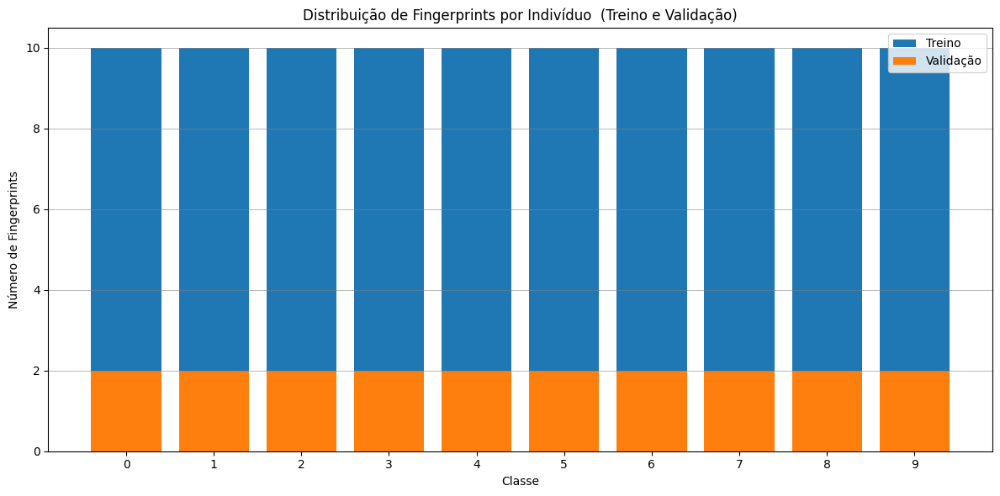

In [41]:
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X, Y, test_size=0.2, random_state=42, stratify=Y, shuffle=True)

plt.figure(figsize=(12, 6))
plt.bar([str(i) for i in np.unique(Y)], [np.sum(Y==i) for i in np.unique(Y)], label='Treino')
plt.bar([str(i) for i in np.unique(y_val)], [np.sum(y_val==i) for i in np.unique(y_val)], label='Validação')
plt.title('Distribuição de Fingerprints por Indivíduo  (Treino e Validação)')
plt.xlabel('Classe')
plt.ylabel('Número de Fingerprints')
plt.legend()
plt.grid(axis='y', color='grey', alpha=0.8, linestyle='-', linewidth=0.5)
plt.grid(axis='x', visible=False)
plt.tight_layout()
plt.show()


In [42]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import Adam

# Definir o tamanho da imagem e o número de classes
input_shape = (350, 326, 1)  # Imagem em escala de cinza
num_classes = 10

# Preparar os dados (exemplo)
# Supondo que X_train, y_train, X_val, y_val já estejam carregados
# X_train e X_val devem ter a forma (n_samples, 103, 96, 1)
# y_train e y_val devem ter a forma (n_samples,) e conter rótulos de classe

# Normalizar os dados de entrada
X_train = X_train.astype('float32') / 255.0
X_val = X_val.astype('float32') / 255.0

# Converter as labels para one-hot encoding
y_train_enc = to_categorical(y_train, num_classes)
y_val_enc = to_categorical(y_val, num_classes)

# Construir o modelo CNN
model_preprocessed = Sequential()

# Camada Convolucional 1
model_preprocessed.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=input_shape))
model_preprocessed.add(MaxPooling2D(pool_size=(2, 2)))

# Camada Convolucional 2
model_preprocessed.add(Conv2D(64, kernel_size=(3, 3), activation='relu'))
model_preprocessed.add(MaxPooling2D(pool_size=(2, 2)))

# Camada Convolucional 3
model_preprocessed.add(Conv2D(128, kernel_size=(3, 3), activation='relu'))
model_preprocessed.add(MaxPooling2D(pool_size=(2, 2)))

# Camada de Flatten
model_preprocessed.add(Flatten())

# Camada Densa 1
model_preprocessed.add(Dense(128, activation='relu'))
model_preprocessed.add(Dropout(0.5))

# Camada Densa 2
model_preprocessed.add(Dense(64, activation='relu'))
model_preprocessed.add(Dropout(0.5))

# Camada de Saída
model_preprocessed.add(Dense(num_classes, activation='softmax'))

# Compilar o modelo
model_preprocessed.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

# Resumo do modelo
model_preprocessed.summary()

c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_2 (Conv2D)               │ (None, 348, 324, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 174, 162, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 172, 160, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 86, 80, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 84, 78, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 42, 39, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 209664)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 128)            │    26,837,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 10)             │           650 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,938,698 (102.76 MB)

 Trainable params: 26,938,698 (102.76 MB)

 Non-trainable params: 0 (0.00 B)

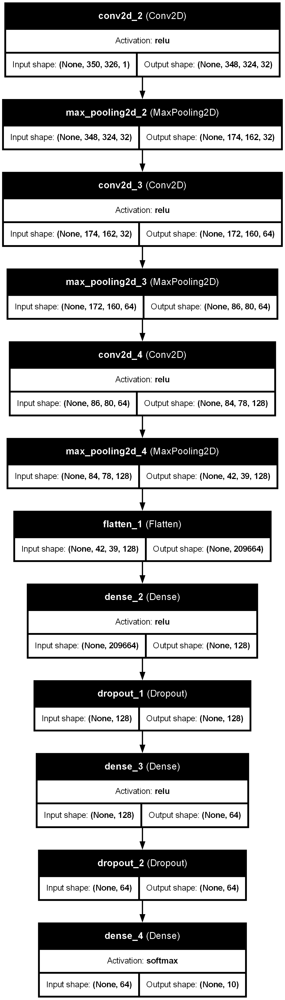

In [43]:
from tensorflow.keras.utils import plot_model

plot_model(
    model_preprocessed, 
    to_file='imgs/models/preprocessed_model.png', 
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    rankdir="TL",
    expand_nested=False,
    dpi=200,
    show_layer_activations=True,
    show_trainable=False
)

In [44]:
# Treinar o modelo
history = model_preprocessed.fit(X_train, y_train_enc, batch_size=50, epochs=50, validation_data=(X_val, y_val_enc))

# Avaliar o modelo
loss, accuracy = model_preprocessed.evaluate(X_val, y_val_enc)
print(f'Validation Loss: {loss}')
print(f'Validation Accuracy: {accuracy}')

Epoch 1/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step - accuracy: 0.1067 - loss: 6.1921 - val_accuracy: 0.1000 - val_loss: 3.3557
Epoch 2/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - accuracy: 0.0850 - loss: 5.5956 - val_accuracy: 0.1000 - val_loss: 2.3239
Epoch 3/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - accuracy: 0.0783 - loss: 2.4628 - val_accuracy: 0.2000 - val_loss: 2.3037
Epoch 4/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - accuracy: 0.0767 - loss: 2.2995 - val_accuracy: 0.1000 - val_loss: 2.3041
Epoch 5/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - accuracy: 0.1217 - loss: 2.3167 - val_accuracy: 0.1000 - val_loss: 2.3035
Epoch 6/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 1s/step - accuracy: 0.1067 - loss: 2.2770 - val_accuracy: 0.1000 - val_loss: 2.3024
Epoch 7/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - accuracy: 0.1233 - loss: 2.2858 - val_accuracy: 0.1000 - val_loss: 2.3005
Epoch 8/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - accuracy: 0.1233 - loss: 2.3080 - val_accuracy: 0.1000 - val_loss: 2.3018
Epoch 9/50
2/2 ━

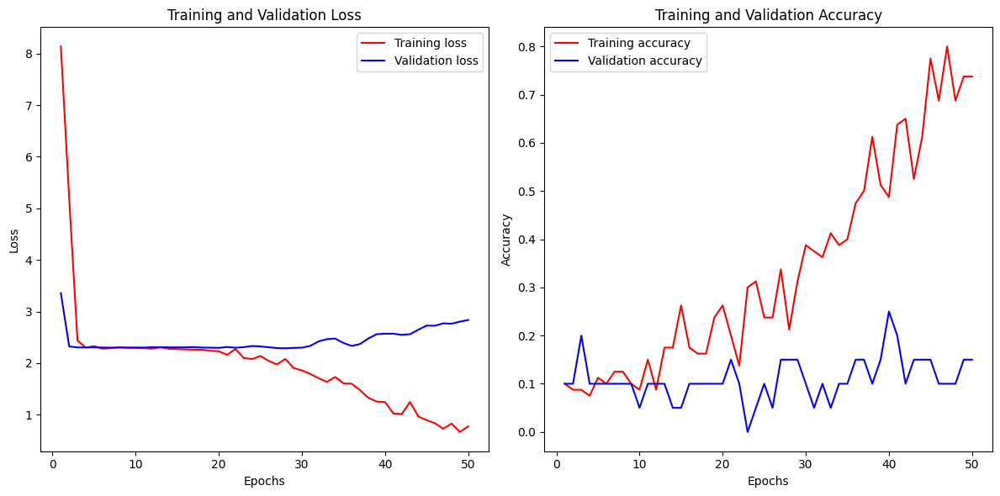

<Figure size 640x480 with 0 Axes>

In [45]:
plotModelHistory(history, type='multi')

In [46]:
Y_enc = to_categorical(Y, num_classes)
history = model_preprocessed.fit(X, Y_enc, batch_size=50, epochs=50)

Epoch 1/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.6133 - loss: 185.5216
Epoch 2/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - accuracy: 0.6267 - loss: 46.1574
Epoch 3/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - accuracy: 0.3200 - loss: 29.8231
Epoch 4/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - accuracy: 0.4000 - loss: 2.6677
Epoch 5/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - accuracy: 0.1333 - loss: 2.2306
Epoch 6/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - accuracy: 0.1067 - loss: 2.3028
Epoch 7/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - accuracy: 0.1533 - loss: 2.3037
Epoch 8/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - accuracy: 0.1467 - loss: 2.3008
Epoch 9/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - accuracy: 0.1267 - loss: 2.3028
Epoch 10/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - accuracy: 0.1000 - loss: 2.3035
Epoch 11/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - accuracy: 0.0667 - loss: 2.3049
Epoch 12/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - accuracy: 0.0867 - loss: 2.3082
Epoch 13/50
2/2 ━━━━━

#### Load Test Data (Easy Mode)

In [47]:
path = "../../src/TP2/dataset/archive/SOCOFing/Altered/Altered-Easy/"
test = load_database(path)

print(len(database)) 

100


In [48]:
for sample in test: 
    subject = sample['subject']
    image = sample['image']
    image_name = sample['image_name'].split('.')[0]

    terminations, bifurcations, enhanced_img, minutae_img = extract_minutae(image=image, showResult=False, saveResult=True, folder=f'{path}', image_name='minutae_'+image_name)

    sample['preprocessed'] = enhanced_img
    sample['minutae'] = (terminations, bifurcations)

    # ImageUtils().images_information(images=[image, enhanced_img, minutae_img], titles=[f'Imagem Original', 'Enhanced', 'Minutae'], show_cdf=False)

c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\fingerprint_feature_extractor\__init__.py:78: FutureWarning: `square` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  self._mask = erosion(self._mask, square(5))  # Structuing element for mask erosion = square(5)


In [49]:
X_test = []
Y_test = []

for sample in test:
    X_test.append(sample['preprocessed'])
    Y_test.append(int(sample['subject'])-1)

    
X_test = np.array(X_test)
Y_test = np.array(Y_test)

##### Predict test data

In [50]:
Y_test_enc = to_categorical(Y_test, num_classes)

y_pred = model_preprocessed.predict(X_test)

y_pred_fin = np.argmax(y_pred, axis=1)

10/10 ━━━━━━━━━━━━━━━━━━━━ 3s 334ms/step


##### Avaliação

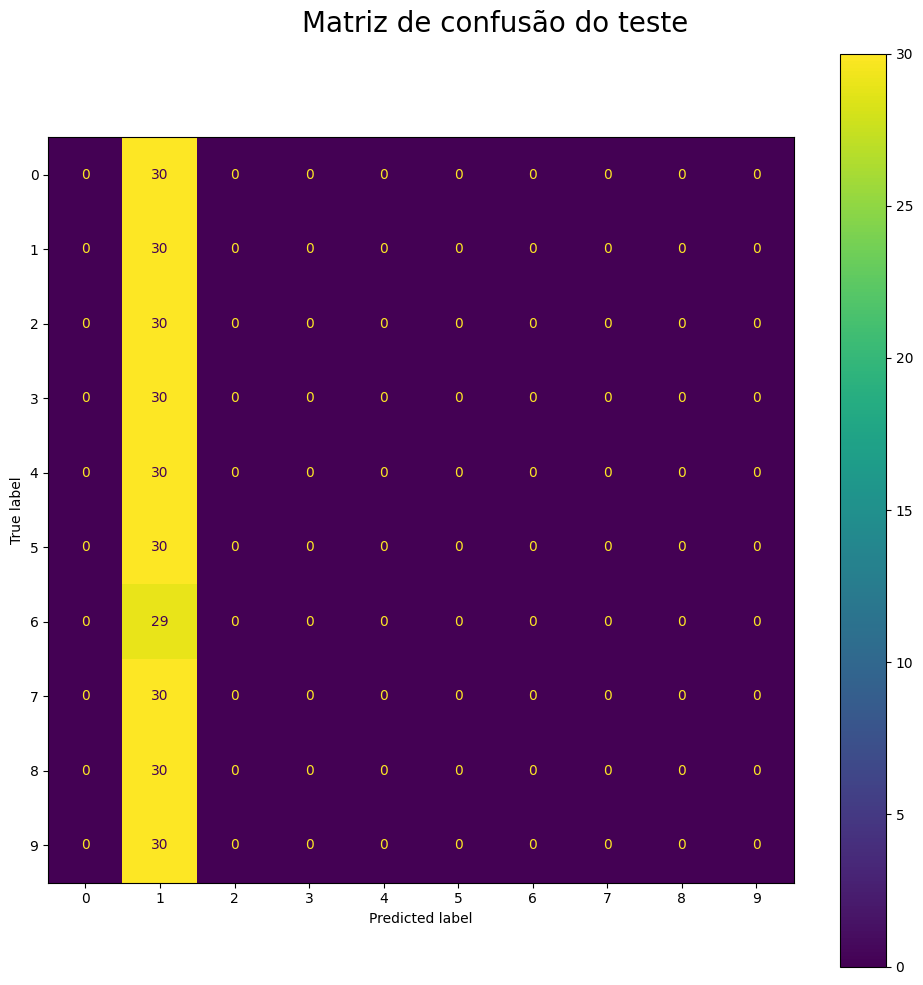

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        30
           1       0.10      1.00      0.18        30
           2       0.00      0.00      0.00        30
           3       0.00      0.00      0.00        30
           4       0.00      0.00      0.00        30
           5       0.00      0.00      0.00        30
           6       0.00      0.00      0.00        29
           7       0.00      0.00      0.00        30
           8       0.00      0.00      0.00        30
           9       0.00      0.00      0.00        30

    accuracy                           0.10       299
   macro avg       0.01      0.10      0.02       299
weighted avg       0.01      0.10      0.02       299



c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(avera

<Figure size 640x480 with 0 Axes>

In [51]:
plotConfusionMatrix(Y_test, y_pred_fin, type='multi')

print(classification_report(Y_test, y_pred_fin))

##### Visualização das Fingerprints mal classificadas

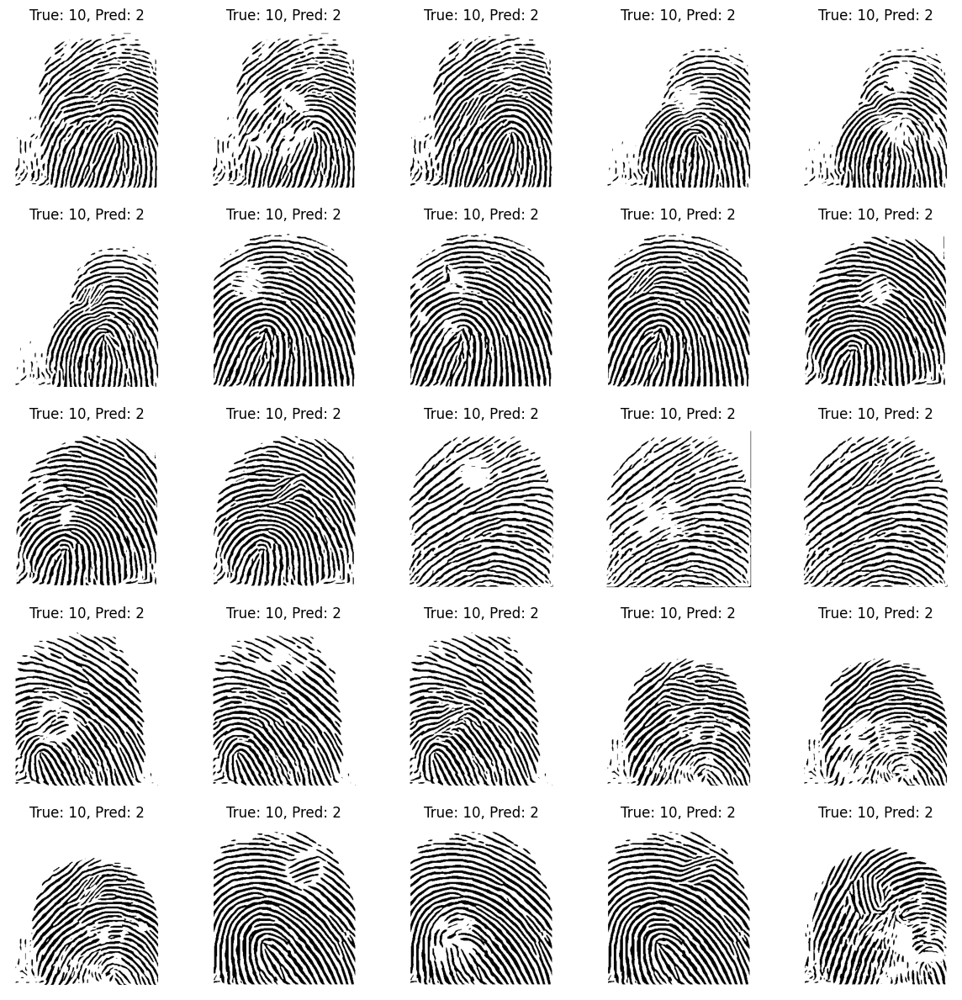

In [52]:
# Identificar índices das previsões incorretas
incorrect_indices = np.where(y_pred_fin != Y_test)[0]

# Plotar as imagens que foram classificadas incorretamente
plt.figure(figsize=(12, 12))
for i, idx in enumerate(incorrect_indices[:25]):  # Limitar a 25 imagens para visualização
    plt.subplot(5, 5, i + 1)
    plt.imshow(X_test[idx].reshape(350, 326), cmap='gray')
    plt.title(f'True: {Y_test[idx]+1}, Pred: {y_pred_fin[idx]+1}')
    plt.axis('off')
plt.tight_layout()
plt.show()

#### Load Test Data (Medium Mode)

In [53]:
path = "../../src/TP2/dataset/archive/SOCOFing/Altered/Altered-Medium/"
test = load_database(path)

print(len(database)) 

100


In [54]:
for sample in test: 
    subject = sample['subject']
    image = sample['image']
    image_name = sample['image_name'].split('.')[0]

    terminations, bifurcations, enhanced_img, minutae_img = extract_minutae(image=image, showResult=False, saveResult=True, folder=f'{path}', image_name='minutae_'+image_name)

    sample['preprocessed'] = enhanced_img
    sample['minutae'] = (terminations, bifurcations)

    # ImageUtils().images_information(images=[image, enhanced_img, minutae_img], titles=[f'Imagem Original', 'Enhanced', 'Minutae'], show_cdf=False)

c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\fingerprint_feature_extractor\__init__.py:78: FutureWarning: `square` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  self._mask = erosion(self._mask, square(5))  # Structuing element for mask erosion = square(5)


In [55]:
X_test = []
Y_test = []

for sample in test:
    X_test.append(sample['preprocessed'])
    Y_test.append(int(sample['subject'])-1)

    
X_test = np.array(X_test)
Y_test = np.array(Y_test)

##### Predict test data

In [56]:
Y_test_enc = to_categorical(Y_test, num_classes)

y_pred = model_preprocessed.predict(X_test)

y_pred_fin = np.argmax(y_pred, axis=1)

10/10 ━━━━━━━━━━━━━━━━━━━━ 3s 331ms/step


##### Avaliação

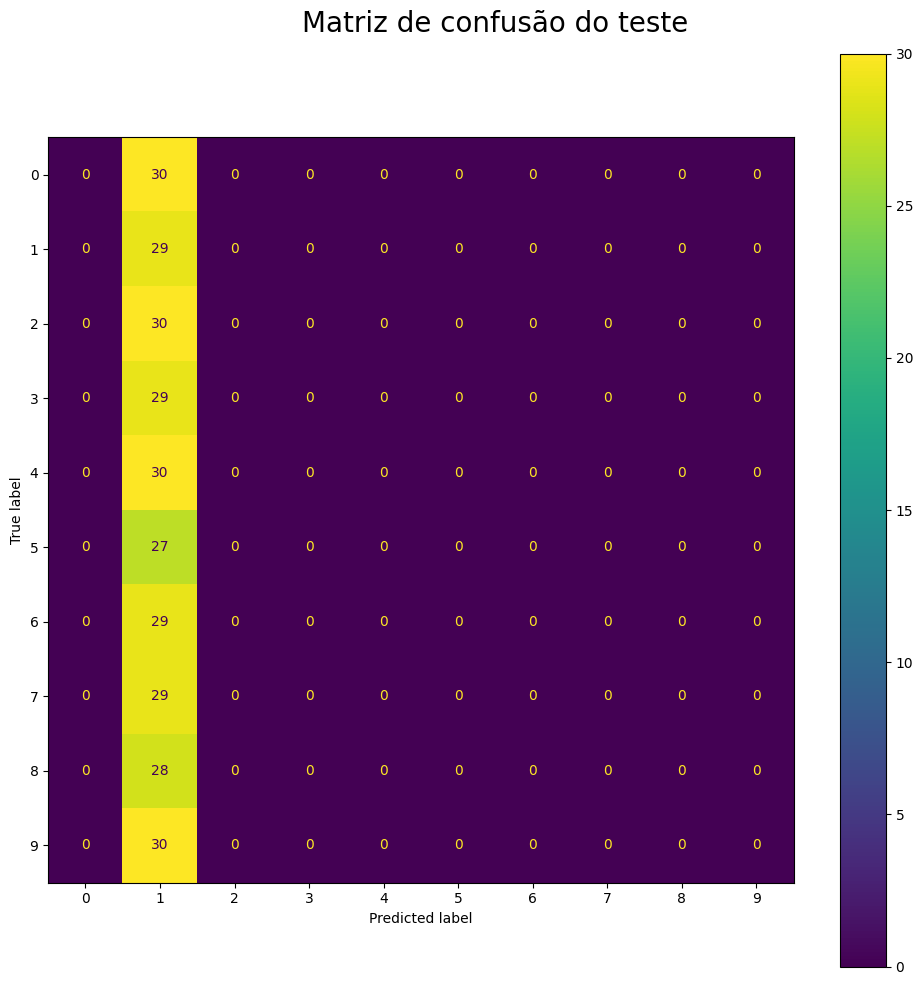

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        30
           1       0.10      1.00      0.18        29
           2       0.00      0.00      0.00        30
           3       0.00      0.00      0.00        29
           4       0.00      0.00      0.00        30
           5       0.00      0.00      0.00        27
           6       0.00      0.00      0.00        29
           7       0.00      0.00      0.00        29
           8       0.00      0.00      0.00        28
           9       0.00      0.00      0.00        30

    accuracy                           0.10       291
   macro avg       0.01      0.10      0.02       291
weighted avg       0.01      0.10      0.02       291



c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(avera

<Figure size 640x480 with 0 Axes>

In [57]:
plotConfusionMatrix(Y_test, y_pred_fin, type='multi')

print(classification_report(Y_test, y_pred_fin))

##### Visualização das Fingerprints mal classificadas

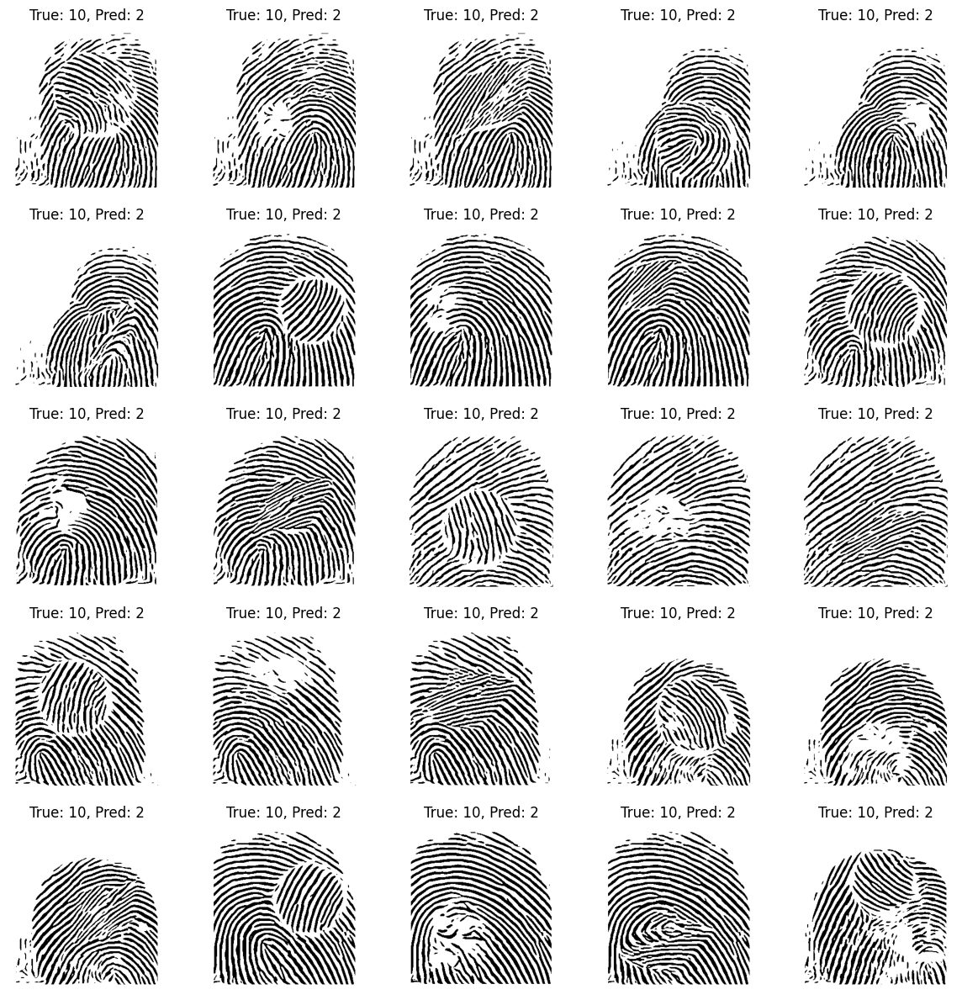

In [58]:
# Identificar índices das previsões incorretas
incorrect_indices = np.where(y_pred_fin != Y_test)[0]

# Plotar as imagens que foram classificadas incorretamente
plt.figure(figsize=(12, 12))
for i, idx in enumerate(incorrect_indices[:25]):  # Limitar a 25 imagens para visualização
    plt.subplot(5, 5, i + 1)
    plt.imshow(X_test[idx].reshape(350, 326), cmap='gray')
    plt.title(f'True: {Y_test[idx]+1}, Pred: {y_pred_fin[idx]+1}')
    plt.axis('off')
plt.tight_layout()
plt.show()

#### Load Test Data (Hard Mode)

In [59]:
path = "../../src/TP2/dataset/archive/SOCOFing/Altered/Altered-Hard/"
test = load_database(path)

print(len(database)) 

100


In [60]:
for sample in test: 
    subject = sample['subject']
    image = sample['image']
    image_name = sample['image_name'].split('.')[0]

    terminations, bifurcations, enhanced_img, minutae_img = extract_minutae(image=image, showResult=False, saveResult=True, folder=f'{path}', image_name='minutae_'+image_name)

    sample['preprocessed'] = enhanced_img
    sample['minutae'] = (terminations, bifurcations)

    # ImageUtils().images_information(images=[image, enhanced_img, minutae_img], titles=[f'Imagem Original', 'Enhanced', 'Minutae'], show_cdf=False)

c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\fingerprint_feature_extractor\__init__.py:78: FutureWarning: `square` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  self._mask = erosion(self._mask, square(5))  # Structuing element for mask erosion = square(5)


In [61]:
X_test = []
Y_test = []

for sample in test:
    X_test.append(sample['preprocessed'])
    Y_test.append(int(sample['subject'])-1)

    
X_test = np.array(X_test)
Y_test = np.array(Y_test)

##### Predict test data

In [62]:
Y_test_enc = to_categorical(Y_test, num_classes)

y_pred = model_preprocessed.predict(X_test)

y_pred_fin = np.argmax(y_pred, axis=1)

8/8 ━━━━━━━━━━━━━━━━━━━━ 3s 313ms/step


##### Avaliação

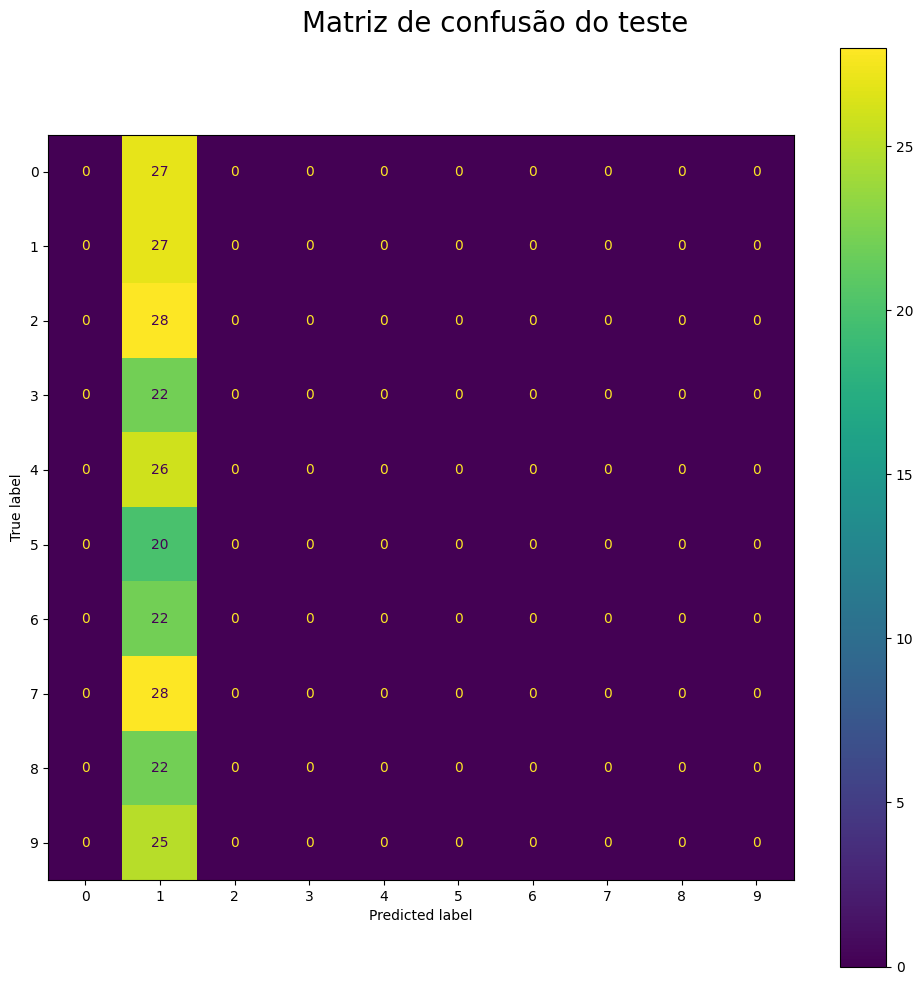

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        27
           1       0.11      1.00      0.20        27
           2       0.00      0.00      0.00        28
           3       0.00      0.00      0.00        22
           4       0.00      0.00      0.00        26
           5       0.00      0.00      0.00        20
           6       0.00      0.00      0.00        22
           7       0.00      0.00      0.00        28
           8       0.00      0.00      0.00        22
           9       0.00      0.00      0.00        25

    accuracy                           0.11       247
   macro avg       0.01      0.10      0.02       247
weighted avg       0.01      0.11      0.02       247



c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\ana.sofia.oliveira\Documents\ISEL\SB2425\.venv\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(avera

<Figure size 640x480 with 0 Axes>

In [63]:
plotConfusionMatrix(Y_test, y_pred_fin, type='multi')

print(classification_report(Y_test, y_pred_fin))

##### Visualização das Fingerprints mal classificadas

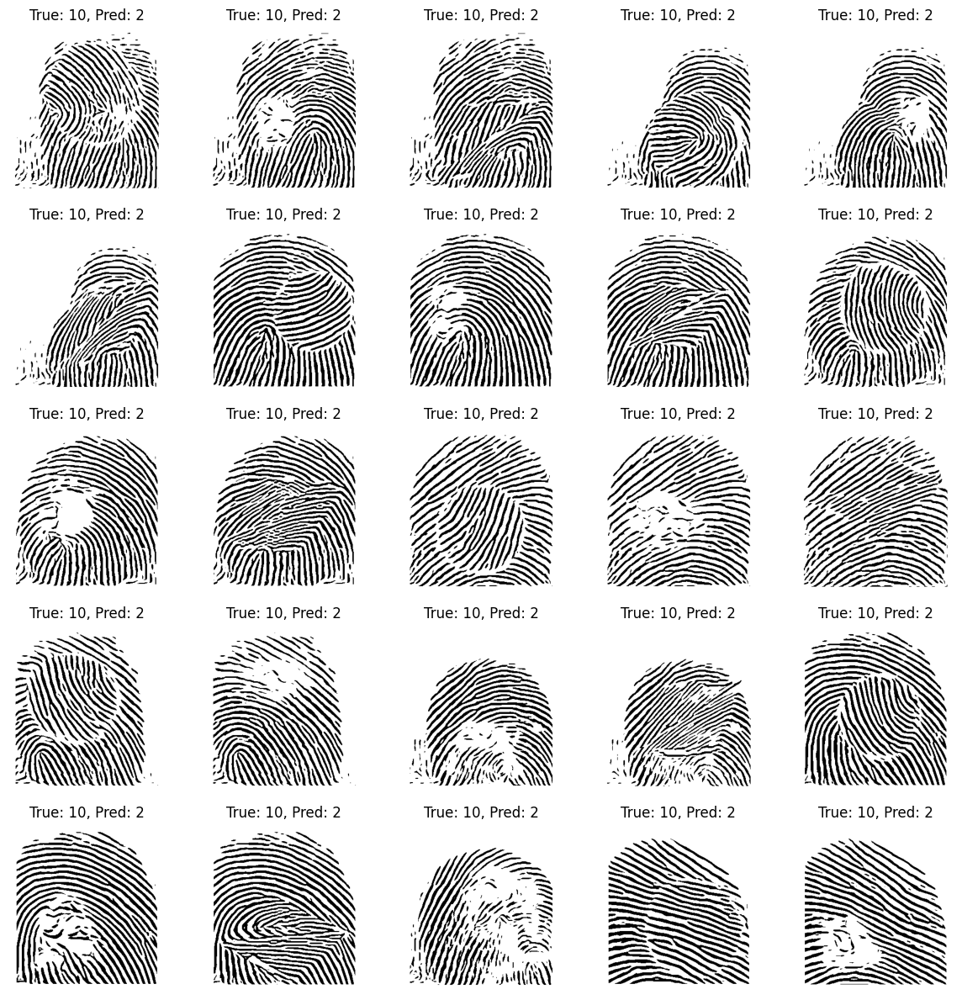

In [64]:
# Identificar índices das previsões incorretas
incorrect_indices = np.where(y_pred_fin != Y_test)[0]

# Plotar as imagens que foram classificadas incorretamente
plt.figure(figsize=(12, 12))
for i, idx in enumerate(incorrect_indices[:25]):  # Limitar a 25 imagens para visualização
    plt.subplot(5, 5, i + 1)
    plt.imshow(X_test[idx].reshape(350, 326), cmap='gray')
    plt.title(f'True: {Y_test[idx]+1}, Pred: {y_pred_fin[idx]+1}')
    plt.axis('off')
plt.tight_layout()
plt.show()

### CNN para minúcias

### TODO: 
1. CNN para imagens raw ✅
2. CNN para imagens pré-processadas✅
3. CNN com minúcias